# Iteración de Clustering

## Carga de datos

In [50]:
import pandas as pd
# Paso 1: Cargar los datos de estadísticas por comuna y rango de superficie
data_estadisticos = pd.read_csv('data recuperada/estadisticos_por_comuna_y_rango.csv')

 ## MinMax media, mediana y desv

### Normalización de variables 

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Paso 1: Variables a normalizar
variables_clustering = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]

# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### Matriz correlación de variables normalizadas (MinMaxScaler)

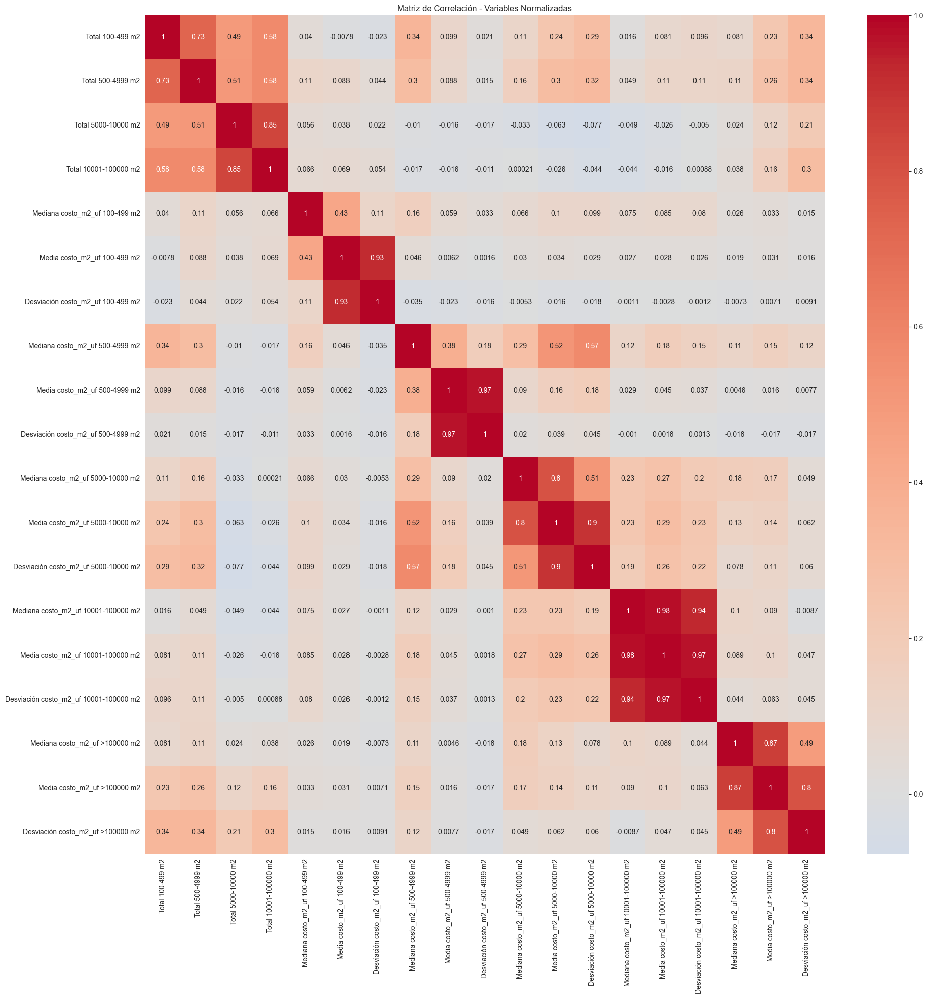

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Calcular la matriz de correlación de X_normalizado
corrmat = X_normalizado.corr()

# Paso 2: Definir el tamaño del gráfico
plt.figure(figsize=(20, 20))

# Paso 3: Crear el heatmap de la matriz de correlación con anotaciones
sns.heatmap(corrmat, annot=True, cmap='coolwarm', center=0)

# Paso 4: Ajustar el diseño y mostrar el gráfico
plt.title('Matriz de Correlación - Variables Normalizadas')
plt.tight_layout()
plt.show()

### PCA

Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669
PC4: 0.0589
PC5: 0.0474


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

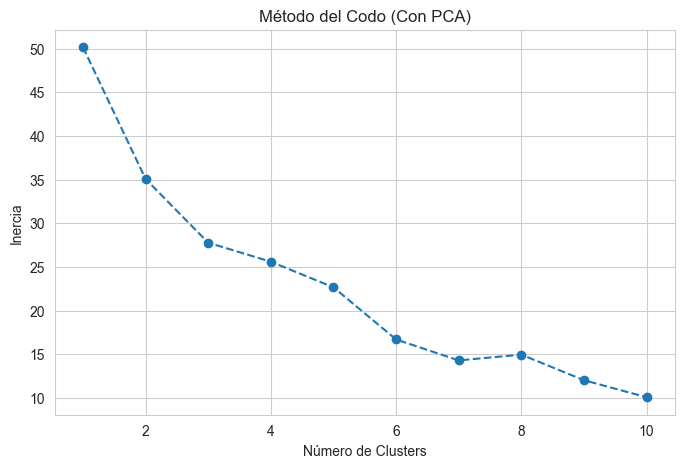

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


Silhouette Score para el modelo: 0.4295


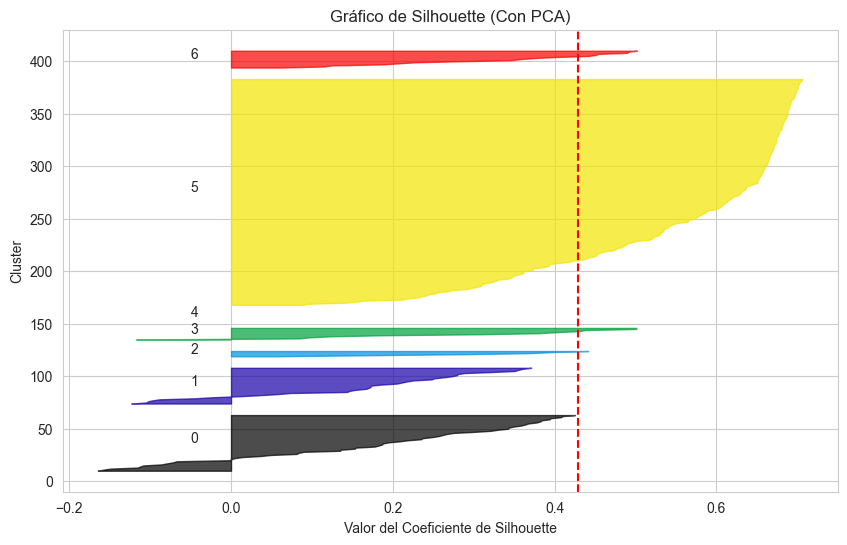

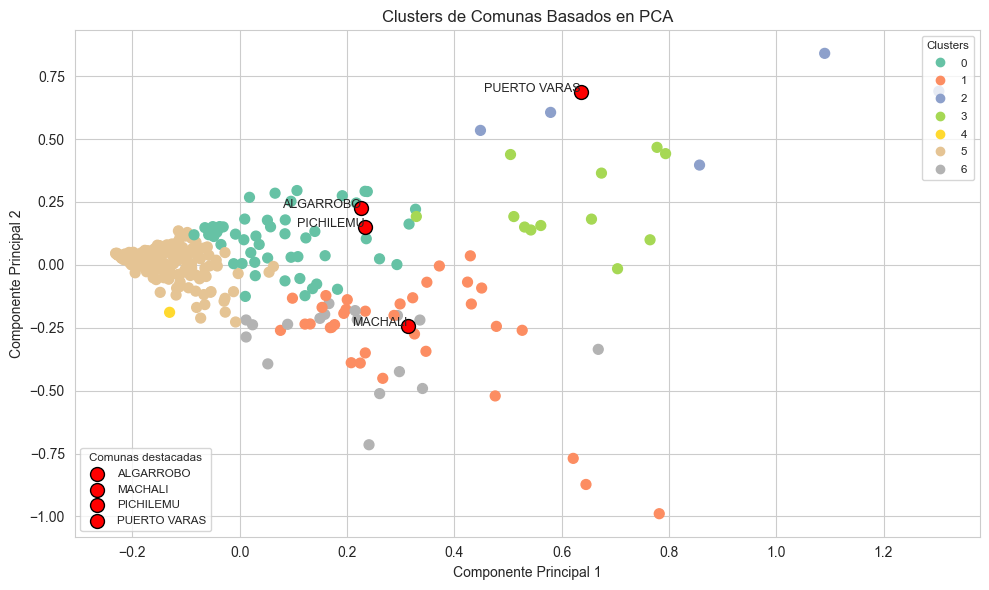


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
        PC1       PC2       PC3       PC4       PC5
0  0.080889  0.104747 -0.041997 -0.045826 -0.017050
1  0.311523 -0.272130 -0.215572  0.004842  0.008061
2  0.819055  0.625375  0.008573 -0.234595 -0.069671
3  0.612538  0.233818  0.126351  0.206125  0.091424
4 -0.130608 -0.188666  0.222447 -0.628110  1.559951
5 -0.143252  0.012659 -0.003675  0.007910 -0.002959
6  0.208062 -0.307970  0.518622  0.009334 -0.056546

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 1
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Pesos de cada variable en las componentes principales:
     Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
PC1          0.457133           0.416404             0.309074   
PC2          0.177984           0.129431             0.401418   
PC3          0.202382           0.

In [4]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Paso 4: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  # Reducir a 5 componentes principales
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 5: Método del codo para determinar el número óptimo de clusters
inertia = []
for k in range(1, 11):  # Probar con diferentes valores de K
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca)
    inertia.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia, marker='o', linestyle='--')
plt.title('Método del Codo (Con PCA)')
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()

# Paso 6: Aplicar K-means con el número óptimo de clusters
kmeans_PCA = KMeans(n_clusters=7, random_state=42)
data_PCA = data_estadisticos.copy()  # Crear copia específica para clustering con PCA
data_PCA['cluster'] = kmeans_PCA.fit_predict(X_pca)

# Guardar el archivo CSV para clustering con PCA (comentado)
# output_file_PCA = "data recuperada/comunas cluster/comunas_PCA_1.csv"
# data_PCA[['comuna_match', 'cluster']].to_csv(output_file_PCA, index=False)
# print(f"Listado de comunas con sus clusters guardado en: {output_file_PCA}")

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_PCA['cluster'])
print(f"Silhouette Score para el modelo: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_PCA['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(7):
    ith_cluster_silhouette_values = sample_silhouette_values[data_PCA['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 7)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color,
                      alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Con PCA)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")
plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 7: Identificar las posiciones de las comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
pos_comunas = data_PCA[data_PCA['comuna_match'].isin(comunas_a_marcar)]

# Paso 8: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_PCA['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas con un color especial
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters con tamaño de fuente ajustado
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 9: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(kmeans_PCA.cluster_centers_, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 10: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_PCA['comuna_match'].values:
        cluster_comuna = data_PCA[data_PCA['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 11: Mostrar cuánto pesa cada variable en cada componente principal
pesos_variables = pd.DataFrame(pca.components_, columns=variables_clustering, index=[f'PC{i+1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en las componentes principales:")
print(pesos_variables)

# Paso 12: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_PCA.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_PCA.groupby('cluster')[variables_clustering].median()

# Imprimir la media por cluster
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)



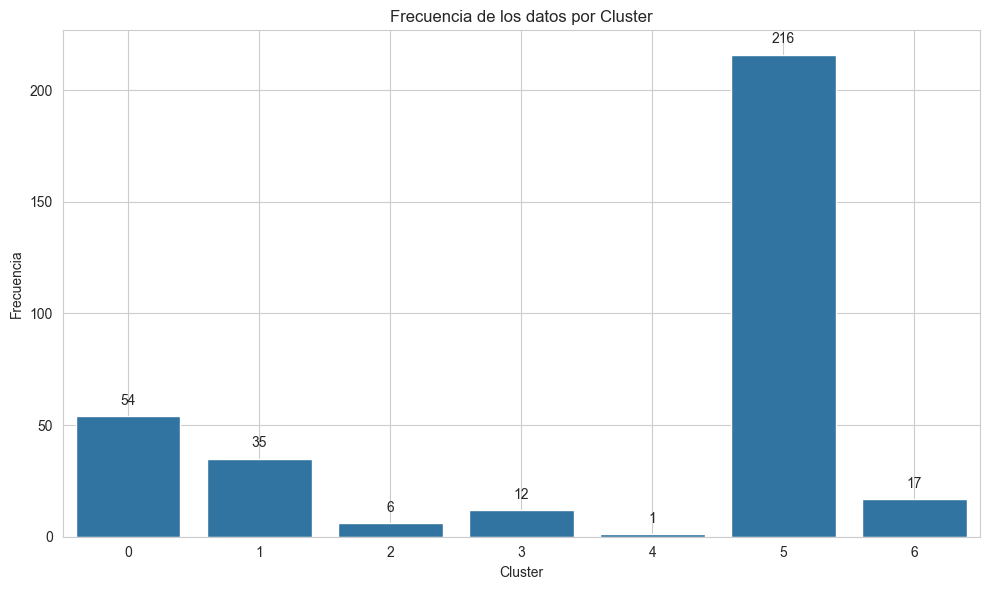

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
plt.figure(figsize=(10, 6))

# Contar la frecuencia de cada cluster en 'data_PCA'
frecuencia_clusters = data_PCA['cluster'].value_counts().sort_index()

# Graficar el gráfico de barras
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()



In [7]:
def imprimir_comunas_por_cluster(data_PCA):
    # Agrupar las comunas por el número de cluster
    clusters = data_PCA.groupby('cluster')['comuna_match'].apply(list)

    # Imprimir las comunas que pertenecen a cada cluster
    for cluster_num, comunas in clusters.items():
        print(f"\nCluster {cluster_num}:")
        print(', '.join(comunas))

# Llamar a la función después de realizar el clustering
imprimir_comunas_por_cluster(data_PCA)




Cluster 0:
ALGARROBO, ANCUD, AYSEN, CALBUCO, CALERA DE TANGO, CASABLANCA, CASTRO, CHILLAN, COCHAMO, CONCON, CORONEL, COYHAIQUE, CUNCO, CURACAUTIN, CURACAVI, CURICO, FRUTILLAR, FUTRONO, ISLA DE MAIPO, LA LIGUA, LA UNION, LAGO RANCO, LAS CABRAS, LIMACHE, LINARES, LITUECHE, LOS ANGELES, LOS LAGOS, LOS MUERMOS, MAULE, MELIPILLA, NAVIDAD, OLMUE, OSORNO, OVALLE, PAINE, PANGUIPULLI, PARRAL, PICHILEMU, PIRQUE, PUNTA ARENAS, QUILLOTA, REQUINOA, RIO BUENO, SAN CARLOS, SAN CLEMENTE, SAN JAVIER, SAN PEDRO DE ATACAMA, SAN PEDRO DE LA PAZ, SANTA JUANA, TALAGANTE, TALCAHUANO, VICHUQUEN, YUMBEL

Cluster 1:
ALTO HOSPICIO, ARICA, BUIN, CALAMA, CARTAGENA, CHIGUAYANTE, CHILLAN VIEJO, COPIAPO, EL QUISCO, EL TABO, ESTACION CENTRAL, GRANEROS, HUALPEN, LA REINA, LAMPA, LOS ANDES, MACHALI, MAIPU, MALLOA, OLIVAR, PADRE HURTADO, PENAFLOR, PUDAHUEL, PUENTE ALTO, QUILICURA, QUINTERO, RANCAGUA, SAN ANTONIO, SAN BERNARDO, SAN ESTEBAN, SAN FELIPE, SAN RAMON, SANTO DOMINGO, TOME, VILLA ALEMANA

Cluster 2:
COLINA, LA 

In [9]:
# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_PCA_1.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = data_PCA[['comuna_match', 'cluster']]  # Usar data_PCA

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")


Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_PCA_1.csv


In [10]:
Kmeans_PCA_1 = pd.read_csv(output_file)
frecuencia_clusters_PCA_1 = Kmeans_PCA_1['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_PCA_1)

cluster
0     54
1     35
2      6
3     12
4      1
5    216
6     17
Name: count, dtype: int64


### Grafico en 3D

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


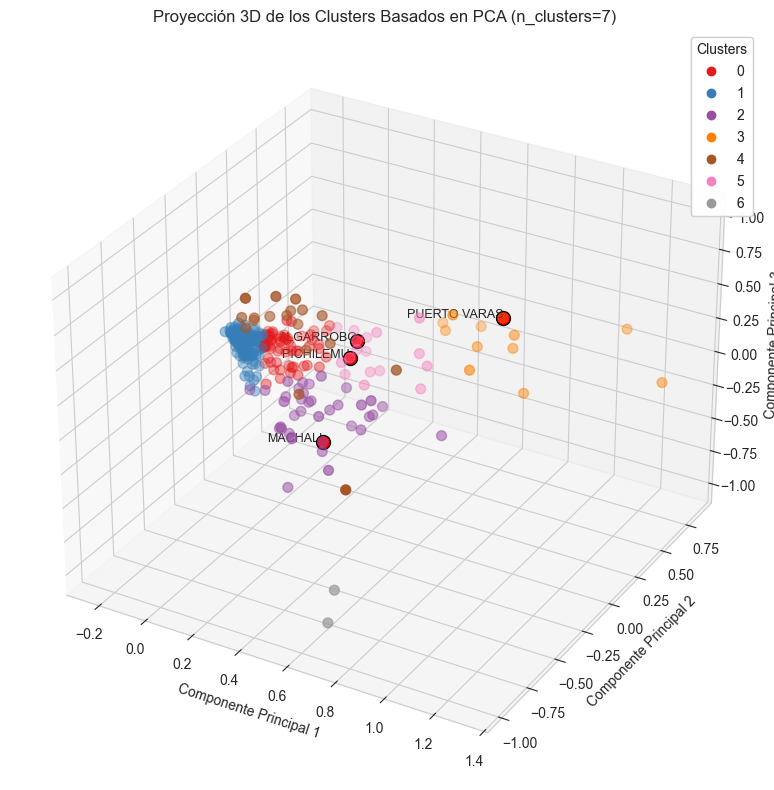

In [11]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]  # Aquí utilizas las variables que has definido para el clustering

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 3 componentes principales
pca_3d = PCA(n_components=3)  # Reducir a 3 componentes principales
PCA_ds = pd.DataFrame(pca_3d.fit_transform(X_normalizado), columns=['PC1', 'PC2', 'PC3'])

# Paso 4: Aplicar K-means con el número óptimo de clusters (aquí 7 clusters)
kmeans = KMeans(n_clusters=7, random_state=42)
PCA_ds['cluster'] = kmeans.fit_predict(PCA_ds)  # Asignar los clusters a PCA_ds sin modificar la data original

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Graficamos los clusters en 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# Colorear los puntos por clusters
scatter = ax.scatter(x, y, z, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = PCA_ds['cluster'].nunique()  # Contar cuántos clusters únicos hay
ax.set_title(f"Proyección 3D de los Clusters Basados en PCA (n_clusters={n_clusters})")
ax.set_xlabel('Componente Principal 1')
ax.set_ylabel('Componente Principal 2')
ax.set_zlabel('Componente Principal 3')

# Añadir leyenda para los clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy, cz in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2'], comunas_interes['PC3']):
    ax.scatter(cx, cy, cz, color='red', s=100, label=f'{comuna}', edgecolor='black')
    ax.text(cx, cy, cz, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()




In [13]:
!pip install plotly


In [14]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import plotly.graph_objects as go

def graficar_clusters_pca_3d_interactivo(data, variables_clustering, n_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Aplicar PCA para reducir a 3 componentes principales
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X_normalizado)
    pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

    # Imprimir las varianzas explicadas por cada componente principal
    varianzas_explicadas = pca.explained_variance_ratio_
    print("Varianzas explicadas por cada componente principal:")
    for i, varianza in enumerate(varianzas_explicadas):
        print(f"PC{i + 1}: {varianza:.4f}")

    # Paso 4: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_pca)

    # Proyección 3D de los datos en base a PCA
    x = pca_df['PC1']
    y = pca_df['PC2']
    z = pca_df['PC3']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters y mostrar la leyenda con los clusters asignados
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=pca_df.loc[cluster_data.index, 'PC1'],
            y=pca_df.loc[cluster_data.index, 'PC2'],
            z=pca_df.loc[cluster_data.index, 'PC3'],
            mode='markers',
            marker=dict(size=5, opacity=0.8),
            name=f'Cluster {cluster_num}',
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=pca_df.loc[pos_comunas.index, 'PC1'], 
        y=pca_df.loc[pos_comunas.index, 'PC2'], 
        z=pca_df.loc[pos_comunas.index, 'PC3'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas Destacadas'
    ))

    # Personalizar el gráfico (ajustar el tamaño)
    fig.update_layout(
        title=f'Clusters Basados en Componentes Principales (PCA)',
        scene=dict(
            xaxis_title='Componente Principal 1',
            yaxis_title='Componente Principal 2',
            zaxis_title='Componente Principal 3'
        ),
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        legend_title_text='Clusters'
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


### Sin PCA

### Función Clustering

In [7]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

def realizar_clustering_sin_pca(data, variables_clustering, n_clusters, mostrar_codo=True, mostrar_silhouette=True, var_x=None, var_y=None):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia2 = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia2[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Método del codo (opcional)
    if mostrar_codo:
        inertia = []
        for k in range(1, 11):  # Probar con diferentes valores de K
            kmeans = KMeans(n_clusters=k, random_state=42)
            kmeans.fit(X_normalizado)
            inertia.append(kmeans.inertia_)
        
        # Graficar el método del codo
        plt.figure(figsize=(8, 5))
        plt.plot(range(1, 11), inertia, marker='o', linestyle='--')
        plt.title('Método del Codo')
        plt.xlabel('Número de Clusters')
        plt.ylabel('Inercia')
        plt.grid(True)
        plt.show()

    # Paso 4: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia2['cluster'] = kmeans.fit_predict(X_normalizado)

    # Paso 5: Calcular el Silhouette Score (opcional)
    if mostrar_silhouette:
        silhouette_avg = silhouette_score(X_normalizado, data_copia2['cluster'])
        print(f"Silhouette Score para el modelo: {silhouette_avg:.4f}")

        # Graficar el Silhouette Score para cada punto
        sample_silhouette_values = silhouette_samples(X_normalizado, data_copia2['cluster'])

        plt.figure(figsize=(10, 6))
        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[data_copia2['cluster'] == i]
            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = plt.cm.nipy_spectral(float(i) / n_clusters)
            plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

        plt.title("Gráfico de Silhouette")
        plt.xlabel("Valor del Coeficiente de Silhouette")
        plt.ylabel("Cluster")
        plt.axvline(x=silhouette_avg, color="red", linestyle="--")
        plt.grid(True)
        plt.show()

    # Paso 6: Visualización de los clusters en las dos variables seleccionadas
    if var_x is not None and var_y is not None:
        plt.figure(figsize=(10, 6))
        scatter = plt.scatter(X_normalizado[var_x], X_normalizado[var_y], c=data_copia2['cluster'], cmap='Set2', s=50)

        # Añadir leyenda de clusters
        legend1 = plt.legend(*scatter.legend_elements(), title="Clusters")
        plt.gca().add_artist(legend1)

        # Añadir la leyenda personalizada
        plt.legend(loc="upper left")
        plt.title(f'Clusters de Comunas Basados en {var_x} y {var_y}')
        plt.xlabel(f'{var_x} (normalizado)')
        plt.ylabel(f'{var_y} (normalizado)')
        plt.grid(True)

        # Paso 6.1: Resaltar las comunas de interés
        comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
        pos_comunas = data_copia2[data_copia2['comuna_match'].isin(comunas_a_marcar)]

        # Añadir los puntos resaltados para las comunas
        for comuna, x, y in zip(pos_comunas['comuna_match'], X_normalizado.loc[pos_comunas.index, var_x], X_normalizado.loc[pos_comunas.index, var_y]):
            plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
            plt.text(x, y, comuna, fontsize=9, ha='right')

        plt.tight_layout()
        plt.show()

    # Paso 7: Imprimir las comunas de interés y su cluster
    print("\nClusters de las comunas seleccionadas:")
    for comuna in comunas_a_marcar:
        if comuna in data_copia2['comuna_match'].values:
            cluster_comuna = data_copia2[data_copia2['comuna_match'] == comuna]['cluster'].values[0]
            print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
        else:
            print(f"Comuna {comuna} no está presente en los datos.")
    
    # Paso 8: Mostrar estadísticas por cluster (media y mediana)
    media_por_cluster = data_copia2.groupby('cluster')[variables_clustering].mean()
    mediana_por_cluster = data_copia2.groupby('cluster')[variables_clustering].median()
    pd.set_option('display.max_columns', None)  # No limite el número de columnas mostradas
    print("\nMedia por cluster (solo variables seleccionadas):")
    print(media_por_cluster)
    print("\nMediana por cluster (solo variables seleccionadas):")
    print(mediana_por_cluster)

    # Paso 9: Generar gráfico de barras de frecuencia por cluster
    plt.figure(figsize=(10, 6))

    # Contar la frecuencia de cada cluster en 'data_copia'
    frecuencia_clusters = data_copia2['cluster'].value_counts().sort_index()

    # Graficar el gráfico de barras
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

    # Añadir títulos y etiquetas
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)
    
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Retornar la copia de los datos con los clusters asignados
    return data_copia2


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

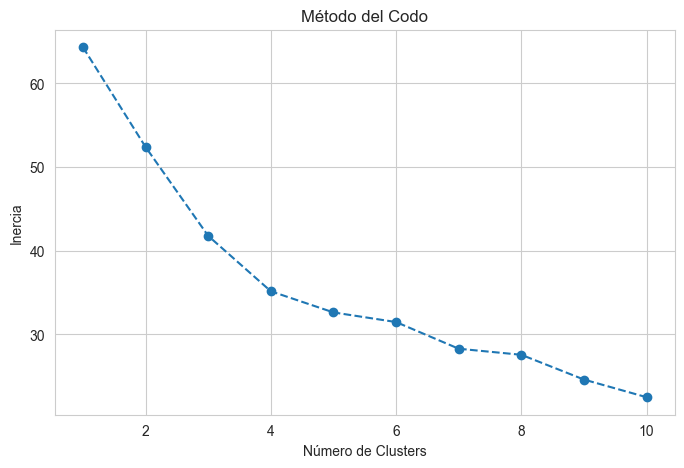

Silhouette Score para el modelo: 0.3720


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


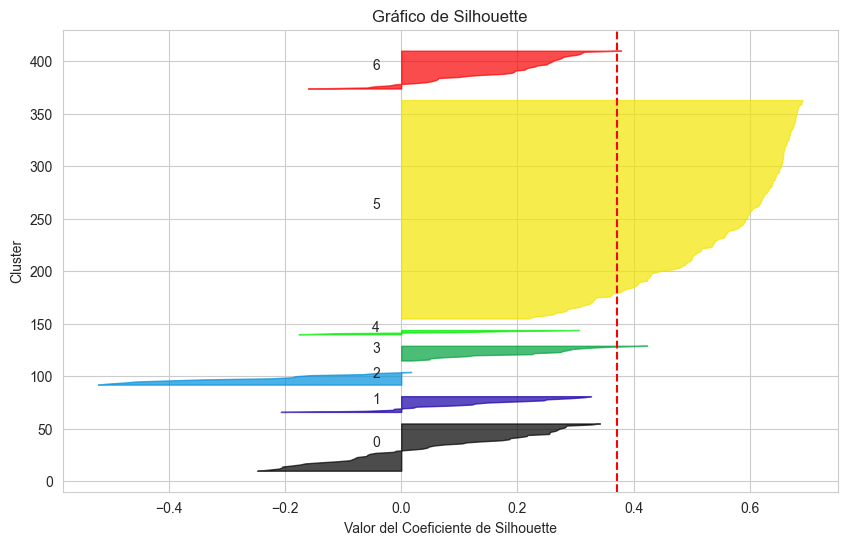

C:\Users\franc\AppData\Local\Temp\ipykernel_14180\3961275433.py:82: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc="upper left")


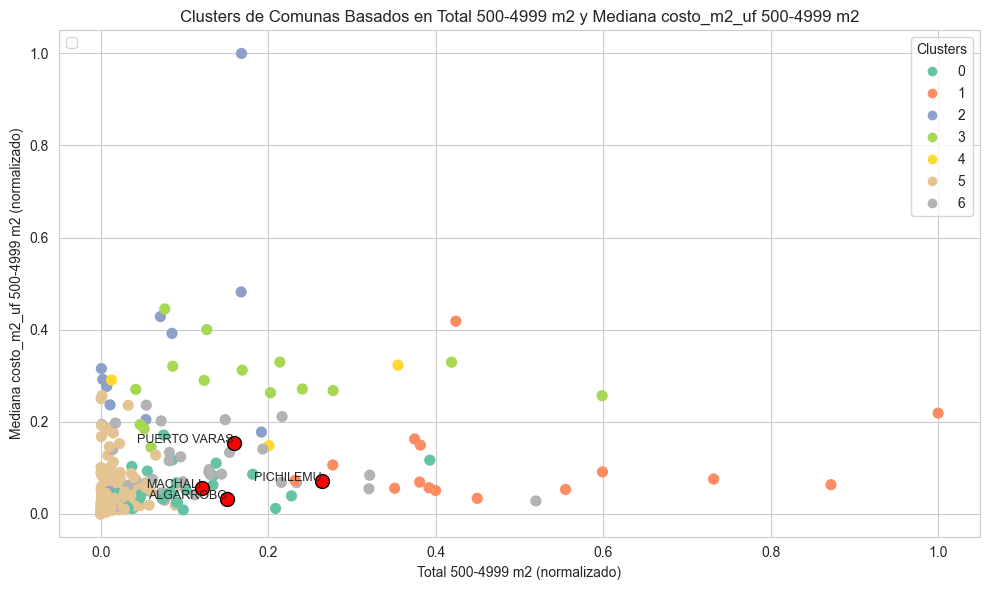


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 1
Comuna MACHALI pertenece al cluster 6
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               59.847826         179.043478           675.913043   
1              344.875000        1095.875000          1782.562500   
2               58.692308         137.538462            41.000000   
3              130.733333         421.866667           106.600000   
4               48.400000         274.600000           118.400000   
5                9.650718          26.358852           112.272727   
6               93.702703         274.000000           269.594595   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                     

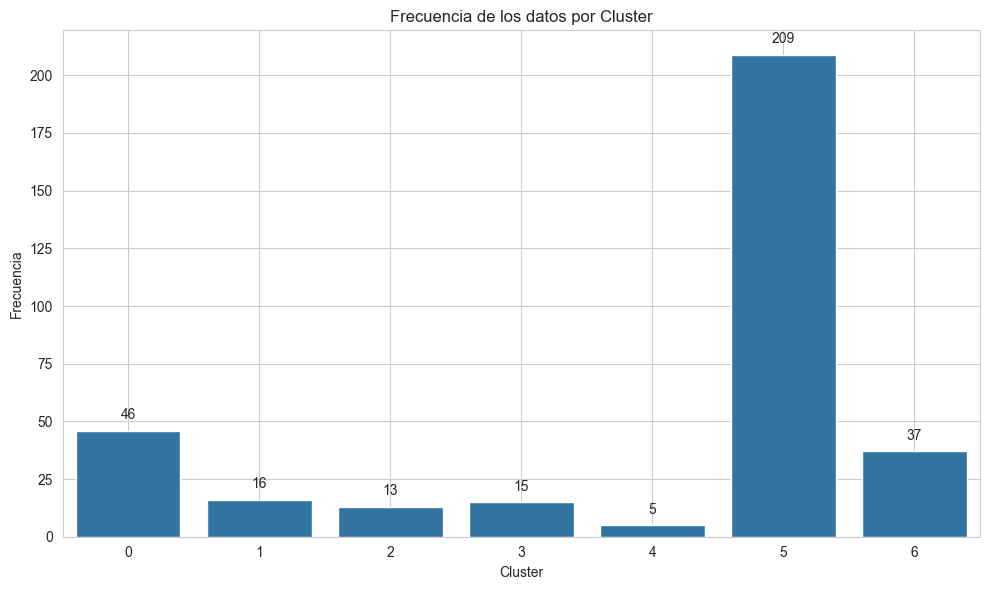

In [34]:
# Llamar a la función y almacenar el resultado en una nueva variable
resultados_clustering = realizar_clustering_sin_pca(data_estadisticos, variables_clustering, 7, True, True, 'Total 500-4999 m2', 'Mediana costo_m2_uf 500-4999 m2')


In [18]:
output_file = "data recuperada/comunas cluster/comunas_SinPCA_1.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = resultados_clustering[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")


Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_SinPCA_1.csv


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



Pesos de cada variable en los centroides de los 7 clusters:
   Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
0          0.093221           0.077407             0.161047   
1          0.537188           0.473789             0.424723   
2          0.091421           0.059463             0.009769   
3          0.203634           0.182389             0.025399   
4          0.075389           0.118720             0.028211   
5          0.015032           0.011396             0.026751   
6          0.145954           0.118461             0.064235   

   Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
0               0.233120                        0.027776   
1               0.481063                        0.040780   
2               0.019319                        0.131303   
3               0.035945                        0.053728   
4               0.055530                        0.029059   
5               0.042235                        0.019852   
6              

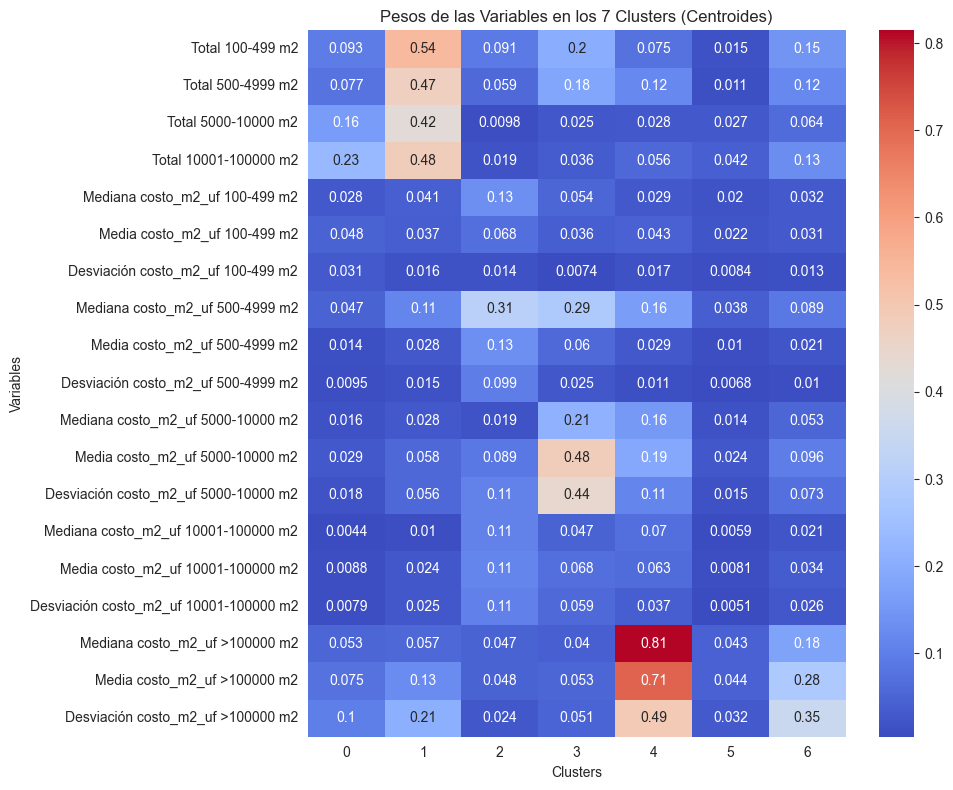

In [19]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar K-means con 7 clusters
kmeans = KMeans(n_clusters=7, random_state=42)
kmeans.fit(X_normalizado)

# Paso 4: Extraer los centroides
centroides = pd.DataFrame(kmeans.cluster_centers_, columns=variables_clustering)

# Paso 5: Visualizar el peso de cada variable en los centroides
print("Pesos de cada variable en los centroides de los 7 clusters:")
print(centroides)

# Opcional: Visualizar los pesos en un gráfico de calor
plt.figure(figsize=(10, 8))
sns.heatmap(centroides.T, annot=True, cmap="coolwarm", yticklabels=variables_clustering)
plt.title("Pesos de las Variables en los 7 Clusters (Centroides)")
plt.xlabel("Clusters")
plt.ylabel("Variables")
plt.tight_layout()
plt.show()


### Gráfico en 3D

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



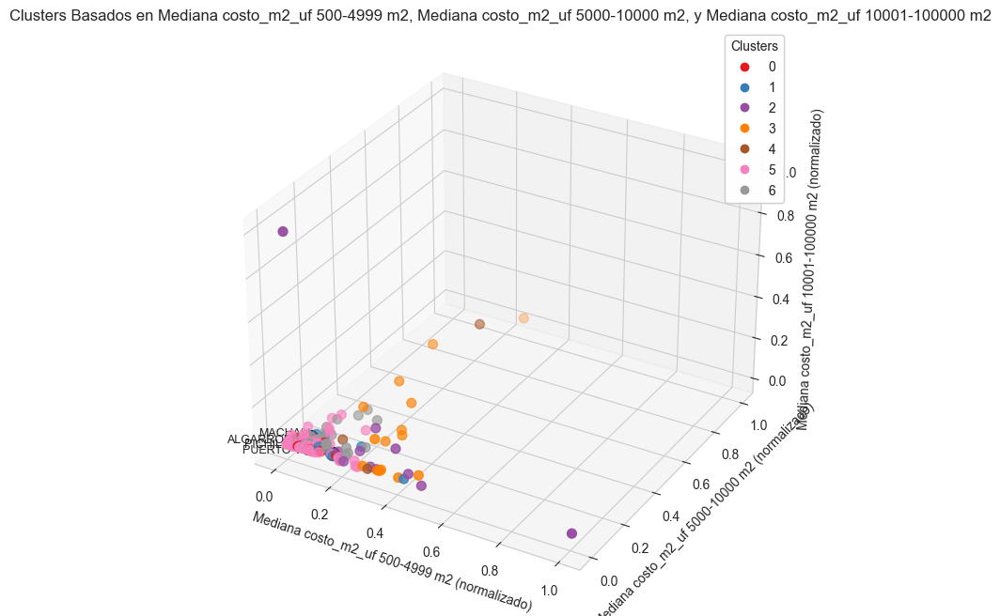

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def graficar_clusters_3d(data, variables_clustering, var_x, var_y, var_z, n_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Paso 3: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Graficar los puntos coloreados por el cluster al que pertenecen
    scatter = ax.scatter(x, y, z, c=data_copia['cluster'], cmap='Set1', s=50)

    # Personalización del gráfico
    ax.set_title(f'Clusters Basados en {var_x}, {var_y}, y {var_z}')
    ax.set_xlabel(f'{var_x} (normalizado)')
    ax.set_ylabel(f'{var_y} (normalizado)')
    ax.set_zlabel(f'{var_z} (normalizado)')

    # Añadir leyenda de clusters
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
    plt.gca().add_artist(legend1)

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir las comunas de interés al gráfico
    for comuna, x_val, y_val, z_val in zip(pos_comunas['comuna_match'], 
                                           X_normalizado.loc[pos_comunas.index, var_x],
                                           X_normalizado.loc[pos_comunas.index, var_y],
                                           X_normalizado.loc[pos_comunas.index, var_z]):
        ax.scatter(x_val, y_val, z_val, color='red', s=100, label=f'{comuna}', edgecolor='black')
        ax.text(x_val, y_val, z_val, comuna, fontsize=9, ha='right')

    # Mostrar el gráfico
    plt.show()

# Llamar a la función con las variables de interés
graficar_clusters_3d(
    data_estadisticos, 
    variables_clustering,
    'Mediana costo_m2_uf 500-4999 m2', 
    'Mediana costo_m2_uf 5000-10000 m2', 
    'Mediana costo_m2_uf 10001-100000 m2',
    n_clusters=7  # Número de clusters que ya tienes
)



C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



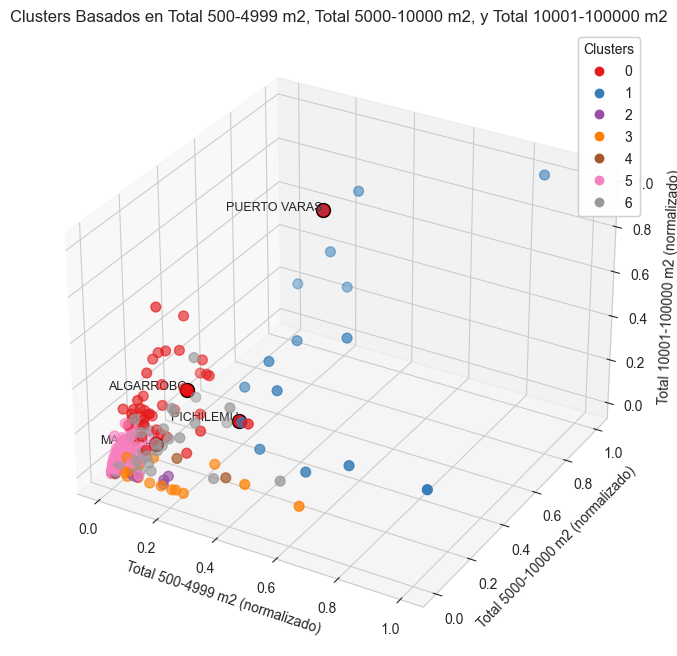

In [21]:
graficar_clusters_3d(data_estadisticos, variables_clustering,'Total 500-4999 m2','Total 5000-10000 m2','Total 10001-100000 m2',7)

In [22]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import plotly.graph_objects as go
import plotly.express as px

def graficar_clusters_3d_interactivo(data, variables_clustering, var_x, var_y, var_z, n_clusters, limite_ejes=0.5):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Paso 3: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters
    colors = px.colors.qualitative.Set1  # Definir una paleta de colores cualitativa para los clusters
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=X_normalizado.loc[cluster_data.index, var_x], 
            y=X_normalizado.loc[cluster_data.index, var_y], 
            z=X_normalizado.loc[cluster_data.index, var_z],
            mode='markers',
            marker=dict(size=5, color=colors[cluster_num % len(colors)], opacity=0.8),
            name=f'Cluster {cluster_num}',  # Añadir el nombre del cluster
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=X_normalizado.loc[pos_comunas.index, var_x], 
        y=X_normalizado.loc[pos_comunas.index, var_y], 
        z=X_normalizado.loc[pos_comunas.index, var_z],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas de Interés',  # Añadir nombre para las comunas de interés
        showlegend=True  # Mostrar leyenda para estas comunas
    ))

    # Personalizar el gráfico con los límites de los ejes
    fig.update_layout(
        title=f'Clusters Basados en {var_x}, {var_y}, y {var_z}',
        scene=dict(
            xaxis=dict(title=f'{var_x} (normalizado)', range=[0, limite_ejes]),
            yaxis=dict(title=f'{var_y} (normalizado)', range=[0, limite_ejes]),
            zaxis=dict(title=f'{var_z} (normalizado)', range=[0, limite_ejes])
        ),
        width=1200,  # Ancho del gráfico
        height=900   # Altura del gráfico,
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés y límites de los ejes
graficar_clusters_3d_interactivo(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=7,  # Número de clusters
    limite_ejes=1  # Límite para los ejes X, Y, Z
)


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



## MinMax media, mediana, min, max, desv

### Normalización de variables

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Variables a normalizar
variables_clustering = [
    
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2', 
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]


# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### Matriz correlación de variables normalizadas (MinMaxScaler)

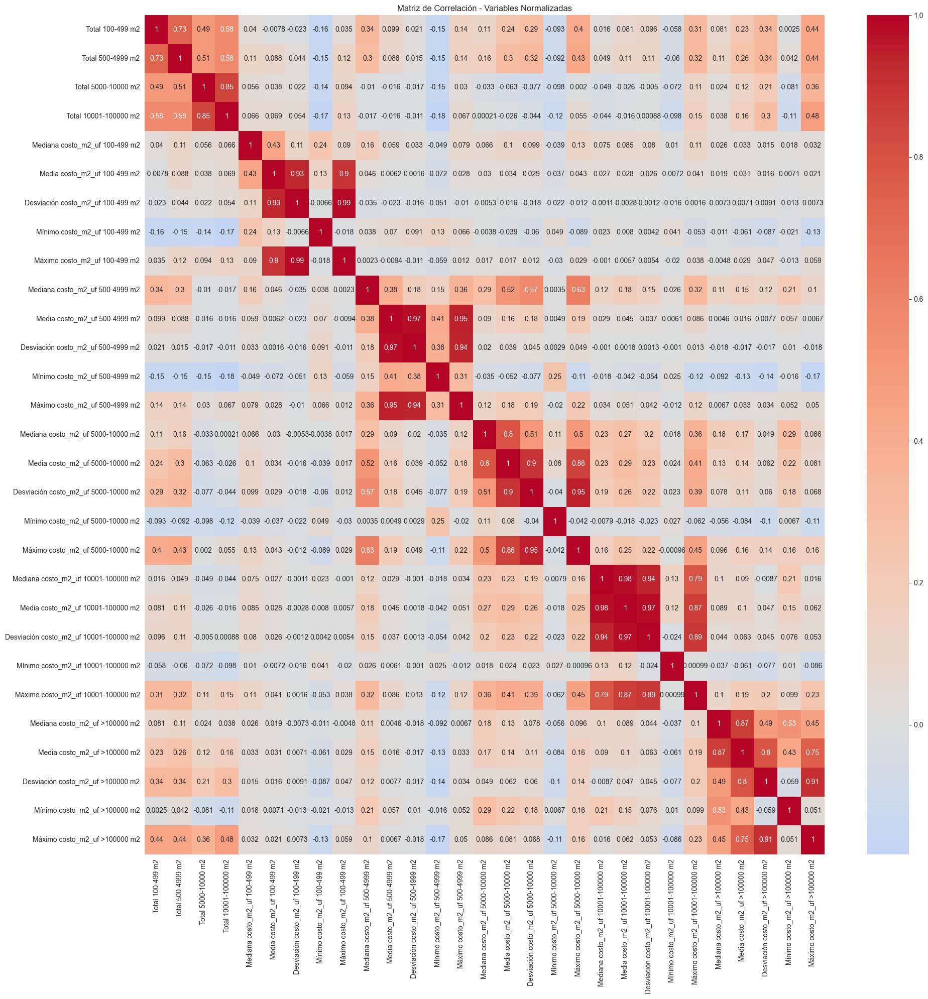

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Calcular la matriz de correlación de X_normalizado
corrmat = X_normalizado.corr()

# Paso 2: Definir el tamaño del gráfico
plt.figure(figsize=(20, 20))

# Paso 3: Crear el heatmap de la matriz de correlación con anotaciones
sns.heatmap(corrmat, annot=True, cmap='coolwarm', center=0)

# Paso 4: Ajustar el diseño y mostrar el gráfico
plt.title('Matriz de Correlación - Variables Normalizadas')
plt.tight_layout()
plt.show()

### PCA

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks t

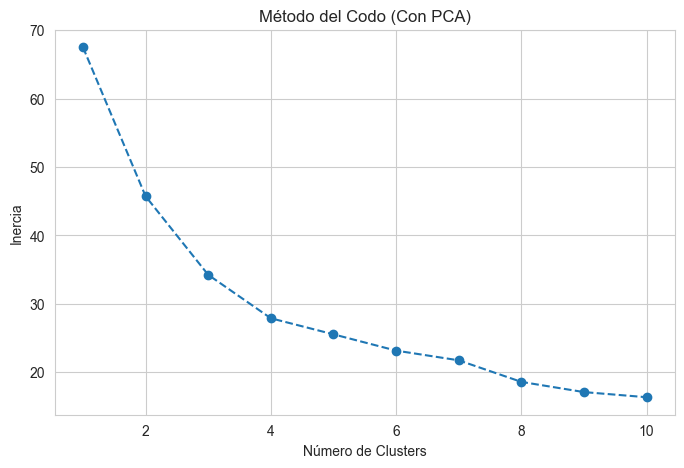

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



Silhouette Score para el modelo: 0.4226


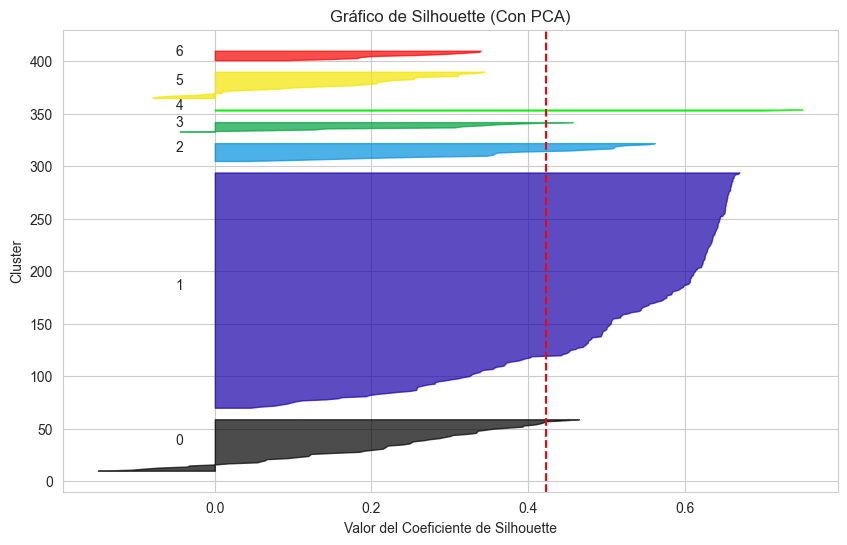

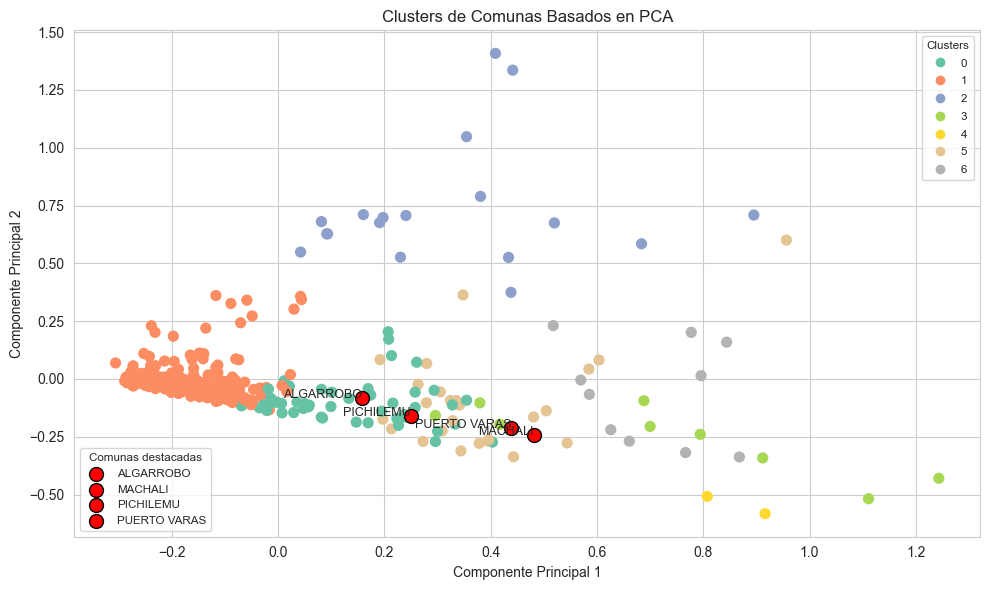


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
        PC1       PC2       PC3       PC4       PC5
0  0.136772 -0.100131  0.062148 -0.003252 -0.012358
1 -0.171267 -0.006468 -0.002765 -0.001729  0.005023
2  0.326864  0.736117  0.054532  0.018078 -0.062115
3  0.697978 -0.249785  0.623619 -0.036081  0.136383
4  0.861960 -0.545170 -1.031860  0.043815  0.140893
5  0.388381 -0.099593 -0.294367 -0.023331  0.028377
6  0.701123 -0.061056  0.001414  0.110610 -0.177759

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 3
Comuna MACHALI pertenece al cluster 5
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               70.940000         230.540000           596.520000   
1               12.000000  

In [30]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Paso 1: Cargar las variables y normalizarlas
X = data_estadisticos[variables_clustering]
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 2: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  
X_pca = pca.fit_transform(X_normalizado)

# Paso 3: Método del codo
inertia = []
for k in range(1, 11):  
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca)
    inertia.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia, marker='o', linestyle='--')
plt.title('Método del Codo (Con PCA)')
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()

# Paso 4: Aplicar K-means con el número óptimo de clusters (ejemplo: K=7)
kmeans = KMeans(n_clusters=7, random_state=42)
data_nueva_iteracion = data_estadisticos.copy()  # Crear una copia para no modificar la original
data_nueva_iteracion['cluster'] = kmeans.fit_predict(X_pca)

# Paso 5: Calcular Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_nueva_iteracion['cluster'])
print(f"Silhouette Score para el modelo: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_nueva_iteracion['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(7):
    ith_cluster_silhouette_values = sample_silhouette_values[data_nueva_iteracion['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 7)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color,
                      alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Con PCA)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")
plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 6: Identificar las posiciones de las comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
pos_comunas = data_nueva_iteracion[data_nueva_iteracion['comuna_match'].isin(comunas_a_marcar)]

# Paso 7: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_nueva_iteracion['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas con un color especial
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters con tamaño de fuente ajustado
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 8: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(kmeans.cluster_centers_, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 9: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_nueva_iteracion['comuna_match'].values:
        cluster_comuna = data_nueva_iteracion[data_nueva_iteracion['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 10: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_nueva_iteracion.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_nueva_iteracion.groupby('cluster')[variables_clustering].median()

# Imprimir la media por cluster
pd.set_option('display.max_columns', None)
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)



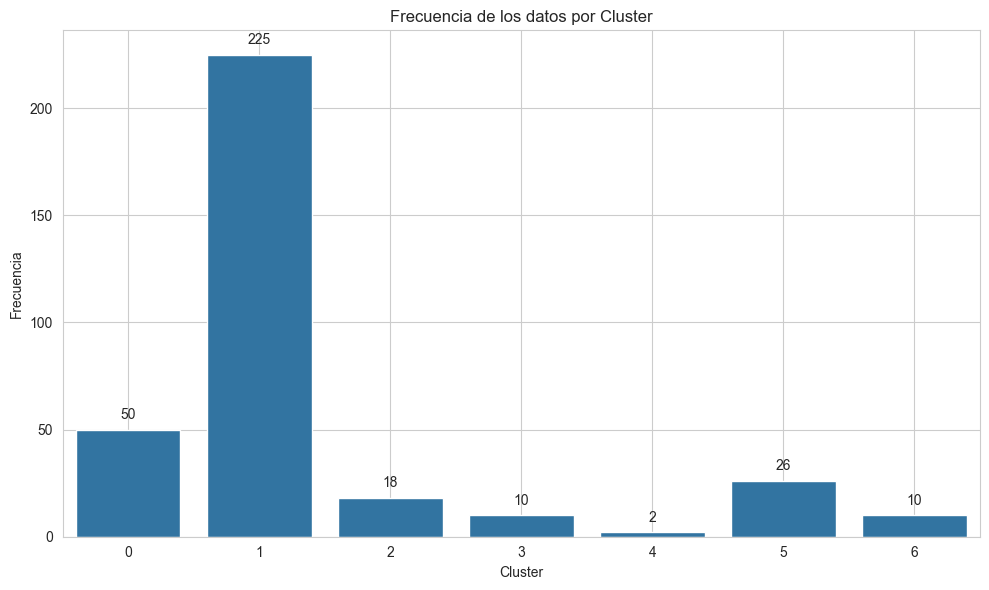

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns

# Graficar el histograma con los mismos datos de `data_nueva_iteracion`
frecuencia_clusters = data_nueva_iteracion['cluster'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()



In [32]:
# Guardar los mismos datos que utilizaste en el histograma
output_file = "data recuperada/comunas cluster/comunas_PCA_2.csv"
listado_comunas_clusters = data_nueva_iteracion[['comuna_match', 'cluster']]

listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")


Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_PCA_2.csv


In [33]:
Kmeans_PCA_2 = pd.read_csv(output_file)
frecuencia_clusters_PCA_2 = Kmeans_PCA_2['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_PCA_2)

cluster
0     50
1    225
2     18
3     10
4      2
5     26
6     10
Name: count, dtype: int64


### Gráfico 3D

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



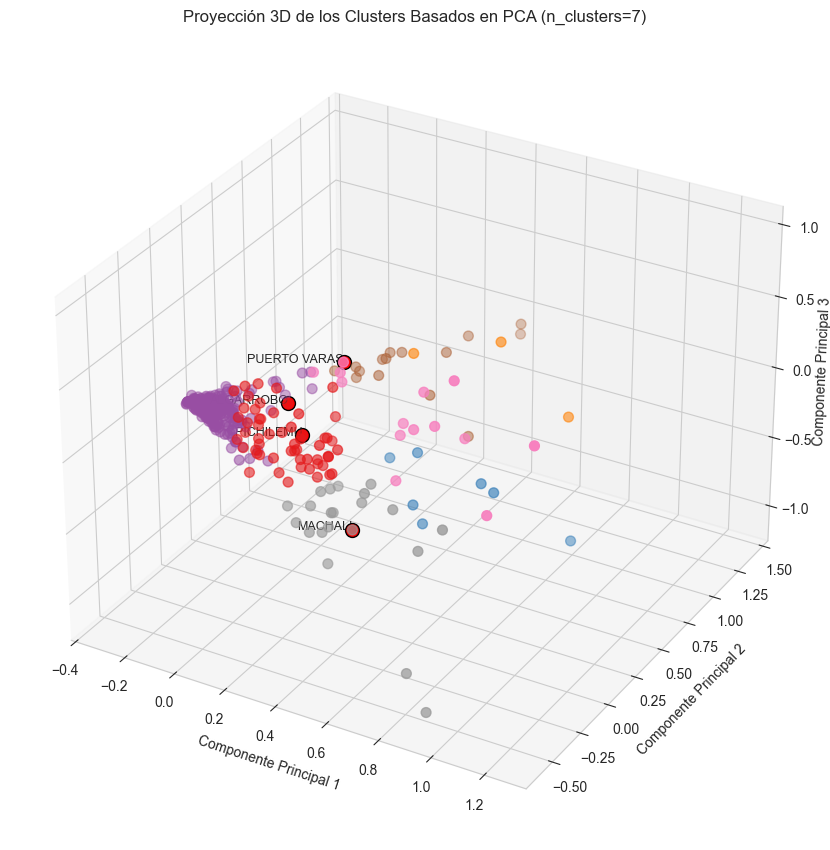

In [34]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]  # Aquí utilizas las variables que has definido para el clustering

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 3 componentes principales
pca_3d = PCA(n_components=3)  # Reducir a 3 componentes principales
PCA_ds = pd.DataFrame(pca_3d.fit_transform(X_normalizado), columns=['PC1', 'PC2', 'PC3'])

# Paso 4: Aplicar K-means con el número óptimo de clusters (aquí 7 clusters)
kmeans = KMeans(n_clusters=7, random_state=42)
PCA_ds['cluster'] = kmeans.fit_predict(PCA_ds)  # Asignar los clusters a PCA_ds sin modificar la data original

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Graficamos los clusters en 3D
fig = plt.figure(figsize=(9,9))  # Ajuste del tamaño a 10x8 para hacerlo más compacto
ax = fig.add_subplot(111, projection="3d")

# Colorear los puntos por clusters
scatter = ax.scatter(x, y, z, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = PCA_ds['cluster'].nunique()  # Contar cuántos clusters únicos hay
ax.set_title(f"Proyección 3D de los Clusters Basados en PCA (n_clusters={n_clusters})")
ax.set_xlabel('Componente Principal 1', labelpad=5)
ax.set_ylabel('Componente Principal 2', labelpad=5)
ax.set_zlabel('Componente Principal 3', labelpad=0)

# Añadir leyenda para los clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", bbox_to_anchor=(1.2, 1))
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy, cz in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2'], comunas_interes['PC3']):
    ax.scatter(cx, cy, cz, color='red', s=100, label=f'{comuna}', edgecolor='black')
    ax.text(cx, cy, cz, comuna, fontsize=9, ha='right')

# Ajuste del gráfico para evitar que las etiquetas se corten
plt.tight_layout()
plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

# Mostrar el gráfico
plt.show()


In [35]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import plotly.graph_objects as go

def graficar_clusters_pca_3d_interactivo(data, variables_clustering, n_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Aplicar PCA para reducir a 3 componentes principales
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X_normalizado)
    pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

    # Imprimir las varianzas explicadas por cada componente principal
    varianzas_explicadas = pca.explained_variance_ratio_
    print("Varianzas explicadas por cada componente principal:")
    for i, varianza in enumerate(varianzas_explicadas):
        print(f"PC{i + 1}: {varianza:.4f}")

    # Paso 4: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_pca)

    # Proyección 3D de los datos en base a PCA
    x = pca_df['PC1']
    y = pca_df['PC2']
    z = pca_df['PC3']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters y mostrar la leyenda con los clusters asignados
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=pca_df.loc[cluster_data.index, 'PC1'],
            y=pca_df.loc[cluster_data.index, 'PC2'],
            z=pca_df.loc[cluster_data.index, 'PC3'],
            mode='markers',
            marker=dict(size=5, opacity=0.8),
            name=f'Cluster {cluster_num}',
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=pca_df.loc[pos_comunas.index, 'PC1'], 
        y=pca_df.loc[pos_comunas.index, 'PC2'], 
        z=pca_df.loc[pos_comunas.index, 'PC3'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas Destacadas'
    ))

    # Personalizar el gráfico (ajustar el tamaño)
    fig.update_layout(
        title=f'Clusters Basados en Componentes Principales (PCA)',
        scene=dict(
            xaxis_title='Componente Principal 1',
            yaxis_title='Componente Principal 2',
            zaxis_title='Componente Principal 3'
        ),
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        legend_title_text='Clusters'
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3069
PC2: 0.1755
PC3: 0.1310


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



### Sin PCA

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



Silhouette Score para el modelo: 0.4017


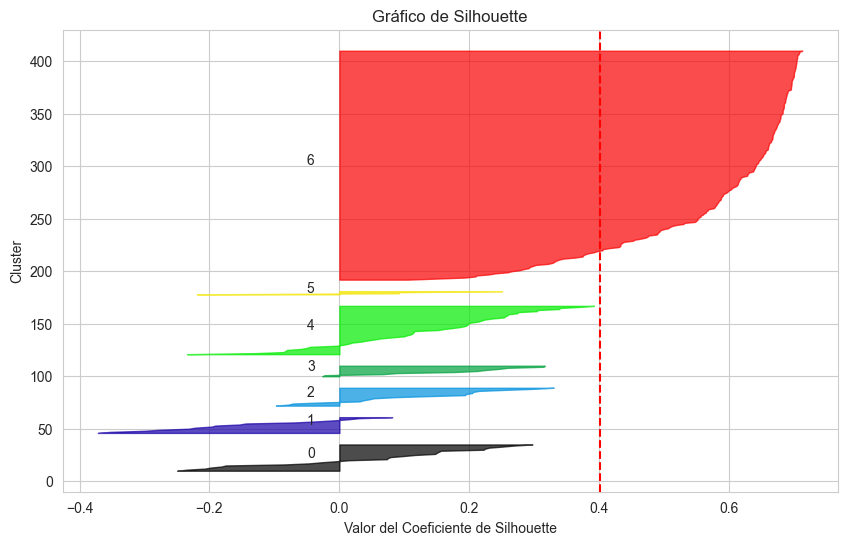

C:\Users\franc\AppData\Local\Temp\ipykernel_22960\1928401704.py:82: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



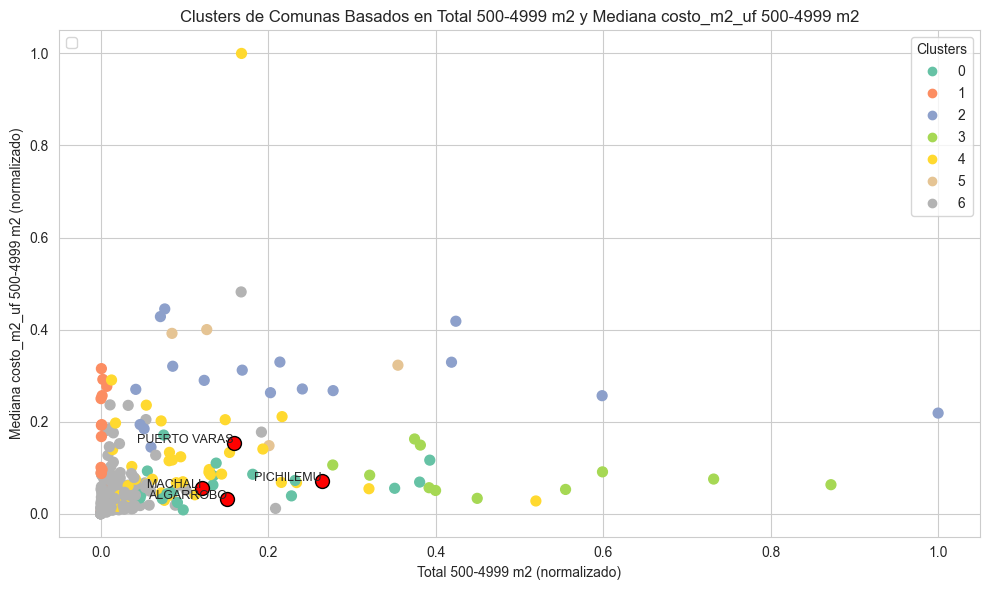


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 0
Comuna MACHALI pertenece al cluster 4
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               98.769231         314.384615          1171.153846   
1                3.000000           4.312500             7.750000   
2              142.833333         527.555556           137.444444   
3              383.000000        1126.000000          1539.454545   
4               77.191489         227.404255           279.723404   
5              121.000000         444.000000           118.750000   
6               14.652968          37.977169           146.908676   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                     

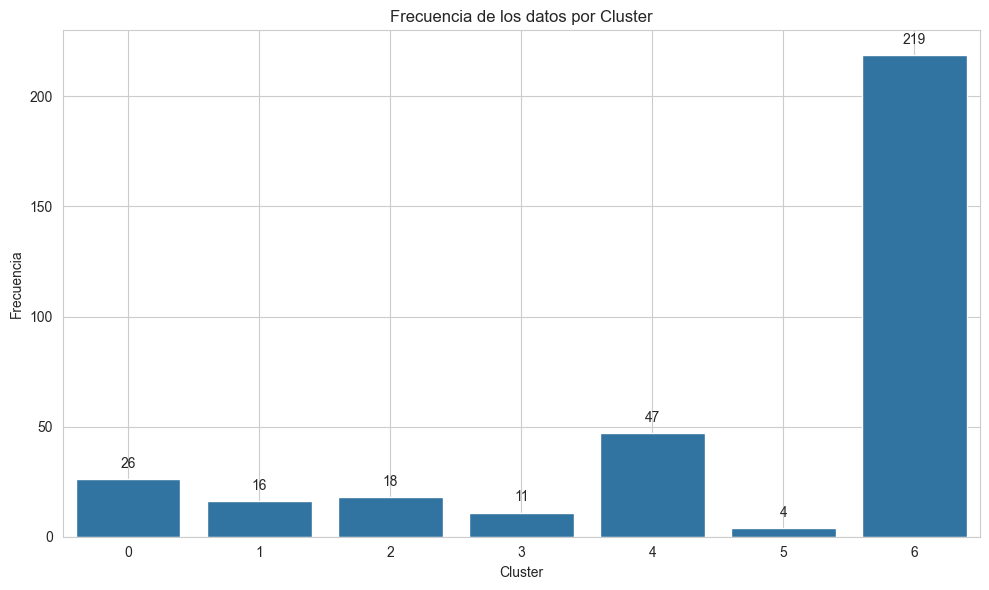

In [36]:
resultados_clustering2 = realizar_clustering_sin_pca(data_estadisticos,variables_clustering,7, False, True,'Total 500-4999 m2', 'Mediana costo_m2_uf 500-4999 m2')

In [37]:
# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_SinPCA_2.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = resultados_clustering2[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_SinPCA_2.csv


In [38]:
# Leer el archivo CSV generado con los resultados del clustering sin PCA
Kmeans_SinPCA_2 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster
frecuencia_clusters_SinPCA_2 = Kmeans_SinPCA_2['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_SinPCA_2)


cluster
0     26
1     16
2     18
3     11
4     47
5      4
6    219
Name: count, dtype: int64


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



Pesos de cada variable en los centroides de los 7 clusters:
   Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
0          0.153846           0.135921             0.279045   
1          0.004673           0.001864             0.001847   
2          0.222482           0.228083             0.032748   
3          0.596573           0.486814             0.366799   
4          0.120236           0.098316             0.066648   
5          0.188474           0.191958             0.028294   
6          0.022824           0.016419             0.035003   

   Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
0               0.346996                        0.028336   
1               0.005688                        0.043453   
2               0.057732                        0.057885   
3               0.479158                        0.032107   
4               0.121311                        0.032610   
5               0.056740                        0.052989   
6              

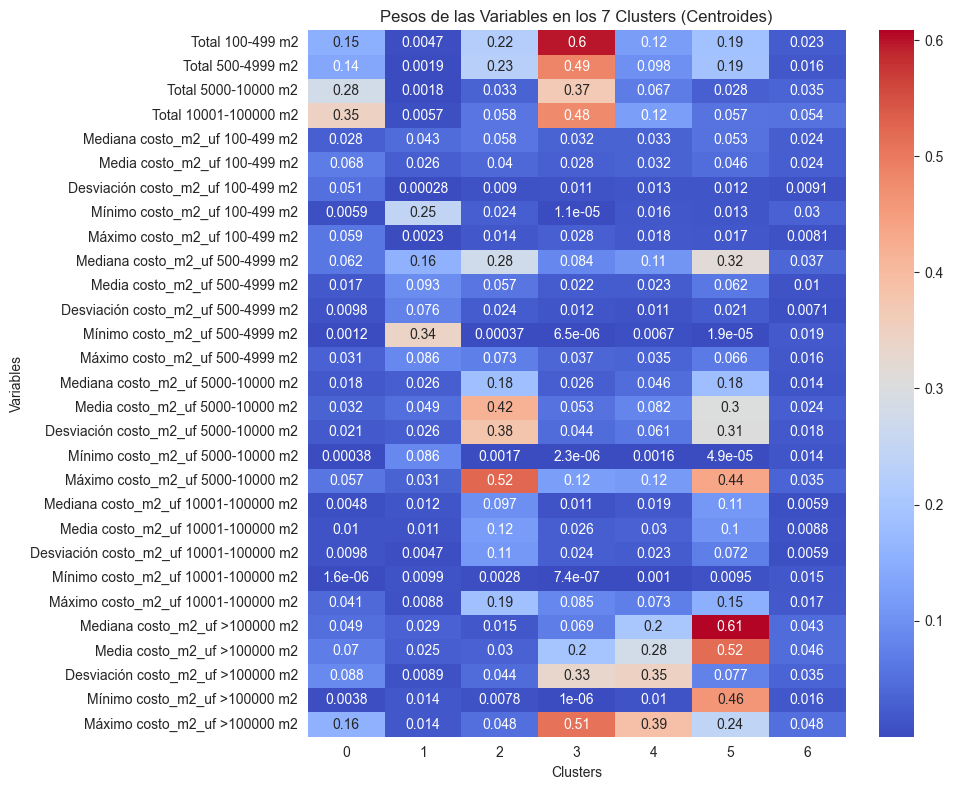

In [39]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar K-means con 7 clusters
kmeans = KMeans(n_clusters=7, random_state=42)
kmeans.fit(X_normalizado)

# Paso 4: Extraer los centroides
centroides = pd.DataFrame(kmeans.cluster_centers_, columns=variables_clustering)

# Paso 5: Visualizar el peso de cada variable en los centroides
print("Pesos de cada variable en los centroides de los 7 clusters:")
print(centroides)

# Opcional: Visualizar los pesos en un gráfico de calor
plt.figure(figsize=(10, 8))
sns.heatmap(centroides.T, annot=True, cmap="coolwarm", yticklabels=variables_clustering)
plt.title("Pesos de las Variables en los 7 Clusters (Centroides)")
plt.xlabel("Clusters")
plt.ylabel("Variables")
plt.tight_layout()
plt.show()


### Gráfico 3D

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



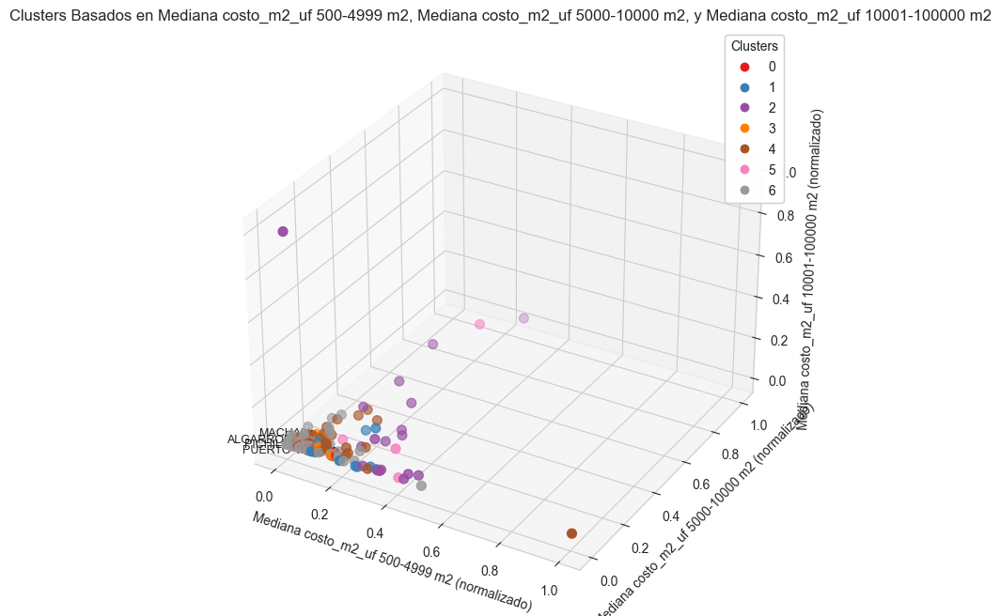

In [40]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def graficar_clusters_3d(data, variables_clustering, var_x, var_y, var_z, n_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Paso 3: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Graficar los puntos coloreados por el cluster al que pertenecen
    scatter = ax.scatter(x, y, z, c=data_copia['cluster'], cmap='Set1', s=50)

    # Personalización del gráfico
    ax.set_title(f'Clusters Basados en {var_x}, {var_y}, y {var_z}')
    ax.set_xlabel(f'{var_x} (normalizado)')
    ax.set_ylabel(f'{var_y} (normalizado)')
    ax.set_zlabel(f'{var_z} (normalizado)')

    # Añadir leyenda de clusters
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
    plt.gca().add_artist(legend1)

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir las comunas de interés al gráfico
    for comuna, x_val, y_val, z_val in zip(pos_comunas['comuna_match'], 
                                           X_normalizado.loc[pos_comunas.index, var_x],
                                           X_normalizado.loc[pos_comunas.index, var_y],
                                           X_normalizado.loc[pos_comunas.index, var_z]):
        ax.scatter(x_val, y_val, z_val, color='red', s=100, label=f'{comuna}', edgecolor='black')
        ax.text(x_val, y_val, z_val, comuna, fontsize=9, ha='right')

    # Mostrar el gráfico
    plt.show()

# Llamar a la función con las variables de interés
graficar_clusters_3d(
    data_estadisticos, 
    variables_clustering,
    'Mediana costo_m2_uf 500-4999 m2', 
    'Mediana costo_m2_uf 5000-10000 m2', 
    'Mediana costo_m2_uf 10001-100000 m2',
    n_clusters=7  # Número de clusters que ya tienes
)



C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



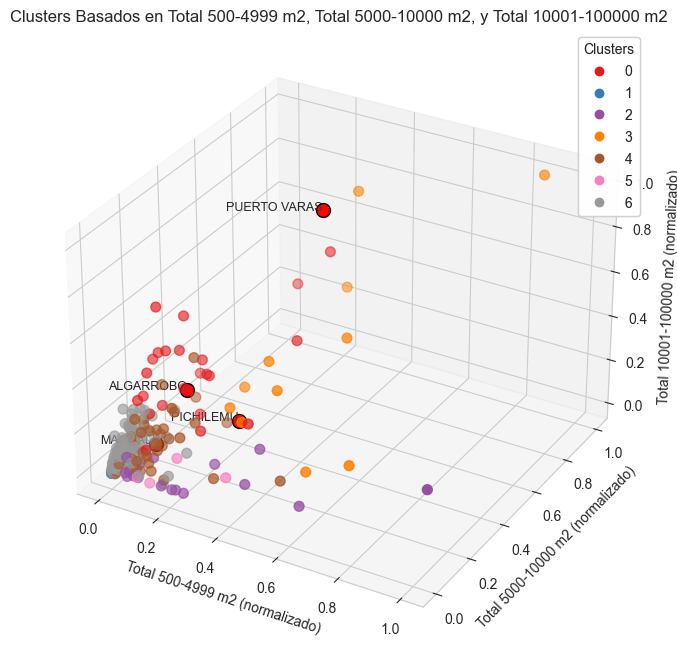

In [41]:
graficar_clusters_3d(data_estadisticos, variables_clustering,'Total 500-4999 m2','Total 5000-10000 m2','Total 10001-100000 m2',7)

In [42]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import plotly.graph_objects as go
import plotly.express as px

def graficar_clusters_3d_interactivo(data, variables_clustering, var_x, var_y, var_z, n_clusters, limite_ejes=0.5):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Paso 3: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters
    colors = px.colors.qualitative.Set1  # Definir una paleta de colores cualitativa para los clusters
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=X_normalizado.loc[cluster_data.index, var_x], 
            y=X_normalizado.loc[cluster_data.index, var_y], 
            z=X_normalizado.loc[cluster_data.index, var_z],
            mode='markers',
            marker=dict(size=5, color=colors[cluster_num % len(colors)], opacity=0.8),
            name=f'Cluster {cluster_num}',  # Añadir el nombre del cluster
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=X_normalizado.loc[pos_comunas.index, var_x], 
        y=X_normalizado.loc[pos_comunas.index, var_y], 
        z=X_normalizado.loc[pos_comunas.index, var_z],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas de Interés',  # Añadir nombre para las comunas de interés
        showlegend=True  # Mostrar leyenda para estas comunas
    ))

    # Personalizar el gráfico con los límites de los ejes
    fig.update_layout(
        title=f'Clusters Basados en {var_x}, {var_y}, y {var_z}',
        scene=dict(
            xaxis=dict(title=f'{var_x} (normalizado)', range=[0, limite_ejes]),
            yaxis=dict(title=f'{var_y} (normalizado)', range=[0, limite_ejes]),
            zaxis=dict(title=f'{var_z} (normalizado)', range=[0, limite_ejes])
        ),
        width=1200,  # Ancho del gráfico
        height=900   # Altura del gráfico,
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés y límites de los ejes
graficar_clusters_3d_interactivo(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=7,  # Número de clusters
    limite_ejes=0.5  # Límite para los ejes X, Y, Z
)


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



## DBScan N° datos, media, mediana y desv

### Llamado de variable
Dado que se iterará el tipo de normalización, este se hará en cada clustering.

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Variables a normalizar
variables_clustering = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]



### StandarScaler PCA

Varianzas explicadas por cada componente principal:
PC1: 0.2222
PC2: 0.1610
PC3: 0.1215
PC4: 0.1103
PC5: 0.1048


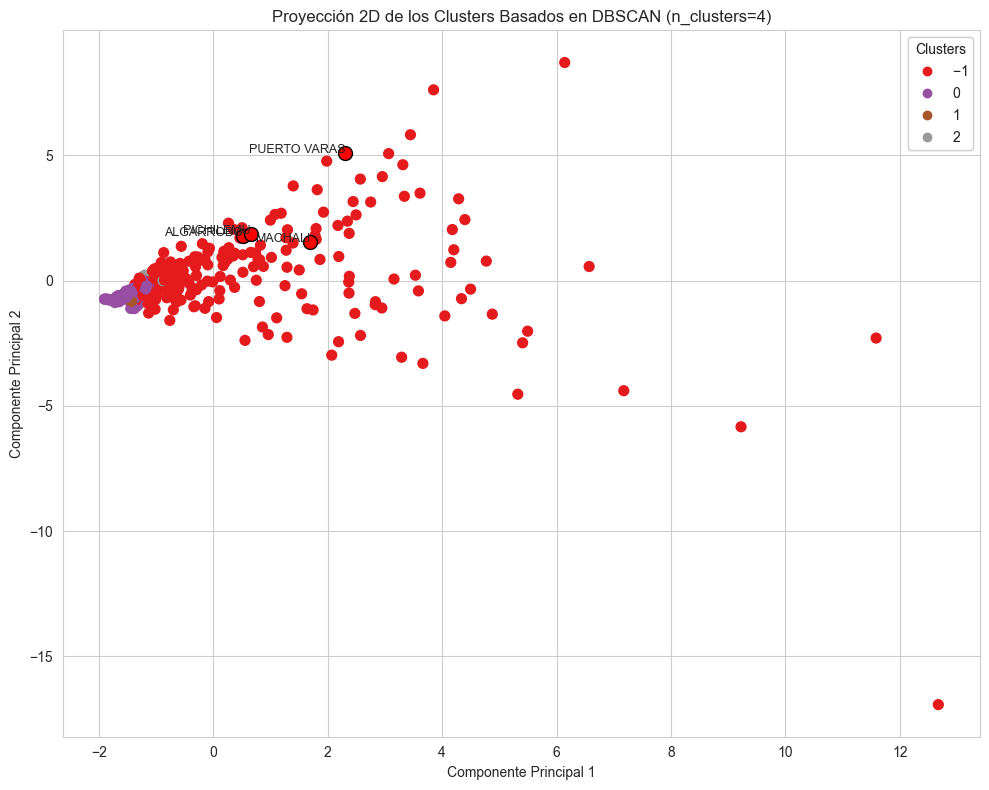

Distribución de puntos por cluster:
cluster
-1    239
 0     90
 2      7
 1      5
Name: count, dtype: int64


In [27]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Estandarizar las características usando StandardScaler
scaler = StandardScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 5 componentes principales
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X_normalizado)
PCA_ds = pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(5)])

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 4: Aplicar DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Ajusta los parámetros según sea necesario
PCA_ds['cluster'] = dbscan.fit_predict(X_normalizado)

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 2D de los datos después de realizar la reducción de dimensiones a 2 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]

# Graficamos los clusters en 2D
plt.figure(figsize=(10, 8))
scatter = plt.scatter(x, y, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = len(set(PCA_ds['cluster'])) - (1 if -1 in PCA_ds['cluster'] else 0)  # Contar los clusters únicos (excluyendo el ruido)
plt.title(f"Proyección 2D de los Clusters Basados en DBSCAN (n_clusters={n_clusters})")
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')

# Añadir leyenda para los clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2']):
    plt.scatter(cx, cy, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(cx, cy, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

# Mostrar la cantidad de puntos en cada cluster (incluyendo ruido)
print("Distribución de puntos por cluster:")
print(PCA_ds['cluster'].value_counts())


### Gráfico 3D

In [28]:
import plotly.graph_objects as go
import numpy as np

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Crear un gráfico 3D interactivo con Plotly
fig = go.Figure()

# Añadir los puntos de los clusters
unique_clusters = PCA_ds['cluster'].unique()  # Encontrar clusters únicos
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_clusters)))  # Generar colores para cada cluster

for cluster, color in zip(unique_clusters, colors):
    cluster_data = PCA_ds[PCA_ds['cluster'] == cluster]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['PC1'], 
        y=cluster_data['PC2'], 
        z=cluster_data['PC3'], 
        mode='markers',
        marker=dict(size=5, color=f'rgb({color[0] * 255}, {color[1] * 255}, {color[2] * 255})', opacity=0.8),
        name=f'Cluster {cluster}',  # Nombre del cluster en la leyenda
        text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
        hoverinfo='text'
    ))

# Destacar las comunas de interés
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir un trazo especial para destacar las comunas
fig.add_trace(go.Scatter3d(
    x=comunas_interes['PC1'], 
    y=comunas_interes['PC2'], 
    z=comunas_interes['PC3'],
    mode='markers+text',
    marker=dict(size=10, color='red', symbol='circle'),
    text=comunas_interes['comuna_match'],
    textposition='top center',
    hoverinfo='text',
    name="Comunas de Interés"  # Añadir esto a la leyenda
))

# Personalizar el gráfico
fig.update_layout(
    title=f'Clusters Basados en Componentes Principales (DBSCAN)',
    scene=dict(
        xaxis_title='Componente Principal 1',
        yaxis_title='Componente Principal 2',
        zaxis_title='Componente Principal 3'
    ),
    legend_title_text='Clusters',
    width=1200,  # Ancho del gráfico
    height=900,  # Altura del gráfico
    showlegend=True  # Mostrar la leyenda
)

# Mostrar el gráfico interactivo
fig.show()


### StandarScale sin PCA

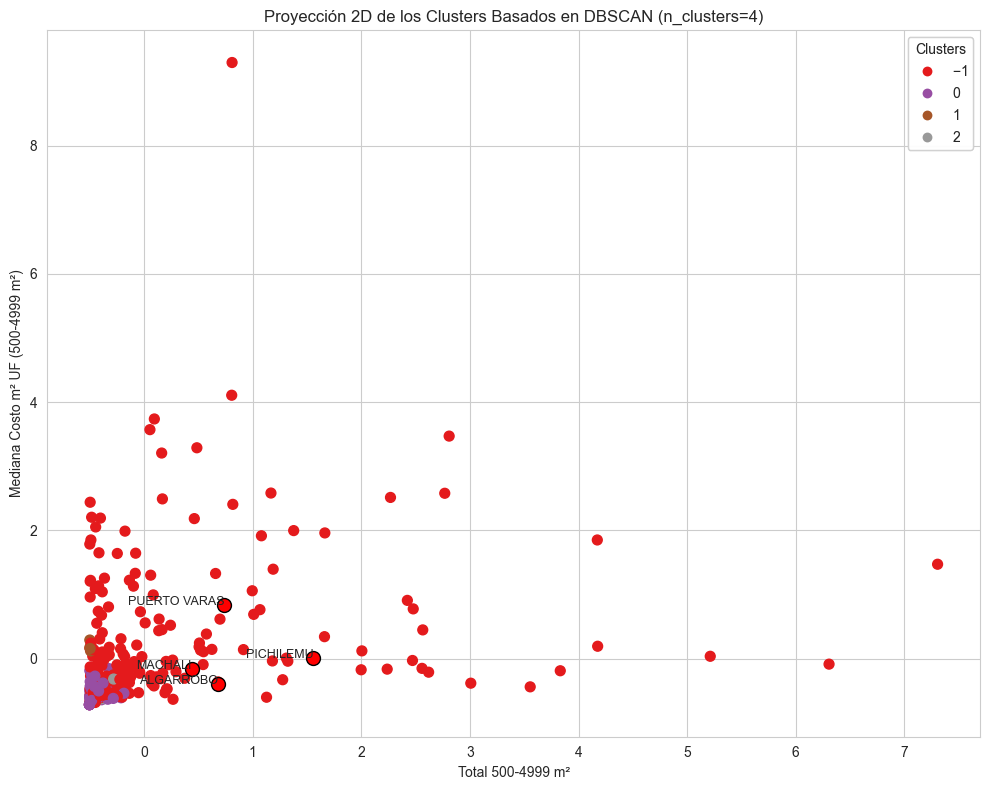

Distribución de puntos por cluster:
cluster
-1    239
 0     90
 2      7
 1      5
Name: count, dtype: int64


In [29]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Estandarizar las características usando StandardScaler
scaler = StandardScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Ajusta los parámetros según sea necesario
X_normalizado['cluster'] = dbscan.fit_predict(X_normalizado)

# Agregar la información de las comunas
X_normalizado['comuna_match'] = data_estadisticos['comuna_match']

# Paso 4: Proyección 2D usando las variables 'Total 500-4999 m2' y 'Mediana costo_m2_uf 500-4999 m2'
x = X_normalizado['Total 500-4999 m2']
y = X_normalizado['Mediana costo_m2_uf 500-4999 m2']

# Graficamos los clusters en 2D
plt.figure(figsize=(10, 8))
scatter = plt.scatter(x, y, c=X_normalizado['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = len(set(X_normalizado['cluster'])) - (1 if -1 in X_normalizado['cluster'] else 0)  # Contar los clusters únicos (excluyendo el ruido)
plt.title(f"Proyección 2D de los Clusters Basados en DBSCAN (n_clusters={n_clusters})")
plt.xlabel('Total 500-4999 m²')
plt.ylabel('Mediana Costo m² UF (500-4999 m²)')

# Añadir leyenda para los clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = X_normalizado[X_normalizado['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy in zip(comunas_interes['comuna_match'], comunas_interes['Total 500-4999 m2'], comunas_interes['Mediana costo_m2_uf 500-4999 m2']):
    plt.scatter(cx, cy, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(cx, cy, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

# Mostrar la cantidad de puntos en cada cluster (incluyendo ruido)
print("Distribución de puntos por cluster:")
print(X_normalizado['cluster'].value_counts())


### Gráfico en 3D

In [30]:
import plotly.graph_objects as go
import numpy as np

# Verificar si las columnas existen
if {'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2'}.issubset(X_normalizado.columns):
    # Proyección 3D de los datos usando las variables originales para los ejes
    x = X_normalizado['Total 500-4999 m2']
    y = X_normalizado['Total 5000-10000 m2']
    z = X_normalizado['Total 10001-100000 m2']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters
    unique_clusters = X_normalizado['cluster'].unique()  # Encontrar clusters únicos
    colors = plt.cm.viridis(np.linspace(0, 1, len(unique_clusters)))  # Generar colores para cada cluster

    for cluster, color in zip(unique_clusters, colors):
        cluster_data = X_normalizado[X_normalizado['cluster'] == cluster]
        fig.add_trace(go.Scatter3d(
            x=cluster_data['Total 500-4999 m2'], 
            y=cluster_data['Total 5000-10000 m2'], 
            z=cluster_data['Total 10001-100000 m2'], 
            mode='markers',
            marker=dict(size=5, color=f'rgb({color[0] * 255}, {color[1] * 255}, {color[2] * 255})', opacity=0.8),
            name=f'Cluster {cluster}',  # Nombre del cluster en la leyenda
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    comunas_interes = X_normalizado[X_normalizado['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=comunas_interes['Total 500-4999 m2'], 
        y=comunas_interes['Total 5000-10000 m2'], 
        z=comunas_interes['Total 10001-100000 m2'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=comunas_interes['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name="Comunas de Interés"  # Añadir esto a la leyenda
    ))

    # Personalizar el gráfico
    fig.update_layout(
        title=f'Clusters Basados en Variables de Superficie (DBSCAN)',
        scene=dict(
            xaxis_title='Total 500-4999 m²',
            yaxis_title='Total 5000-10000 m²',
            zaxis_title='Total 10001-100000 m²'
        ),
        legend_title_text='Clusters',
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        showlegend=True  # Mostrar la leyenda
    )

    # Mostrar el gráfico interactivo
    fig.show()
else:
    print("Error: Las columnas 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2' no están presentes en los datos.")


### MinMaxScaler PCA

Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669
PC4: 0.0589
PC5: 0.0474


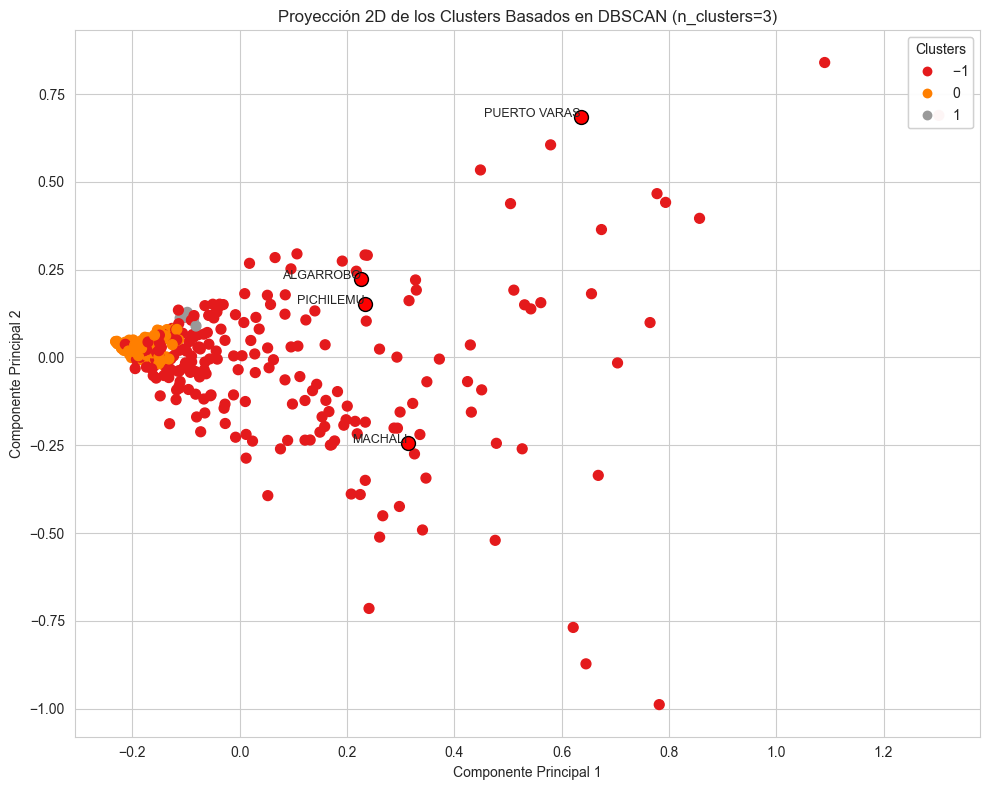

Distribución de puntos por cluster:
cluster
-1    236
 0     98
 1      7
Name: count, dtype: int64


In [31]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 5 componentes principales
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X_normalizado)
PCA_ds = pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(5)])

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 4: Aplicar DBSCAN con un eps ajustado
dbscan = DBSCAN(eps=0.05, min_samples=5)  # Ajusta eps (se sugiere un valor menor como 0.1)
PCA_ds['cluster'] = dbscan.fit_predict(X_normalizado)

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 2D de los datos después de realizar la reducción de dimensiones a 2 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]

# Graficamos los clusters en 2D
plt.figure(figsize=(10, 8))
scatter = plt.scatter(x, y, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = len(set(PCA_ds['cluster'])) - (1 if -1 in PCA_ds['cluster'] else 0)  # Contar los clusters únicos (excluyendo el ruido)
plt.title(f"Proyección 2D de los Clusters Basados en DBSCAN (n_clusters={n_clusters})")
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')

# Añadir leyenda para los clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2']):
    plt.scatter(cx, cy, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(cx, cy, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

# Mostrar la cantidad de puntos en cada cluster (incluyendo ruido)
print("Distribución de puntos por cluster:")
print(PCA_ds['cluster'].value_counts())


### Gráfico 3D

In [32]:
import plotly.graph_objects as go
import numpy as np

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Crear un gráfico 3D interactivo con Plotly
fig = go.Figure()

# Añadir los puntos de los clusters
unique_clusters = PCA_ds['cluster'].unique()  # Encontrar clusters únicos
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_clusters)))  # Generar colores para cada cluster

for cluster, color in zip(unique_clusters, colors):
    cluster_data = PCA_ds[PCA_ds['cluster'] == cluster]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['PC1'], 
        y=cluster_data['PC2'], 
        z=cluster_data['PC3'], 
        mode='markers',
        marker=dict(size=5, color=f'rgb({color[0] * 255}, {color[1] * 255}, {color[2] * 255})', opacity=0.8),
        name=f'Cluster {cluster}',  # Nombre del cluster en la leyenda
        text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
        hoverinfo='text'
    ))

# Destacar las comunas de interés
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir un trazo especial para destacar las comunas
fig.add_trace(go.Scatter3d(
    x=comunas_interes['PC1'], 
    y=comunas_interes['PC2'], 
    z=comunas_interes['PC3'],
    mode='markers+text',
    marker=dict(size=10, color='red', symbol='circle'),
    text=comunas_interes['comuna_match'],
    textposition='top center',
    hoverinfo='text',
    name="Comunas de Interés"  # Añadir esto a la leyenda
))

# Personalizar el gráfico
fig.update_layout(
    title=f'Clusters Basados en Componentes Principales (DBSCAN)',
    scene=dict(
        xaxis_title='Componente Principal 1',
        yaxis_title='Componente Principal 2',
        zaxis_title='Componente Principal 3'
    ),
    legend_title_text='Clusters',
    width=1200,  # Ancho del gráfico
    height=900,  # Altura del gráfico
    showlegend=True  # Mostrar la leyenda
)

# Mostrar el gráfico interactivo
fig.show()


### MinMaxScaler Sin PCA

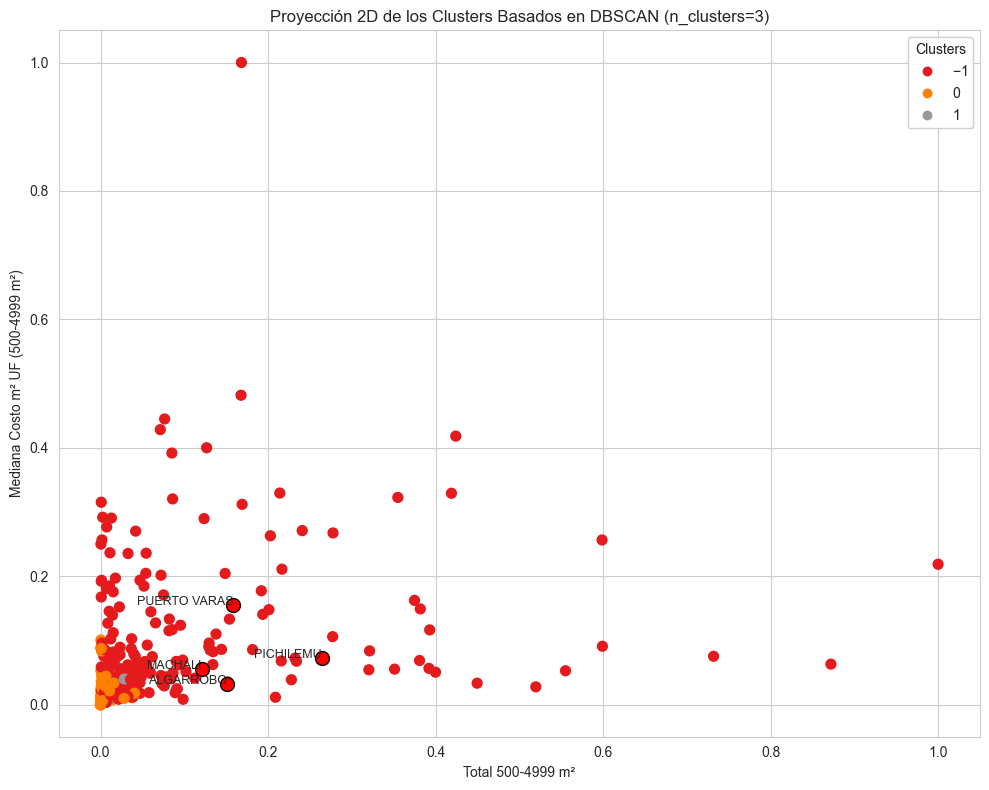

Distribución de puntos por cluster:
cluster
-1    236
 0     98
 1      7
Name: count, dtype: int64


In [33]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Estandarizar las características usando StandardScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar DBSCAN
dbscan = DBSCAN(eps=0.05, min_samples=5)  # Ajusta los parámetros según sea necesario
X_normalizado['cluster'] = dbscan.fit_predict(X_normalizado)

# Agregar la información de las comunas
X_normalizado['comuna_match'] = data_estadisticos['comuna_match']

# Paso 4: Proyección 2D usando las variables 'Total 500-4999 m2' y 'Mediana costo_m2_uf 500-4999 m2'
x = X_normalizado['Total 500-4999 m2']
y = X_normalizado['Mediana costo_m2_uf 500-4999 m2']

# Graficamos los clusters en 2D
plt.figure(figsize=(10, 8))
scatter = plt.scatter(x, y, c=X_normalizado['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = len(set(X_normalizado['cluster'])) - (
    1 if -1 in X_normalizado['cluster'] else 0)  # Contar los clusters únicos (excluyendo el ruido)
plt.title(f"Proyección 2D de los Clusters Basados en DBSCAN (n_clusters={n_clusters})")
plt.xlabel('Total 500-4999 m²')
plt.ylabel('Mediana Costo m² UF (500-4999 m²)')

# Añadir leyenda para los clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = X_normalizado[X_normalizado['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy in zip(comunas_interes['comuna_match'], comunas_interes['Total 500-4999 m2'],
                          comunas_interes['Mediana costo_m2_uf 500-4999 m2']):
    plt.scatter(cx, cy, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(cx, cy, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

# Mostrar la cantidad de puntos en cada cluster (incluyendo ruido)
print("Distribución de puntos por cluster:")
print(X_normalizado['cluster'].value_counts())


In [34]:
import plotly.graph_objects as go
import numpy as np

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Crear un gráfico 3D interactivo con Plotly
fig = go.Figure()

# Añadir los puntos de los clusters
unique_clusters = PCA_ds['cluster'].unique()  # Encontrar clusters únicos
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_clusters)))  # Generar colores para cada cluster

for cluster, color in zip(unique_clusters, colors):
    cluster_data = PCA_ds[PCA_ds['cluster'] == cluster]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['PC1'], 
        y=cluster_data['PC2'], 
        z=cluster_data['PC3'], 
        mode='markers',
        marker=dict(size=5, color=f'rgb({color[0] * 255}, {color[1] * 255}, {color[2] * 255})', opacity=0.8),
        name=f'Cluster {cluster}',  # Nombre del cluster en la leyenda
        text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
        hoverinfo='text'
    ))

# Destacar las comunas de interés
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir un trazo especial para destacar las comunas
fig.add_trace(go.Scatter3d(
    x=comunas_interes['PC1'], 
    y=comunas_interes['PC2'], 
    z=comunas_interes['PC3'],
    mode='markers+text',
    marker=dict(size=10, color='red', symbol='circle'),
    text=comunas_interes['comuna_match'],
    textposition='top center',
    hoverinfo='text',
    name="Comunas de Interés"  # Añadir esto a la leyenda
))

# Personalizar el gráfico
fig.update_layout(
    title=f'Clusters Basados en Componentes Principales (DBSCAN)',
    scene=dict(
        xaxis_title='Componente Principal 1',
        yaxis_title='Componente Principal 2',
        zaxis_title='Componente Principal 3'
    ),
    legend_title_text='Clusters',
    width=1200,  # Ancho del gráfico
    height=900,  # Altura del gráfico
    showlegend=True  # Mostrar la leyenda
)

# Mostrar el gráfico interactivo
fig.show()


## RobustScaler media, mediana y desv

### Normalización de variables

In [48]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
# Paso 1: Variables a normalizar
variables_clustering = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]

# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = RobustScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### PCA

Varianzas explicadas por cada componente principal:
PC1: 0.3912
PC2: 0.1704
PC3: 0.1682
PC4: 0.1149
PC5: 0.0463


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks t

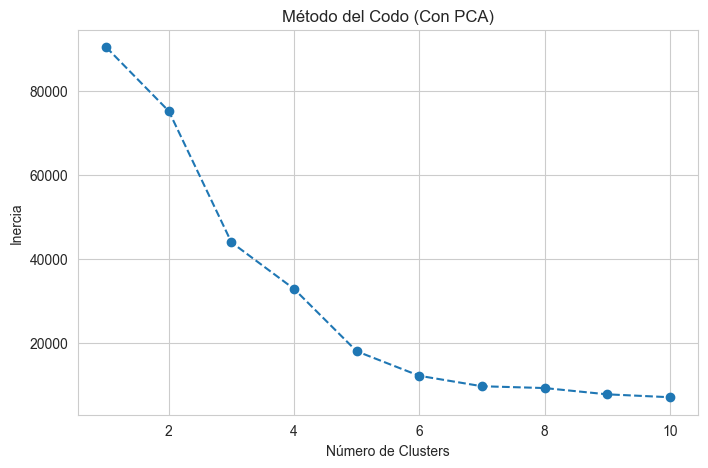

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



Silhouette Score para el modelo: 0.5745


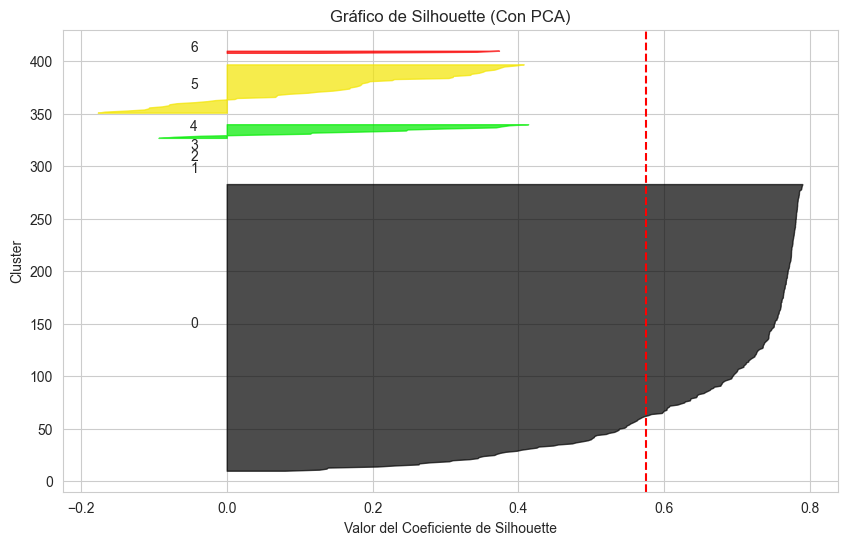

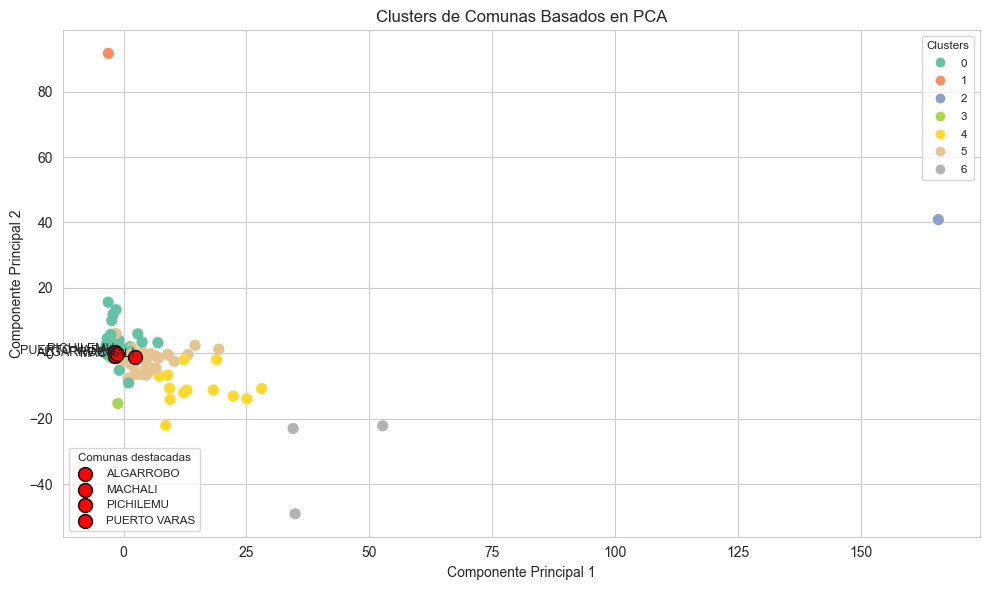

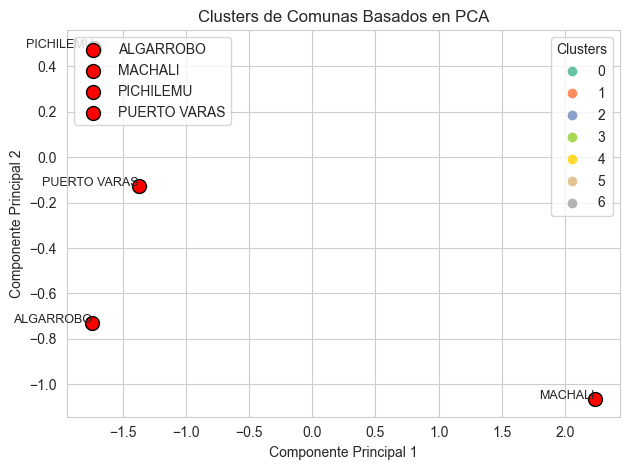


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
          PC1        PC2        PC3         PC4        PC5
0   -2.311463   0.722555  -1.431495   -0.416712  -0.926501
1   -3.101511  91.719035  81.925212    3.391290  -2.292749
2  165.791246  40.874774 -43.718185    5.668098  -1.859678
3   -1.164606 -15.329570   8.423252  103.179479  -9.259884
4   14.200773 -10.176405  11.373953   -1.373279   2.092660
5    3.210381  -1.671784   1.816453    1.016700   5.969514
6   40.705675 -31.400239  33.663582   -8.872913 -14.196917

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 5
Comuna MACHALI pertenece al cluster 0
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Pesos de cada variable en las componentes principales:
     Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
PC1          0.018162           0.029226            -0.006615   
PC2         -0.048162          -0.045718   

In [49]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
# Paso 4: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  # Reducir a 5 componentes principales
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 5: Método del codo para determinar el número óptimo de clusters
inertia = []
for k in range(1, 11):  # Probar con diferentes valores de K
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca)
    inertia.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia, marker='o', linestyle='--')
plt.title('Método del Codo (Con PCA)')
plt.xlabel('Número de Clusters')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()

# Paso 6: Aplicar K-means con el número óptimo de clusters (por ejemplo, K=6)
kmeans = KMeans(n_clusters=7, random_state=42)
data_copia = data_estadisticos.copy()  # Crear una copia para no modificar la original
data_copia['cluster'] = kmeans.fit_predict(X_pca)

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_copia['cluster'])
print(f"Silhouette Score para el modelo: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_copia['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(7):
    ith_cluster_silhouette_values = sample_silhouette_values[data_copia['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / 7)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color,
                      alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Con PCA)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")

plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 7: Identificar las posiciones de las comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

# Paso 8: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_copia['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas con un color especial
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters con tamaño de fuente ajustado
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Añadir puntos destacados para las comunas especificadas
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters")
plt.gca().add_artist(legend1)

# Añadir la leyenda personalizada
plt.legend(loc="upper left")
plt.title('Clusters de Comunas Basados en PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 9: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(kmeans.cluster_centers_, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 10: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_copia['comuna_match'].values:
        cluster_comuna = data_copia[data_copia['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 11: Mostrar cuánto pesa cada variable en cada componente principal
pesos_variables = pd.DataFrame(pca.components_, columns=variables_clustering, index=[f'PC{i+1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en las componentes principales:")
print(pesos_variables)

# Paso 12: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_copia.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_copia.groupby('cluster')[variables_clustering].median()

# Imprimir la media por cluster
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)


### Gráfico 3D

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



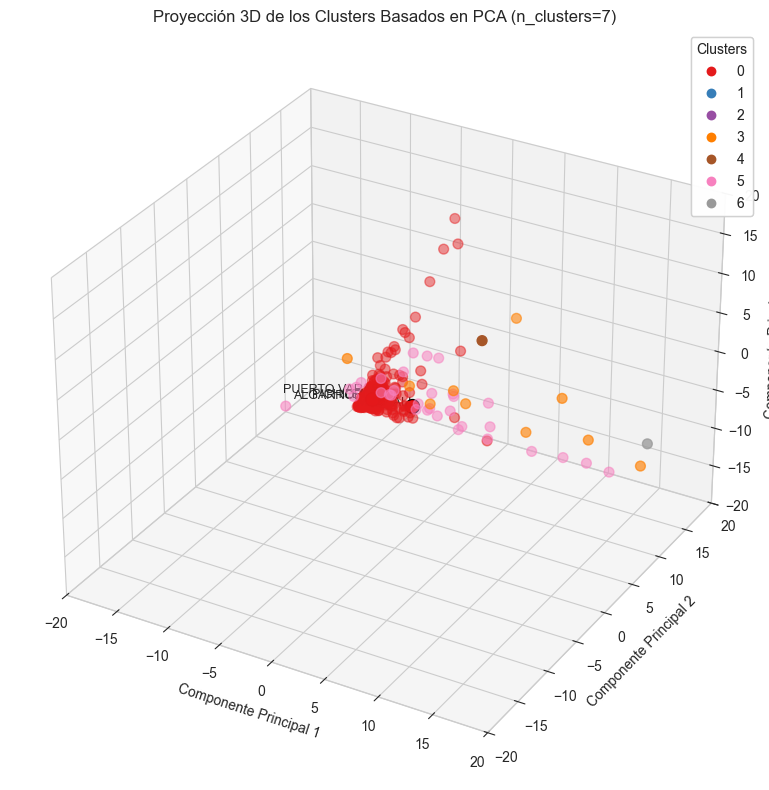

In [54]:
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]  # Aquí utilizas las variables que has definido para el clustering

# Paso 2: Normalizar las características usando RobustScaler
scaler = RobustScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 3 componentes principales
pca_3d = PCA(n_components=3)  # Reducir a 3 componentes principales
PCA_ds = pd.DataFrame(pca_3d.fit_transform(X_normalizado), columns=['PC1', 'PC2', 'PC3'])

# Paso 4: Aplicar K-means con el número óptimo de clusters (aquí 7 clusters)
kmeans = KMeans(n_clusters=7, random_state=42)
PCA_ds['cluster'] = kmeans.fit_predict(PCA_ds)  # Asignar los clusters a PCA_ds sin modificar la data original

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Graficamos los clusters en 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# Colorear los puntos por clusters
scatter = ax.scatter(x, y, z, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
n_clusters = PCA_ds['cluster'].nunique()  # Contar cuántos clusters únicos hay
ax.set_title(f"Proyección 3D de los Clusters Basados en PCA (n_clusters={n_clusters})")
ax.set_xlabel('Componente Principal 1')
ax.set_ylabel('Componente Principal 2')
ax.set_zlabel('Componente Principal 3')

# Establecer límites en los ejes
ax.set_xlim([-20, 20])  # Limitar el eje X
ax.set_ylim([-20, 20])  # Limitar el eje Y
ax.set_zlim([-20, 20])  # Limitar el eje Z

# Añadir leyenda para los clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy, cz in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2'],
                              comunas_interes['PC3']):
    ax.scatter(cx, cy, cz, color='red', s=100, label=f'{comuna}', edgecolor='black')
    ax.text(cx, cy, cz, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()



In [55]:
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import plotly.graph_objects as go

def graficar_clusters_pca_3d_interactivo(data, variables_clustering, n_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando RobustScaler
    scaler = RobustScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Aplicar PCA para reducir a 3 componentes principales
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X_normalizado)
    pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

    # Imprimir las varianzas explicadas por cada componente principal
    varianzas_explicadas = pca.explained_variance_ratio_
    print("Varianzas explicadas por cada componente principal:")
    for i, varianza in enumerate(varianzas_explicadas):
        print(f"PC{i + 1}: {varianza:.4f}")

    # Paso 4: Aplicar K-means con el número especificado de clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    data_copia['cluster'] = kmeans.fit_predict(X_pca)

    # Proyección 3D de los datos en base a PCA
    x = pca_df['PC1']
    y = pca_df['PC2']
    z = pca_df['PC3']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters y mostrar la leyenda con los clusters asignados
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=pca_df.loc[cluster_data.index, 'PC1'],
            y=pca_df.loc[cluster_data.index, 'PC2'],
            z=pca_df.loc[cluster_data.index, 'PC3'],
            mode='markers',
            marker=dict(size=5, opacity=0.8),
            name=f'Cluster {cluster_num}',
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=pca_df.loc[pos_comunas.index, 'PC1'], 
        y=pca_df.loc[pos_comunas.index, 'PC2'], 
        z=pca_df.loc[pos_comunas.index, 'PC3'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas Destacadas'
    ))

    # Definir límites de los ejes basados en los datos
    x_min, x_max = x.min(), x.max()
    y_min, y_max = y.min(), y.max()
    z_min, z_max = z.min(), z.max()

    # Personalizar el gráfico (ajustar el tamaño y los ejes)
    fig.update_layout(
        title=f'Clusters Basados en Componentes Principales (PCA)',
        scene=dict(
            xaxis=dict(title='Componente Principal 1', range=[x_min, x_max]),
            yaxis=dict(title='Componente Principal 2', range=[y_min, y_max]),
            zaxis=dict(title='Componente Principal 3', range=[z_min, z_max])
        ),
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        legend_title_text='Clusters'
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3912
PC2: 0.1704
PC3: 0.1682


C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.



## Cluster Jerarquico N°Datos, media, mediana, desv

### Normalización de variables

In [78]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Paso 1: Variables a normalizar
variables_clustering = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]

# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### PCA

Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669
PC4: 0.0589
PC5: 0.0474


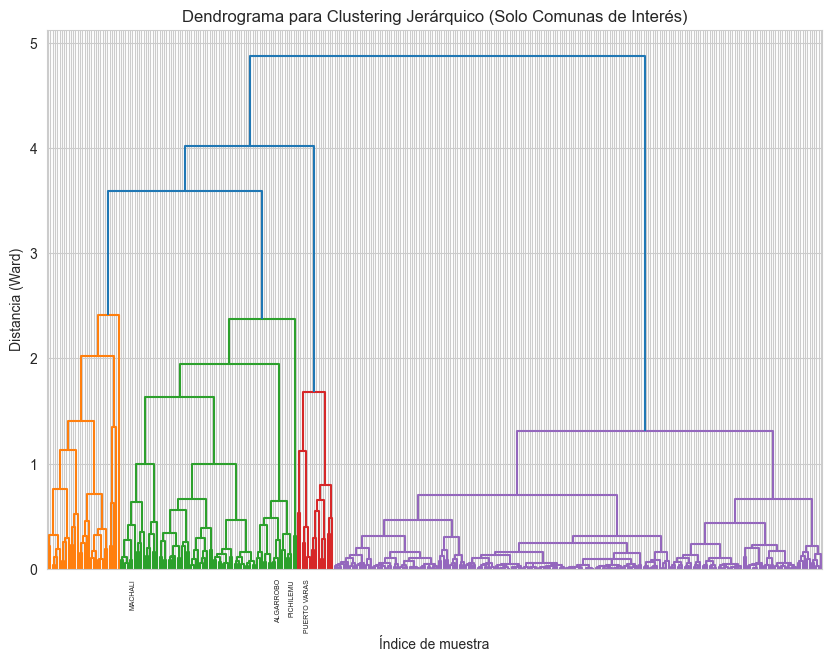

Silhouette Score para el modelo jerárquico: 0.4639


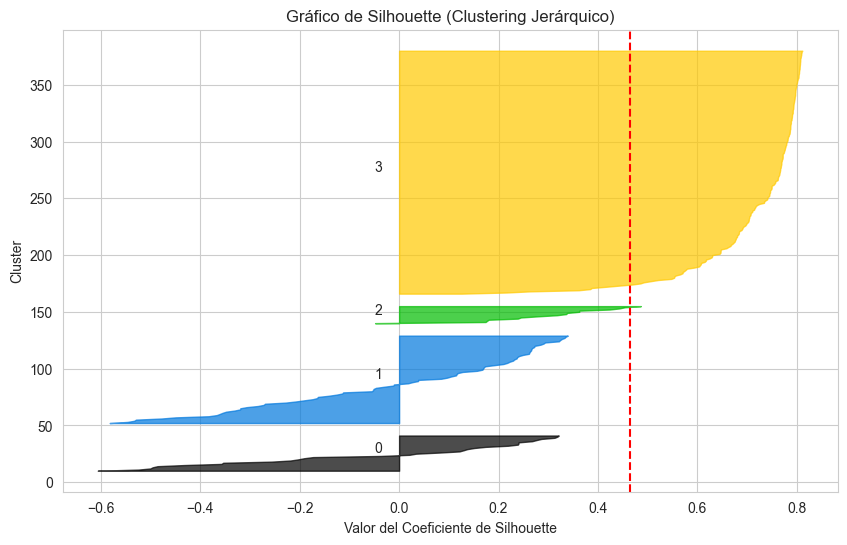

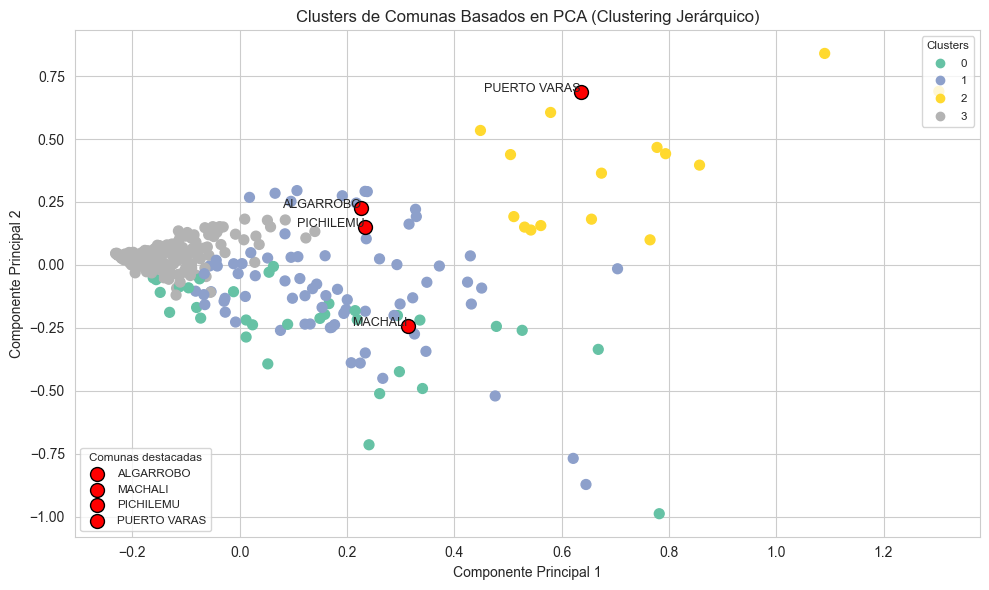


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
          PC1       PC2       PC3       PC4       PC5
0    0.226689  0.224492  0.035155 -0.002784  0.001401
1   -0.053336 -0.106581 -0.157740  0.046936  0.006947
2   -0.130608 -0.188666  0.222447 -0.628110  1.559951
3   -0.117550 -0.092501  0.068497  0.086490 -0.020806
4    0.207894 -0.388951 -0.165365 -0.120817 -0.056503
..        ...       ...       ...       ...       ...
336  0.219117 -0.217333  0.570266 -0.153980 -0.020561
337 -0.125657  0.036628 -0.028230 -0.008977 -0.012617
338 -0.052974  0.119683 -0.034237 -0.025236 -0.016192
339 -0.158784  0.063823 -0.000963  0.022034  0.001658
340  0.329222  0.192063  0.171676  0.073207  0.025676

[341 rows x 5 columns]

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 1
Comuna ALGARROBO pertenece al cluster 1
Comuna PICHILEMU pertenece al cluster 1

Pesos de cada variable en la

In [51]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
import numpy as np

# Paso 4: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  # Reducir a 5 componentes principales
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Comunas de interés
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']

# Paso 5: Método del dendrograma para determinar el número óptimo de clusters
labels = [comuna if comuna in comunas_a_marcar else '' for comuna in data_estadisticos['comuna_match']]
linked = linkage(X_pca, method='ward')  # 'ward' minimiza la varianza dentro de los clusters

plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', labels=labels, distance_sort='descending', show_leaf_counts=True)
plt.title("Dendrograma para Clustering Jerárquico (Solo Comunas de Interés)")
plt.xlabel("Índice de muestra")
plt.ylabel("Distancia (Ward)")
plt.grid(True)
plt.show()

# Paso 6: Aplicar AgglomerativeClustering con el número óptimo de clusters
n_clusters = 4  # Puedes elegir el número de clusters basado en el dendrograma
agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
data_jerarquico_pca = data_estadisticos.copy()  # Crear una copia para no modificar el original
data_jerarquico_pca['cluster'] = agglomerative.fit_predict(X_pca)

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_jerarquico_pca['cluster'])
print(f"Silhouette Score para el modelo jerárquico: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_jerarquico_pca['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[data_jerarquico_pca['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Clustering Jerárquico)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")
plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 7: Identificar las posiciones de las comunas específicas
pos_comunas = data_jerarquico_pca[data_jerarquico_pca['comuna_match'].isin(comunas_a_marcar)]

# Paso 8: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_jerarquico_pca['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA (Clustering Jerárquico)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 9: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(X_pca, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 10: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_jerarquico_pca['comuna_match'].values:
        cluster_comuna = data_jerarquico_pca[data_jerarquico_pca['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 11: Mostrar cuánto pesa cada variable en cada componente principal
pesos_variables = pd.DataFrame(pca.components_, columns=variables_clustering, index=[f'PC{i+1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en las componentes principales:")
print(pesos_variables)

# Paso 12: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_jerarquico_pca.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_jerarquico_pca.groupby('cluster')[variables_clustering].median()

# Imprimir la media por cluster
pd.set_option('display.max_columns', None)  # No limitar las columnas mostradas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)


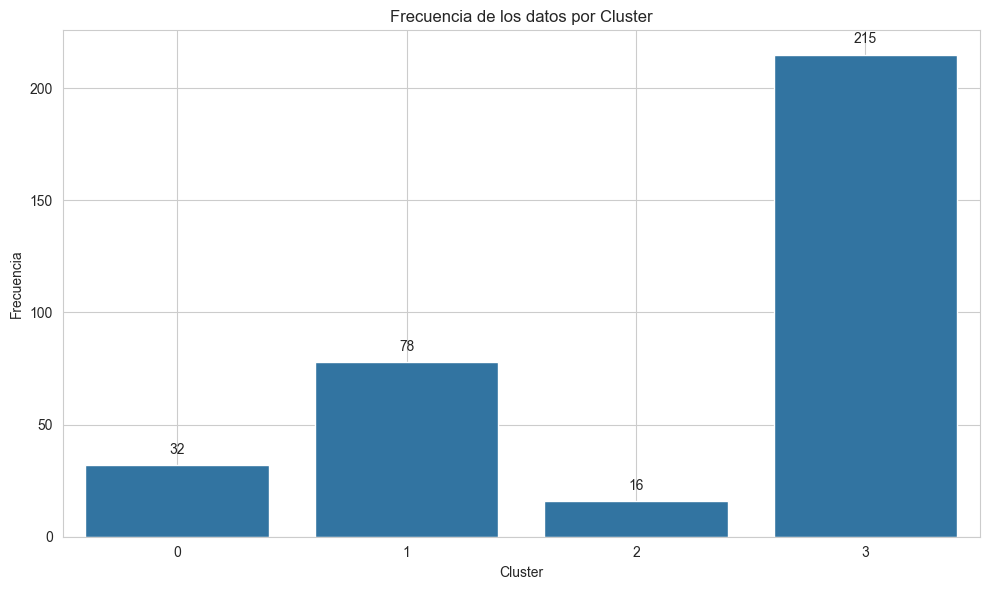

In [52]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
plt.figure(figsize=(10, 6))

# Contar la frecuencia de cada cluster en 'data_jerarquico_pca'
frecuencia_clusters = data_jerarquico_pca['cluster'].value_counts().sort_index()

# Graficar el gráfico de barras
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()



In [53]:
# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_1.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = data_jerarquico_pca[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_PCA_1.csv


In [54]:
# Leer el archivo CSV generado con los clusters
csv_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_1.csv"
clusters_jerarquico_pca = pd.read_csv(csv_file)

# Calcular las frecuencias por cluster
frecuencia_clusters_jerarquico_pca = clusters_jerarquico_pca['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(f"Frecuencia de los clusters en {csv_file}:")
print(frecuencia_clusters_jerarquico_pca)


Frecuencia de los clusters en data recuperada/comunas cluster/comunas_jerarquico_PCA_1.csv:
cluster
0     32
1     78
2     16
3    215
Name: count, dtype: int64


### Gráfico 3D

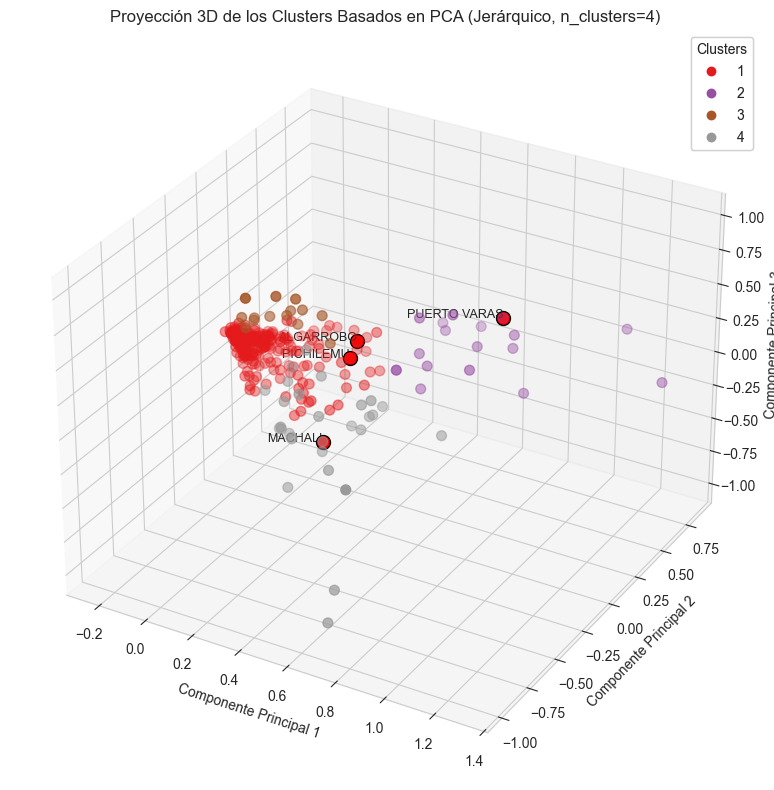

In [55]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import linkage, fcluster
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]  # Aquí utilizas las variables que has definido para el clustering

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 3 componentes principales
pca_3d = PCA(n_components=3)  # Reducir a 3 componentes principales
PCA_ds = pd.DataFrame(pca_3d.fit_transform(X_normalizado), columns=['PC1', 'PC2', 'PC3'])

# Paso 4: Aplicar clustering jerárquico
Z = linkage(PCA_ds, method='ward')  # Usar el método de Ward para clustering jerárquico

# Seleccionar el número de clusters (por ejemplo, 7)
num_clusters = 4
PCA_ds['cluster'] = fcluster(Z, num_clusters, criterion='maxclust')

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Graficamos los clusters en 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# Colorear los puntos por clusters
scatter = ax.scatter(x, y, z, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
ax.set_title(f"Proyección 3D de los Clusters Basados en PCA (Jerárquico, n_clusters={num_clusters})")
ax.set_xlabel('Componente Principal 1')
ax.set_ylabel('Componente Principal 2')
ax.set_zlabel('Componente Principal 3')

# Añadir leyenda para los clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy, cz in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2'], comunas_interes['PC3']):
    ax.scatter(cx, cy, cz, color='red', s=100, label=f'{comuna}', edgecolor='black')
    ax.text(cx, cy, cz, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()


In [56]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import linkage, fcluster
import plotly.graph_objects as go

def graficar_clusters_pca_3d_interactivo(data, variables_clustering, num_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Aplicar PCA para reducir a 3 componentes principales
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X_normalizado)
    pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

    # Imprimir las varianzas explicadas por cada componente principal
    varianzas_explicadas = pca.explained_variance_ratio_
    print("Varianzas explicadas por cada componente principal:")
    for i, varianza in enumerate(varianzas_explicadas):
        print(f"PC{i + 1}: {varianza:.4f}")

    # Paso 4: Aplicar clustering jerárquico
    Z = linkage(X_pca, method='ward')  # Usar el método 'ward' para clustering jerárquico
    data_copia['cluster'] = fcluster(Z, num_clusters, criterion='maxclust') - 1  # Ajustar índices de cluster

    # Proyección 3D de los datos en base a PCA
    x = pca_df['PC1']
    y = pca_df['PC2']
    z = pca_df['PC3']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters y mostrar la leyenda con los clusters asignados
    for cluster_num in range(num_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=pca_df.loc[cluster_data.index, 'PC1'],
            y=pca_df.loc[cluster_data.index, 'PC2'],
            z=pca_df.loc[cluster_data.index, 'PC3'],
            mode='markers',
            marker=dict(size=5, opacity=0.8),
            name=f'Cluster {cluster_num}',
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=pca_df.loc[pos_comunas.index, 'PC1'], 
        y=pca_df.loc[pos_comunas.index, 'PC2'], 
        z=pca_df.loc[pos_comunas.index, 'PC3'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas Destacadas'
    ))

    # Personalizar el gráfico (ajustar el tamaño)
    fig.update_layout(
        title=f'Clusters Basados en Componentes Principales (PCA - Clustering Jerárquico)',
        scene=dict(
            xaxis_title='Componente Principal 1',
            yaxis_title='Componente Principal 2',
            zaxis_title='Componente Principal 3'
        ),
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        legend_title_text='Clusters'
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    num_clusters=4  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669


### 7 clusters

Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669
PC4: 0.0589
PC5: 0.0474


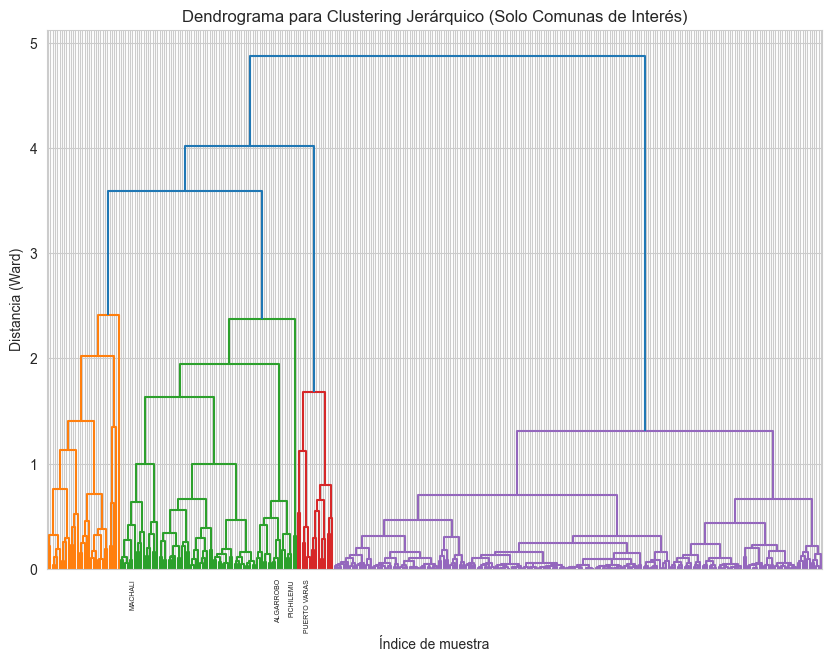

Silhouette Score para el modelo jerárquico: 0.4737


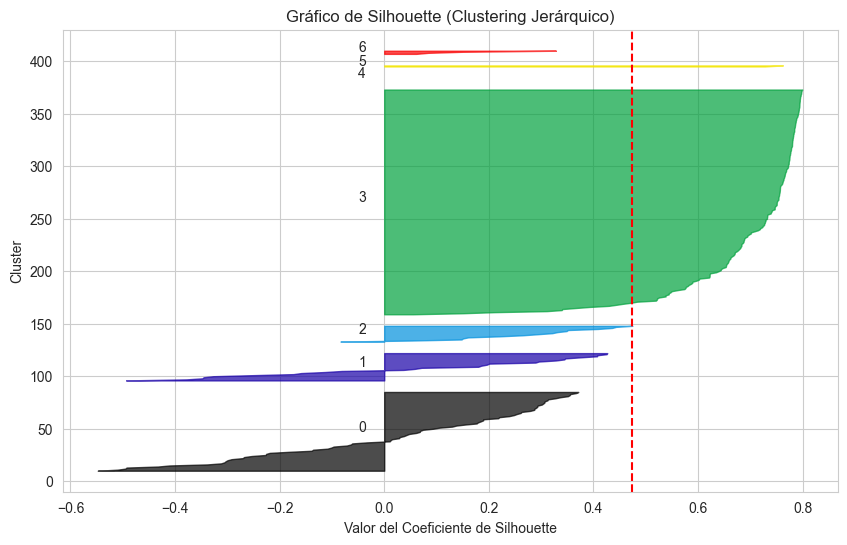

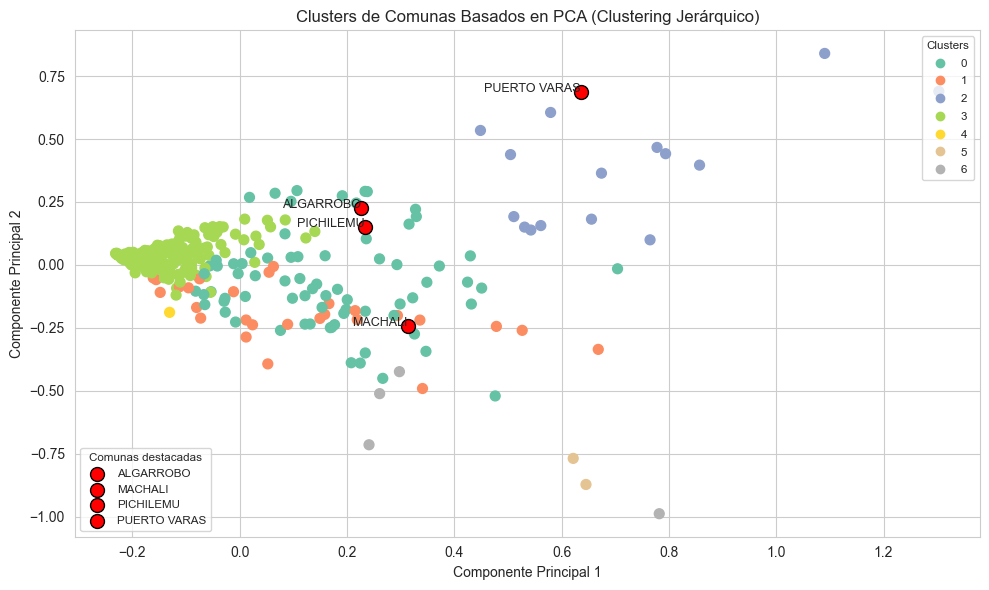

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_PCA_7.csv

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 0
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               72.473684         213.276316           406.578947   
1               92.740741         300.481481            86.481481   
2              344.875000        1095.875000          1782.562500   
3               12.204651          33.567442           156.339535   
4                2.000000           2.000000             5.000000   
5               18.500000          26.500000            38.500000   
6              132.000000         444.500000            81.500000   

         Total 1000

In [57]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
import numpy as np

# Paso 2: Aplicar PCA para reducir la dimensionalidad a 5 componentes principales
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Comunas de interés
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']

# Paso 3: Método del dendrograma para determinar el número óptimo de clusters
labels = [comuna if comuna in comunas_a_marcar else '' for comuna in data_estadisticos['comuna_match']]
linked = linkage(X_pca, method='ward')

plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', labels=labels, distance_sort='descending', show_leaf_counts=True)
plt.title("Dendrograma para Clustering Jerárquico (Solo Comunas de Interés)")
plt.xlabel("Índice de muestra")
plt.ylabel("Distancia (Ward)")
plt.grid(True)
plt.show()

# Paso 4: Aplicar AgglomerativeClustering con 7 clusters
n_clusters = 7
data_jerarquico_pca_7 = data_estadisticos.copy()
agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
data_jerarquico_pca_7['cluster'] = agglomerative.fit_predict(X_pca)

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_jerarquico_pca_7['cluster'])
print(f"Silhouette Score para el modelo jerárquico: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_jerarquico_pca_7['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[data_jerarquico_pca_7['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Clustering Jerárquico)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")
plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 5: Visualización de los clusters con identificación de comunas
pos_comunas = data_jerarquico_pca_7[data_jerarquico_pca_7['comuna_match'].isin(comunas_a_marcar)]

plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_jerarquico_pca_7['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas con un color especial
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')
plt.title('Clusters de Comunas Basados en PCA (Clustering Jerárquico)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 6: Guardar la data del clustering en un archivo CSV
output_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_7.csv"
data_jerarquico_pca_7[['comuna_match', 'cluster']].to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

# Paso 7: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_jerarquico_pca_7['comuna_match'].values:
        cluster_comuna = data_jerarquico_pca_7[data_jerarquico_pca_7['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 8: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_jerarquico_pca_7.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_jerarquico_pca_7.groupby('cluster')[variables_clustering].median()

# Imprimir la media por cluster
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)


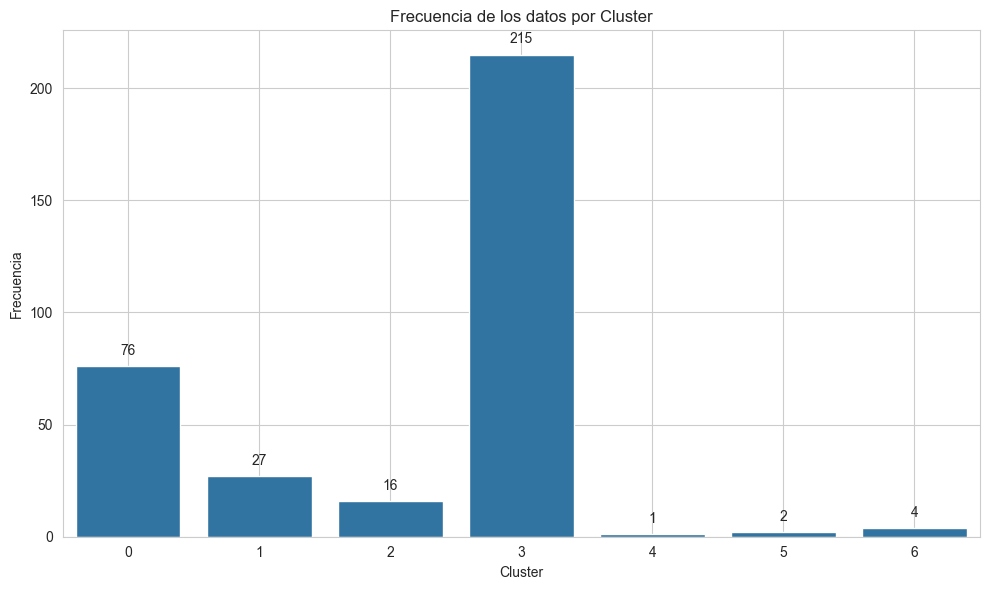

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
plt.figure(figsize=(10, 6))

# Contar la frecuencia de cada cluster en 'data_copia'
frecuencia_clusters = data_jerarquico_pca_7['cluster'].value_counts().sort_index()

# Graficar el gráfico de barras
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()

In [59]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_1_7CLUSTERS.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = data_jerarquico_pca_7[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_PCA_1_7CLUSTERS.csv


In [60]:
# Leer el archivo CSV guardado
Jerarq_PCA_1 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_jerarquico_7 = Jerarq_PCA_1['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_jerarquico_7)


cluster
0     76
1     27
2     16
3    215
4      1
5      2
6      4
Name: count, dtype: int64


### Gráfico 3D 7 Clústers

In [62]:

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    num_clusters=7  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3246
PC2: 0.1820
PC3: 0.1669


### Sin PCA

In [10]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage

def realizar_clustering_jerarquico_sin_pca(data, variables_clustering, n_clusters, mostrar_codo=True, mostrar_silhouette=True, var_x=None, var_y=None):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']

    # Paso 3: Método del dendrograma para determinar el número óptimo de clusters
    if mostrar_codo:
        # Crear etiquetas: mostrar solo las comunas de interés, el resto dejar en blanco
        labels = [comuna if comuna in comunas_a_marcar else '' for comuna in data_copia['comuna_match']]
        
        linked = linkage(X_normalizado, method='ward')
        plt.figure(figsize=(8, 5))
        dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True, labels=labels)
        plt.title('Dendrograma para Clustering Jerárquico (Solo Comunas de Interés)')
        plt.xlabel('Índice de muestra')
        plt.ylabel('Distancia (Ward)')
        plt.grid(True)
        plt.show()

    # Paso 4: Aplicar AgglomerativeClustering con el número especificado de clusters
    agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
    data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)

    # Paso 5: Calcular el Silhouette Score (opcional)
    if mostrar_silhouette:
        silhouette_avg = silhouette_score(X_normalizado, data_copia['cluster'])
        print(f"Silhouette Score para el modelo jerárquico: {silhouette_avg:.4f}")

        # Graficar el Silhouette Score para cada punto
        sample_silhouette_values = silhouette_samples(X_normalizado, data_copia['cluster'])

        plt.figure(figsize=(10, 6))
        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[data_copia['cluster'] == i]
            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = plt.cm.nipy_spectral(float(i) / n_clusters)
            plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

        plt.title("Gráfico de Silhouette (Clustering Jerárquico)")
        plt.xlabel("Valor del Coeficiente de Silhouette")
        plt.ylabel("Cluster")
        plt.axvline(x=silhouette_avg, color="red", linestyle="--")
        plt.grid(True)
        plt.show()

    # Paso 6: Visualización de los clusters en las dos variables seleccionadas
    if var_x is not None and var_y is not None:
        plt.figure(figsize=(10, 6))
        scatter = plt.scatter(X_normalizado[var_x], X_normalizado[var_y], c=data_copia['cluster'], cmap='Set2')

        # Añadir puntos destacados para las comunas especificadas
        pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

        for comuna, x, y in zip(pos_comunas['comuna_match'], X_normalizado.loc[pos_comunas.index, var_x], X_normalizado.loc[pos_comunas.index, var_y]):
            plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
            plt.text(x, y, comuna, fontsize=9, ha='right')

        # Añadir leyenda de clusters
        legend1 = plt.legend(*scatter.legend_elements(), title="Clusters")
        plt.gca().add_artist(legend1)

        # Añadir la leyenda personalizada para las comunas destacadas
        plt.legend(loc="upper left", title="Comunas destacadas")
        plt.title(f'Clusters de Comunas Basados en {var_x} y {var_y} (Clustering Jerárquico)')
        plt.xlabel(f'{var_x} (normalizado)')
        plt.ylabel(f'{var_y} (normalizado)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    # Paso 7: Identificar en qué cluster están las comunas de interés
    print("\nClusters de las comunas seleccionadas:")
    for comuna in comunas_a_marcar:
        if comuna in data_copia['comuna_match'].values:
            cluster_comuna = data_copia[data_copia['comuna_match'] == comuna]['cluster'].values[0]
            print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
        else:
            print(f"Comuna {comuna} no está presente en los datos.")

    # Paso 8: Mostrar estadísticas por cluster (media y mediana)
    media_por_cluster = data_copia.groupby('cluster')[variables_clustering].mean()
    mediana_por_cluster = data_copia.groupby('cluster')[variables_clustering].median()
    pd.set_option('display.max_columns', None)  # No limite el número de columnas mostradas
    print("\nMedia por cluster (solo variables seleccionadas):")
    print(media_por_cluster)
    print("\nMediana por cluster (solo variables seleccionadas):")
    print(mediana_por_cluster)

    # Paso 9: Generar histograma de frecuencia por cluster
   
    # Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
    plt.figure(figsize=(10, 6))
    
    # Contar la frecuencia de cada cluster en 'data_copia'
    frecuencia_clusters = data_copia['cluster'].value_counts().sort_index()
    
    # Graficar el gráfico de barras
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)
    
    # Añadir títulos y etiquetas
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')
    
    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)
    
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Retornar el DataFrame con los clusters asignados
    return data_copia  # Retorna la copia de los datos con los clusters asignados
# Llamar a la función con los datos y las variables de interés




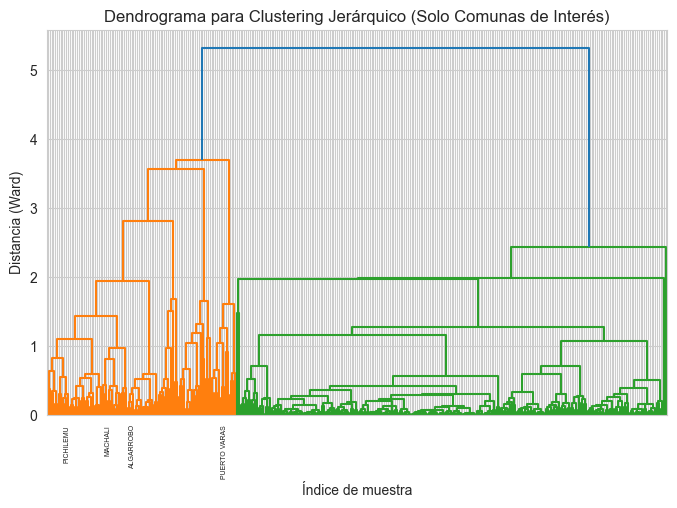

Silhouette Score para el modelo jerárquico: 0.4454


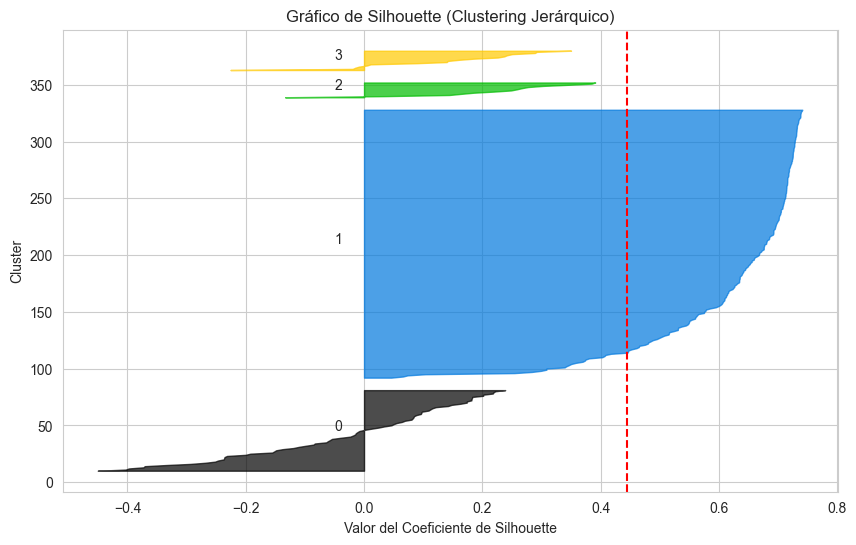

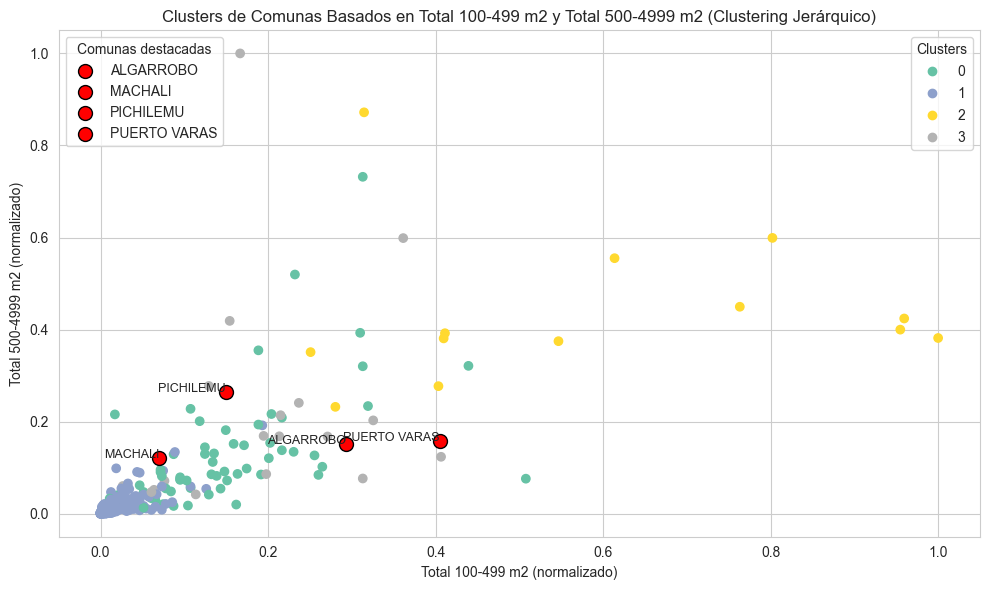


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 0
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               88.944444         279.736111           448.041667   
1               11.995781          33.531646           142.244726   
2              372.142857         966.285714          1981.857143   
3              125.777778         516.111111           114.444444   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                          
0                   158.152778                       12.568705   
1                    44.016878                       10.038116   
2                   442.428571                       13.956575   
3  

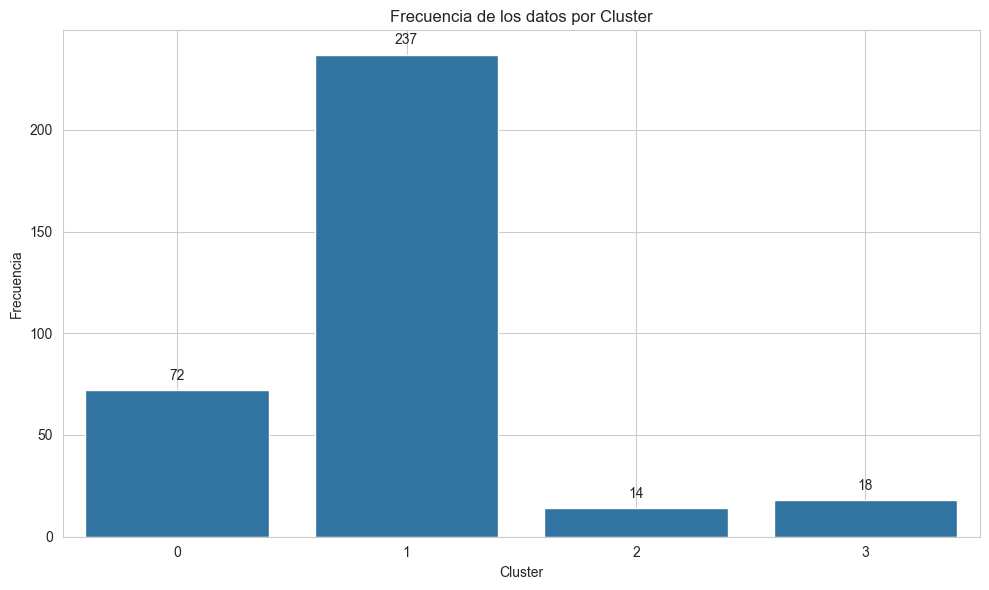

In [64]:
cluster_jerarquico_sin_pca1 = realizar_clustering_jerarquico_sin_pca(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=4,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='Total 100-499 m2',  # Variable en el eje X
    var_y='Total 500-4999 m2'  # Variable en el eje Y
)


In [65]:
# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_SinPCA_1.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = cluster_jerarquico_sin_pca1[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_SinPCA_1.csv


Pesos de cada variable en los centroides de los 4 clusters:
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               88.944444         279.736111           448.041667   
1               11.995781          33.531646           142.244726   
2              372.142857         966.285714          1981.857143   
3              125.777778         516.111111           114.444444   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                          
0                   158.152778                       12.568705   
1                    44.016878                       10.038116   
2                   442.428571                       13.956575   
3                    42.555556                       23.541715   

         Media costo_m2_uf 100-499 m2  Desviación costo_m2_uf 100-499 m2  \
cluster                                             

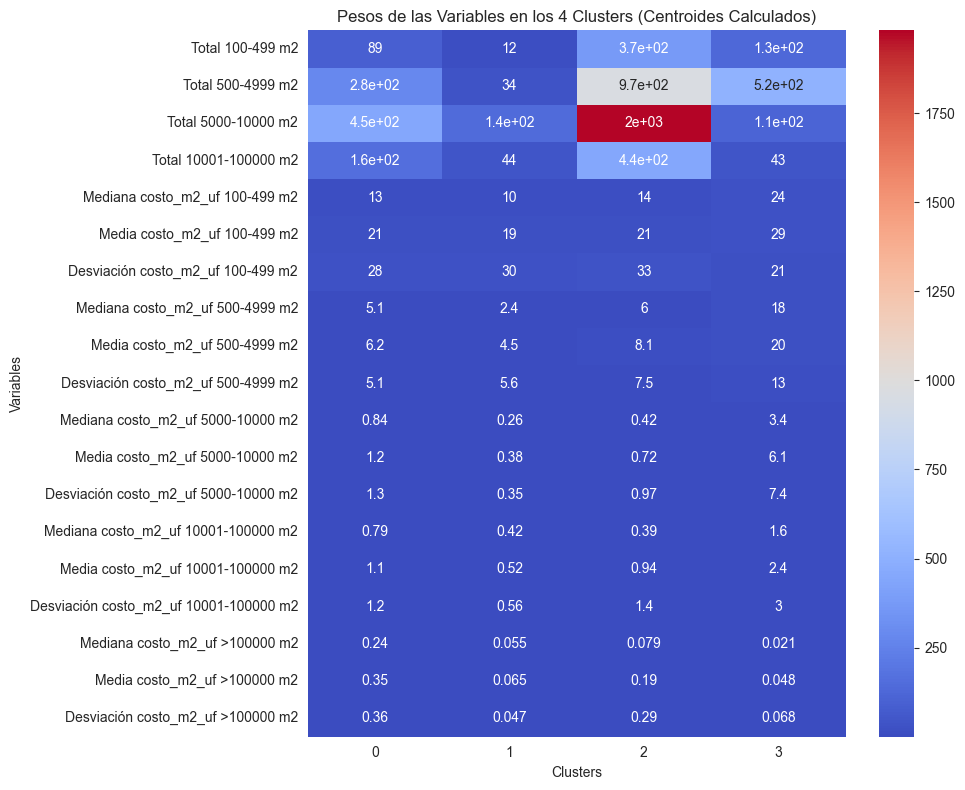

In [66]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar AgglomerativeClustering con el número óptimo de clusters
n_clusters = 4  # Ajustar según el número de clusters óptimo
agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
data_copia = data_estadisticos.copy()
data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)

# Paso 4: Calcular los "centroides" como la media de las variables por cluster
centroides = data_copia.groupby('cluster')[variables_clustering].mean()

# Paso 5: Visualizar el peso de cada variable en los centroides
print(f"Pesos de cada variable en los centroides de los {n_clusters} clusters:")
print(centroides)

# Paso 6: Visualizar los pesos en un gráfico de calor
plt.figure(figsize=(10, 8))
sns.heatmap(centroides.T, annot=True, cmap="coolwarm", yticklabels=variables_clustering)
plt.title(f"Pesos de las Variables en los {n_clusters} Clusters (Centroides Calculados)")
plt.xlabel("Clusters")
plt.ylabel("Variables")
plt.tight_layout()
plt.show()


### Gráfico 3D

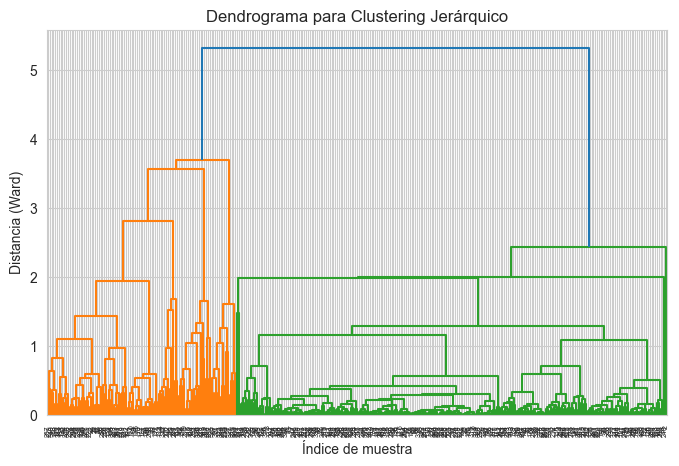

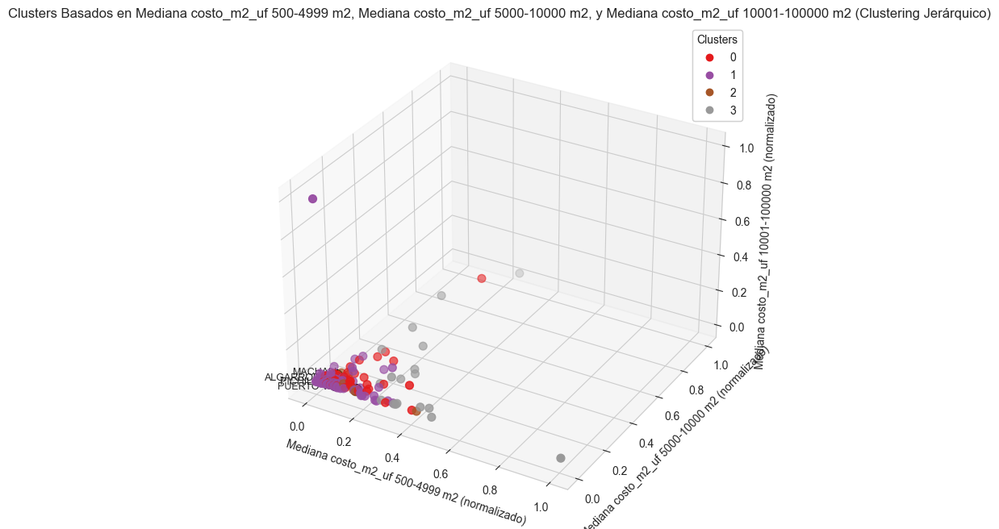

In [67]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import linkage, dendrogram

def graficar_clusters_jerarquico_3d(data, variables_clustering, var_x, var_y, var_z, n_clusters, mostrar_dendrograma=True):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Mostrar el dendrograma (opcional)
    if mostrar_dendrograma:
        linked = linkage(X_normalizado, method='ward')
        plt.figure(figsize=(8, 5))
        dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
        plt.title('Dendrograma para Clustering Jerárquico')
        plt.xlabel('Índice de muestra')
        plt.ylabel('Distancia (Ward)')
        plt.grid(True)
        plt.show()

    # Paso 3: Aplicar Agglomerative Clustering con el número especificado de clusters
    agglomerative = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Graficar los puntos coloreados por el cluster al que pertenecen
    scatter = ax.scatter(x, y, z, c=data_copia['cluster'], cmap='Set1', s=50)

    # Personalización del gráfico
    ax.set_title(f'Clusters Basados en {var_x}, {var_y}, y {var_z} (Clustering Jerárquico)')
    ax.set_xlabel(f'{var_x} (normalizado)')
    ax.set_ylabel(f'{var_y} (normalizado)')
    ax.set_zlabel(f'{var_z} (normalizado)')

    # Añadir leyenda de clusters
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
    plt.gca().add_artist(legend1)

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir las comunas de interés al gráfico
    for comuna, x_val, y_val, z_val in zip(pos_comunas['comuna_match'], 
                                           X_normalizado.loc[pos_comunas.index, var_x],
                                           X_normalizado.loc[pos_comunas.index, var_y],
                                           X_normalizado.loc[pos_comunas.index, var_z]):
        ax.scatter(x_val, y_val, z_val, color='red', s=100, label=f'{comuna}', edgecolor='black')
        ax.text(x_val, y_val, z_val, comuna, fontsize=9, ha='right')

    # Mostrar el gráfico
    plt.show()

# Llamar a la función con las variables de interés
graficar_clusters_jerarquico_3d(
    data_estadisticos, 
    variables_clustering,
    'Mediana costo_m2_uf 500-4999 m2', 
    'Mediana costo_m2_uf 5000-10000 m2', 
    'Mediana costo_m2_uf 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    mostrar_dendrograma=True  # Mostrar o no el dendrograma
)


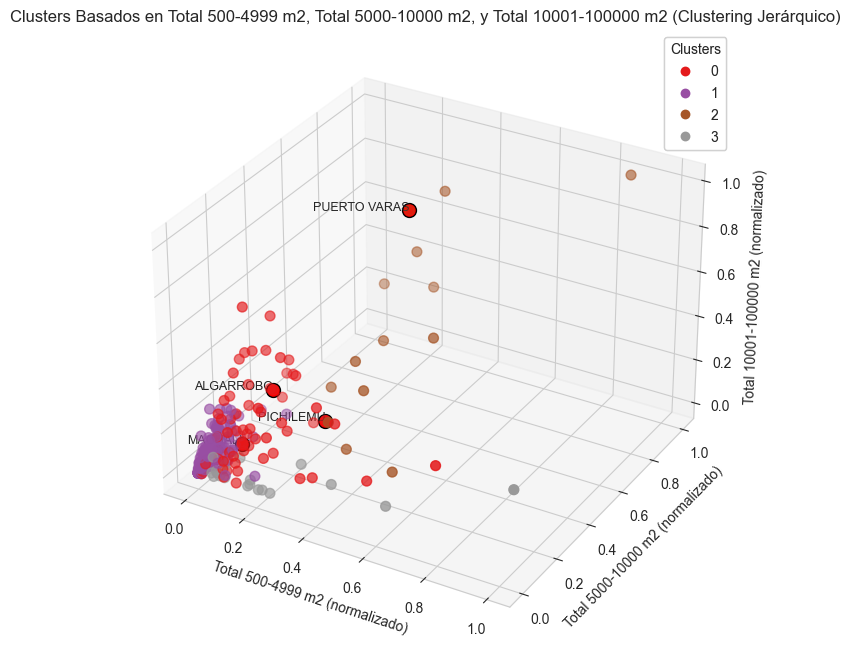

In [68]:
graficar_clusters_jerarquico_3d(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)


In [76]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering
import plotly.graph_objects as go
import plotly.express as px
from scipy.cluster.hierarchy import linkage, dendrogram

def graficar_clusters_jerarquico_3d_interactivo(data, variables_clustering, var_x, var_y, var_z, n_clusters, limite_ejes=0.5, mostrar_dendrograma=True):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Mostrar el dendrograma (opcional)
    if mostrar_dendrograma:
        linked = linkage(X_normalizado, method='ward')
        dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
        plt.title('Dendrograma para Clustering Jerárquico')
        plt.xlabel('Índice de muestra')
        plt.ylabel('Distancia (Ward)')
        plt.show()

    # Paso 4: Aplicar Agglomerative Clustering con el número especificado de clusters
    agglomerative = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters
    colors = px.colors.qualitative.Set1  # Definir una paleta de colores cualitativa para los clusters
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=X_normalizado.loc[cluster_data.index, var_x], 
            y=X_normalizado.loc[cluster_data.index, var_y], 
            z=X_normalizado.loc[cluster_data.index, var_z],
            mode='markers',
            marker=dict(size=5, color=colors[cluster_num % len(colors)], opacity=0.8),
            name=f'Cluster {cluster_num}',  # Añadir el nombre del cluster
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=X_normalizado.loc[pos_comunas.index, var_x], 
        y=X_normalizado.loc[pos_comunas.index, var_y], 
        z=X_normalizado.loc[pos_comunas.index, var_z],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas de Interés',  # Añadir nombre para las comunas de interés
        showlegend=True  # Mostrar leyenda para estas comunas
    ))

    # Personalizar el gráfico con los límites de los ejes
    fig.update_layout(
        title=f'Clusters Basados en {var_x}, {var_y}, y {var_z} (Clustering Jerárquico)',
        scene=dict(
            xaxis=dict(title=f'{var_x} (normalizado)', range=[0, limite_ejes]),
            yaxis=dict(title=f'{var_y} (normalizado)', range=[0, limite_ejes]),
            zaxis=dict(title=f'{var_z} (normalizado)', range=[0, limite_ejes])
        ),
        width=1200,  # Ancho del gráfico
        height=900   # Altura del gráfico
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés y límites de los ejes
graficar_clusters_jerarquico_3d_interactivo(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    limite_ejes=0.8,  # Límite para los ejes X, Y, Z
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)


### 7 clusters

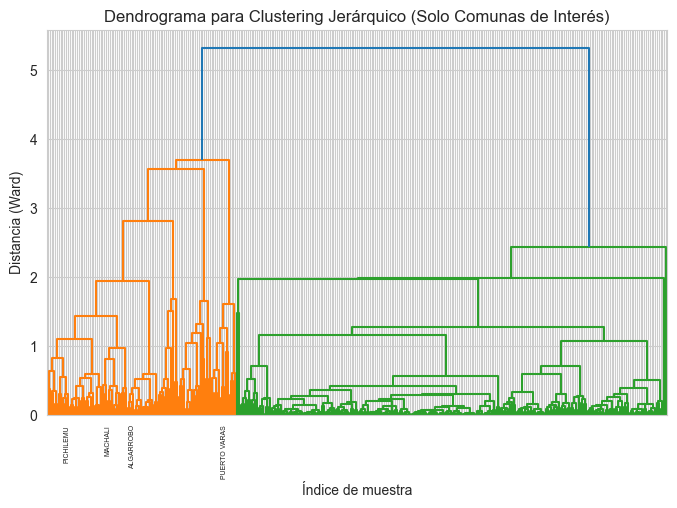

Silhouette Score para el modelo jerárquico: 0.4389


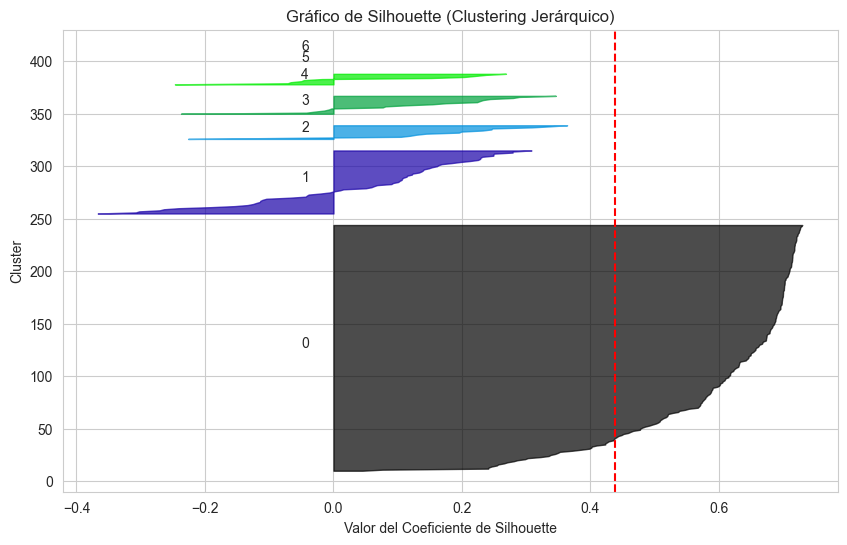

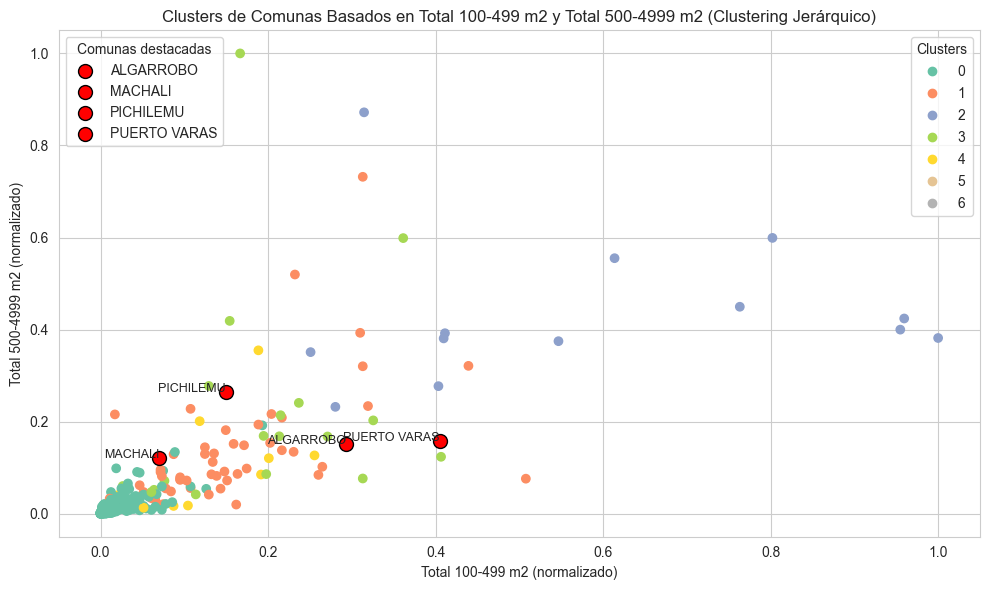


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 1
Comuna ALGARROBO pertenece al cluster 1
Comuna PICHILEMU pertenece al cluster 1

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               12.085106          33.795745           143.404255   
1               91.967213         292.229508           508.311475   
2              372.142857         966.285714          1981.857143   
3              125.777778         516.111111           114.444444   
4               72.181818         210.454545           113.818182   
5                2.000000           2.000000             5.000000   
6                1.000000           3.000000             7.000000   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                     

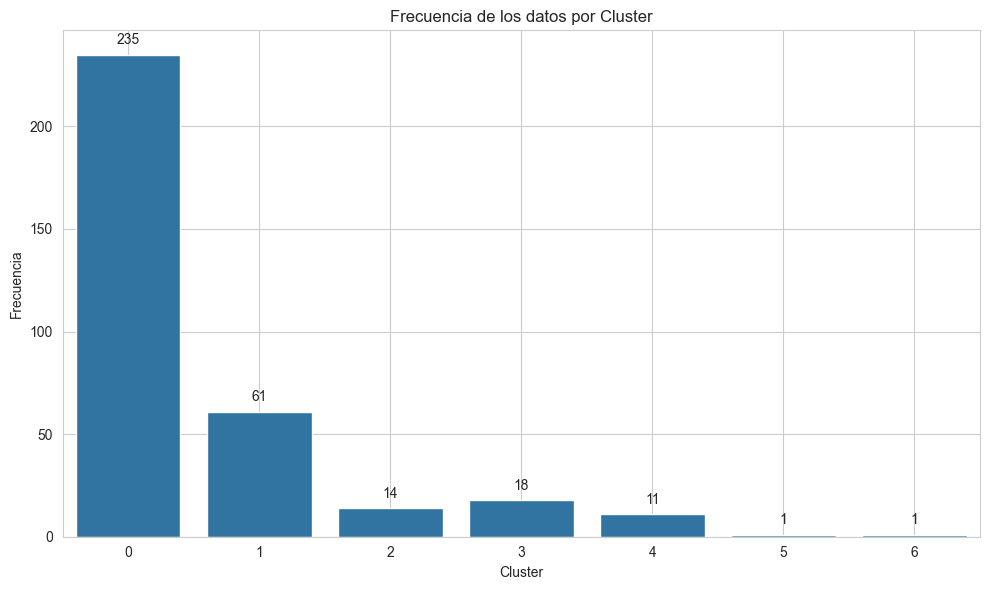

In [71]:
cluster_jerarquico_sin_pca1_7Cluster = realizar_clustering_jerarquico_sin_pca(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='Total 100-499 m2',  # Variable en el eje X
    var_y='Total 500-4999 m2'  # Variable en el eje Y
)


In [72]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_SinPCA_1_7Clusters.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = cluster_jerarquico_sin_pca1_7Cluster[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_SinPCA_1_7Clusters.csv


In [73]:
Jerarq_SinPCA_1 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_jerarquico_7 = cluster_jerarquico_sin_pca1_7Cluster['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_jerarquico_7)

cluster
0    235
1     61
2     14
3     18
4     11
5      1
6      1
Name: count, dtype: int64


### 3D 7cluster

In [77]:
graficar_clusters_jerarquico_3d_interactivo(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=7,  # Número de clusters
    limite_ejes=0.8,  # Límite para los ejes X, Y, Z
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)


## Cluster Jerarquico N° Datos, media, mediana, min, max, desv

### Normalización de variables

In [86]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 1: Variables a normalizar
variables_clustering = [
    
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2', 
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]


# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### PCA

Varianzas explicadas por cada componente principal:
PC1: 0.3069
PC2: 0.1755
PC3: 0.1310
PC4: 0.0505
PC5: 0.0468


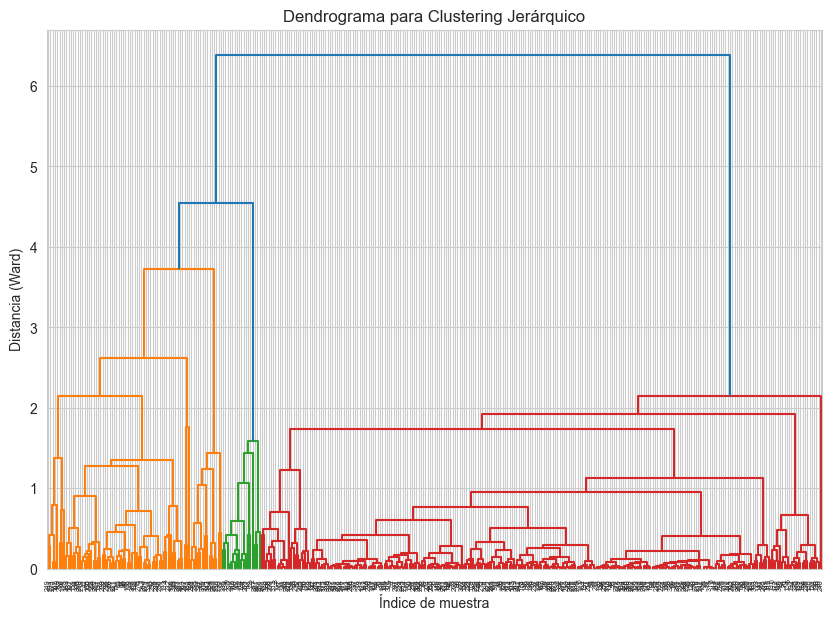

Silhouette Score para el modelo jerárquico: 0.5330


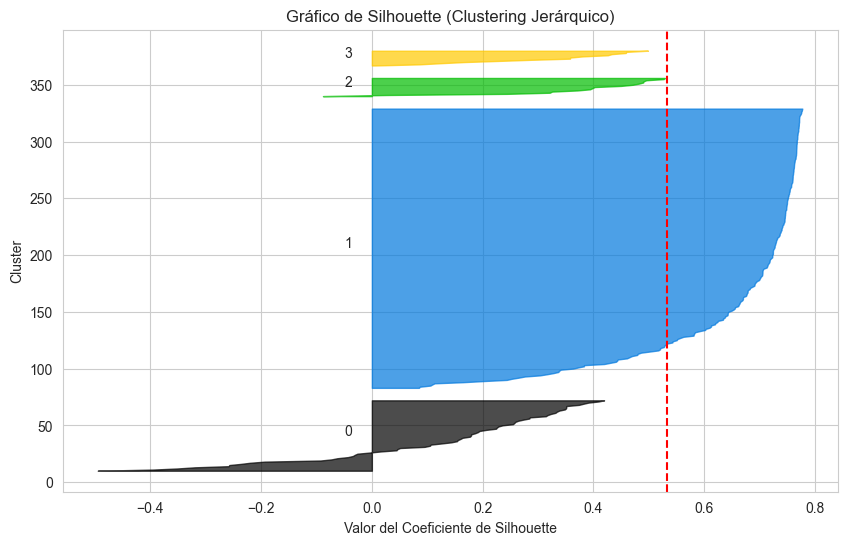

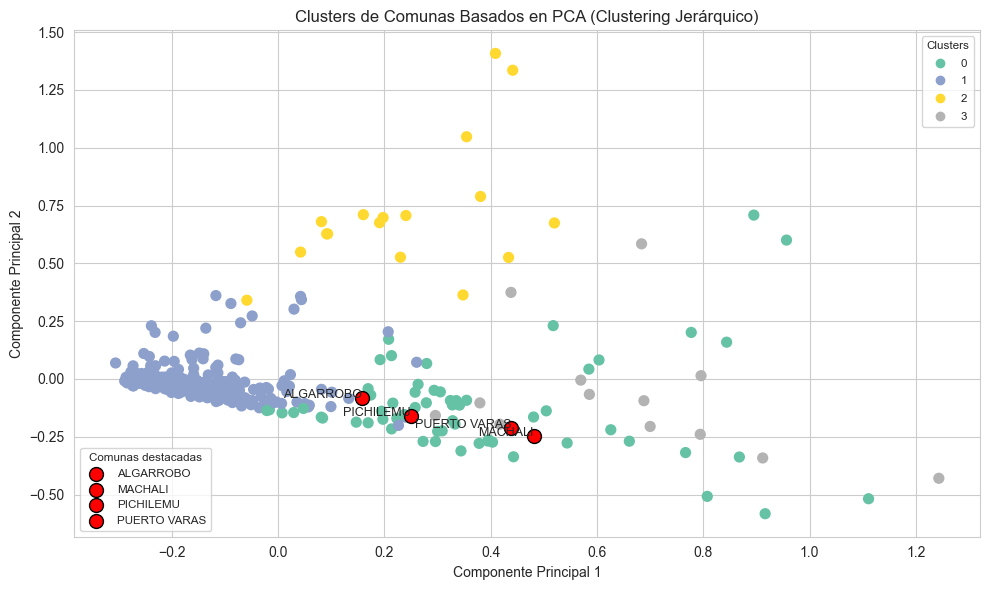


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
          PC1       PC2       PC3       PC4       PC5
0    0.157943 -0.083015  0.260665 -0.037294  0.039813
1   -0.016541 -0.133181 -0.190130  0.064272 -0.060409
2   -0.058885  0.340619 -0.082390 -0.915522  0.289952
3   -0.165286  0.103347 -0.088771  0.192154  0.133399
4    0.279517  0.066990 -0.360445 -0.109093  0.090828
..        ...       ...       ...       ...       ...
336  0.240465  0.706864  0.121929 -0.062916  0.032234
337 -0.155589 -0.043465  0.008880 -0.025393 -0.012876
338 -0.050962 -0.111420  0.073808 -0.018699 -0.057275
339 -0.204061 -0.033988  0.042121 -0.017528 -0.034116
340  0.260635  0.072302  0.317177  0.003116  0.049571

[341 rows x 5 columns]

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 3
Comuna MACHALI pertenece al cluster 0
Comuna ALGARROBO pertenece al cluster 1
Comuna PICHILEMU pertenece al cluster 0

Pesos de cada variable en la

In [87]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
import numpy as np

# Paso 4: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  # Reducir a 5 componentes principales
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 5: Método del dendrograma para determinar el número óptimo de clusters
linked = linkage(X_pca, method='ward')  # 'ward' minimiza la varianza dentro de los clusters

plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title("Dendrograma para Clustering Jerárquico")
plt.xlabel("Índice de muestra")
plt.ylabel("Distancia (Ward)")
plt.grid(True)
plt.show()

# Paso 6: Aplicar AgglomerativeClustering con el número óptimo de clusters
n_clusters = 4  # Puedes elegir el número de clusters basado en el dendrograma
data_jerarquico_pca2 = data_estadisticos.copy()  # Crear una copia para no modificar el original
agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
data_jerarquico_pca2['cluster'] = agglomerative.fit_predict(X_pca)

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_jerarquico_pca2['cluster'])
print(f"Silhouette Score para el modelo jerárquico: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_jerarquico_pca2['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[data_jerarquico_pca2['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color,
                      alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Clustering Jerárquico)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")
plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 7: Identificar las posiciones de las comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
pos_comunas = data_jerarquico_pca2[data_jerarquico_pca2['comuna_match'].isin(comunas_a_marcar)]

# Paso 8: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_jerarquico_pca2['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters con tamaño de fuente ajustado
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small',
                     title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA (Clustering Jerárquico)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 9: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(X_pca, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 10: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_jerarquico_pca2['comuna_match'].values:
        cluster_comuna = data_jerarquico_pca2[data_jerarquico_pca2['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 11: Mostrar cuánto pesa cada variable en cada componente principal
pesos_variables = pd.DataFrame(pca.components_, columns=variables_clustering,
                               index=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en las componentes principales:")
print(pesos_variables)

# Paso 12: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_jerarquico_pca2.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_jerarquico_pca2.groupby('cluster')[variables_clustering].median()
pd.set_option('display.max_columns', None)  # No limite el número de columnas mostradas
# Imprimir la media por cluster
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)



In [88]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_2.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = data_jerarquico_pca2[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_PCA_2.csv


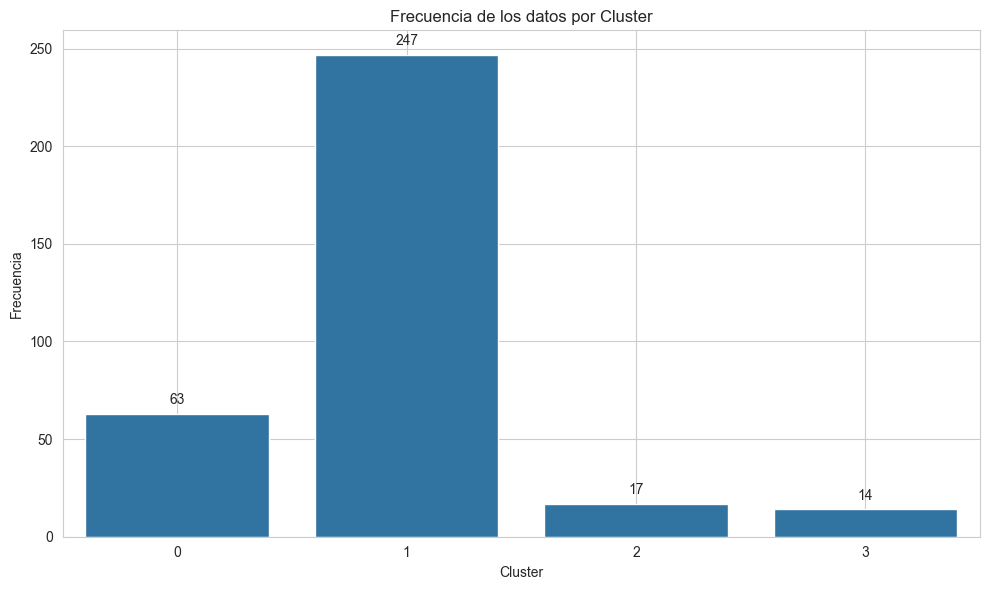

In [89]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
plt.figure(figsize=(10, 6))

# Contar la frecuencia de cada cluster en 'data_copia'
frecuencia_clusters = data_jerarquico_pca2['cluster'].value_counts().sort_index()

# Graficar el gráfico de barras
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()


In [90]:
# Leer el archivo CSV guardado
jerarquico_pca2 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_jerarquico_pca2 = jerarquico_pca2['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_jerarquico_pca2)


cluster
0     63
1    247
2     17
3     14
Name: count, dtype: int64


### Gráfico 3D

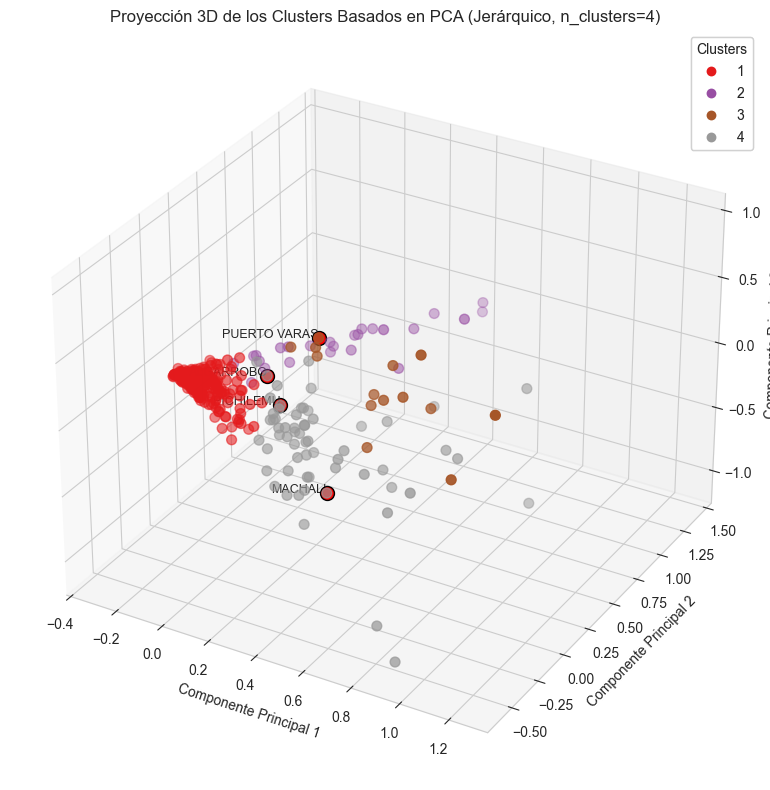

In [91]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import linkage, fcluster
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Paso 1: Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]  # Aquí utilizas las variables que has definido para el clustering

# Paso 2: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Paso 3: Aplicar PCA para reducir la dimensionalidad a 3 componentes principales
pca_3d = PCA(n_components=3)  # Reducir a 3 componentes principales
PCA_ds = pd.DataFrame(pca_3d.fit_transform(X_normalizado), columns=['PC1', 'PC2', 'PC3'])

# Paso 4: Aplicar clustering jerárquico
Z = linkage(PCA_ds, method='ward')  # Usar el método de Ward para clustering jerárquico

# Seleccionar el número de clusters (por ejemplo, 7)
num_clusters = 4
PCA_ds['cluster'] = fcluster(Z, num_clusters, criterion='maxclust')

# Agregar la información de las comunas
PCA_ds['comuna_match'] = data_estadisticos['comuna_match']

# Proyección 3D de los datos después de realizar la reducción de dimensiones a 3 componentes principales
x = PCA_ds["PC1"]
y = PCA_ds["PC2"]
z = PCA_ds["PC3"]

# Graficamos los clusters en 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# Colorear los puntos por clusters
scatter = ax.scatter(x, y, z, c=PCA_ds['cluster'], cmap='Set1', marker="o", s=50)

# Personalizamos el gráfico
ax.set_title(f"Proyección 3D de los Clusters Basados en PCA (Jerárquico, n_clusters={num_clusters})")
ax.set_xlabel('Componente Principal 1')
ax.set_ylabel('Componente Principal 2')
ax.set_zlabel('Componente Principal 3')

# Añadir leyenda para los clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="upper right")
plt.gca().add_artist(legend1)

# Marcar comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
comunas_interes = PCA_ds[PCA_ds['comuna_match'].isin(comunas_a_marcar)]

# Añadir las comunas de interés en el gráfico
for comuna, cx, cy, cz in zip(comunas_interes['comuna_match'], comunas_interes['PC1'], comunas_interes['PC2'], comunas_interes['PC3']):
    ax.scatter(cx, cy, cz, color='red', s=100, label=f'{comuna}', edgecolor='black')
    ax.text(cx, cy, cz, comuna, fontsize=9, ha='right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()


In [92]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import linkage, fcluster
import plotly.graph_objects as go

def graficar_clusters_pca_3d_interactivo(data, variables_clustering, num_clusters):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Aplicar PCA para reducir a 3 componentes principales
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X_normalizado)
    pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

    # Imprimir las varianzas explicadas por cada componente principal
    varianzas_explicadas = pca.explained_variance_ratio_
    print("Varianzas explicadas por cada componente principal:")
    for i, varianza in enumerate(varianzas_explicadas):
        print(f"PC{i + 1}: {varianza:.4f}")

    # Paso 4: Aplicar clustering jerárquico
    Z = linkage(X_pca, method='ward')  # Usar el método 'ward' para clustering jerárquico
    data_copia['cluster'] = fcluster(Z, num_clusters, criterion='maxclust') - 1  # Ajustar índices de cluster

    # Proyección 3D de los datos en base a PCA
    x = pca_df['PC1']
    y = pca_df['PC2']
    z = pca_df['PC3']

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters y mostrar la leyenda con los clusters asignados
    for cluster_num in range(num_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=pca_df.loc[cluster_data.index, 'PC1'],
            y=pca_df.loc[cluster_data.index, 'PC2'],
            z=pca_df.loc[cluster_data.index, 'PC3'],
            mode='markers',
            marker=dict(size=5, opacity=0.8),
            name=f'Cluster {cluster_num}',
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=pca_df.loc[pos_comunas.index, 'PC1'], 
        y=pca_df.loc[pos_comunas.index, 'PC2'], 
        z=pca_df.loc[pos_comunas.index, 'PC3'],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas Destacadas'
    ))

    # Personalizar el gráfico (ajustar el tamaño)
    fig.update_layout(
        title=f'Clusters Basados en Componentes Principales (PCA - Clustering Jerárquico)',
        scene=dict(
            xaxis_title='Componente Principal 1',
            yaxis_title='Componente Principal 2',
            zaxis_title='Componente Principal 3'
        ),
        width=1200,  # Ancho del gráfico
        height=900,  # Altura del gráfico
        legend_title_text='Clusters'
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Llamar a la función con las variables de interés
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    num_clusters=4  # Número de clusters
)


Varianzas explicadas por cada componente principal:
PC1: 0.3069
PC2: 0.1755
PC3: 0.1310


### 7 Clústers

Varianzas explicadas por cada componente principal:
PC1: 0.3069
PC2: 0.1755
PC3: 0.1310
PC4: 0.0505
PC5: 0.0468


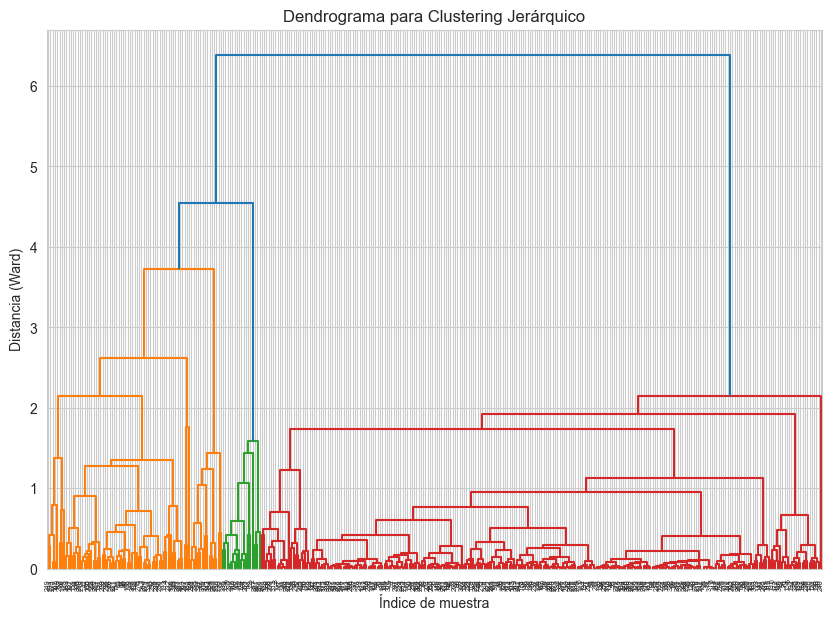

Silhouette Score para el modelo jerárquico: 0.5080


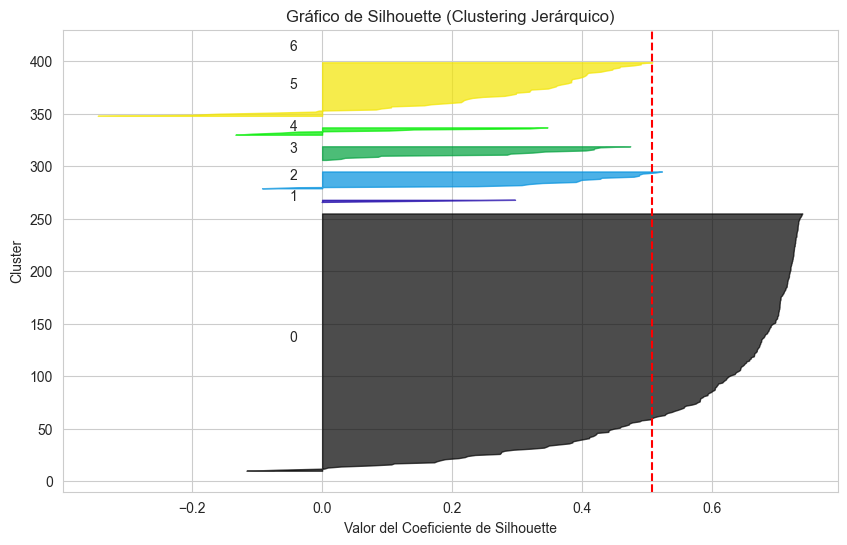

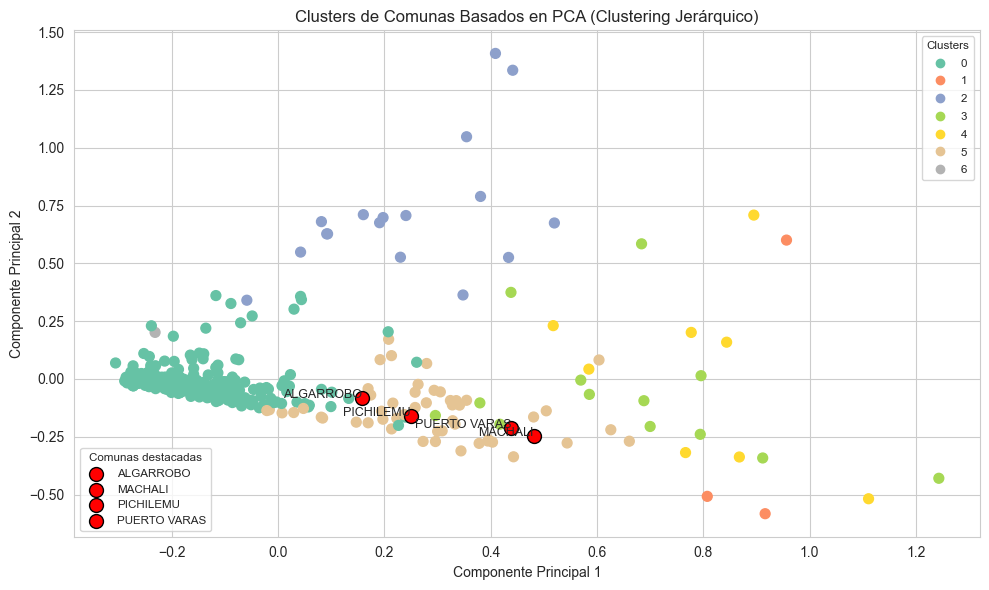


Pesos de cada variable en el clustering (valores de los centroides en las componentes principales):
          PC1       PC2       PC3       PC4       PC5
0    0.157943 -0.083015  0.260665 -0.037294  0.039813
1   -0.016541 -0.133181 -0.190130  0.064272 -0.060409
2   -0.058885  0.340619 -0.082390 -0.915522  0.289952
3   -0.165286  0.103347 -0.088771  0.192154  0.133399
4    0.279517  0.066990 -0.360445 -0.109093  0.090828
..        ...       ...       ...       ...       ...
336  0.240465  0.706864  0.121929 -0.062916  0.032234
337 -0.155589 -0.043465  0.008880 -0.025393 -0.012876
338 -0.050962 -0.111420  0.073808 -0.018699 -0.057275
339 -0.204061 -0.033988  0.042121 -0.017528 -0.034116
340  0.260635  0.072302  0.317177  0.003116  0.049571

[341 rows x 5 columns]

Clusters de las comunas destacadas:
Comuna PUERTO VARAS pertenece al cluster 3
Comuna MACHALI pertenece al cluster 5
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 5

Pesos de cada variable en la

In [93]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
import numpy as np

# Paso 4: Aplicar PCA para reducir la dimensionalidad
pca = PCA(n_components=5)  # Reducir a 5 componentes principales
X_pca = pca.fit_transform(X_normalizado)

# Imprimir las varianzas explicadas por cada componente principal
varianzas_explicadas = pca.explained_variance_ratio_
print("Varianzas explicadas por cada componente principal:")
for i, varianza in enumerate(varianzas_explicadas):
    print(f"PC{i + 1}: {varianza:.4f}")

# Paso 5: Método del dendrograma para determinar el número óptimo de clusters
linked = linkage(X_pca, method='ward')  # 'ward' minimiza la varianza dentro de los clusters

plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title("Dendrograma para Clustering Jerárquico")
plt.xlabel("Índice de muestra")
plt.ylabel("Distancia (Ward)")
plt.grid(True)
plt.show()

# Paso 6: Aplicar AgglomerativeClustering con el número óptimo de clusters
n_clusters = 7  # Puedes elegir el número de clusters basado en el dendrograma
data_jerarquico_pca2_7clusters = data_estadisticos.copy()  # Crear una copia para no modificar el original
agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
data_jerarquico_pca2_7clusters['cluster'] = agglomerative.fit_predict(X_pca)

# Calcular el Silhouette Score
silhouette_avg = silhouette_score(X_pca, data_jerarquico_pca2_7clusters['cluster'])
print(f"Silhouette Score para el modelo jerárquico: {silhouette_avg:.4f}")

# Graficar el Silhouette Score para cada punto
sample_silhouette_values = silhouette_samples(X_pca, data_jerarquico_pca2_7clusters['cluster'])

plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[data_jerarquico_pca2_7clusters['cluster'] == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color,
                      alpha=0.7)

    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    y_lower = y_upper + 10  # 10 for the 0 samples gap between silhouette plots

plt.title("Gráfico de Silhouette (Clustering Jerárquico)")
plt.xlabel("Valor del Coeficiente de Silhouette")
plt.ylabel("Cluster")

plt.axvline(x=silhouette_avg, color="red", linestyle="--")
plt.grid(True)
plt.show()

# Paso 7: Identificar las posiciones de las comunas específicas
comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
pos_comunas = data_jerarquico_pca2_7clusters[data_jerarquico_pca2_7clusters['comuna_match'].isin(comunas_a_marcar)]

# Paso 8: Visualización de los clusters con identificación de comunas
plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data_jerarquico_pca2_7clusters['cluster'], cmap='Set2', s=50)

# Añadir puntos destacados para las comunas especificadas con un color especial
for comuna, x, y in zip(pos_comunas['comuna_match'], X_pca[pos_comunas.index, 0], X_pca[pos_comunas.index, 1]):
    plt.scatter(x, y, color='red', s=100, label=f'{comuna}', edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters con tamaño de fuente ajustado
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small',
                     title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="lower left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

plt.title('Clusters de Comunas Basados en PCA (Clustering Jerárquico)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.tight_layout()
plt.show()

# Paso 9: Mostrar cuánto pesa cada variable en el clustering
centroides = pd.DataFrame(X_pca, columns=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en el clustering (valores de los centroides en las componentes principales):")
print(centroides)

# Paso 10: Mostrar en qué cluster se encuentra cada comuna destacada
print("\nClusters de las comunas destacadas:")
for comuna in comunas_a_marcar:
    if comuna in data_jerarquico_pca2_7clusters['comuna_match'].values:
        cluster_comuna = data_jerarquico_pca2_7clusters[data_jerarquico_pca2_7clusters['comuna_match'] == comuna]['cluster'].values[0]
        print(f"Comuna {comuna} pertenece al cluster {cluster_comuna}")
    else:
        print(f"Comuna {comuna} no está presente en los datos.")

# Paso 11: Mostrar cuánto pesa cada variable en cada componente principal
pesos_variables = pd.DataFrame(pca.components_, columns=variables_clustering,
                               index=[f'PC{i + 1}' for i in range(pca.n_components_)])
print("\nPesos de cada variable en las componentes principales:")
print(pesos_variables)

# Paso 12: Caracterización de los clusters (media y mediana por cada cluster)
media_por_cluster = data_jerarquico_pca2_7clusters.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_jerarquico_pca2_7clusters.groupby('cluster')[variables_clustering].median()
pd.set_option('display.max_columns', None)  # No limite el número de columnas mostradas
# Imprimir la media por cluster
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)

# Imprimir la mediana por cluster
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)


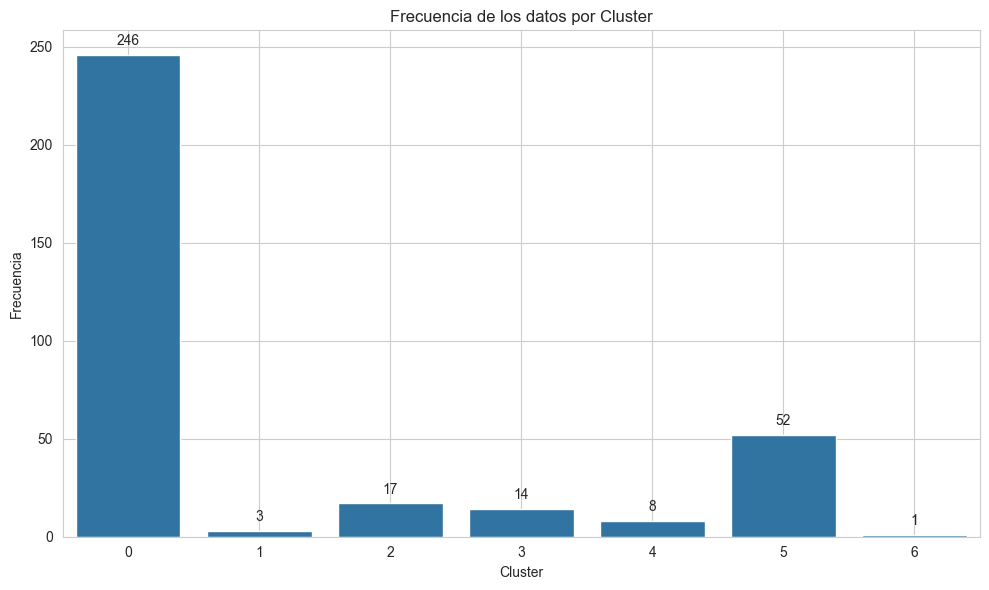

In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paso 13: Gráfico de barras de frecuencia por cluster con anotaciones
plt.figure(figsize=(10, 6))

# Contar la frecuencia de cada cluster en 'data_copia'
frecuencia_clusters = data_jerarquico_pca2_7clusters['cluster'].value_counts().sort_index()

# Graficar el gráfico de barras
ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values)

# Añadir títulos y etiquetas
plt.title('Frecuencia de los datos por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia')

# Añadir anotaciones encima de cada barra
for i, v in enumerate(frecuencia_clusters.values):
    ax.text(i, v + 5, str(v), ha='center', fontsize=10)

plt.grid(True)
plt.tight_layout()
plt.show()


In [107]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_PCA_2_7Clusters.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = data_jerarquico_pca2_7clusters[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_PCA_2_7Clusters.csv


In [108]:
# Leer el archivo CSV guardado
Jerarq_PCA_2 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_sin_pca2 = Jerarq_PCA_2['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_sin_pca2)

cluster
0    246
1      3
2     17
3     14
4      8
5     52
6      1
Name: count, dtype: int64


### Gráfico 3D 7 Clústers

In [96]:
graficar_clusters_pca_3d_interactivo(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    num_clusters=7  # Número de clusters
)

Varianzas explicadas por cada componente principal:
PC1: 0.3069
PC2: 0.1755
PC3: 0.1310


### Sin PCA

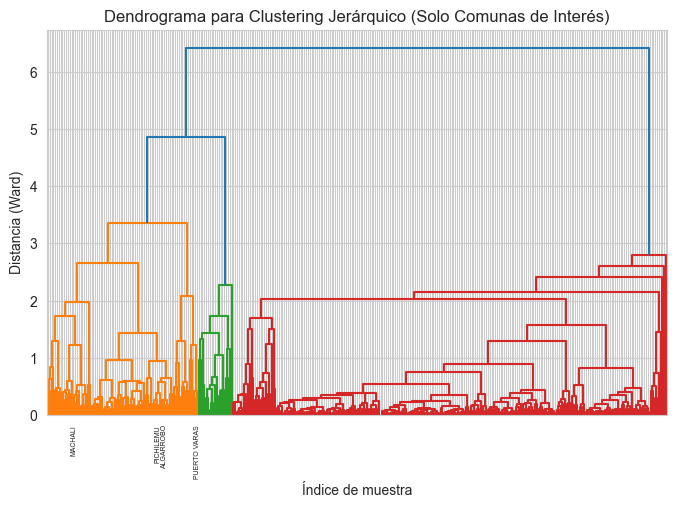

Silhouette Score para el modelo jerárquico: 0.4000


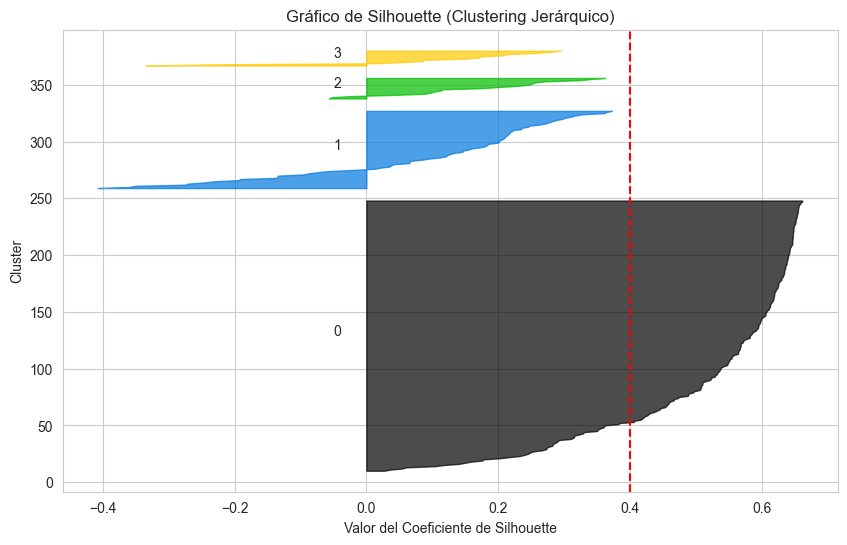

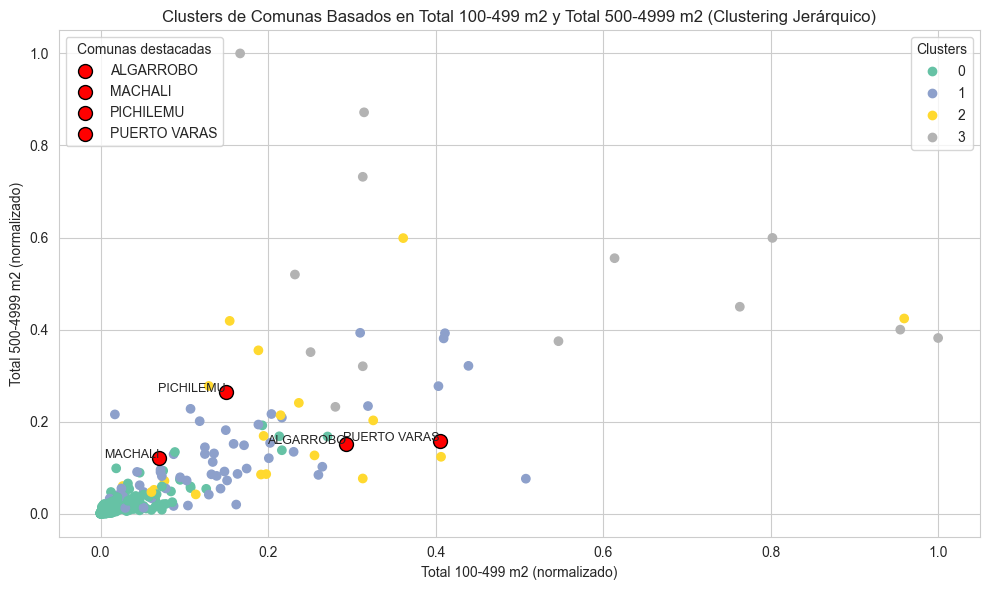


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 3
Comuna MACHALI pertenece al cluster 1
Comuna ALGARROBO pertenece al cluster 1
Comuna PICHILEMU pertenece al cluster 1

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               14.828452          38.476987           160.878661   
1               84.652174         248.565217           466.869565   
2              151.052632         446.947368           129.157895   
3              319.000000        1147.642857          1618.500000   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                          
0                    51.661088                       10.344138   
1                   146.724638                       11.671639   
2                    38.578947                       21.262941   
3  

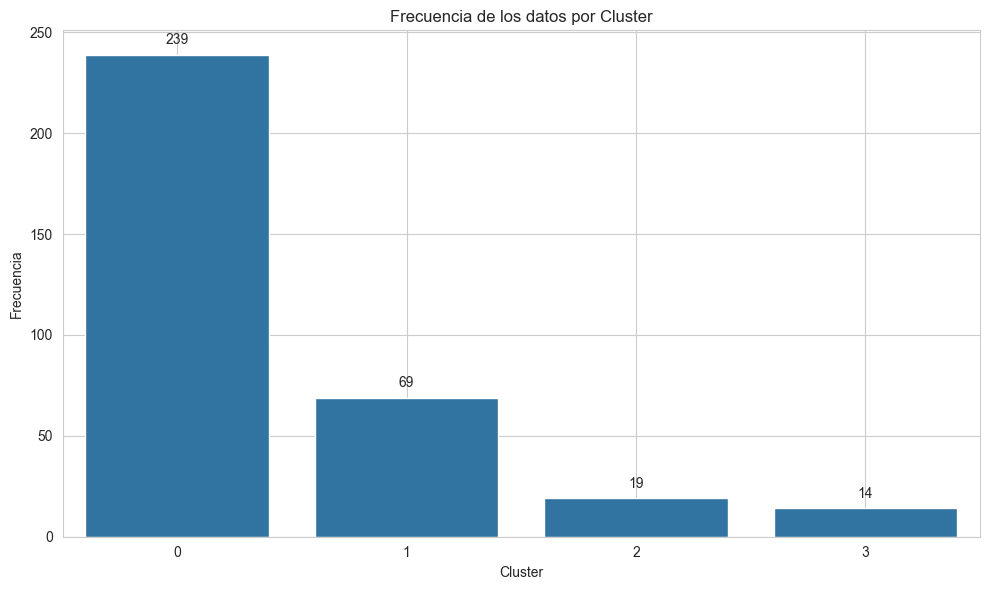

In [97]:
# Llamar a la función con los datos y las variables de interés
cluster_jerarquico_sin_pca2 =    realizar_clustering_jerarquico_sin_pca(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=4,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='Total 100-499 m2',  # Variable en el eje X
    var_y='Total 500-4999 m2'  # Variable en el eje Y
)

In [98]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = cluster_jerarquico_sin_pca2[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2.csv


In [99]:
# Leer el archivo CSV guardado
cluster_jerarquico_sin_pca2_lectura = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_sin_pca2 = cluster_jerarquico_sin_pca2_lectura['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_sin_pca2)


cluster
0    239
1     69
2     19
3     14
Name: count, dtype: int64


### Gráfico 3D

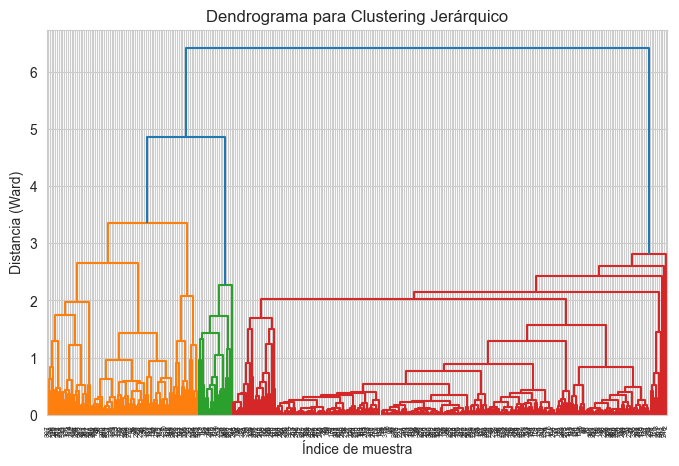

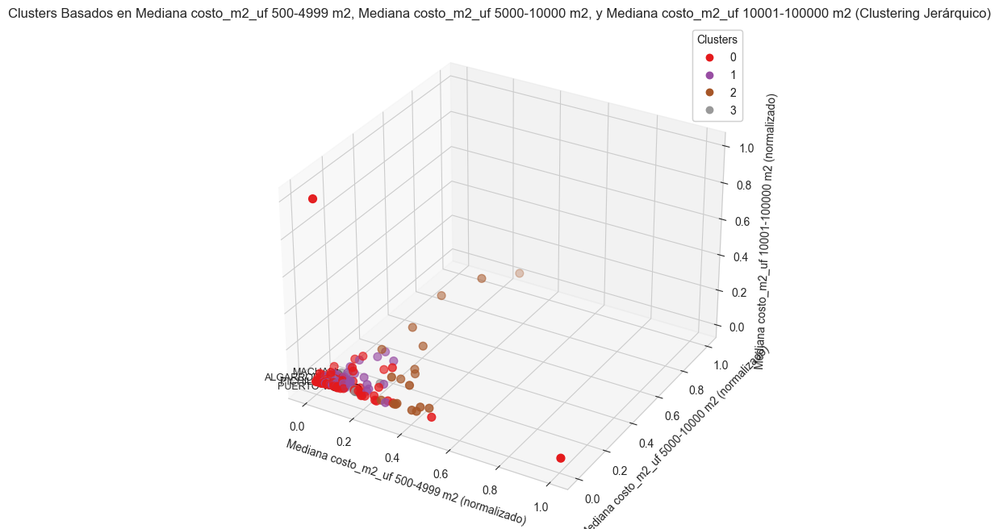

In [100]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import linkage, dendrogram

def graficar_clusters_jerarquico_3d(data, variables_clustering, var_x, var_y, var_z, n_clusters, mostrar_dendrograma=True):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()
    
    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]
    
    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)
    
    # Mostrar el dendrograma (opcional)
    if mostrar_dendrograma:
        linked = linkage(X_normalizado, method='ward')
        plt.figure(figsize=(8, 5))
        dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
        plt.title('Dendrograma para Clustering Jerárquico')
        plt.xlabel('Índice de muestra')
        plt.ylabel('Distancia (Ward)')
        plt.grid(True)
        plt.show()

    # Paso 3: Aplicar Agglomerative Clustering con el número especificado de clusters
    agglomerative = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)
    
    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Graficar los puntos coloreados por el cluster al que pertenecen
    scatter = ax.scatter(x, y, z, c=data_copia['cluster'], cmap='Set1', s=50)

    # Personalización del gráfico
    ax.set_title(f'Clusters Basados en {var_x}, {var_y}, y {var_z} (Clustering Jerárquico)')
    ax.set_xlabel(f'{var_x} (normalizado)')
    ax.set_ylabel(f'{var_y} (normalizado)')
    ax.set_zlabel(f'{var_z} (normalizado)')

    # Añadir leyenda de clusters
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
    plt.gca().add_artist(legend1)

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir las comunas de interés al gráfico
    for comuna, x_val, y_val, z_val in zip(pos_comunas['comuna_match'], 
                                           X_normalizado.loc[pos_comunas.index, var_x],
                                           X_normalizado.loc[pos_comunas.index, var_y],
                                           X_normalizado.loc[pos_comunas.index, var_z]):
        ax.scatter(x_val, y_val, z_val, color='red', s=100, label=f'{comuna}', edgecolor='black')
        ax.text(x_val, y_val, z_val, comuna, fontsize=9, ha='right')

    # Mostrar el gráfico
    plt.show()

# Llamar a la función con las variables de interés
graficar_clusters_jerarquico_3d(
    data_estadisticos, 
    variables_clustering,
    'Mediana costo_m2_uf 500-4999 m2', 
    'Mediana costo_m2_uf 5000-10000 m2', 
    'Mediana costo_m2_uf 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    mostrar_dendrograma=True  # Mostrar o no el dendrograma
)

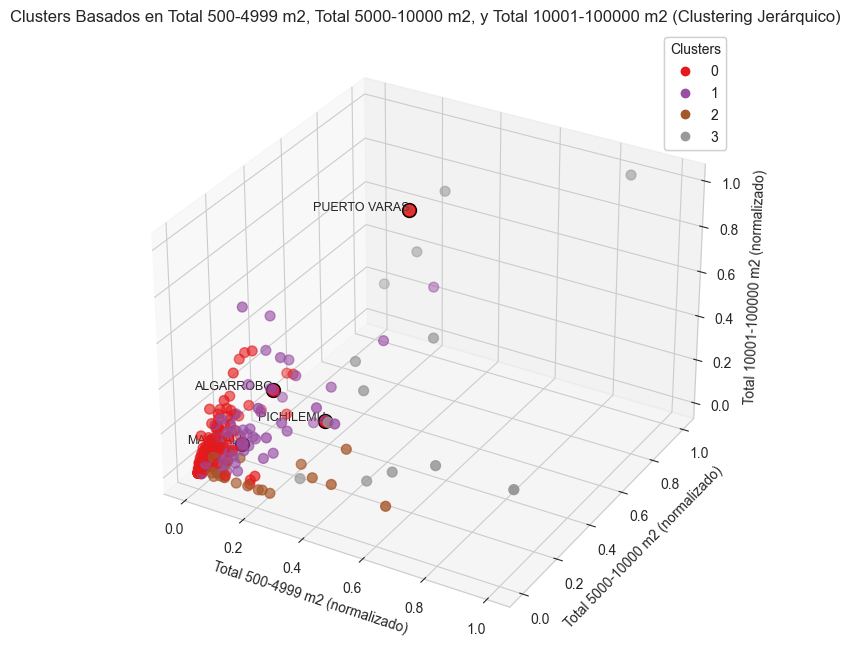

In [101]:
graficar_clusters_jerarquico_3d(
    data_estadisticos, 
    variables_clustering,
    'Total 500-4999 m2', 
    'Total 5000-10000 m2', 
    'Total 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)


In [102]:

import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import AgglomerativeClustering
import plotly.graph_objects as go
import plotly.express as px
from scipy.cluster.hierarchy import linkage, dendrogram


def graficar_clusters_jerarquico_3d_interactivo(data, variables_clustering, var_x, var_y, var_z, n_clusters,
                                                limite_ejes=0.5, mostrar_dendrograma=True):
    # Hacer una copia del DataFrame original para no modificar la data original
    data_copia = data.copy()

    # Paso 1: Extraer las variables para el clustering
    X = data_copia[variables_clustering]

    # Paso 2: Normalizar las características usando MinMaxScaler
    scaler = MinMaxScaler()
    X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

    # Paso 3: Mostrar el dendrograma (opcional)
    if mostrar_dendrograma:
        linked = linkage(X_normalizado, method='ward')
        dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
        plt.title('Dendrograma para Clustering Jerárquico')
        plt.xlabel('Índice de muestra')
        plt.ylabel('Distancia (Ward)')
        plt.show()

    # Paso 4: Aplicar Agglomerative Clustering con el número especificado de clusters
    agglomerative = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    data_copia['cluster'] = agglomerative.fit_predict(X_normalizado)

    # Extraer las tres variables que quieres graficar en 3D
    x = X_normalizado[var_x]
    y = X_normalizado[var_y]
    z = X_normalizado[var_z]

    # Crear un gráfico 3D interactivo con Plotly
    fig = go.Figure()

    # Añadir los puntos de los clusters
    colors = px.colors.qualitative.Set1  # Definir una paleta de colores cualitativa para los clusters
    for cluster_num in range(n_clusters):
        cluster_data = data_copia[data_copia['cluster'] == cluster_num]
        fig.add_trace(go.Scatter3d(
            x=X_normalizado.loc[cluster_data.index, var_x],
            y=X_normalizado.loc[cluster_data.index, var_y],
            z=X_normalizado.loc[cluster_data.index, var_z],
            mode='markers',
            marker=dict(size=5, color=colors[cluster_num % len(colors)], opacity=0.8),
            name=f'Cluster {cluster_num}',  # Añadir el nombre del cluster
            text=cluster_data['comuna_match'],  # Mostrar el nombre de la comuna al hacer hover
            hoverinfo='text'
        ))

    # Destacar las comunas de interés
    comunas_a_marcar = ['PUERTO VARAS', 'MACHALI', 'ALGARROBO', 'PICHILEMU']
    pos_comunas = data_copia[data_copia['comuna_match'].isin(comunas_a_marcar)]

    # Añadir un trazo especial para destacar las comunas
    fig.add_trace(go.Scatter3d(
        x=X_normalizado.loc[pos_comunas.index, var_x],
        y=X_normalizado.loc[pos_comunas.index, var_y],
        z=X_normalizado.loc[pos_comunas.index, var_z],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='circle'),
        text=pos_comunas['comuna_match'],
        textposition='top center',
        hoverinfo='text',
        name='Comunas de Interés',  # Añadir nombre para las comunas de interés
        showlegend=True  # Mostrar leyenda para estas comunas
    ))

    # Personalizar el gráfico con los límites de los ejes
    fig.update_layout(
        title=f'Clusters Basados en {var_x}, {var_y}, y {var_z} (Clustering Jerárquico)',
        scene=dict(
            xaxis=dict(title=f'{var_x} (normalizado)', range=[0, limite_ejes]),
            yaxis=dict(title=f'{var_y} (normalizado)', range=[0, limite_ejes]),
            zaxis=dict(title=f'{var_z} (normalizado)', range=[0, limite_ejes])
        ),
        width=1200,  # Ancho del gráfico
        height=900  # Altura del gráfico
    )

    # Mostrar el gráfico interactivo
    fig.show()


# Llamar a la función con las variables de interés y límites de los ejes
graficar_clusters_jerarquico_3d_interactivo(
    data_estadisticos,
    variables_clustering,
    'Total 500-4999 m2',
    'Total 5000-10000 m2',
    'Total 10001-100000 m2',
    n_clusters=4,  # Número de clusters
    limite_ejes=0.8,  # Límite para los ejes X, Y, Z
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)


### 7 Clústers

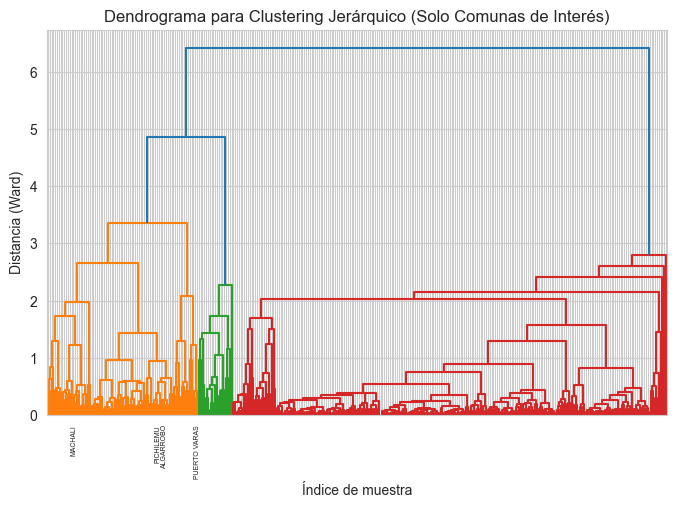

Silhouette Score para el modelo jerárquico: 0.3249


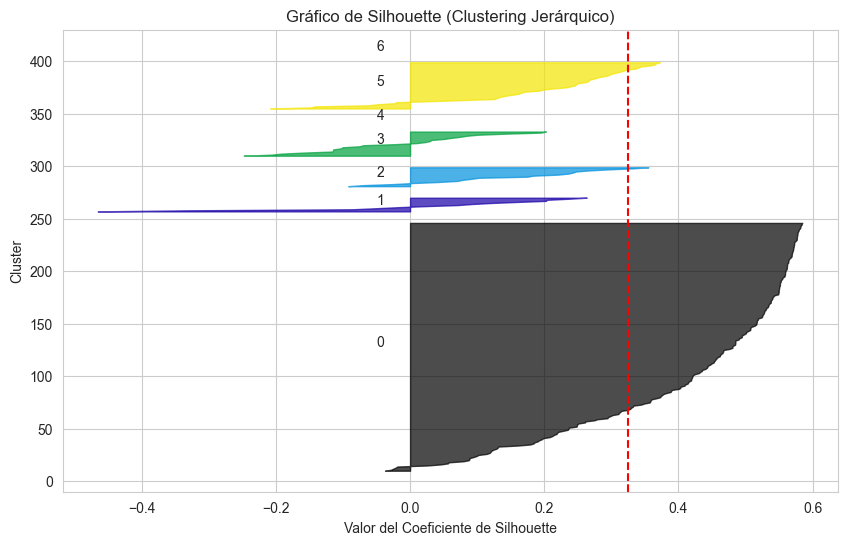

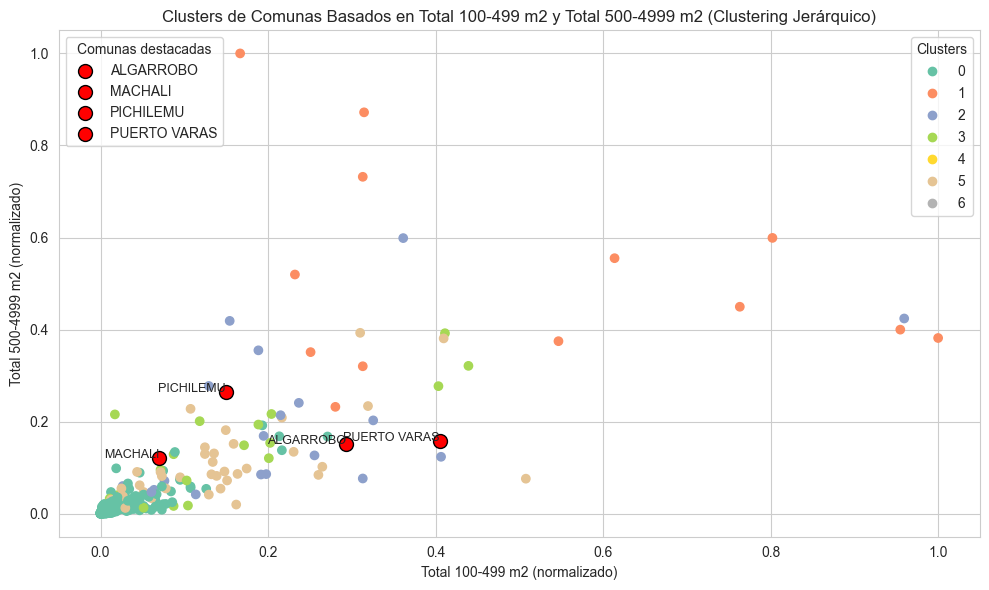


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 1
Comuna MACHALI pertenece al cluster 3
Comuna ALGARROBO pertenece al cluster 5
Comuna PICHILEMU pertenece al cluster 5

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               14.940928          38.780591           162.185654   
1              319.000000        1147.642857          1618.500000   
2              151.052632         446.947368           129.157895   
3               81.750000         275.750000           386.750000   
4                2.000000           2.000000             5.000000   
5               86.200000         234.066667           509.600000   
6                1.000000           3.000000             7.000000   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                     

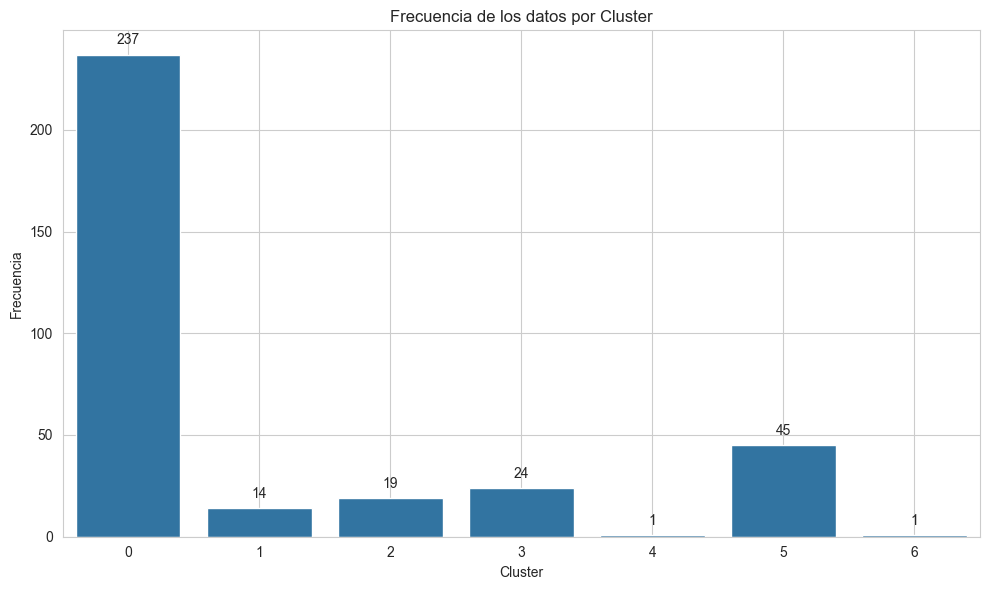

In [103]:
cluster_jerarquico_sin_pca_7cluster =    realizar_clustering_jerarquico_sin_pca(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='Total 100-499 m2',  # Variable en el eje X
    var_y='Total 500-4999 m2'  # Variable en el eje Y
)

In [104]:

# Paso adicional: Guardar el listado de comunas con su cluster correspondiente en un archivo CSV
# Asegúrate de que la carpeta "data recuperada/" exista antes de ejecutar este código
output_file = "data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2_7Clústers.csv"

# Seleccionar solo las columnas 'comuna_match' y 'cluster' para guardar
listado_comunas_clusters = cluster_jerarquico_sin_pca_7cluster[['comuna_match', 'cluster']]

# Guardar en formato CSV
listado_comunas_clusters.to_csv(output_file, index=False)

print(f"Listado de comunas con sus clusters guardado en: {output_file}")

Listado de comunas con sus clusters guardado en: data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2_7Clústers.csv


In [105]:
# Leer el archivo CSV guardado
Jerarq_SinPCA_2 = pd.read_csv(output_file)

# Contar la frecuencia de cada cluster y ordenar
frecuencia_clusters_sin_pca2 = Jerarq_SinPCA_2['cluster'].value_counts().sort_index()

# Mostrar las frecuencias por cluster
print(frecuencia_clusters_sin_pca2)

cluster
0    237
1     14
2     19
3     24
4      1
5     45
6      1
Name: count, dtype: int64


### Gráfico 3D 7 Clústers

In [110]:
graficar_clusters_jerarquico_3d_interactivo(
    data_estadisticos,
    variables_clustering,
    'Total 500-4999 m2',
    'Total 5000-10000 m2',
    'Total 10001-100000 m2',
    n_clusters=7,  # Número de clusters
    limite_ejes=0.8,  # Límite para los ejes X, Y, Z
    mostrar_dendrograma=False  # Mostrar o no el dendrograma
)

## Divisive Clustering N°datos, media, mediana, desv estandar

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Paso 1: Variables a normalizar
variables_clustering = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]

X = data_estadisticos[variables_clustering]

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

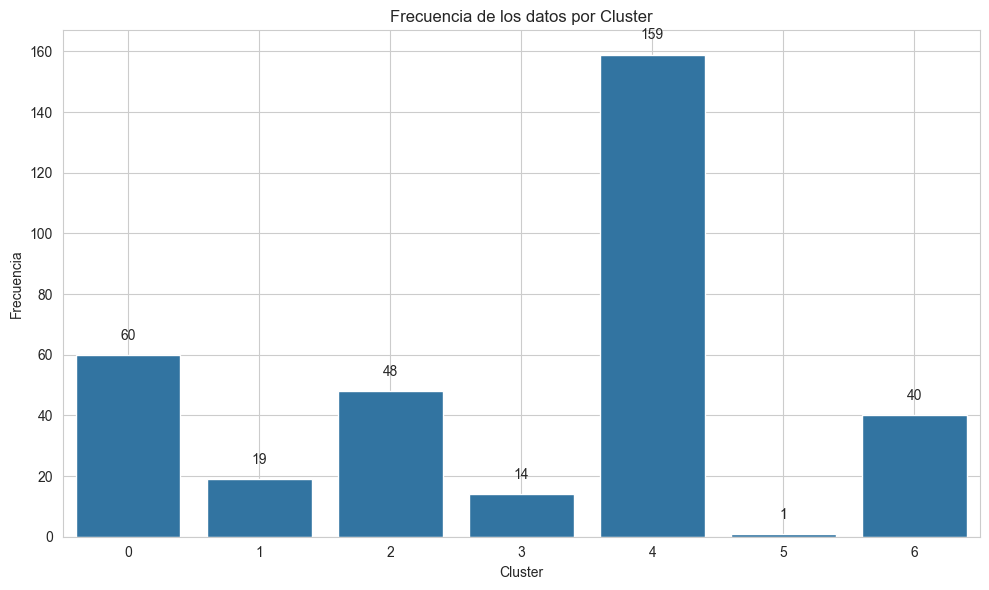

Dendrograma Simulado (Divisive Clustering):
Cluster 0 (Raíz)
├── Cluster 0 (322)
│   ├── Cluster 0 (60)
│   └── Cluster 2 (262)
│       ├── Cluster 2 (48)
│       └── Cluster 3 (214)
│           ├── Cluster 3 (14)
│           └── Cluster 4 (200)
│               ├── Cluster 4 (199)
│               │   ├── Cluster 4 (159)
│               │   └── Cluster 6 (40)
│               └── Cluster 5 (1)
└── Cluster 1 (19)
No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.


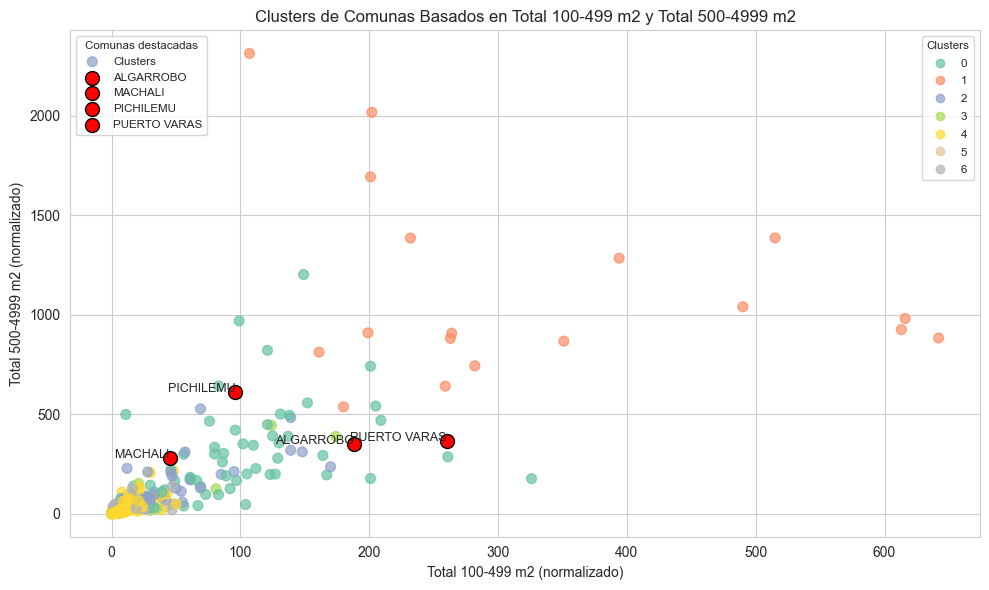


Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0               94.666667         284.600000           243.866667   
1              327.947368        1082.684211          1572.105263   
2               50.479167         143.750000           606.062500   
3               36.857143          89.214286            31.857143   
4                8.710692          22.232704           103.106918   
5                5.000000          24.000000           174.000000   
6               12.025000          38.775000           129.250000   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                          
0                    91.683333                       15.353291   
1                   383.105263                       16.100942   
2                   184.187500                       10.544805 

In [31]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from anytree import Node, RenderTree
from anytree.exporter import DotExporter

def divisive_clustering(data, variables_clustering, n_clusters):
    # Normalizar las variables
    X = data[variables_clustering]
    scaler = MinMaxScaler()
    X_normalizado = scaler.fit_transform(X)

    # Inicializar con un solo cluster que contiene todos los puntos
    clusters = np.zeros(X_normalizado.shape[0], dtype=int)
    cluster_labels = [0]  # Empezar con un único cluster etiquetado como '0'
    next_cluster_label = 1

    # Crear un nodo raíz para el dendrograma simulado
    root = Node("Cluster 0 (Raíz)")
    node_dict = {0: root}  # Diccionario para almacenar referencias a los nodos

    # Dividir recursivamente hasta alcanzar el número deseado de clusters
    while len(cluster_labels) < n_clusters:
        # Encuentra el cluster más grande para dividirlo
        largest_cluster = max(cluster_labels, key=lambda cl: np.sum(clusters == cl))
        cluster_indices = np.where(clusters == largest_cluster)[0]

        if len(cluster_indices) <= 1:  # Si solo queda un punto en el cluster, no se puede dividir
            break

        # Aplicar K-means con k=2 para dividir el cluster más grande
        kmeans = KMeans(n_clusters=2, random_state=42)
        subcluster_labels = kmeans.fit_predict(X_normalizado[cluster_indices])

        # Asignar nuevas etiquetas de cluster a los subclusters
        clusters[cluster_indices[subcluster_labels == 0]] = largest_cluster
        clusters[cluster_indices[subcluster_labels == 1]] = next_cluster_label

        # Crear nodos para los subclusters en el árbol jerárquico
        parent_node = node_dict[largest_cluster]
        node_dict[largest_cluster] = Node(f"Cluster {largest_cluster} ({np.sum(clusters == largest_cluster)})", parent=parent_node)
        node_dict[next_cluster_label] = Node(f"Cluster {next_cluster_label} ({np.sum(clusters == next_cluster_label)})", parent=parent_node)

        # Actualizar los labels de clusters
        cluster_labels.append(next_cluster_label)
        next_cluster_label += 1

        # Eliminar el cluster original si se ha dividido
        cluster_labels = [cl for cl in cluster_labels if np.sum(clusters == cl) > 0]

    # Añadir los clusters al DataFrame original
    data_divisivo = data.copy()
    data_divisivo['cluster'] = clusters

    # Guardar el listado de comunas con su cluster en un archivo CSV
    data_divisivo[['comuna_match', 'cluster']].to_csv("data recuperada/comunas cluster/divisive_1.csv", index=False)

    # Paso 5: Visualizar frecuencia por cluster con el color deseado
    frecuencia_clusters = data_divisivo['cluster'].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values, color=sns.color_palette()[0])  # Color por defecto de Seaborn
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Simular un dendrograma
    print("Dendrograma Simulado (Divisive Clustering):")
    for pre, _, node in RenderTree(root):
        print(f"{pre}{node.name}")

    # Exportar dendrograma a archivo .png usando Graphviz si está instalado
    try:
        DotExporter(root).to_picture("dendrograma_divisivo.png")
        print("Dendrograma exportado a 'dendrograma_divisivo.png'")
    except Exception as e:
        print("No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.")

    return data_divisivo  # Retorna los datos con clusters asignados


# Llamar a la función con tus datos y variables
data_resultados = divisive_clustering(
    data_estadisticos, 
    variables_clustering, 
    n_clusters=7  # Número de clusters deseado
)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
scatter = plt.scatter(data_resultados[variables_clustering[0]], data_resultados[variables_clustering[1]], 
                      c=data_resultados['cluster'], cmap='Set2', s=50, alpha=0.7, label='Clusters')  # Usa Set2 para el gráfico de dispersión

# Comunas de interés y sus clusters
comunas_interes = ['PUERTO VARAS', 'PICHILEMU', 'ALGARROBO', 'MACHALI']
pos_comunas = data_resultados[data_resultados['comuna_match'].isin(comunas_interes)]

# Destacar las comunas de interés
for comuna, x, y in zip(pos_comunas['comuna_match'], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[0]], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[1]]):
    plt.scatter(x, y, color='red', s=100, label=comuna, edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="upper left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

# Personalización del gráfico de dispersión
plt.xlabel(f'{variables_clustering[0]} (normalizado)')
plt.ylabel(f'{variables_clustering[1]} (normalizado)')
plt.title('Clusters de Comunas Basados en ' + variables_clustering[0] + ' y ' + variables_clustering[1])
plt.grid(True)
plt.tight_layout()
plt.show()

# Calcular estadísticas por cluster
media_por_cluster = data_resultados.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_resultados.groupby('cluster')[variables_clustering].median()

# Imprimir las estadísticas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)

# Mostrar los clusters de las comunas de interés
print("\nClusters de las comunas de interés:")
print(pos_comunas[['comuna_match', 'cluster']])



In [55]:
data_divisive = data_resultados[['comuna_match', 'cluster']]
data_divisive.to_csv('data recuperada/comunas cluster/comunas_divisive.csv')

## Divisive Clustering N°datos, media, mediana, desv estandar, min, max

In [38]:
# Paso 1: Variables a normalizar
variables_clustering = [
    
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2', 
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]


# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

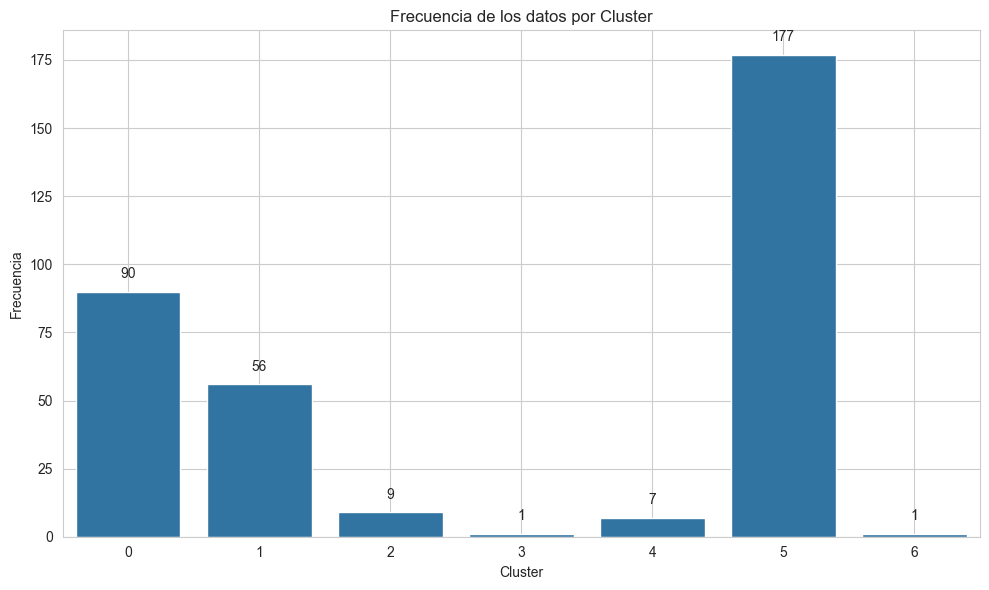

Dendrograma Simulado (Divisive Clustering):
Cluster 0 (Raíz)
├── Cluster 0 (90)
└── Cluster 1 (251)
    ├── Cluster 1 (56)
    └── Cluster 2 (195)
        ├── Cluster 2 (194)
        │   ├── Cluster 2 (187)
        │   │   ├── Cluster 2 (9)
        │   │   └── Cluster 5 (178)
        │   │       ├── Cluster 5 (177)
        │   │       └── Cluster 6 (1)
        │   └── Cluster 4 (7)
        └── Cluster 3 (1)
No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.


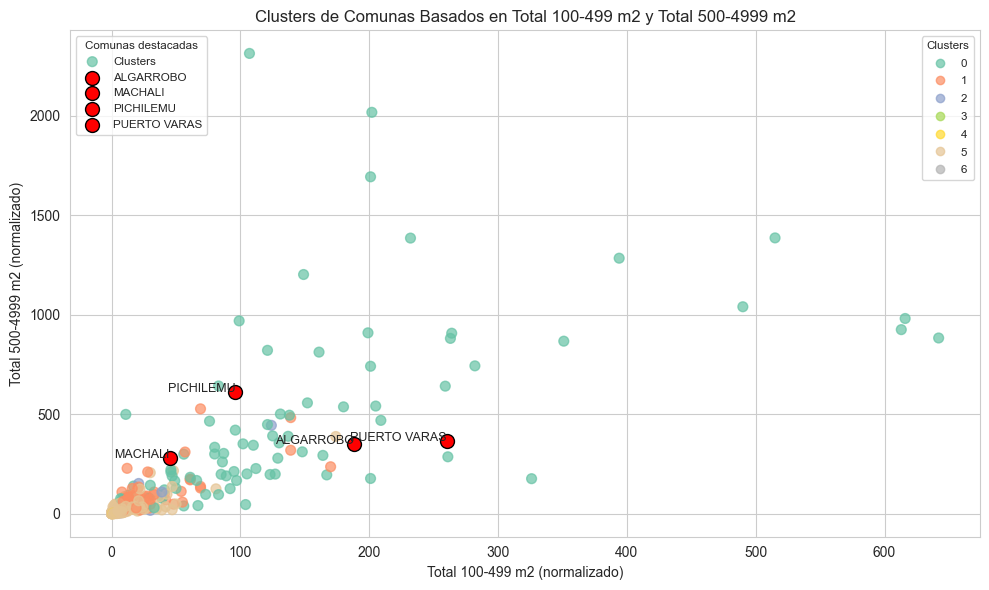


Media por cluster (solo variables seleccionadas):
         Total 100-499 m2  Total 500-4999 m2  Total 5000-10000 m2  \
cluster                                                             
0              141.444444         445.044444           587.522222   
1               33.767857         101.089286           480.821429   
2               30.000000          92.222222            34.888889   
3                1.000000           3.000000             7.000000   
4                2.000000           5.285714            49.142857   
5               10.248588          24.401130            86.480226   
6                1.000000           2.000000             2.000000   

         Total 10001-100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluster                                                          
0                   169.555556                       15.198509   
1                   145.035714                        9.088209   
2                    24.111111                       17.730217 

In [45]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from anytree import Node, RenderTree
from anytree.exporter import DotExporter

def divisive_clustering(data, variables_clustering, n_clusters):
    # Normalizar las variables
    X = data[variables_clustering]
    scaler = MinMaxScaler()
    X_normalizado = scaler.fit_transform(X)

    # Inicializar con un solo cluster que contiene todos los puntos
    clusters = np.zeros(X_normalizado.shape[0], dtype=int)
    cluster_labels = [0]  # Empezar con un único cluster etiquetado como '0'
    next_cluster_label = 1

    # Crear un nodo raíz para el dendrograma simulado
    root = Node("Cluster 0 (Raíz)")
    node_dict = {0: root}  # Diccionario para almacenar referencias a los nodos

    # Dividir recursivamente hasta alcanzar el número deseado de clusters
    while len(cluster_labels) < n_clusters:
        # Encuentra el cluster más grande para dividirlo
        largest_cluster = max(cluster_labels, key=lambda cl: np.sum(clusters == cl))
        cluster_indices = np.where(clusters == largest_cluster)[0]

        if len(cluster_indices) <= 1:  # Si solo queda un punto en el cluster, no se puede dividir
            break

        # Aplicar K-means con k=2 para dividir el cluster más grande
        kmeans = KMeans(n_clusters=2, random_state=42)
        subcluster_labels = kmeans.fit_predict(X_normalizado[cluster_indices])

        # Asignar nuevas etiquetas de cluster a los subclusters
        clusters[cluster_indices[subcluster_labels == 0]] = largest_cluster
        clusters[cluster_indices[subcluster_labels == 1]] = next_cluster_label

        # Crear nodos para los subclusters en el árbol jerárquico
        parent_node = node_dict[largest_cluster]
        node_dict[largest_cluster] = Node(f"Cluster {largest_cluster} ({np.sum(clusters == largest_cluster)})", parent=parent_node)
        node_dict[next_cluster_label] = Node(f"Cluster {next_cluster_label} ({np.sum(clusters == next_cluster_label)})", parent=parent_node)

        # Actualizar los labels de clusters
        cluster_labels.append(next_cluster_label)
        next_cluster_label += 1

        # Eliminar el cluster original si se ha dividido
        cluster_labels = [cl for cl in cluster_labels if np.sum(clusters == cl) > 0]

    # Añadir los clusters al DataFrame original
    data_divisivo = data.copy()
    data_divisivo['cluster'] = clusters

    # Paso 5: Visualizar frecuencia por cluster con el color deseado
    frecuencia_clusters = data_divisivo['cluster'].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values, color=sns.color_palette()[0])  # Color por defecto de Seaborn
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Simular un dendrograma
    print("Dendrograma Simulado (Divisive Clustering):")
    for pre, _, node in RenderTree(root):
        print(f"{pre}{node.name}")

    # Exportar dendrograma a archivo .png usando Graphviz si está instalado
    try:
        DotExporter(root).to_picture("dendrograma_divisivo.png")
        print("Dendrograma exportado a 'dendrograma_divisivo.png'")
    except Exception as e:
        print("No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.")

    return data_divisivo  # Retorna los datos con clusters asignados


# Llamar a la función con tus datos y variables
data_resultados = divisive_clustering(
    data_estadisticos, 
    variables_clustering, 
    n_clusters=7  # Número de clusters deseado
)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
scatter = plt.scatter(data_resultados[variables_clustering[0]], data_resultados[variables_clustering[1]], 
                      c=data_resultados['cluster'], cmap='Set2', s=50, alpha=0.7, label='Clusters')  # Usa Set2 para el gráfico de dispersión

# Comunas de interés y sus clusters
comunas_interes = ['PUERTO VARAS', 'PICHILEMU', 'ALGARROBO', 'MACHALI']
pos_comunas = data_resultados[data_resultados['comuna_match'].isin(comunas_interes)]

# Destacar las comunas de interés
for comuna, x, y in zip(pos_comunas['comuna_match'], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[0]], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[1]]):
    plt.scatter(x, y, color='red', s=100, label=comuna, edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="upper left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

# Personalización del gráfico de dispersión
plt.xlabel(f'{variables_clustering[0]} (normalizado)')
plt.ylabel(f'{variables_clustering[1]} (normalizado)')
plt.title('Clusters de Comunas Basados en ' + variables_clustering[0] + ' y ' + variables_clustering[1])
plt.grid(True)
plt.tight_layout()
plt.show()

# Calcular estadísticas por cluster
media_por_cluster = data_resultados.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_resultados.groupby('cluster')[variables_clustering].median()

# Imprimir las estadísticas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)

# Mostrar los clusters de las comunas de interés
print("\nClusters de las comunas de interés:")
print(pos_comunas[['comuna_match', 'cluster']])


## Comparación de clústers

In [61]:
import pandas as pd
Kmeans_SinPCA_1 = pd.read_csv("data recuperada/comunas cluster/comunas_SinPCA_1.csv")
Jerarq_SinPCA_1 = pd.read_csv("data recuperada/comunas cluster/comunas_jerarquico_SinPCA_1_7Clusters.csv")
Jerarq_SinPCA_2 = pd.read_csv("data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2_7Clústers.csv")
Divisive_SinPCA = pd.read_csv('data recuperada/comunas cluster/comunas_divisive.csv', index_col=0)

In [62]:
# Calcular la frecuencia por cluster de cada base
frecuencias = {
    "Kmeans_SinPCA_1": Kmeans_SinPCA_1['cluster'].value_counts().sort_index(),
    "Jerarq_SinPCA_1": Jerarq_SinPCA_1['cluster'].value_counts().sort_index(),
    "Jerarq_SinPCA_2": Jerarq_SinPCA_2['cluster'].value_counts().sort_index(),
    "Divisive_SinPCA": Divisive_SinPCA['cluster'].value_counts().sort_index()
}

# Mostrar las frecuencias por cluster de cada base
for metodo, frecuencias_metodo in frecuencias.items():
    print(f"Frecuencia de clusters en {metodo}:\n{frecuencias_metodo}\n")

Frecuencia de clusters en Kmeans_SinPCA_1:
cluster
0     46
1     16
2     13
3     15
4      5
5    209
6     37
Name: count, dtype: int64

Frecuencia de clusters en Jerarq_SinPCA_1:
cluster
0    235
1     61
2     14
3     18
4     11
5      1
6      1
Name: count, dtype: int64

Frecuencia de clusters en Jerarq_SinPCA_2:
cluster
0    237
1     14
2     19
3     24
4      1
5     45
6      1
Name: count, dtype: int64

Frecuencia de clusters en Divisive_SinPCA:
cluster
0     60
1     19
2     48
3     14
4    159
5      1
6     40
Name: count, dtype: int64



### Comparación comunas en el cluster 0 de Kmeans (Algarrobo y Pichilemu)

In [63]:
# Paso 1: Filtrar las comunas en el cluster 0 de Kmeans_SinPCA_1
kmeans_cluster_0 = Kmeans_SinPCA_1[Kmeans_SinPCA_1['cluster'] == 0]

# Paso 2: Combinar con Jerarq_SinPCA_1 y filtrar las comunas en el cluster 1 de Jerarq_SinPCA_1
comunas_cluster_0_vs_jerarq1_cluster_1 = kmeans_cluster_0.merge(
    Jerarq_SinPCA_1[Jerarq_SinPCA_1['cluster'] == 1],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq1')
)

# Paso 3: Combinar con Jerarq_SinPCA_2 y filtrar las comunas en el cluster 5 de Jerarq_SinPCA_2
comunas_cluster_0_vs_jerarq2_cluster_5 = kmeans_cluster_0.merge(
    Jerarq_SinPCA_2[Jerarq_SinPCA_2['cluster'] == 5],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq2')
)

# Paso 4: Combinar con Divisive_SinPCA y filtrar las comunas en el cluster 2 de Divisive_SinPCA
comunas_cluster_0_vs_divisive_cluster_2 = kmeans_cluster_0.merge(
    Divisive_SinPCA[Divisive_SinPCA['cluster'] == 2],
    on='comuna_match',
    suffixes=('_kmeans', '_divisive')
)

# Mostrar los resultados
print("Comunas en el cluster 0 de Kmeans y en el cluster 1 de Jerarq_SinPCA_1:")
print(comunas_cluster_0_vs_jerarq1_cluster_1)

print("\nComunas en el cluster 0 de Kmeans y en el cluster 5 de Jerarq_SinPCA_2:")
print(comunas_cluster_0_vs_jerarq2_cluster_5)

print("\nComunas en el cluster 0 de Kmeans y en el cluster 2 de Divisive_SinPCA:")
print(comunas_cluster_0_vs_divisive_cluster_2)

Comunas en el cluster 0 de Kmeans y en el cluster 1 de Jerarq_SinPCA_1:
       comuna_match  cluster_kmeans  cluster_jerarq1
0         ALGARROBO               0                1
1             ANCUD               0                1
2             AYSEN               0                1
3   CALERA DE TANGO               0                1
4        CASABLANCA               0                1
5            CASTRO               0                1
6           CHILLAN               0                1
7         COYHAIQUE               0                1
8          CURACAVI               0                1
9            CURICO               0                1
10        FRUTILLAR               0                1
11          FUTRONO               0                1
12         LA LIGUA               0                1
13       LAGO RANCO               0                1
14          LIMACHE               0                1
15          LINARES               0                1
16      LOS ANGELES        

### Comparación comunas en el cluster 1 de Kmeans (Pto Varas)

In [65]:
# Paso 1: Filtrar las comunas en el cluster 0 de Kmeans_SinPCA_1
kmeans_cluster_1 = Kmeans_SinPCA_1[Kmeans_SinPCA_1['cluster'] == 1]

# Paso 2: Combinar con Jerarq_SinPCA_1 y filtrar las comunas en el cluster 1 de Jerarq_SinPCA_1
comunas_cluster_1_vs_jerarq1_cluster_2 = kmeans_cluster_1.merge(
    Jerarq_SinPCA_1[Jerarq_SinPCA_1['cluster'] == 2],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq1')
)

# Paso 3: Combinar con Jerarq_SinPCA_2 y filtrar las comunas en el cluster 5 de Jerarq_SinPCA_2
comunas_cluster_1_vs_jerarq2_cluster_1 = kmeans_cluster_1.merge(
    Jerarq_SinPCA_2[Jerarq_SinPCA_2['cluster'] == 1],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq2')
)

# Paso 4: Combinar con Divisive_SinPCA y filtrar las comunas en el cluster 2 de Divisive_SinPCA
comunas_cluster_1_vs_divisive_cluster_1 = kmeans_cluster_1.merge(
    Divisive_SinPCA[Divisive_SinPCA['cluster'] == 1],
    on='comuna_match',
    suffixes=('_kmeans', '_divisive')
)

# Mostrar los resultados
print("Comunas en el cluster 1 de Kmeans y en el cluster 2 de Jerarq_SinPCA_1:")
print(comunas_cluster_1_vs_jerarq1_cluster_2)

print("\nComunas en el cluster 1 de Kmeans y en el cluster 1 de Jerarq_SinPCA_2:")
print(comunas_cluster_1_vs_jerarq2_cluster_1)

print("\nComunas en el cluster 1 de Kmeans y en el cluster 1 de Divisive_SinPCA:")
print(comunas_cluster_1_vs_divisive_cluster_1)

Comunas en el cluster 1 de Kmeans y en el cluster 2 de Jerarq_SinPCA_1:
    comuna_match  cluster_kmeans  cluster_jerarq1
0         COLINA               1                2
1     CONCEPCION               1                2
2       COQUIMBO               1                2
3      LA SERENA               1                2
4          PUCON               1                2
5   PUERTO MONTT               1                2
6   PUERTO VARAS               1                2
7       SANTIAGO               1                2
8          TALCA               1                2
9         TEMUCO               1                2
10      VALDIVIA               1                2
11    VALPARAISO               1                2
12    VILLARRICA               1                2
13  VINA DEL MAR               1                2

Comunas en el cluster 1 de Kmeans y en el cluster 1 de Jerarq_SinPCA_2:
    comuna_match  cluster_kmeans  cluster_jerarq2
0         COLINA               1                1
1    

### Comparación comunas en el cluster 6 de Kmeans (Machalí)

In [66]:
# Paso 1: Filtrar las comunas en el cluster 0 de Kmeans_SinPCA_1
kmeans_cluster_6 = Kmeans_SinPCA_1[Kmeans_SinPCA_1['cluster'] == 6]

# Paso 2: Combinar con Jerarq_SinPCA_1 y filtrar las comunas en el cluster 1 de Jerarq_SinPCA_1
comunas_cluster_6_vs_jerarq1_cluster_1 = kmeans_cluster_6.merge(
    Jerarq_SinPCA_1[Jerarq_SinPCA_1['cluster'] == 1],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq1')
)

# Paso 3: Combinar con Jerarq_SinPCA_2 y filtrar las comunas en el cluster 5 de Jerarq_SinPCA_2
comunas_cluster_6_vs_jerarq2_cluster_3 = kmeans_cluster_6.merge(
    Jerarq_SinPCA_2[Jerarq_SinPCA_2['cluster'] == 3],
    on='comuna_match',
    suffixes=('_kmeans', '_jerarq2')
)

# Paso 4: Combinar con Divisive_SinPCA y filtrar las comunas en el cluster 2 de Divisive_SinPCA
comunas_cluster_6_vs_divisive_cluster_0 = kmeans_cluster_6.merge(
    Divisive_SinPCA[Divisive_SinPCA['cluster'] == 0],
    on='comuna_match',
    suffixes=('_kmeans', '_divisive')
)

# Mostrar los resultados
print("Comunas en el cluster 6 de Kmeans y en el cluster 1 de Jerarq_SinPCA_1:")
print(comunas_cluster_6_vs_jerarq1_cluster_1)

print("\nComunas en el cluster 6 de Kmeans y en el cluster 3 de Jerarq_SinPCA_2:")
print(comunas_cluster_6_vs_jerarq2_cluster_3)

print("\nComunas en el cluster 6 de Kmeans y en el cluster 0 de Divisive_SinPCA:")
print(comunas_cluster_6_vs_divisive_cluster_0)

Comunas en el cluster 6 de Kmeans y en el cluster 1 de Jerarq_SinPCA_1:
            comuna_match  cluster_kmeans  cluster_jerarq1
0                  ARICA               6                1
1                   BUIN               6                1
2                 CALAMA               6                1
3              CARTAGENA               6                1
4            CHIGUAYANTE               6                1
5                 CONCON               6                1
6                COPIAPO               6                1
7                CORONEL               6                1
8              EL QUISCO               6                1
9                EL TABO               6                1
10               HUALPEN               6                1
11                 LAMPA               6                1
12             LOS ANDES               6                1
13               MACHALI               6                1
14                 MAIPU               6                1


## Clustering por semestre

### Data con estadisticos agrupada por comuna y semestre

In [44]:
import pandas as pd
data_2021 = pd.read_csv("data recuperada/data_sin_outliers.csv")
data_2021

,id,concat,publicada,created_at,data_source,tipo,sub_tipo,precio_clp,precio_uf,region,comuna,latitude,longitude,total_o_terreno,util_o_construido,active,fecha_finalizacion,precio_clp_inicial,precio_uf_inicial,descripcion_sin_saltos,direccion_sin_saltos,descripcion_2,region_norm,comuna_norm,comuna_match,superficies_dict,mayor_superficie,diferencia_pct,diferencia_abs,semestre,descripcion_normalizada,duplicados_con,duplicado,valor_uf_inicial,valor_uf,margen_uf_inicial,margen_uf,dif_pct_abs,UF_Ha,total_o_terreno_ha,UF_Ha_inicial,superficie_Ha,valores_terreno,costo_m2_uf,rango_superficie,is_outlier
0,678938,https://www.portalinmobiliario.com/venta/sitio...,2021-02-05,2021-01-05,Portalinmobiliario,Terreno,Terreno,6.164553e+07,2100.000000,VALPARAISO,Algarrobo,-33.370747,-71.676971,400.0,0.0,False,2021-08-18,6.106544e+07,2100.000000,"Sitios urbanizados con vista al mar lejana , i...",Jorge Matte S / N,NaN,VALPARAISO,ALGARROBO,ALGARROBO,{},NaN,NaN,NaN,2021S1,sitios urbanizados con vista al mar lejana ide...,[],False,29078.782857,29355.013333,1,1,NaN,52500.000000,0.0400,52500.000000,0.0400,{},5.250000,100-499 m2,0
1,707064,https://www.portalinmobiliario.com/venta/sitio...,2021-01-19,2021-01-28,Portalinmobiliario,Terreno,Terreno,3.900000e+07,1339.501911,VALPARAISO,Algarrobo,-33.333958,-71.643402,185.0,0.0,False,2021-02-23,3.900000e+07,1339.501911,"Gran oportunidad de compra, terreno con factib...",Las Parcelas S / N,NaN,VALPARAISO,ALGARROBO,ALGARROBO,{},NaN,NaN,NaN,2021S1,gran oportunidad de compra terreno con factibi...,[],False,29115.300000,29115.300000,1,1,NaN,72405.508722,0.0185,72405.508722,0.0185,{},7.240551,100-499 m2,0
2,746705,https://www.portalinmobiliario.com/MLC-5792674...,2021-01-30,2021-02-04,Portalinmobiliario,Terreno,Terreno,5.700000e+07,1947.685842,VALPARAISO,Algarrobo,-33.377218,-71.678380,350.0,0.0,False,2021-03-10,5.679678e+07,1950.000000,"REAL OPORTUNIDAD!!!!Se Vende Sitio de 350 m2 ,...","El Alerce 1444, Algarrobo, Chile",NaN,VALPARAISO,ALGARROBO,ALGARROBO,{'superficie_1': 350.0},350.0,0.0,0.0,2021S1,real oportunidadse vende sitio de 350 m2 en vi...,[],False,29126.552308,29265.500000,1,1,0.000000,55648.166905,0.0350,55714.285714,0.0350,"{'valor_1': {'valor': 350.0, 'moneda': 'descon...",5.564817,100-499 m2,0
3,843165,https://www.yapo.cl/valparaiso/comprar/en_vent...,2021-02-22,2021-02-24,Yapo,Terreno,Terreno,5.500000e+07,1884.030000,VALPARAISO,Algarrobo,0.000000,0.000000,455.0,0.0,False,2021-08-15,5.500000e+07,1884.030000,"Sitio Urbanizado, con Luz, ubicado en sector r...",NaN,NaN,VALPARAISO,ALGARROBO,ALGARROBO,{},NaN,NaN,NaN,2021S1,sitio urbanizado con luz ubicado en sector res...,[],False,29192.741092,29192.741092,1,1,NaN,41407.252747,0.0455,41407.252747,0.0455,{},4.140725,100-499 m2,0
4,846906,https://www.yapo.cl/valparaiso/comprar/inviert...,2021-02-20,2021-02-24,Yapo,Terreno,Terreno,2.400000e+08,8221.230000,VALPARAISO,Algarrobo,-33.335314,-71.650047,422.0,0.0,False,2021-08-15,2.400000e+08,8221.230000,"SE VENDE TERRENO CON DOS CASAS, 1 CASA CON 4 D...","V Valparaíso, Algarrobo",NaN,VALPARAISO,ALGARROBO,ALGARROBO,"{'superficie_4': 422.0, 'superficie_5': 210.0}",422.0,0.0,0.0,2021S1,se vende terreno con dos casas 1 casa con 4 de...,[],False,29192.712039,29192.712039,1,1,0.000000,194815.876777,0.0422,194815.876777,0.0422,"{'valor_1': {'valor': 1.0, 'moneda': 'desconoc...",19.481588,100-499 m2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200265,2268461,https://www.portalinmobiliario.com/MLC-1964824...,2024-03-16,2022-01-21,Portalinmobiliario,Terreno,Terreno,7.251596e+08,19500.000000,VALPARAISO,Zapallar,-32.577840,-71.451120,353987.0,NaN,False,2024-04-29,6.537831e+08,21000.000000,Parque Cachagua es un condominio privado con u...,NaN,NaN,VALPARAISO,ZAPALLAR,ZAPALLAR,"{'superficie_1': 4500.0, 'superficie_2': 35398...",353987.0,-98.52480458321917,348765.0,2024S1,parque cachagua

In [4]:
import pandas as pd

# Definir los rangos de superficie de interés, incluyendo 100-499 m²
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']

# Paso 1: Calcular el total de datos por comuna y semestre
data_comuna_semestre = data_2021.groupby(['comuna_match', 'semestre']).size().reset_index(name='Total de Datos')

# Paso 2: Calcular el porcentaje y total de datos por rango de superficie en cada comuna y semestre
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular el total de datos en ese rango por comuna y semestre
    data_rango_total = data_rango.groupby(['comuna_match', 'semestre']).size().reset_index(name=f'Total {rango}')

    # Calcular el porcentaje de datos en ese rango sobre el total de la comuna y semestre
    data_comuna_semestre = data_comuna_semestre.merge(data_rango_total, on=['comuna_match', 'semestre'], how='left')
    data_comuna_semestre[f'% {rango}'] = (data_comuna_semestre[f'Total {rango}'] / data_comuna_semestre['Total de Datos']) * 100

# Paso 3: Calcular las estadísticas (mediana, media, desviación estándar, min, max) de costo_m2_uf por rango de superficie en cada comuna y semestre
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango_estadisticas = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular las estadísticas
    data_estadisticas = data_rango_estadisticas.groupby(['comuna_match', 'semestre']).agg(
        mediana=(f'costo_m2_uf', 'median'),
        media=(f'costo_m2_uf', 'mean'),
        desviacion_std=(f'costo_m2_uf', 'std'),
        min_costo=(f'costo_m2_uf', 'min'),
        max_costo=(f'costo_m2_uf', 'max')
    ).reset_index()

    # Renombrar las columnas para cada rango de superficie
    data_estadisticas.rename(columns={
        'mediana': f'Mediana costo_m2_uf {rango}',
        'media': f'Media costo_m2_uf {rango}',
        'desviacion_std': f'Desviación costo_m2_uf {rango}',
        'min_costo': f'Mínimo costo_m2_uf {rango}',
        'max_costo': f'Máximo costo_m2_uf {rango}'
    }, inplace=True)

    # Combinar con la tabla principal
    data_comuna_semestre = data_comuna_semestre.merge(data_estadisticas, on=['comuna_match', 'semestre'], how='left')

# Rellenar NaN con 0 para valores que no tienen datos
data_comuna_semestre.fillna(0, inplace=True)

# Mostrar la tabla
print(data_comuna_semestre.head())

# Guardar en un archivo CSV
data_comuna_semestre.to_csv('data recuperada/estadisticos_por_semestre_comuna_y_rango.csv', index=False)


  comuna_match semestre  Total de Datos  Total 100-499 m2  % 100-499 m2  \
0    ALGARROBO   2021S1             142              31.0     21.830986   
1    ALGARROBO   2021S2             149              12.0      8.053691   
2    ALGARROBO   2022S1             167              20.0     11.976048   
3    ALGARROBO   2022S2             233              32.0     13.733906   
4    ALGARROBO   2023S1             244              29.0     11.885246   

   Total 500-4999 m2  % 500-4999 m2  Total 5000-10000 m2  % 5000-10000 m2  \
0               31.0      21.830986                 66.0        46.478873   
1               40.0      26.845638                 75.0        50.335570   
2               32.0      19.161677                 76.0        45.508982   
3               45.0      19.313305                101.0        43.347639   
4               53.0      21.721311                120.0        49.180328   

   Total 10001-100000 m2  ...  Mediana costo_m2_uf 10001-100000 m2  \
0               

In [94]:
import pandas as pd
estadisticos_semestre = pd.read_csv('data recuperada/estadisticos_por_semestre_comuna_y_rango.csv')
estadisticos_semestre

,comuna_match,semestre,Total de Datos,Total 100-499 m2,% 100-499 m2,Total 500-4999 m2,% 500-4999 m2,Total 5000-10000 m2,% 5000-10000 m2,Total 10001-100000 m2,% 10001-100000 m2,Total >100000 m2,% >100000 m2,Mediana costo_m2_uf 100-499 m2,Media costo_m2_uf 100-499 m2,Desviación costo_m2_uf 100-499 m2,Mínimo costo_m2_uf 100-499 m2,Máximo costo_m2_uf 100-499 m2,Mediana costo_m2_uf 500-4999 m2,Media costo_m2_uf 500-4999 m2,Desviación costo_m2_uf 500-4999 m2,Mínimo costo_m2_uf 500-4999 m2,Máximo costo_m2_uf 500-4999 m2,Mediana costo_m2_uf 5000-10000 m2,Media costo_m2_uf 5000-10000 m2,Desviación costo_m2_uf 5000-10000 m2,Mínimo costo_m2_uf 5000-10000 m2,Máximo costo_m2_uf 5000-10000 m2,Mediana costo_m2_uf 10001-100000 m2,Media costo_m2_uf 10001-100000 m2,Desviación costo_m2_uf 10001-100000 m2,Mínimo costo_m2_uf 10001-100000 m2,Máximo costo_m2_uf 10001-100000 m2,Mediana costo_m2_uf >100000 m2,Media costo_m2_uf >100000 m2,Desviación costo_m2_uf >100000 m2,Mínimo costo_m2_uf >100000 m2,Máximo costo_m2_uf >100000 m2
0,ALGARROBO,2021S1,142,31.0,21.830986,31.0,21.830986,66.0,46.478873,12.0,8.450704,2.0,1.408451,5.925500,8.610495,9.898526,0.011643,52.320000,2.480943,2.620044,1.358218,0.273084,5.083080,0.399880,0.526748,0.329988,0.235988,1.498408,0.345579,0.700189,0.899662,0.000055,2.742016,0.129689,0.129689,0.115753,0.047839,0.211538
1,ALGARROBO,2021S2,149,12.0,8.053691,40.0,26.845638,75.0,50.335570,20.0,13.422819,2.0,1.342282,6.333880,7.685372,8.184522,0.014620,32.098315,1.731762,3.242686,3.811540,0.000059,15.417376,0.500000,0.741872,0.524791,0.000011,2.156863,0.135408,0.494753,0.750820,0.000045,2.736403,0.056252,0.056252,0.012371,0.047504,0.065000
2,ALGARROBO,2022S1,167,20.0,11.976048,32.0,19.161677,76.0,45.508982,34.0,20.359281,5.0,2.994012,5.823894,6.257281,4.212642,0.014286,20.173333,1.526846,3.137775,3.662804,0.378621,12.780000,0.511325,0.645412,0.458832,0.000013,1.700000,0.063945,0.323220,0.661236,0.000001,2.736403,0.053287,0.065534,0.043381,0.030250,0.135268
3,ALGARROBO,2022S2,233,32.0,13.733906,45.0,19.313305,101.0,43.347639,45.0,19.313305,10.0,4.291845,5.662500,6.639499,4.222420,0.881999,18.956250,1.950000,2.690488,1.866240,0.336800,9.105960,0.570000,0.750990,0.473202,0.155240,2.622642,0.074176,0.240164,0.348479,0.000013,1.238095,0.061972,0.105773,0.082327,0.026940,0.211538
4,ALGARROBO,2023S1,244,29.0,11.885246,53.0,21.721311,120.0,49.180328,40.0,16.393443,2.0,0.819672,5.952121,16.465138,22.481503,0.014286,67.741935,1.685000,2.886864,3.380518,0.001015,15.417376,0.540000,0.726723,0.479162,0.248675,2.296788,0.092568,0.285604,0.357849,0.047680,1.248751,0.126042,0.126042,0.036828,0.100000,0.152083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2595,ZAPALLAR,2022S2,192,21.0,10.937500,87.0,45.312500,56.0,29.166667,26.0,13.541667,2.0,1.041667,35.650000,36.114167,9.667491,19.902913,53.246753,6.818182,9.653161,6.199113,2.850877,27.083333,0.373012,1.074883,1.278897,0.100200,4.300000,0.210000,0.364573,0.466329,0.000226,2.250000,0.019385,0.019385,0.000000,0.019385,0.019385
2596,ZAPALLAR,2023S1,265,26.0,9.811321,116.0,43.773585,77.0,29.056604,38.0,14.339623,8.0,3.018868,33.666667,31.278267,12.697886,11.607143,51.666667,6.000000,9.365122,7.612511,0.692653,36.488027,0.760000,1.658631,1.671045,0.098789,6.481481,0.245128,0.524198,0.729239,0.074718,3.000000,0.077543,0.136892,0.146022,0.019231,0.369000
2597,ZAPALLAR,2023S2,417,55.0,13.189448,200.0,47.961631,108.0,25.899281,52.0,12.470024,2.0,0.479616,29.660714,30.015857,11.481962,11.607143,64.285714,6.288597,9.584016,7.069453,0.685500,36.488027,1.348273,1.621685,1.307411,0.081399,4.313725,0.300000,0.877705,1.765094,0.089680,7.588533,0.079945,0.079945,0.028363,0.059889,0.100000
2598,ZAPALLAR,2024S1,441,45.0,10.204082,218.0,49.433107,111.0,25.170068,58.0,13.151927,9.0,2.040816,26.666667,30.699597,13.548197,5.960250,73.000000,8.600000,10.918749,6.982672,2.731591,31.444368,0.691832,1.312294,1.153

In [8]:
estadisticos_semestre.columns

Index(['comuna_match', 'semestre', 'Total de Datos', 'Total 100-499 m2',
       '% 100-499 m2', 'Total 500-4999 m2', '% 500-4999 m2',
       'Total 5000-10000 m2', '% 5000-10000 m2', 'Total 10001-100000 m2',
       '% 10001-100000 m2', 'Total >100000 m2', '% >100000 m2',
       'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2',
       'Desviación costo_m2_uf 100-499 m2', 'Mínimo costo_m2_uf 100-499 m2',
       'Máximo costo_m2_uf 100-499 m2', 'Mediana costo_m2_uf 500-4999 m2',
       'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
       'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
       'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2',
       'Desviación costo_m2_uf 5000-10000 m2',
       'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
       'Mediana costo_m2_uf 10001-100000 m2',
       'Media costo_m2_uf 10001-100000 m2',
       'Desviación costo_m2_uf 10001-100000 m2',
      

In [68]:
import pandas as pd

# Definir los rangos de superficie de interés, incluyendo 100-499 m²
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']

# Paso 1: Calcular el total de datos por comuna y semestre
data_comuna_semestre = data_2021.groupby(['comuna_match', 'semestre']).size().reset_index(name='Total de Datos')

# Paso 2: Calcular el total de datos por rango de superficie en cada comuna y semestre (omitimos los %)
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular el total de datos en ese rango por comuna y semestre
    data_rango_total = data_rango.groupby(['comuna_match', 'semestre']).size().reset_index(name=f'Total {rango}')
    
    # Combinar con la tabla principal
    data_comuna_semestre = data_comuna_semestre.merge(data_rango_total, on=['comuna_match', 'semestre'], how='left')

# Paso 3: Calcular las estadísticas (mediana, media, desviación estándar, min, max) de costo_m2_uf por rango de superficie en cada comuna y semestre
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango_estadisticas = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular las estadísticas
    data_estadisticas = data_rango_estadisticas.groupby(['comuna_match', 'semestre']).agg(
        mediana=(f'costo_m2_uf', 'median'),
        media=(f'costo_m2_uf', 'mean'),
        desviacion_std=(f'costo_m2_uf', 'std'),
        min_costo=(f'costo_m2_uf', 'min'),
        max_costo=(f'costo_m2_uf', 'max')
    ).reset_index()

    # Renombrar las columnas para cada rango de superficie
    data_estadisticas.rename(columns={
        'mediana': f'Mediana costo_m2_uf {rango}',
        'media': f'Media costo_m2_uf {rango}',
        'desviacion_std': f'Desviación costo_m2_uf {rango}',
        'min_costo': f'Mínimo costo_m2_uf {rango}',
        'max_costo': f'Máximo costo_m2_uf {rango}'
    }, inplace=True)

    # Combinar con la tabla principal
    data_comuna_semestre = data_comuna_semestre.merge(data_estadisticas, on=['comuna_match', 'semestre'], how='left')

# Rellenar NaN con 0 para valores que no tienen datos
data_comuna_semestre.fillna(0, inplace=True)

# Pivotar la tabla para tener una fila por comuna y columnas separadas por semestre y métricas
data_comuna_pivot = data_comuna_semestre.pivot(index='comuna_match', columns='semestre')

# Aplanar el MultiIndex en las columnas para un formato más limpio
data_comuna_pivot.columns = ['_'.join(map(str, col)).strip() for col in data_comuna_pivot.columns.values]
data_comuna_pivot.reset_index(inplace=True)

# Reemplazar NaN por 0 en el DataFrame pivotado
data_comuna_pivot.fillna(0, inplace=True)

# Mostrar la tabla transformada
print(data_comuna_pivot.head())

# Guardar en un archivo CSV
data_comuna_pivot.to_csv('data recuperada/estadisticos_por_comuna_y_rango_pivot.csv', index=False)



      comuna_match  Total de Datos_2021S1  Total de Datos_2021S2  \
0        ALGARROBO                  142.0                  149.0   
1            ALHUE                    3.0                    2.0   
2      ALTO BIOBIO                    3.0                    3.0   
3  ALTO DEL CARMEN                    1.0                    0.0   
4    ALTO HOSPICIO                   26.0                   41.0   

   Total de Datos_2022S1  Total de Datos_2022S2  Total de Datos_2023S1  \
0                  167.0                  233.0                  244.0   
1                    6.0                    9.0                    2.0   
2                    3.0                    2.0                    0.0   
3                    1.0                    6.0                    4.0   
4                   23.0                   49.0                   41.0   

   Total de Datos_2023S2  Total de Datos_2024S1  Total de Datos_2024S2  \
0                  248.0                  335.0                   84.0  

In [3]:
data_semestre_pivot =pd.read_csv('data recuperada/estadisticos_por_comuna_y_rango_pivot.csv')

In [4]:
data_semestre_pivot.columns

Index(['comuna_match', 'Total de Datos_2021S1', 'Total de Datos_2021S2',
       'Total de Datos_2022S1', 'Total de Datos_2022S2',
       'Total de Datos_2023S1', 'Total de Datos_2023S2',
       'Total de Datos_2024S1', 'Total de Datos_2024S2',
       'Total 100-499 m2_2021S1',
       ...
       'Mínimo costo_m2_uf >100000 m2_2024S1',
       'Mínimo costo_m2_uf >100000 m2_2024S2',
       'Máximo costo_m2_uf >100000 m2_2021S1',
       'Máximo costo_m2_uf >100000 m2_2021S2',
       'Máximo costo_m2_uf >100000 m2_2022S1',
       'Máximo costo_m2_uf >100000 m2_2022S2',
       'Máximo costo_m2_uf >100000 m2_2023S1',
       'Máximo costo_m2_uf >100000 m2_2023S2',
       'Máximo costo_m2_uf >100000 m2_2024S1',
       'Máximo costo_m2_uf >100000 m2_2024S2'],
      dtype='object', length=289)

### Normalización variables N°datos, media, mediana,desv

In [5]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Lista base de variables sin diferenciación por semestre, incluyendo el rango >100000 m2 y las nuevas métricas (mínimo y máximo)
variables_clustering_base = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2', 'Total >100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2']

# Semestres a considerar
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Generar la lista de variables diferenciadas por semestre
variables_clustering = [f"{var}_{semestre}" for semestre in semestres for var in variables_clustering_base]

# Paso 2: Extraer las variables para el clustering
X = data_semestre_pivot[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Imprimir la lista de variables resultante
print(variables_clustering)

['Total 100-499 m2_2021S1', 'Total 500-4999 m2_2021S1', 'Total 5000-10000 m2_2021S1', 'Total 10001-100000 m2_2021S1', 'Total >100000 m2_2021S1', 'Mediana costo_m2_uf 100-499 m2_2021S1', 'Media costo_m2_uf 100-499 m2_2021S1', 'Desviación costo_m2_uf 100-499 m2_2021S1', 'Mediana costo_m2_uf 500-4999 m2_2021S1', 'Media costo_m2_uf 500-4999 m2_2021S1', 'Desviación costo_m2_uf 500-4999 m2_2021S1', 'Mediana costo_m2_uf 5000-10000 m2_2021S1', 'Media costo_m2_uf 5000-10000 m2_2021S1', 'Desviación costo_m2_uf 5000-10000 m2_2021S1', 'Mediana costo_m2_uf 10001-100000 m2_2021S1', 'Media costo_m2_uf 10001-100000 m2_2021S1', 'Desviación costo_m2_uf 10001-100000 m2_2021S1', 'Mediana costo_m2_uf >100000 m2_2021S1', 'Media costo_m2_uf >100000 m2_2021S1', 'Desviación costo_m2_uf >100000 m2_2021S1', 'Total 100-499 m2_2021S2', 'Total 500-4999 m2_2021S2', 'Total 5000-10000 m2_2021S2', 'Total 10001-100000 m2_2021S2', 'Total >100000 m2_2021S2', 'Mediana costo_m2_uf 100-499 m2_2021S2', 'Media costo_m2_uf 100-

### Kmeans N°datos, media, mediana, desv (por semestre y rango de superficie)

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

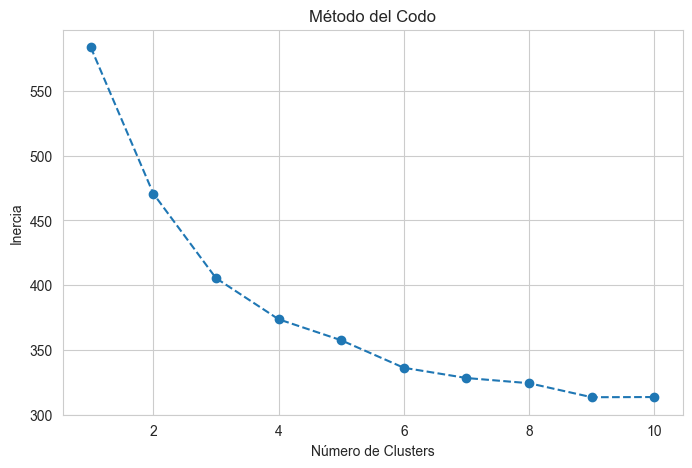

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


Silhouette Score para el modelo: 0.2363


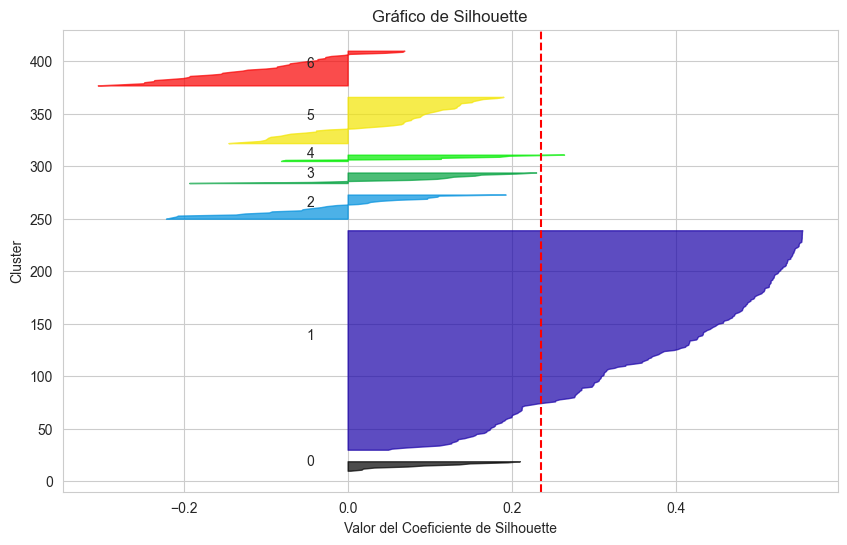

C:\Users\franc\AppData\Local\Temp\ipykernel_26068\1928401704.py:82: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc="upper left")


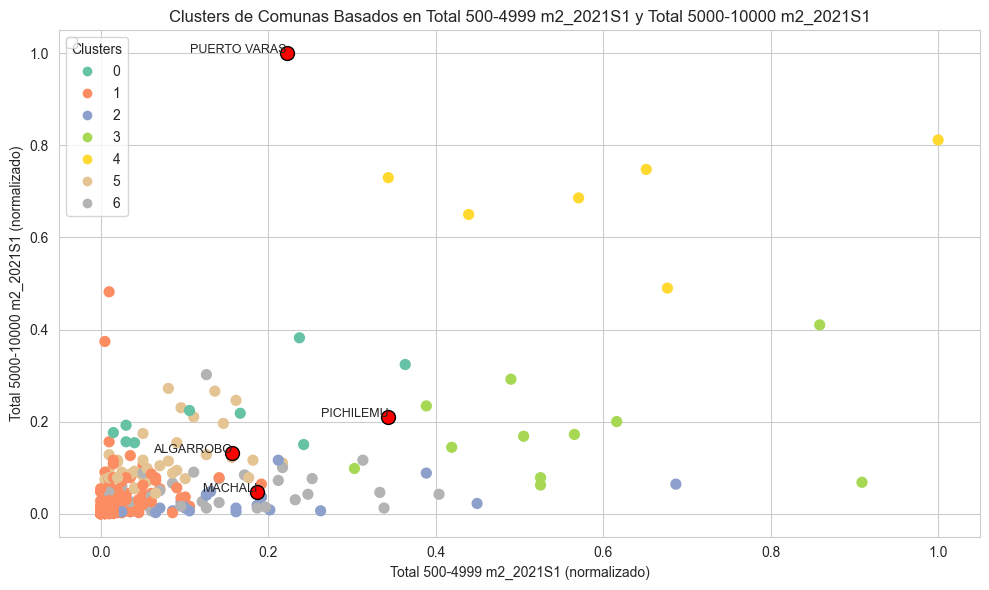


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 4
Comuna MACHALI pertenece al cluster 6
Comuna ALGARROBO pertenece al cluster 5
Comuna PICHILEMU pertenece al cluster 5

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2_2021S1  Total 500-4999 m2_2021S1  \
cluster                                                      
0                       9.500000                 24.600000   
1                       1.519048                  3.442857   
2                      12.750000                 34.750000   
3                      42.545455                109.909091   
4                      35.000000                110.428571   
5                       6.111111                 15.066667   
6                       9.705882                 27.823529   

         Total 5000-10000 m2_2021S1  Total 10001-100000 m2_2021S1  \
cluster                                                             
0                        102.700000                

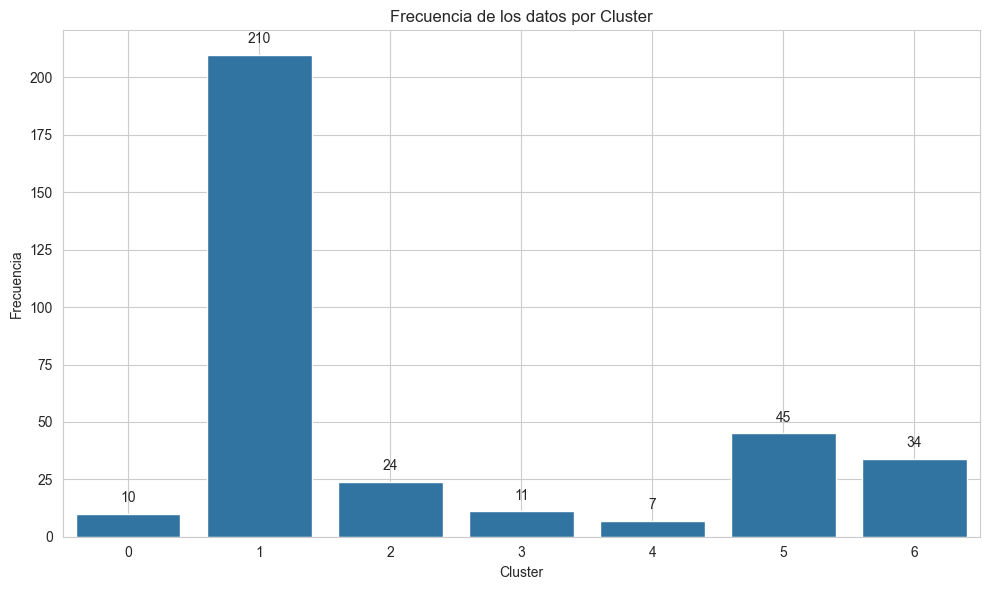

In [8]:
data_clustering_semestres = realizar_clustering_sin_pca(data_semestre_pivot, variables_clustering, 7, True, True, 'Total 500-4999 m2_2021S1', 'Total 5000-10000 m2_2021S1')

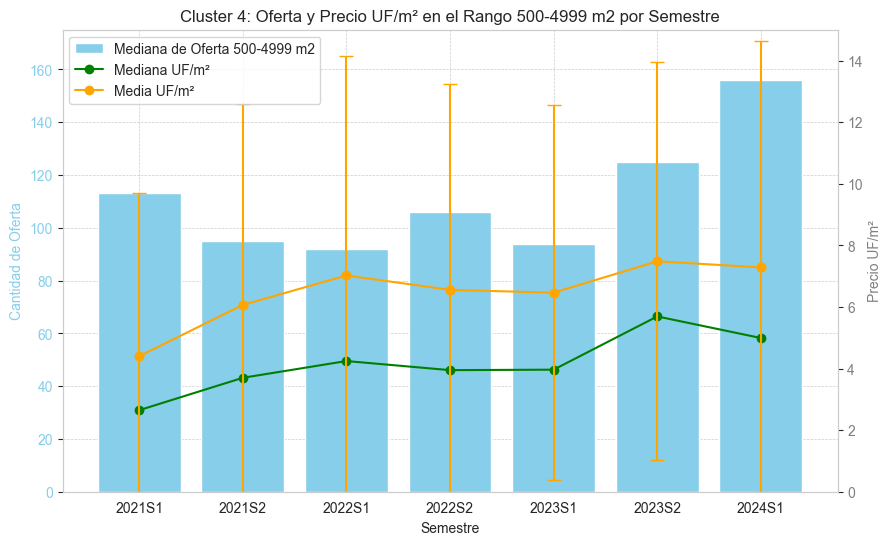

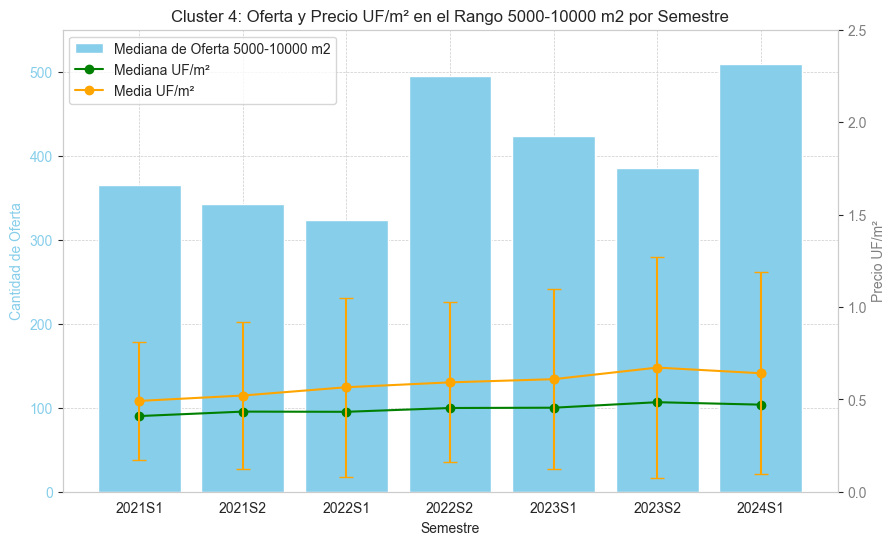

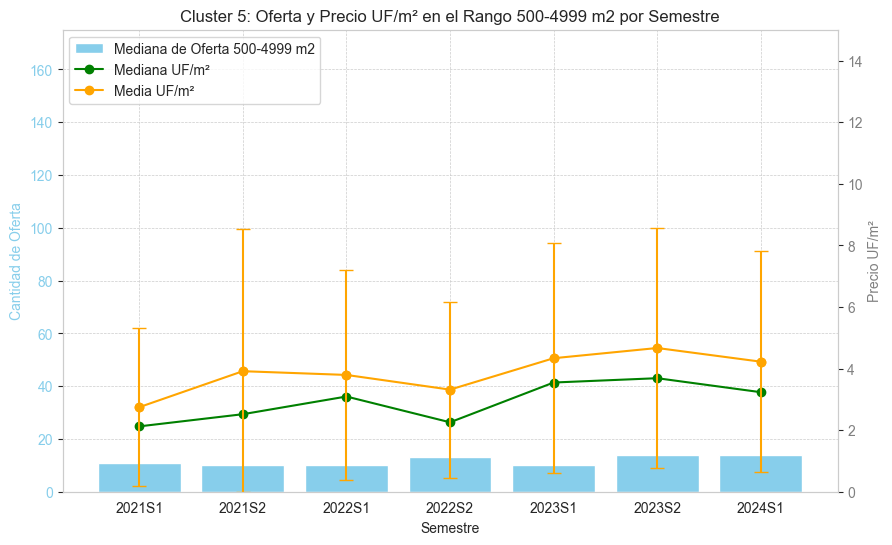

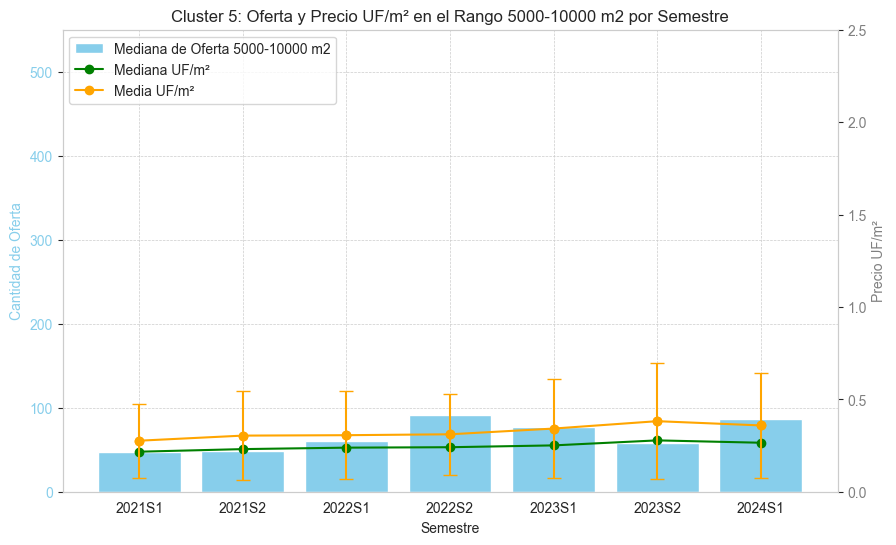

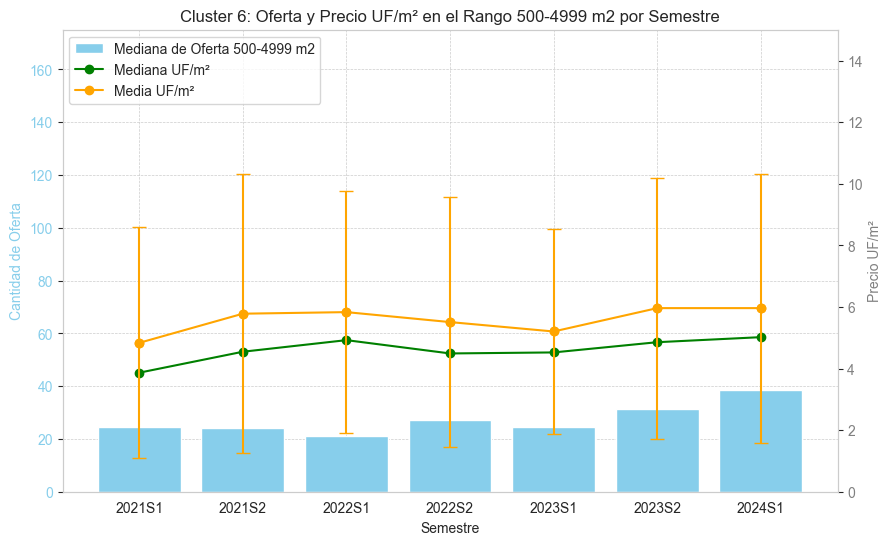

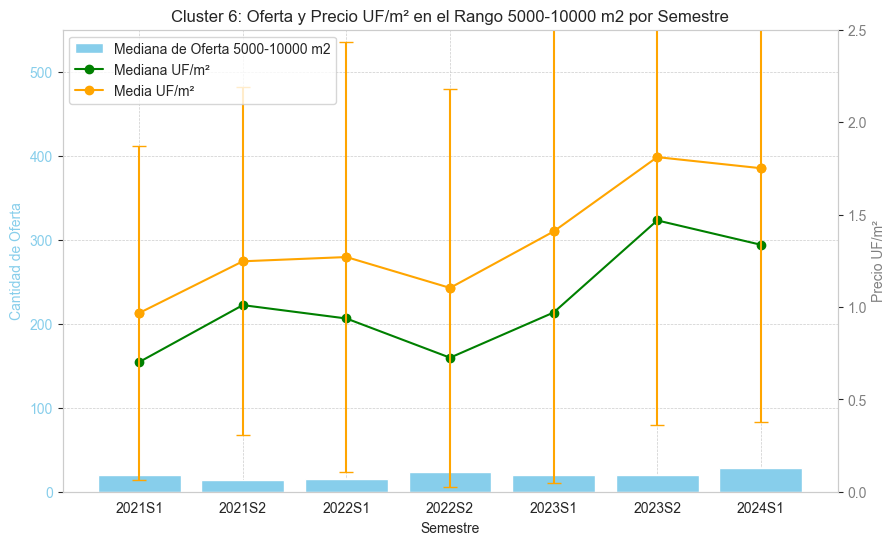

In [99]:
import matplotlib.pyplot as plt
import pandas as pd

# Filtrar los datos para los clusters 0, 1 y 3
clusters_a_graficar = [4, 5, 6]
data_cluster = data_clustering_semestres[data_clustering_semestres['cluster'].isin(clusters_a_graficar)]

# Semestres a usar en el gráfico
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Rango de superficie y variables
rangos_superficie = ['500-4999 m2', '5000-10000 m2']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta_500_4999 = 175     # Límite superior de cantidad de oferta para el rango 500-4999 m²
max_y_uf_500_4999 = 15          # Límite superior de precio UF/m² para el rango 500-4999 m²

max_y_oferta_5000_10000 = 550  # Límite superior de cantidad de oferta para el rango 5000-10000 m²
max_y_uf_5000_10000 = 2.5        # Límite superior de precio UF/m² para el rango 5000-10000 m²

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    for rango in rangos_superficie:
        # Filtrar los datos del cluster actual
        data_cluster_actual = data_cluster[data_cluster['cluster'] == cluster]

        # Definir las variables para el gráfico
        if rango == '500-4999 m2':
            total_oferta = [data_cluster_actual[f'Total 500-4999 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_500_4999
            max_y_uf = max_y_uf_500_4999
        else:
            total_oferta = [data_cluster_actual[f'Total 5000-10000 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_5000_10000
            max_y_uf = max_y_uf_5000_10000

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta)  # Fijar el límite superior de oferta manualmente

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf)  # Fijar el límite superior del precio UF/m² manualmente

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivamos el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0,1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()



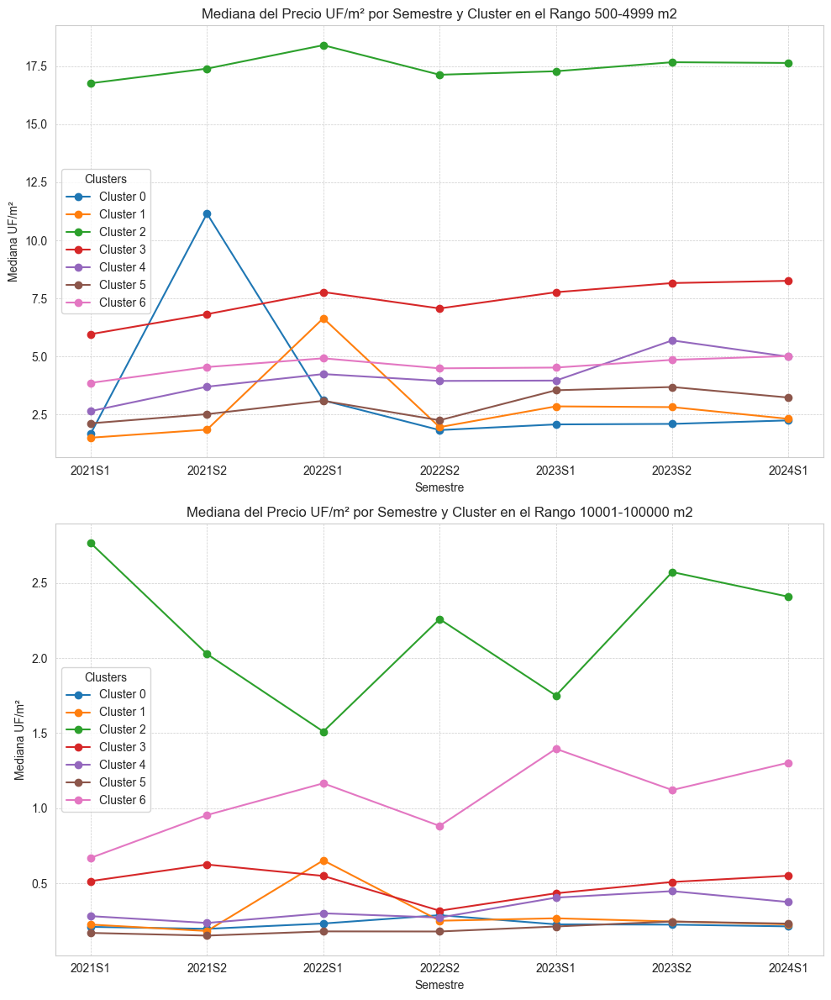

In [100]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = data_clustering_semestres[data_clustering_semestres['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()



In [9]:
data_clustering_semestres.to_csv("data recuperada/comunas cluster/kmeans_semestres_numdatos.csv", index = False)

### Jerarquico N°datos, media, mediana, desv (por semestre y rango de superficie)

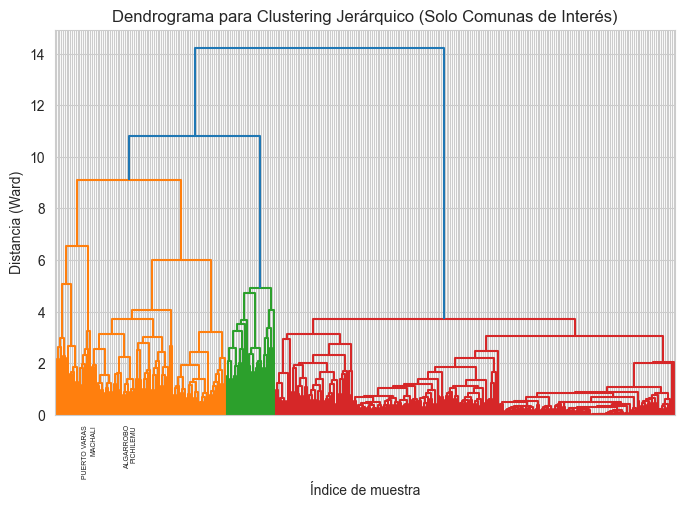

Silhouette Score para el modelo jerárquico: 0.3144


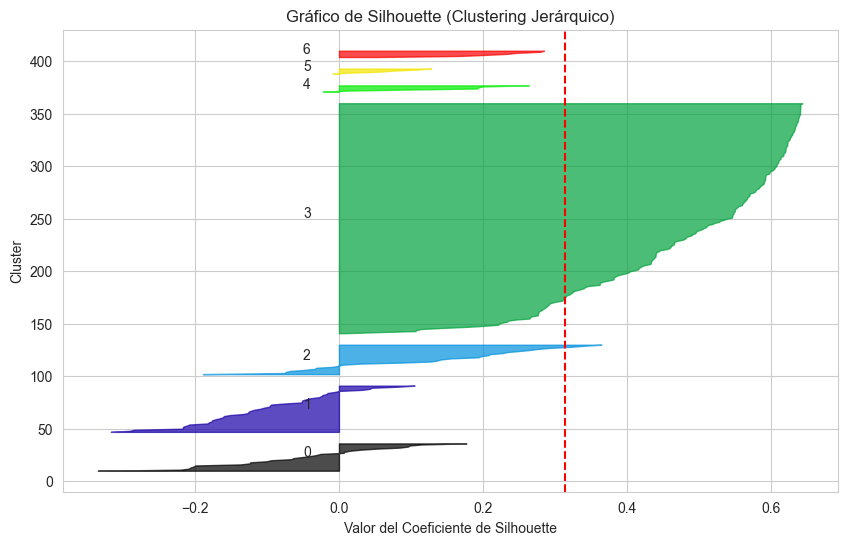

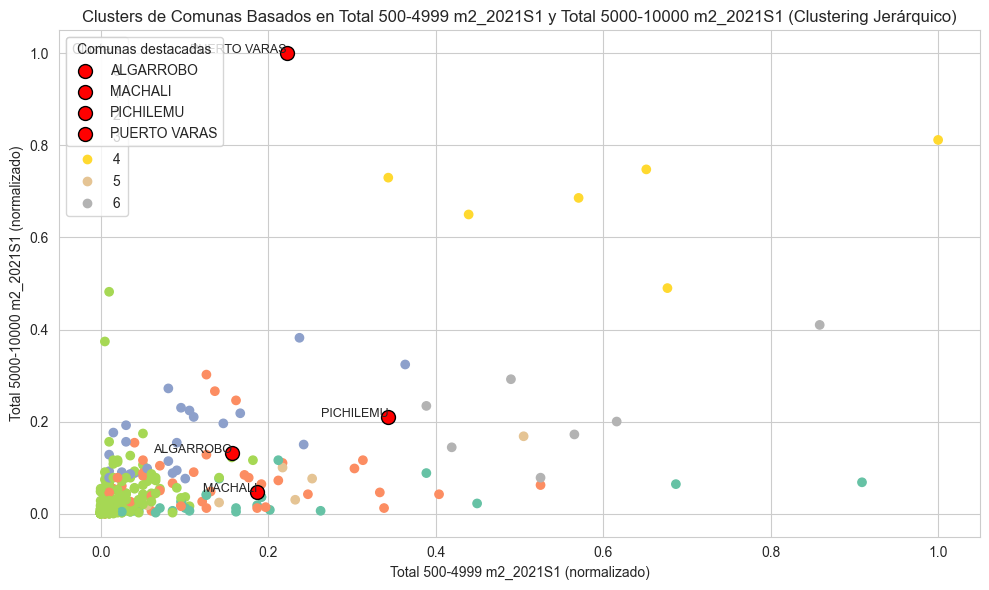


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 4
Comuna MACHALI pertenece al cluster 1
Comuna ALGARROBO pertenece al cluster 1
Comuna PICHILEMU pertenece al cluster 1

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2_2021S1  Total 500-4999 m2_2021S1  \
cluster                                                      
0                      11.777778                 38.222222   
1                      10.444444                 28.266667   
2                       6.275862                 16.068966   
3                       1.540909                  3.740909   
4                      35.000000                110.428571   
5                      14.166667                 46.333333   
6                      57.000000                109.285714   

         Total 5000-10000 m2_2021S1  Total 10001-100000 m2_2021S1  \
cluster                                                             
0                         13.925926                

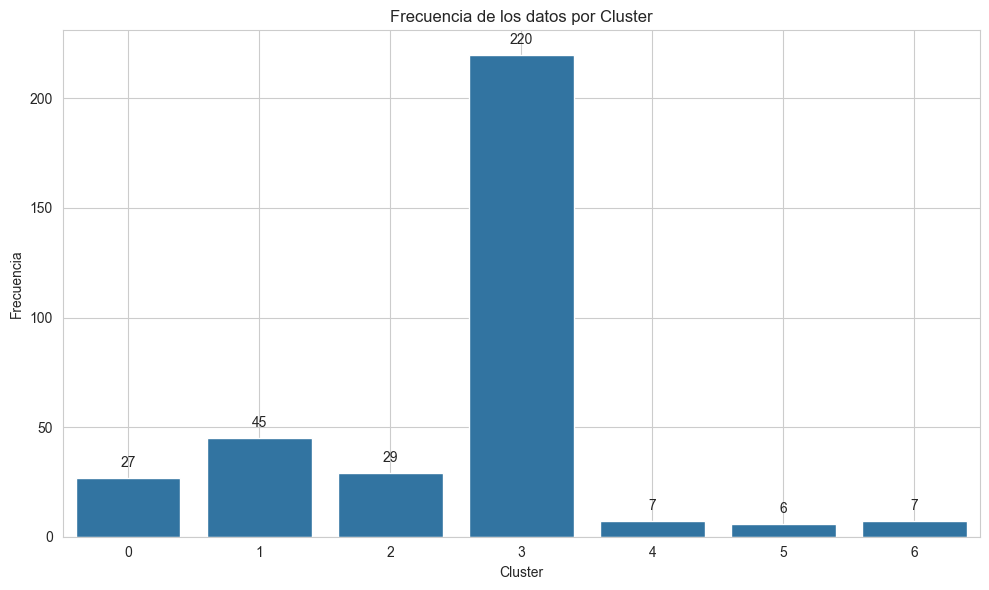

In [11]:
jerarquico_semestres = realizar_clustering_jerarquico_sin_pca(data_semestre_pivot, variables_clustering,7,True,True,'Total 500-4999 m2_2021S1', 'Total 5000-10000 m2_2021S1')

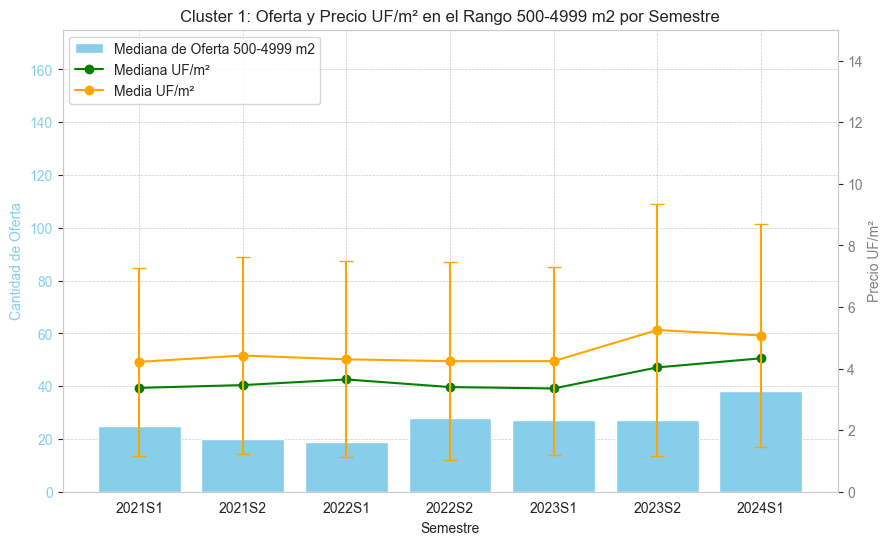

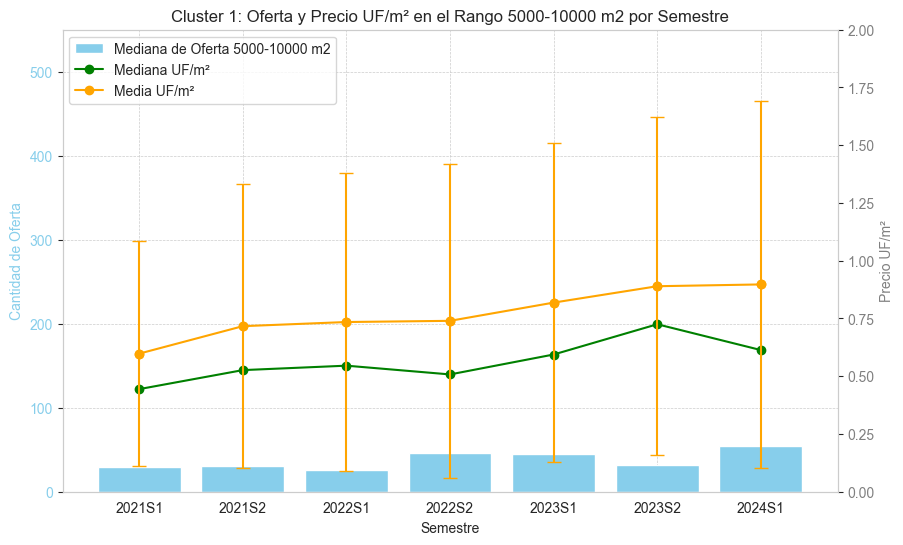

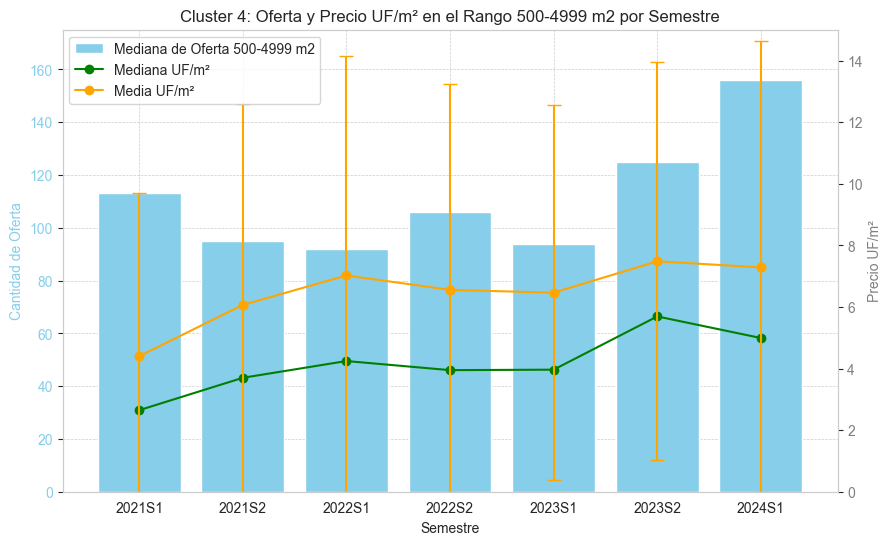

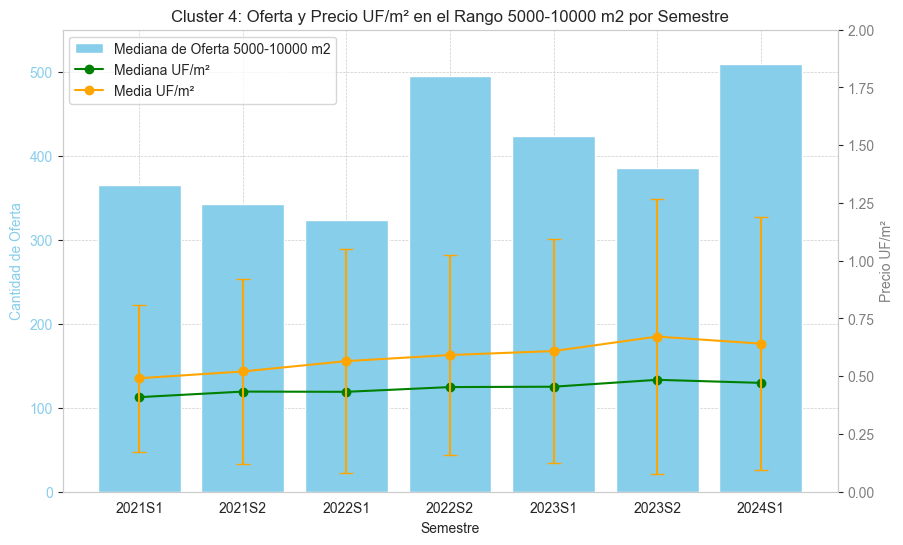

In [102]:
import matplotlib.pyplot as plt
import pandas as pd

# Filtrar los datos para los clusters 0, 1 y 3
clusters_a_graficar = [1, 4]
data_cluster = jerarquico_semestres[jerarquico_semestres['cluster'].isin(clusters_a_graficar)]

# Semestres a usar en el gráfico
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Rango de superficie y variables
rangos_superficie = ['500-4999 m2', '5000-10000 m2']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta_500_4999 = 175     # Límite superior de cantidad de oferta para el rango 500-4999 m²
max_y_uf_500_4999 = 15          # Límite superior de precio UF/m² para el rango 500-4999 m²

max_y_oferta_5000_10000 = 550  # Límite superior de cantidad de oferta para el rango 5000-10000 m²
max_y_uf_5000_10000 = 2        # Límite superior de precio UF/m² para el rango 5000-10000 m²

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    for rango in rangos_superficie:
        # Filtrar los datos del cluster actual
        data_cluster_actual = data_cluster[data_cluster['cluster'] == cluster]

        # Definir las variables para el gráfico
        if rango == '500-4999 m2':
            total_oferta = [data_cluster_actual[f'Total 500-4999 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_500_4999
            max_y_uf = max_y_uf_500_4999
        else:
            total_oferta = [data_cluster_actual[f'Total 5000-10000 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_5000_10000
            max_y_uf = max_y_uf_5000_10000

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta)  # Fijar el límite superior de oferta manualmente

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf)  # Fijar el límite superior del precio UF/m² manualmente

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivamos el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0,1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()

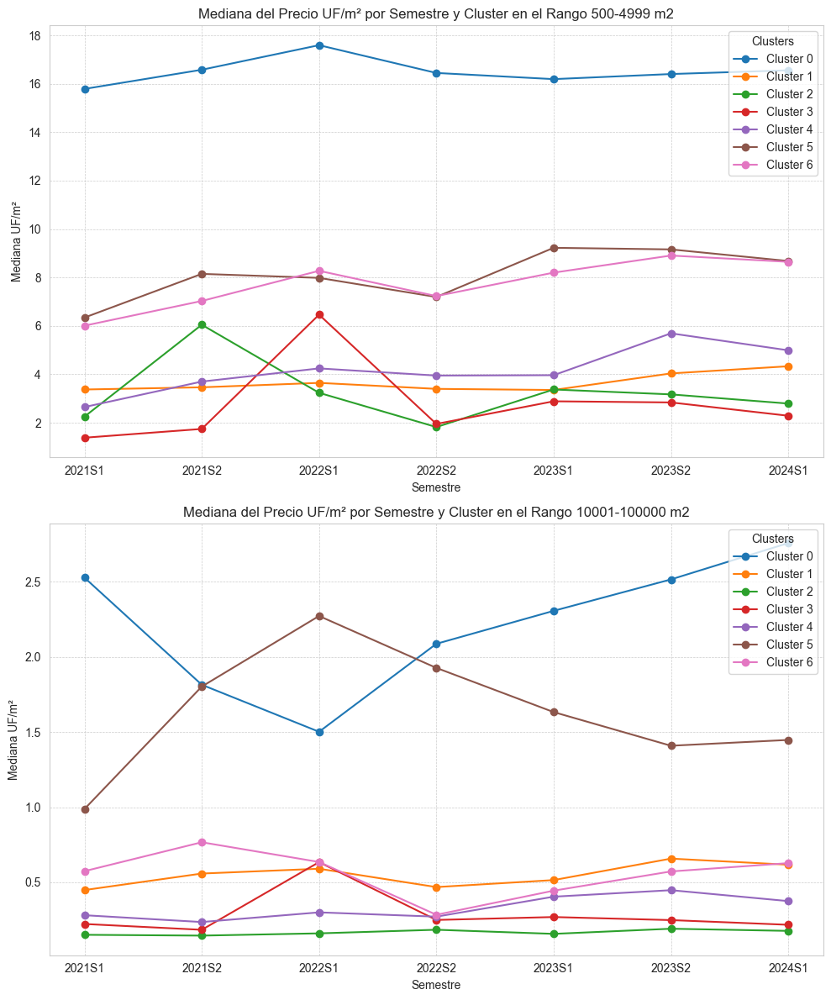

In [103]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = jerarquico_semestres[jerarquico_semestres['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [12]:
# jerarquico_semestres.to_csv("data recuperada/comunas cluster/jerarquico_semestres_numdatos.csv", index = False)

### Divisive Clustering N°Datos, media, mediana, desv (semestre y rango de superficies)

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

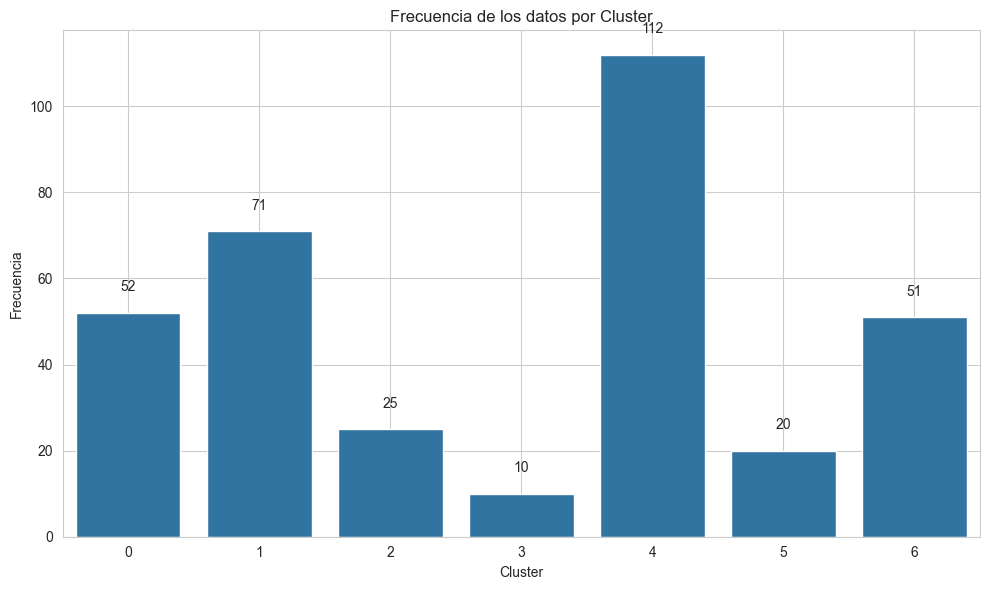

Dendrograma Simulado (Divisive Clustering):
Cluster 0 (Raíz)
├── Cluster 0 (52)
└── Cluster 1 (289)
    ├── Cluster 1 (264)
    │   ├── Cluster 1 (71)
    │   └── Cluster 3 (193)
    │       ├── Cluster 3 (10)
    │       └── Cluster 4 (183)
    │           ├── Cluster 4 (163)
    │           │   ├── Cluster 4 (112)
    │           │   └── Cluster 6 (51)
    │           └── Cluster 5 (20)
    └── Cluster 2 (25)
No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.


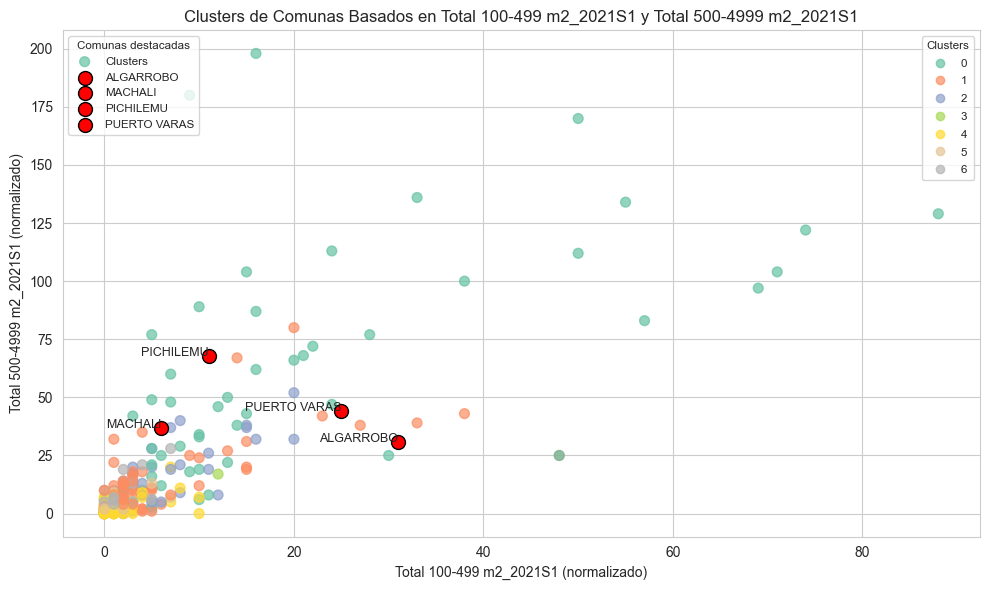


Media por cluster (solo variables seleccionadas):
         Total 100-499 m2_2021S1  Total 500-4999 m2_2021S1  \
cluster                                                      
0                      22.076923                 63.211538   
1                       6.126761                 14.591549   
2                       8.000000                 20.400000   
3                       3.000000                  5.200000   
4                       1.080357                  1.857143   
5                       1.500000                  3.250000   
6                       1.450980                  4.921569   

         Total 5000-10000 m2_2021S1  Total 10001-100000 m2_2021S1  \
cluster                                                             
0                        112.557692                     30.384615   
1                         35.746479                     13.478873   
2                          8.320000                      3.240000   
3                         10.400000          

In [13]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from anytree import Node, RenderTree
from anytree.exporter import DotExporter

def divisive_clustering(data, variables_clustering, n_clusters):
    # Normalizar las variables
    X = data[variables_clustering]
    scaler = MinMaxScaler()
    X_normalizado = scaler.fit_transform(X)

    # Inicializar con un solo cluster que contiene todos los puntos
    clusters = np.zeros(X_normalizado.shape[0], dtype=int)
    cluster_labels = [0]  # Empezar con un único cluster etiquetado como '0'
    next_cluster_label = 1

    # Crear un nodo raíz para el dendrograma simulado
    root = Node("Cluster 0 (Raíz)")
    node_dict = {0: root}  # Diccionario para almacenar referencias a los nodos

    # Dividir recursivamente hasta alcanzar el número deseado de clusters
    while len(cluster_labels) < n_clusters:
        # Encuentra el cluster más grande para dividirlo
        largest_cluster = max(cluster_labels, key=lambda cl: np.sum(clusters == cl))
        cluster_indices = np.where(clusters == largest_cluster)[0]

        if len(cluster_indices) <= 1:  # Si solo queda un punto en el cluster, no se puede dividir
            break

        # Aplicar K-means con k=2 para dividir el cluster más grande
        kmeans = KMeans(n_clusters=2, random_state=42)
        subcluster_labels = kmeans.fit_predict(X_normalizado[cluster_indices])

        # Asignar nuevas etiquetas de cluster a los subclusters
        clusters[cluster_indices[subcluster_labels == 0]] = largest_cluster
        clusters[cluster_indices[subcluster_labels == 1]] = next_cluster_label

        # Crear nodos para los subclusters en el árbol jerárquico
        parent_node = node_dict[largest_cluster]
        node_dict[largest_cluster] = Node(f"Cluster {largest_cluster} ({np.sum(clusters == largest_cluster)})", parent=parent_node)
        node_dict[next_cluster_label] = Node(f"Cluster {next_cluster_label} ({np.sum(clusters == next_cluster_label)})", parent=parent_node)

        # Actualizar los labels de clusters
        cluster_labels.append(next_cluster_label)
        next_cluster_label += 1

        # Eliminar el cluster original si se ha dividido
        cluster_labels = [cl for cl in cluster_labels if np.sum(clusters == cl) > 0]

    # Añadir los clusters al DataFrame original
    data_divisivo = data.copy()
    data_divisivo['cluster'] = clusters

    # Guardar el listado de comunas con su cluster en un archivo CSV
    #data_divisivo[['comuna_match', 'cluster']].to_csv("data recuperada/comunas cluster/divisive_1.csv", index=False)

    # Paso 5: Visualizar frecuencia por cluster con el color deseado
    frecuencia_clusters = data_divisivo['cluster'].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values, color=sns.color_palette()[0])  # Color por defecto de Seaborn
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Simular un dendrograma
    print("Dendrograma Simulado (Divisive Clustering):")
    for pre, _, node in RenderTree(root):
        print(f"{pre}{node.name}")

    # Exportar dendrograma a archivo .png usando Graphviz si está instalado
    try:
        DotExporter(root).to_picture("dendrograma_divisivo.png")
        print("Dendrograma exportado a 'dendrograma_divisivo.png'")
    except Exception as e:
        print("No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.")

    return data_divisivo  # Retorna los datos con clusters asignados


# Llamar a la función con tus datos y variables
divisive_semestres = divisive_clustering(
    data_semestre_pivot,
    variables_clustering,
    n_clusters=7  # Número de clusters deseado
)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
scatter = plt.scatter(divisive_semestres[variables_clustering[0]], divisive_semestres[variables_clustering[1]],
                      c=divisive_semestres['cluster'], cmap='Set2', s=50, alpha=0.7, label='Clusters')  # Usa Set2 para el gráfico de dispersión

# Comunas de interés y sus clusters
comunas_interes = ['PUERTO VARAS', 'PICHILEMU', 'ALGARROBO', 'MACHALI']
pos_comunas = divisive_semestres[divisive_semestres['comuna_match'].isin(comunas_interes)]

# Destacar las comunas de interés
for comuna, x, y in zip(pos_comunas['comuna_match'],
                        divisive_semestres.loc[pos_comunas.index, variables_clustering[0]],
                        divisive_semestres.loc[pos_comunas.index, variables_clustering[1]]):
    plt.scatter(x, y, color='red', s=100, label=comuna, edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="upper left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

# Personalización del gráfico de dispersión
plt.xlabel(f'{variables_clustering[0]} (normalizado)')
plt.ylabel(f'{variables_clustering[1]} (normalizado)')
plt.title('Clusters de Comunas Basados en ' + variables_clustering[0] + ' y ' + variables_clustering[1])
plt.grid(True)
plt.tight_layout()
plt.show()

# Calcular estadísticas por cluster
media_por_cluster = divisive_semestres.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = divisive_semestres.groupby('cluster')[variables_clustering].median()

# Imprimir las estadísticas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)

# Mostrar los clusters de las comunas de interés
print("\nClusters de las comunas de interés:")
print(pos_comunas[['comuna_match', 'cluster']])

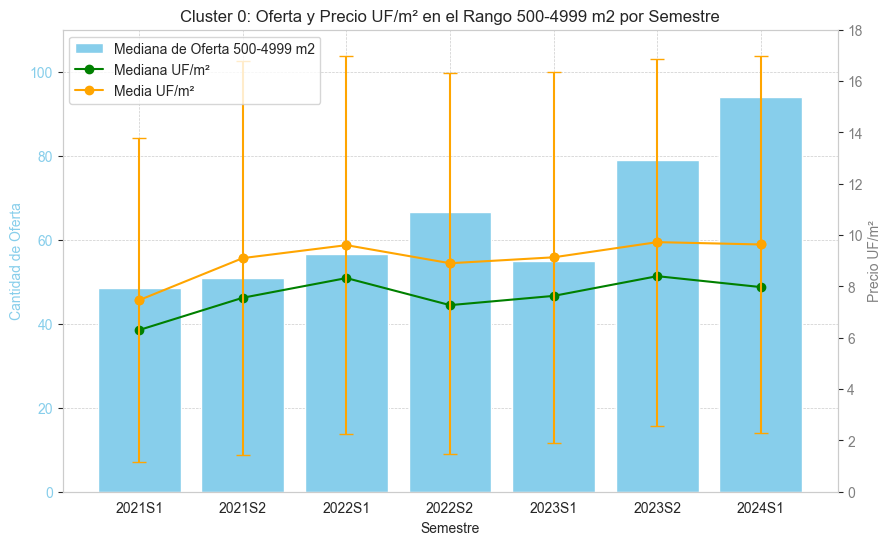

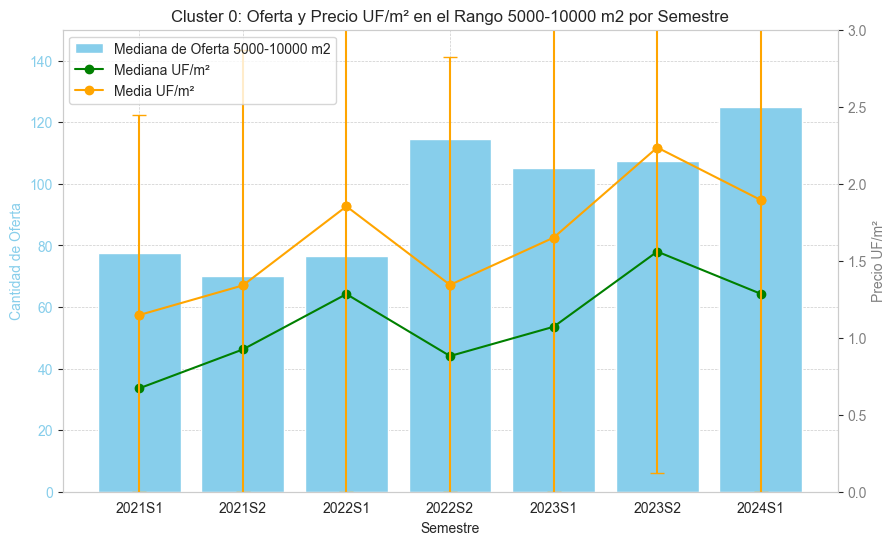

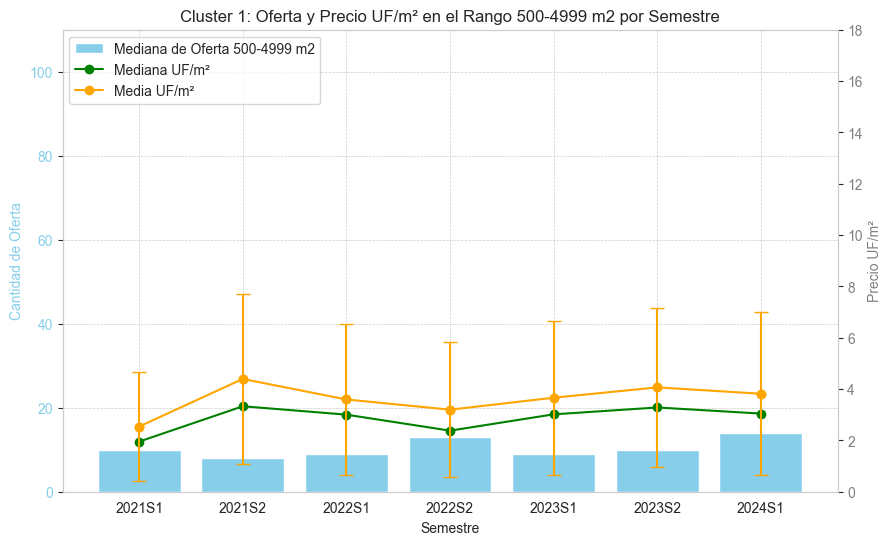

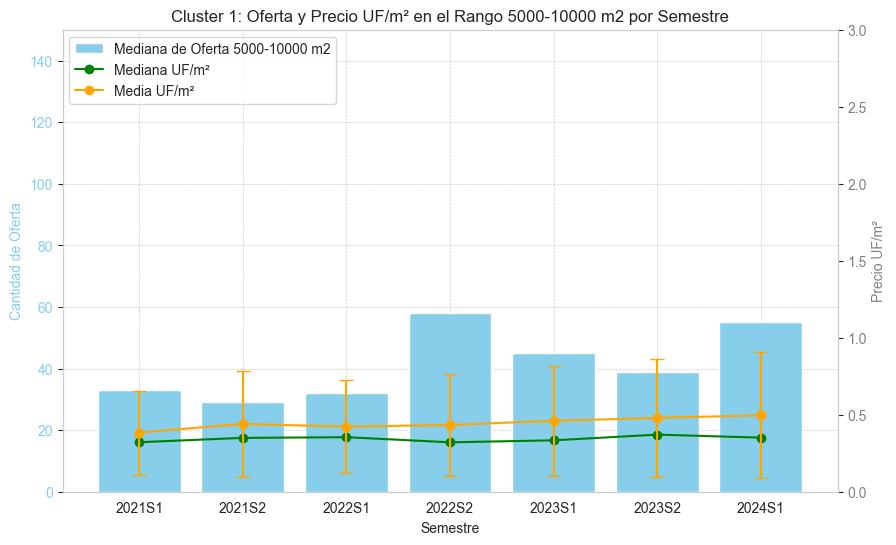

In [105]:
import matplotlib.pyplot as plt
import pandas as pd

# Filtrar los datos para los clusters 0, 1 y 3
clusters_a_graficar = [0, 1]
data_cluster = divisive_semestres[divisive_semestres['cluster'].isin(clusters_a_graficar)]

# Semestres a usar en el gráfico
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Rango de superficie y variables
rangos_superficie = ['500-4999 m2', '5000-10000 m2']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta_500_4999 = 110     # Límite superior de cantidad de oferta para el rango 500-4999 m²
max_y_uf_500_4999 = 18          # Límite superior de precio UF/m² para el rango 500-4999 m²

max_y_oferta_5000_10000 = 150  # Límite superior de cantidad de oferta para el rango 5000-10000 m²
max_y_uf_5000_10000 = 3        # Límite superior de precio UF/m² para el rango 5000-10000 m²

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    for rango in rangos_superficie:
        # Filtrar los datos del cluster actual
        data_cluster_actual = data_cluster[data_cluster['cluster'] == cluster]

        # Definir las variables para el gráfico
        if rango == '500-4999 m2':
            total_oferta = [data_cluster_actual[f'Total 500-4999 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_500_4999
            max_y_uf = max_y_uf_500_4999
        else:
            total_oferta = [data_cluster_actual[f'Total 5000-10000 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_5000_10000
            max_y_uf = max_y_uf_5000_10000

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta)  # Fijar el límite superior de oferta manualmente

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf)  # Fijar el límite superior del precio UF/m² manualmente

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivamos el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0,1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()

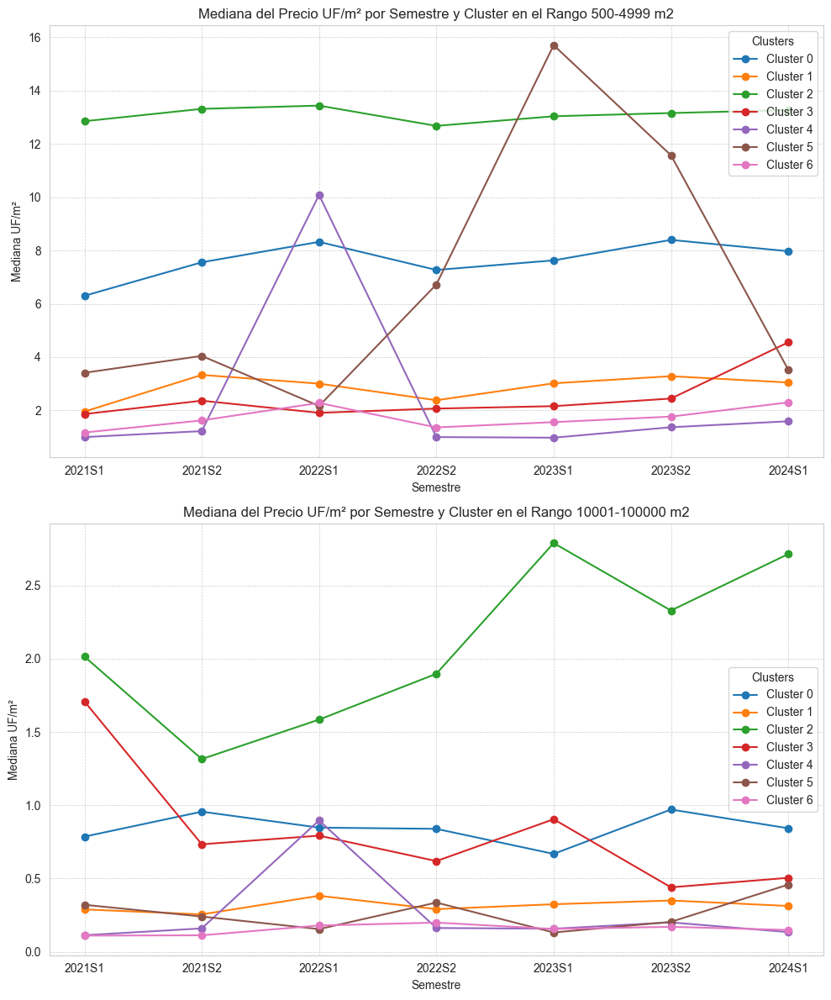

In [106]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = divisive_semestres[divisive_semestres['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [14]:
divisive_semestres.to_csv("data recuperada/comunas cluster/divisive_semestres_numdatos.csv", index = False)

### Normalización variables N°datos, media, mediana ,desv estandar

In [15]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Lista base de variables sin diferenciación por semestre, incluyendo el rango >100000 m2 y las nuevas métricas (mínimo y máximo)
variables_clustering_base = [
    'Total 100-499 m2', 'Total 500-4999 m2', 'Total 5000-10000 m2', 'Total 10001-100000 m2', 'Total >100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]

# Semestres a considerar
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Generar la lista de variables diferenciadas por semestre
variables_clustering = [f"{var}_{semestre}" for semestre in semestres for var in variables_clustering_base]

# Paso 2: Extraer las variables para el clustering
X = data_semestre_pivot[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Imprimir la lista de variables resultante
print(variables_clustering)



['Total 100-499 m2_2021S1', 'Total 500-4999 m2_2021S1', 'Total 5000-10000 m2_2021S1', 'Total 10001-100000 m2_2021S1', 'Total >100000 m2_2021S1', 'Mediana costo_m2_uf 100-499 m2_2021S1', 'Media costo_m2_uf 100-499 m2_2021S1', 'Desviación costo_m2_uf 100-499 m2_2021S1', 'Mínimo costo_m2_uf 100-499 m2_2021S1', 'Máximo costo_m2_uf 100-499 m2_2021S1', 'Mediana costo_m2_uf 500-4999 m2_2021S1', 'Media costo_m2_uf 500-4999 m2_2021S1', 'Desviación costo_m2_uf 500-4999 m2_2021S1', 'Mínimo costo_m2_uf 500-4999 m2_2021S1', 'Máximo costo_m2_uf 500-4999 m2_2021S1', 'Mediana costo_m2_uf 5000-10000 m2_2021S1', 'Media costo_m2_uf 5000-10000 m2_2021S1', 'Desviación costo_m2_uf 5000-10000 m2_2021S1', 'Mínimo costo_m2_uf 5000-10000 m2_2021S1', 'Máximo costo_m2_uf 5000-10000 m2_2021S1', 'Mediana costo_m2_uf 10001-100000 m2_2021S1', 'Media costo_m2_uf 10001-100000 m2_2021S1', 'Desviación costo_m2_uf 10001-100000 m2_2021S1', 'Mínimo costo_m2_uf 10001-100000 m2_2021S1', 'Máximo costo_m2_uf 10001-100000 m2_202

### Jerarquico N°datos, media, mediana, min, max, desv (semestre y rangos de superficie)

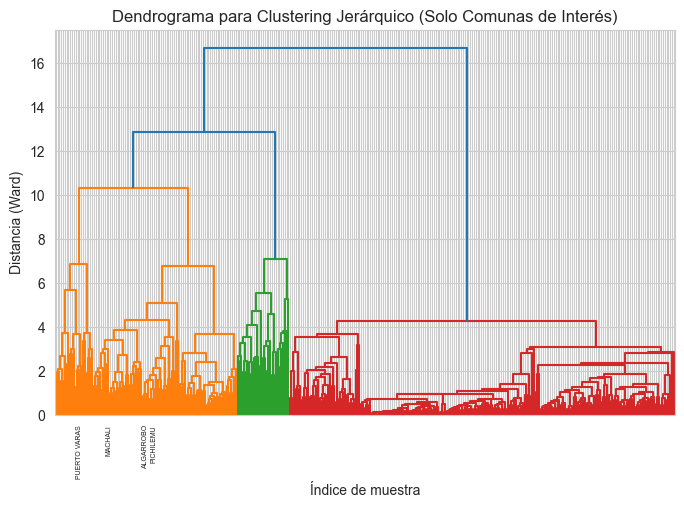

Silhouette Score para el modelo jerárquico: 0.2627


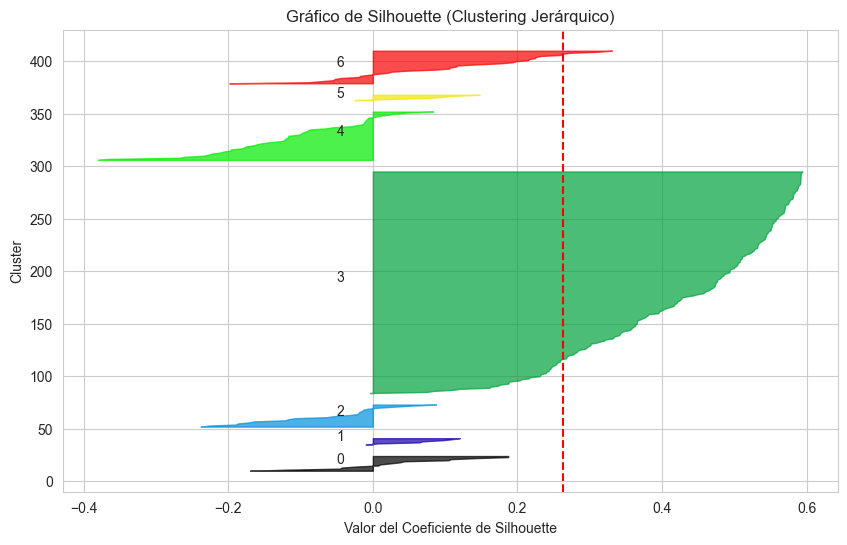

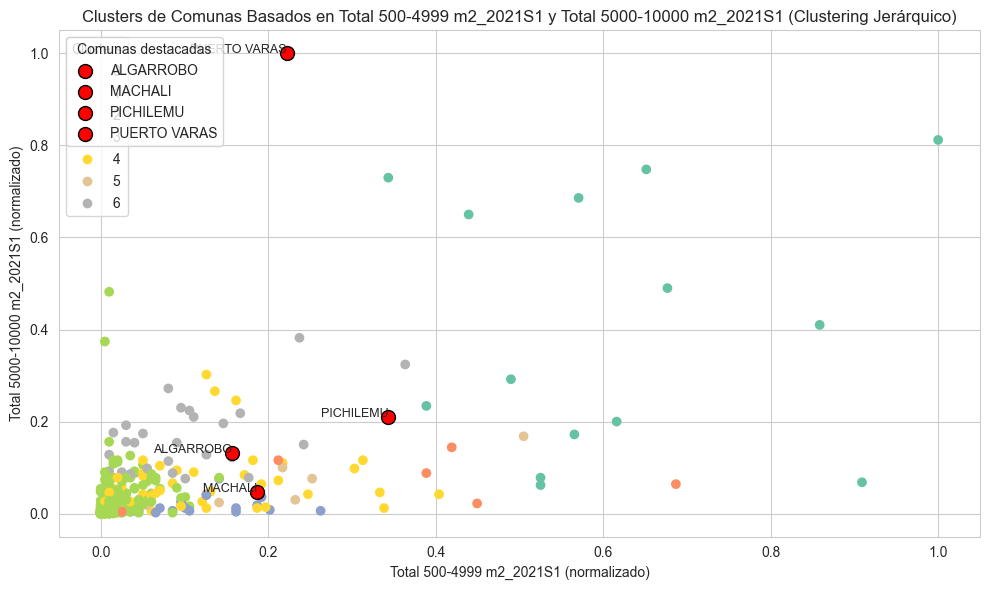


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 0
Comuna MACHALI pertenece al cluster 4
Comuna ALGARROBO pertenece al cluster 4
Comuna PICHILEMU pertenece al cluster 4

Media por cluster (solo variables seleccionadas):
         Total 100-499 m2_2021S1  Total 500-4999 m2_2021S1  \
cluster                                                      
0                      40.733333                115.933333   
1                      20.571429                 65.285714   
2                      10.272727                 21.863636   
3                       1.415094                  3.353774   
4                       9.659574                 25.276596   
5                      14.166667                 46.333333   
6                       6.812500                 17.343750   

         Total 5000-10000 m2_2021S1  Total 10001-100000 m2_2021S1  \
cluster                                                             
0                        221.066667                

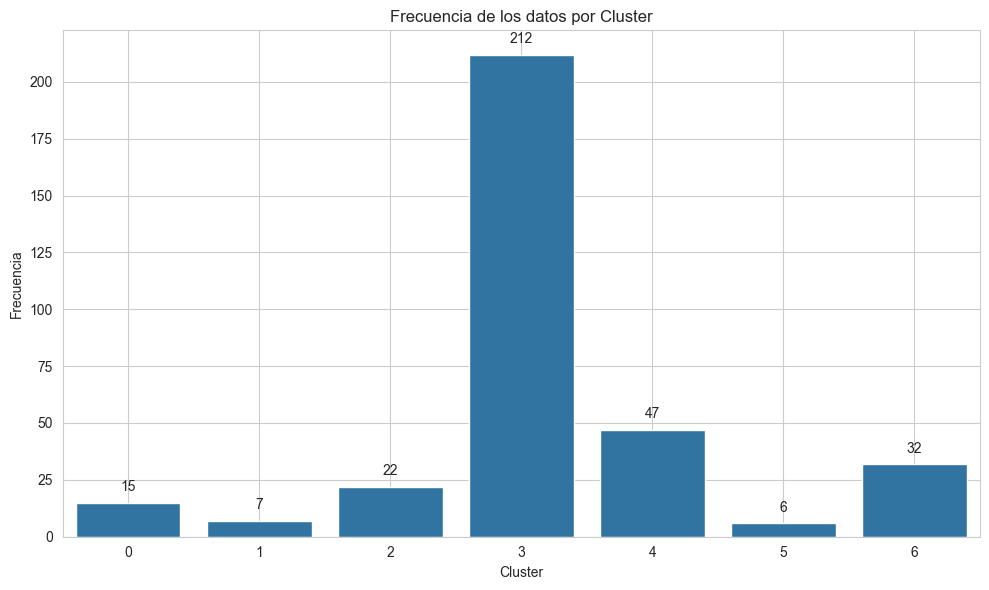

In [16]:
jerarquico_semestres2 = realizar_clustering_jerarquico_sin_pca(data_semestre_pivot, variables_clustering,7,True,True,'Total 500-4999 m2_2021S1', 'Total 5000-10000 m2_2021S1')

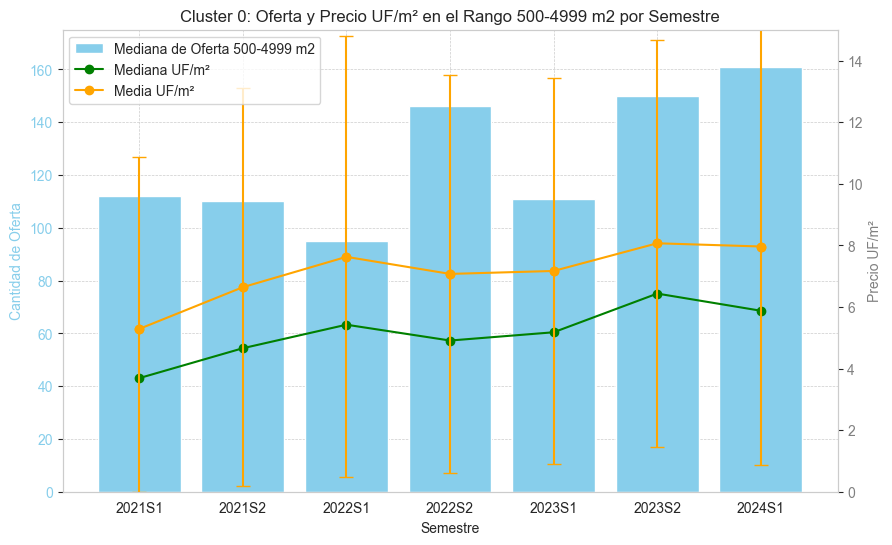

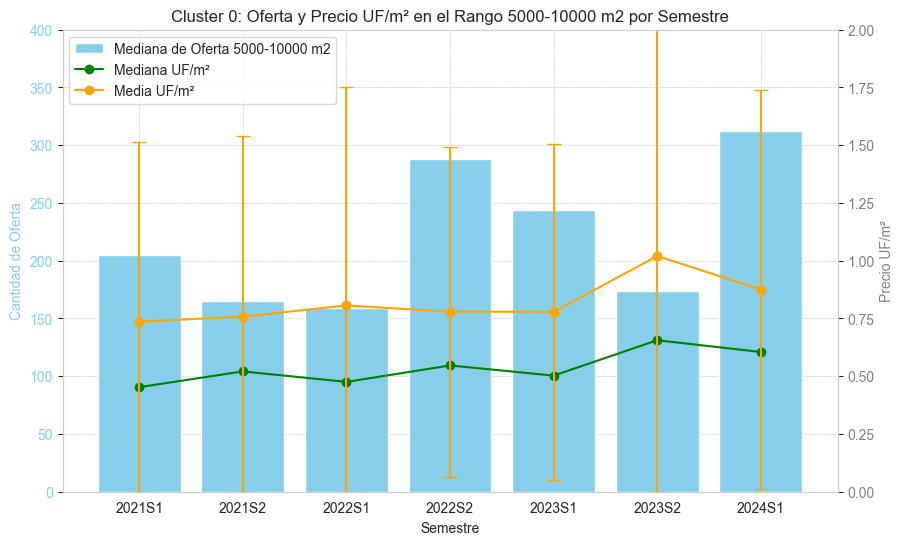

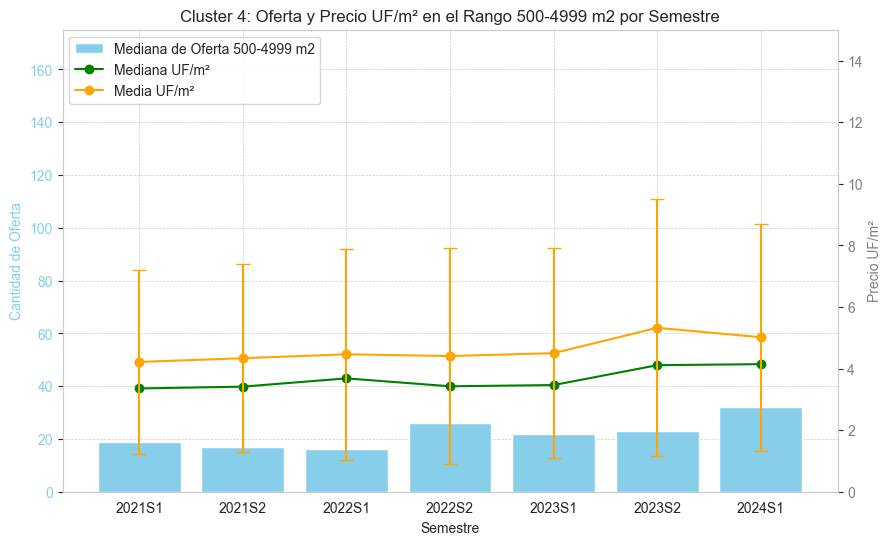

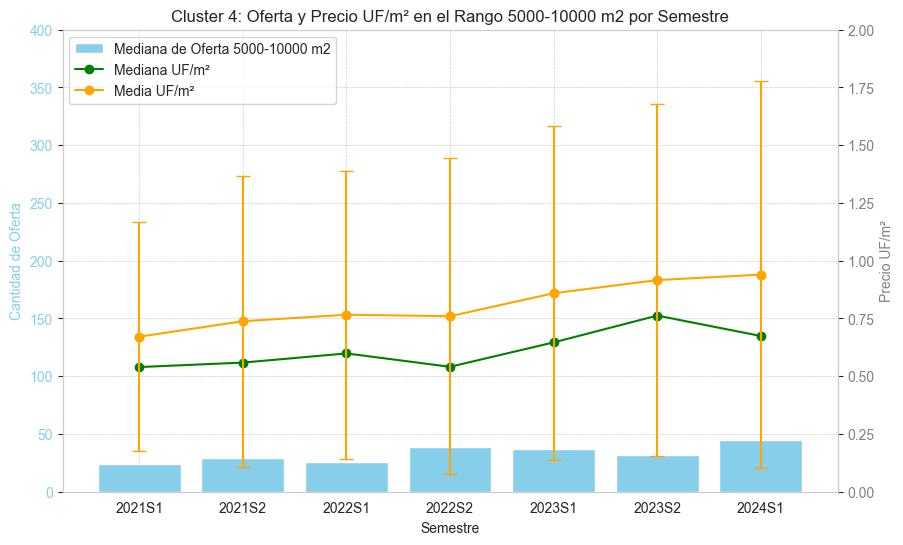

In [109]:
import matplotlib.pyplot as plt
import pandas as pd

# Filtrar los datos para los clusters 0, 1 y 3
clusters_a_graficar = [0, 4]
data_cluster = jerarquico_semestres2[jerarquico_semestres2['cluster'].isin(clusters_a_graficar)]

# Semestres a usar en el gráfico
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Rango de superficie y variables
rangos_superficie = ['500-4999 m2', '5000-10000 m2']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta_500_4999 = 175     # Límite superior de cantidad de oferta para el rango 500-4999 m²
max_y_uf_500_4999 = 15          # Límite superior de precio UF/m² para el rango 500-4999 m²

max_y_oferta_5000_10000 = 400  # Límite superior de cantidad de oferta para el rango 5000-10000 m²
max_y_uf_5000_10000 = 2        # Límite superior de precio UF/m² para el rango 5000-10000 m²

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    for rango in rangos_superficie:
        # Filtrar los datos del cluster actual
        data_cluster_actual = data_cluster[data_cluster['cluster'] == cluster]

        # Definir las variables para el gráfico
        if rango == '500-4999 m2':
            total_oferta = [data_cluster_actual[f'Total 500-4999 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 500-4999 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_500_4999
            max_y_uf = max_y_uf_500_4999
        else:
            total_oferta = [data_cluster_actual[f'Total 5000-10000 m2_{semestre}'].median() for semestre in semestres]
            mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            media_uf_m2 = [data_cluster_actual[f'Media costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            desviacion_uf_m2 = [data_cluster_actual[f'Desviación costo_m2_uf 5000-10000 m2_{semestre}'].mean() for semestre in semestres]
            max_y_oferta = max_y_oferta_5000_10000
            max_y_uf = max_y_uf_5000_10000

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta)  # Fijar el límite superior de oferta manualmente

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf)  # Fijar el límite superior del precio UF/m² manualmente

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivamos el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0,1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()

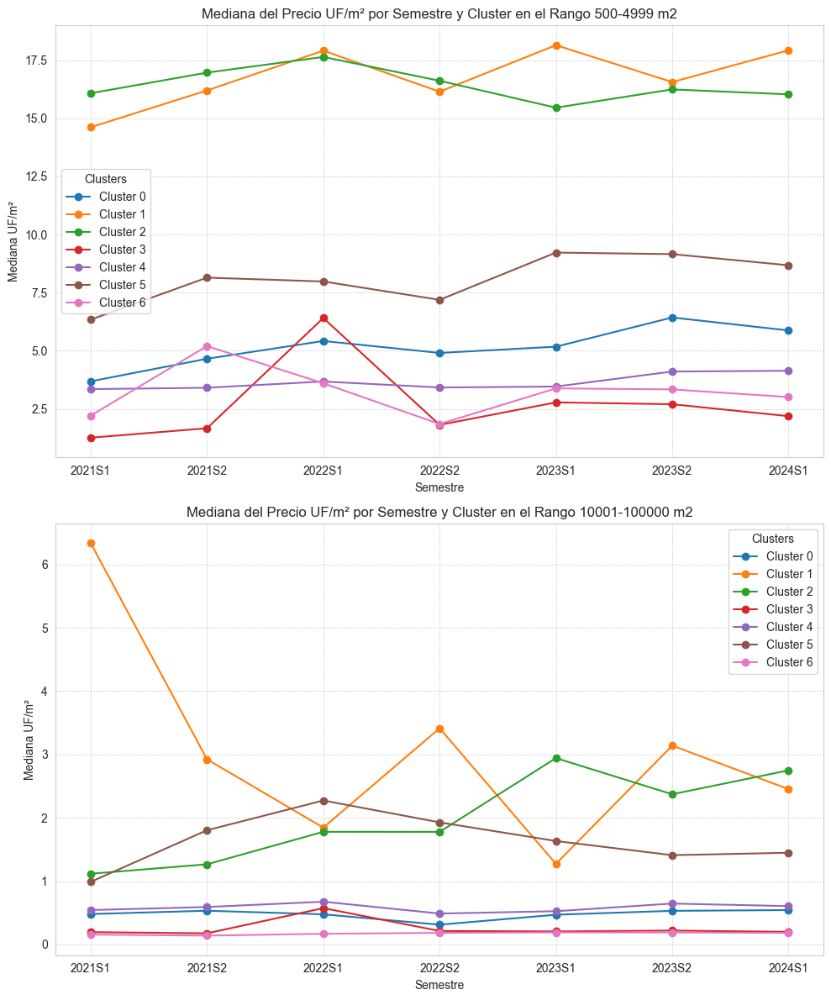

In [110]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = jerarquico_semestres2[jerarquico_semestres2['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()


In [17]:
jerarquico_semestres2.to_csv("data recuperada/comunas cluster/jerarquico_semestres_numdatos.csv", index = False)

## Estudio de oferta y precio segmentada por semestre 

### Lectura data con cluster asignados

In [1]:
import pandas as pd
Kmeans_SinPCA_1 = pd.read_csv("data recuperada/comunas cluster/comunas_SinPCA_1.csv")
Jerarq_SinPCA_2 = pd.read_csv("data recuperada/comunas cluster/comunas_jerarquico_SinPCA_2_7Clústers.csv")
Divisive_SinPCA = pd.read_csv('data recuperada/comunas cluster/comunas_divisive.csv', index_col=0)

In [3]:
Kmeans_SinPCA_1.columns

Index(['comuna_match', 'cluster'], dtype='object')

### Lectura data estadisticos por semestre

In [2]:
data_semestre_pivot =pd.read_csv('data recuperada/estadisticos_por_comuna_y_rango_pivot.csv')

### Merge entre data

In [4]:
# Realizar el merge por la columna 'comuna_match'
merged_kmeans = pd.merge(data_semestre_pivot, Kmeans_SinPCA_1, on='comuna_match', how='left')
merged_jerarq = pd.merge(data_semestre_pivot, Jerarq_SinPCA_2, on='comuna_match', how='left')
merged_divisive = pd.merge(data_semestre_pivot, Divisive_SinPCA, on='comuna_match', how='left')

# Verificar los primeros resultados
print("Merged Kmeans:")
print(merged_kmeans.head())

print("\nMerged Jerarq:")
print(merged_jerarq.head())

print("\nMerged Divisive:")
print(merged_divisive.head())

Merged Kmeans:
      comuna_match  Total de Datos_2021S1  Total de Datos_2021S2  \
0        ALGARROBO                  142.0                  149.0   
1            ALHUE                    3.0                    2.0   
2      ALTO BIOBIO                    3.0                    3.0   
3  ALTO DEL CARMEN                    1.0                    0.0   
4    ALTO HOSPICIO                   26.0                   41.0   

   Total de Datos_2022S1  Total de Datos_2022S2  Total de Datos_2023S1  \
0                  167.0                  233.0                  244.0   
1                    6.0                    9.0                    2.0   
2                    3.0                    2.0                    0.0   
3                    1.0                    6.0                    4.0   
4                   23.0                   49.0                   41.0   

   Total de Datos_2023S2  Total de Datos_2024S1  Total de Datos_2024S2  \
0                  248.0                  335.0          

### Kmeans

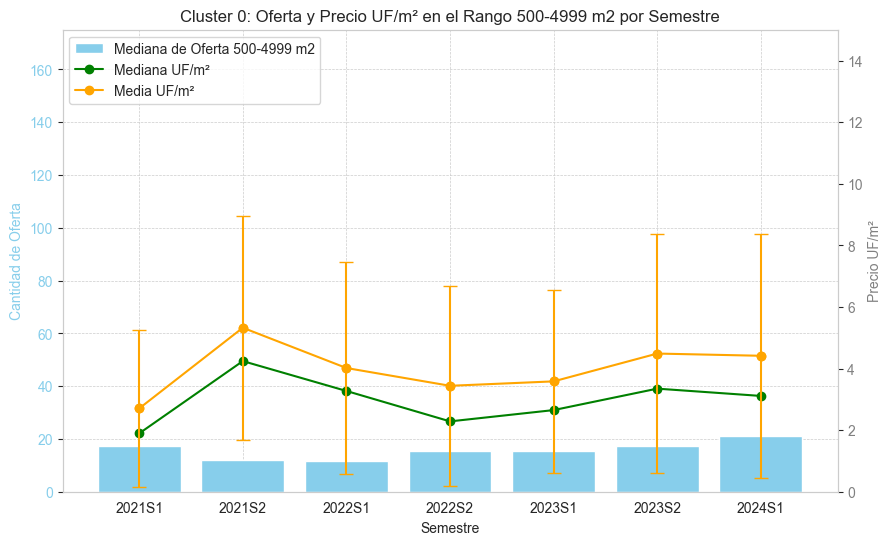

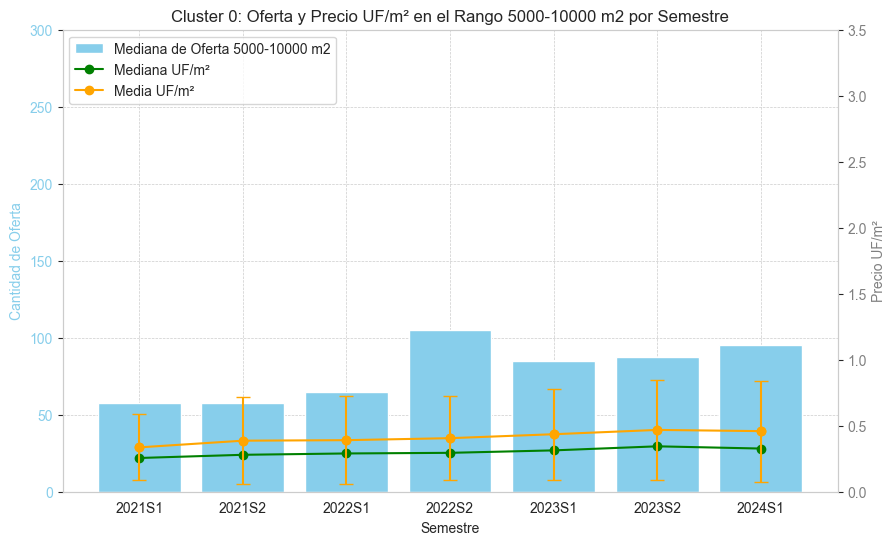

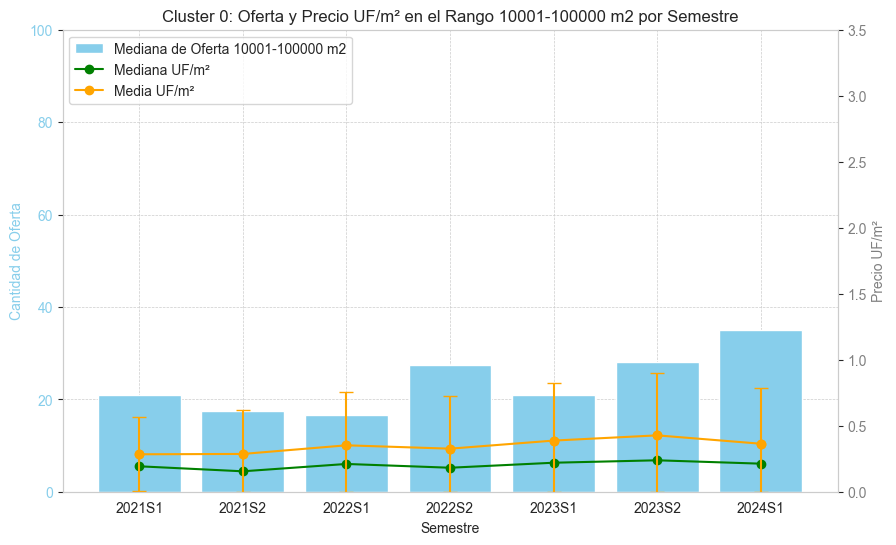

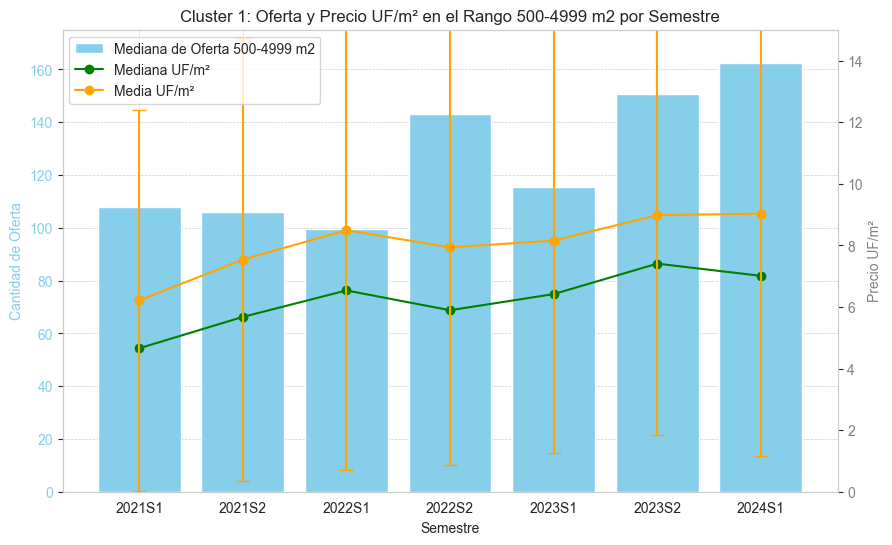

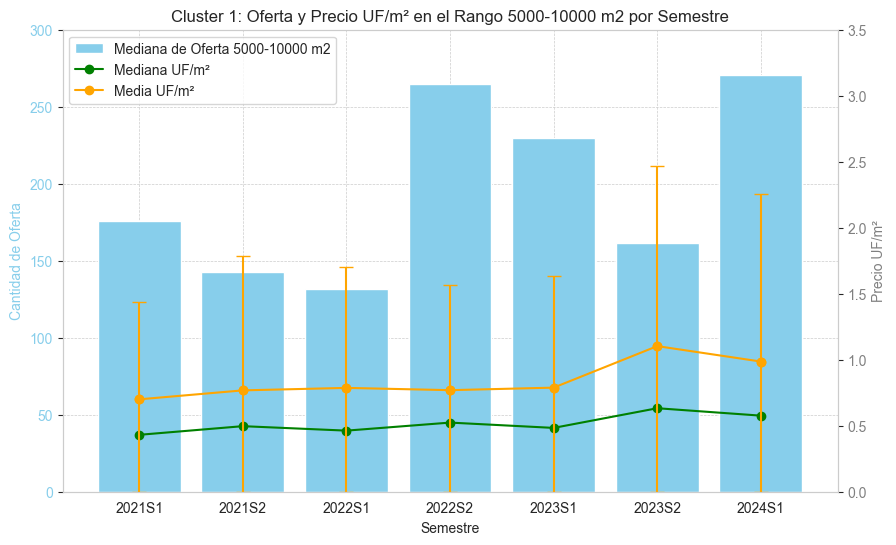

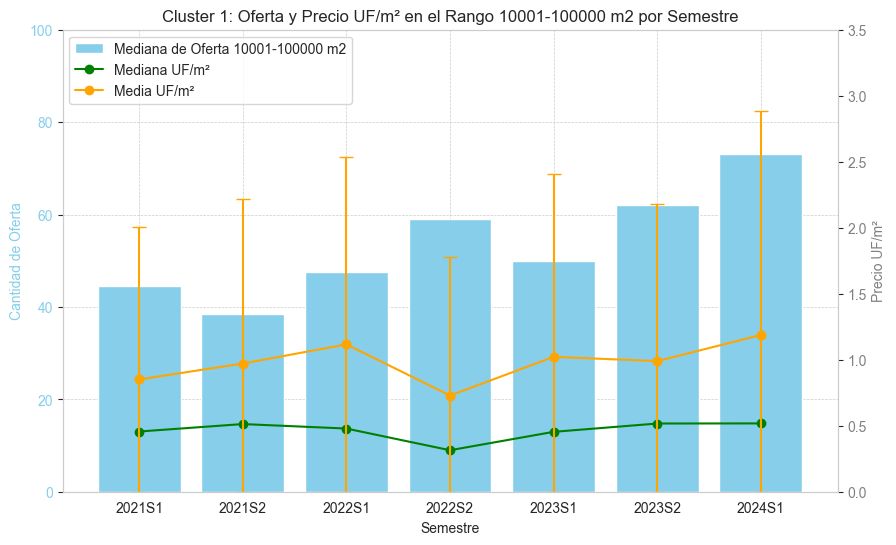

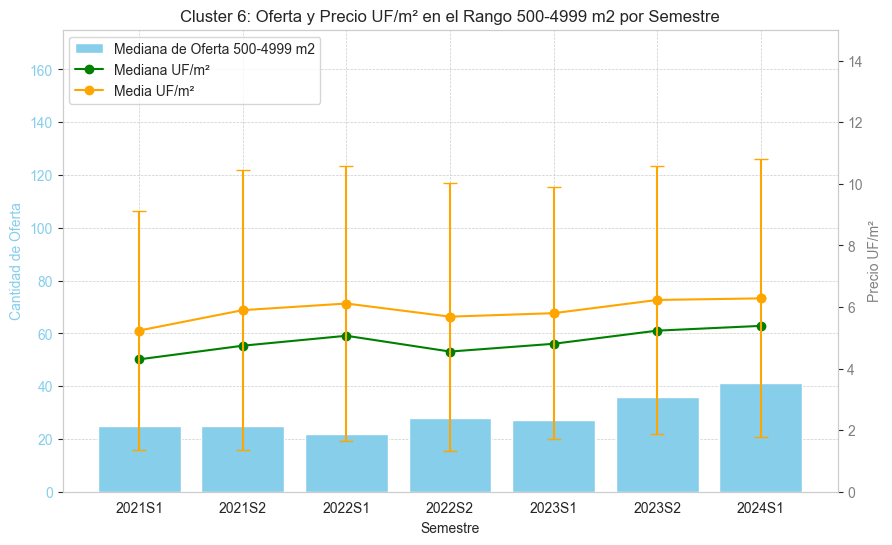

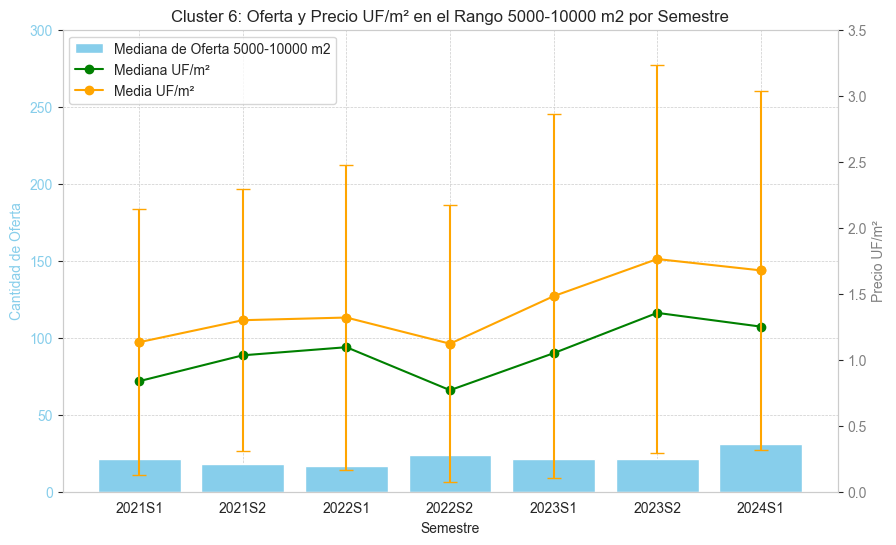

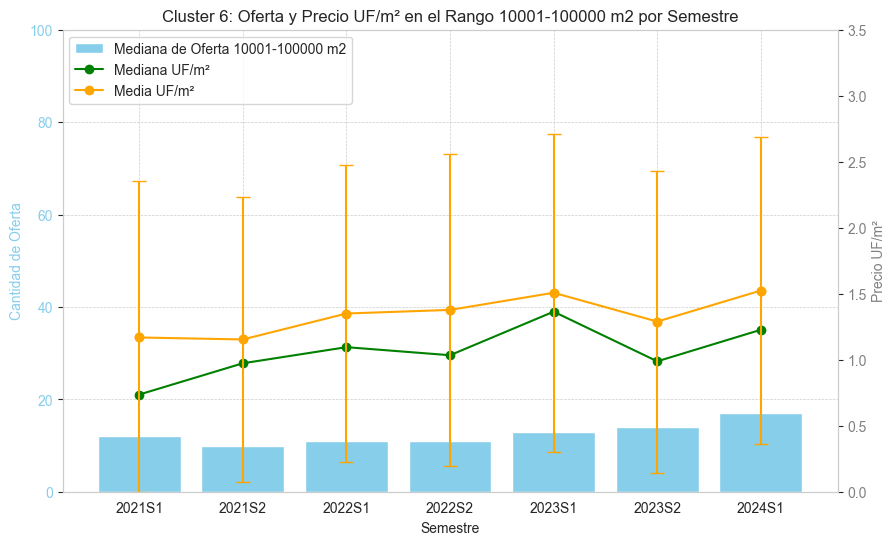

In [8]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 6]
rangos_superficie = ['500-4999 m2', '5000-10000 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta = {
    '500-4999 m2': 175,
    '5000-10000 m2': 300,
    '10001-100000 m2': 100
}
max_y_uf = {
    '500-4999 m2': 15,
    '5000-10000 m2': 3.5,
    '10001-100000 m2': 3.5
}

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    # Filtrar los datos del cluster actual
    data_cluster = merged_kmeans[merged_kmeans['cluster'] == cluster]
    
    for rango in rangos_superficie:
        # Calcular los valores necesarios para el gráfico
        total_oferta = [data_cluster[f'Total {rango}_{semestre}'].median() for semestre in semestres]
        mediana_uf_m2 = [data_cluster[f'Mediana costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        media_uf_m2 = [data_cluster[f'Media costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        desviacion_uf_m2 = [data_cluster[f'Desviación costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta[rango])  # Límite superior de oferta según el rango

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf[rango])  # Límite superior del precio UF/m² según el rango

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivar el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0, 1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()


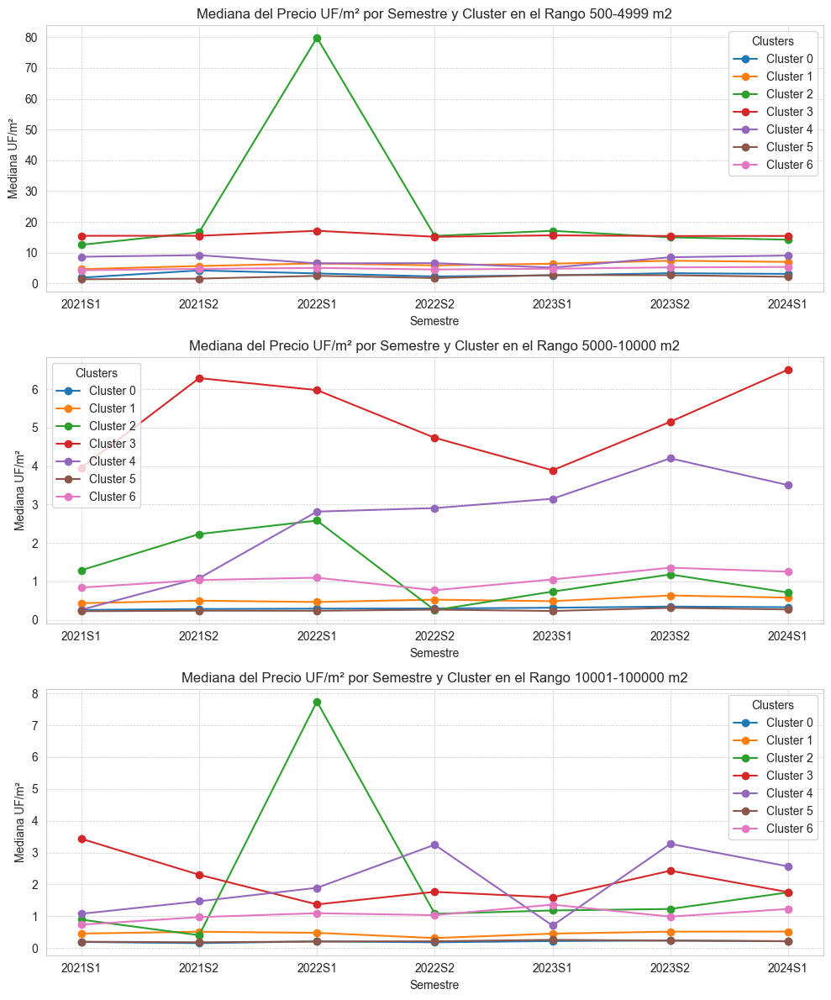

In [14]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2','5000-10000 m2' ,'10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = merged_kmeans[merged_kmeans['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()


### Jerarquico

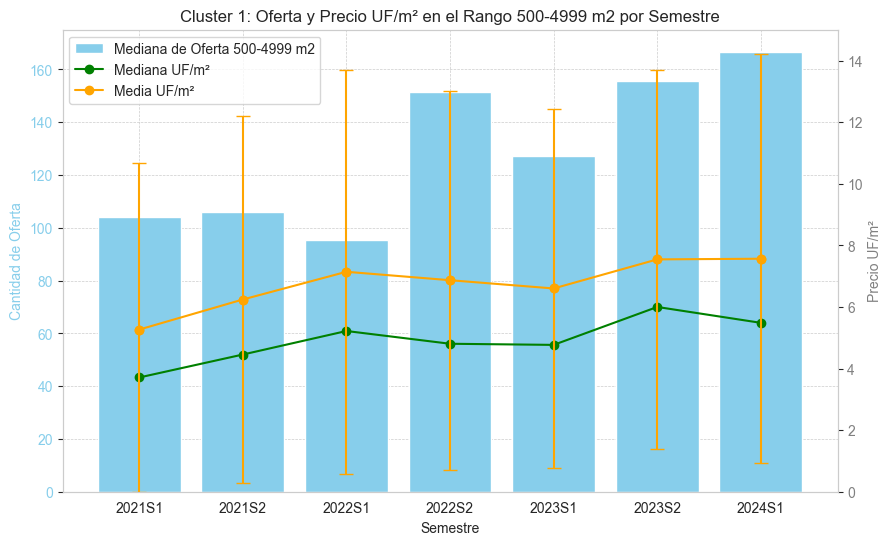

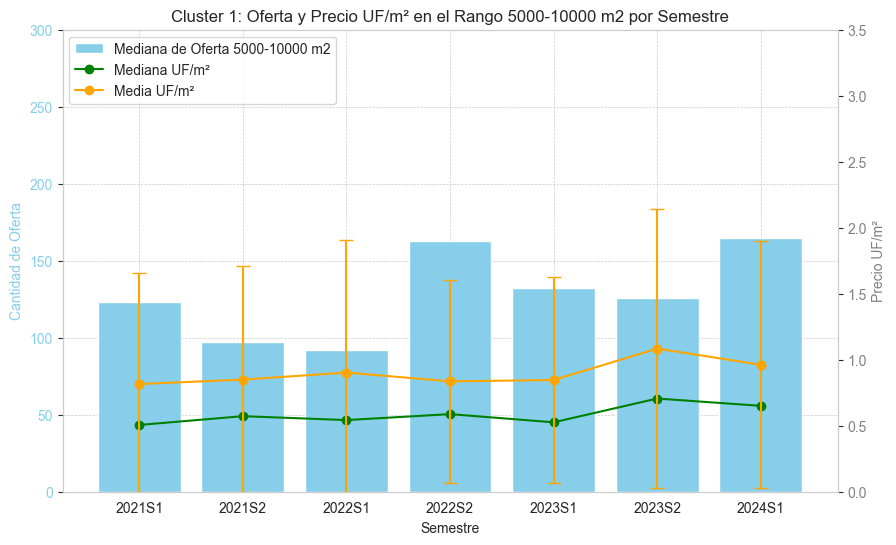

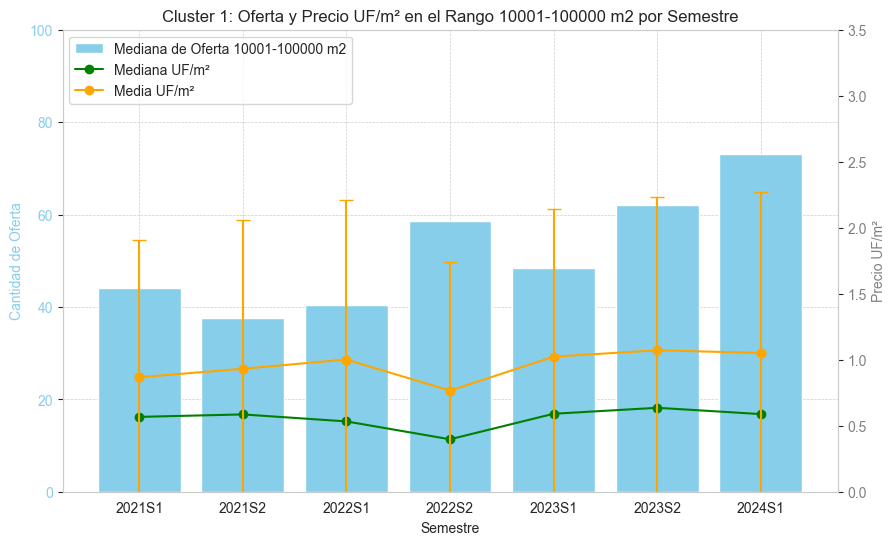

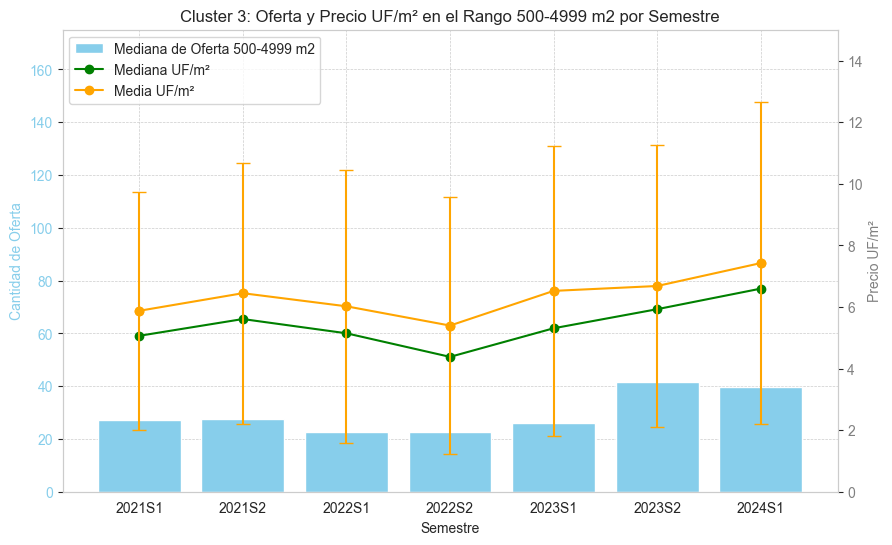

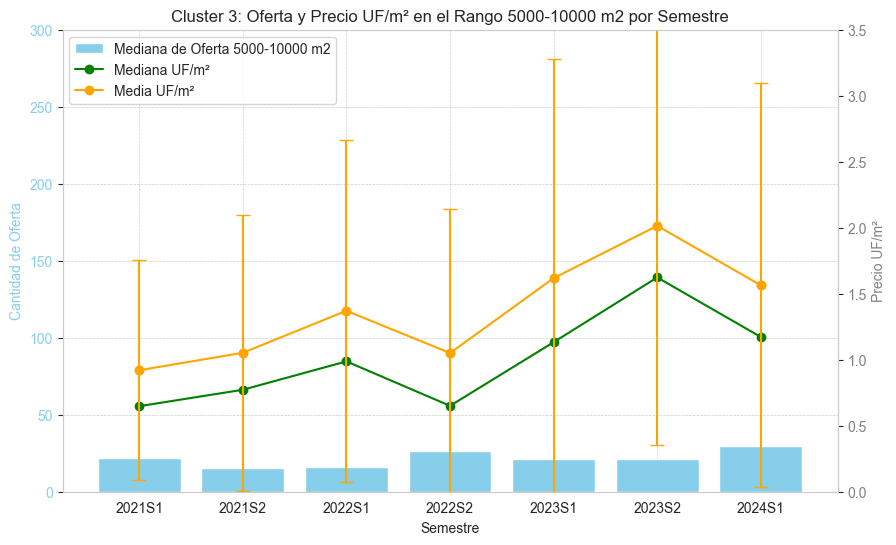

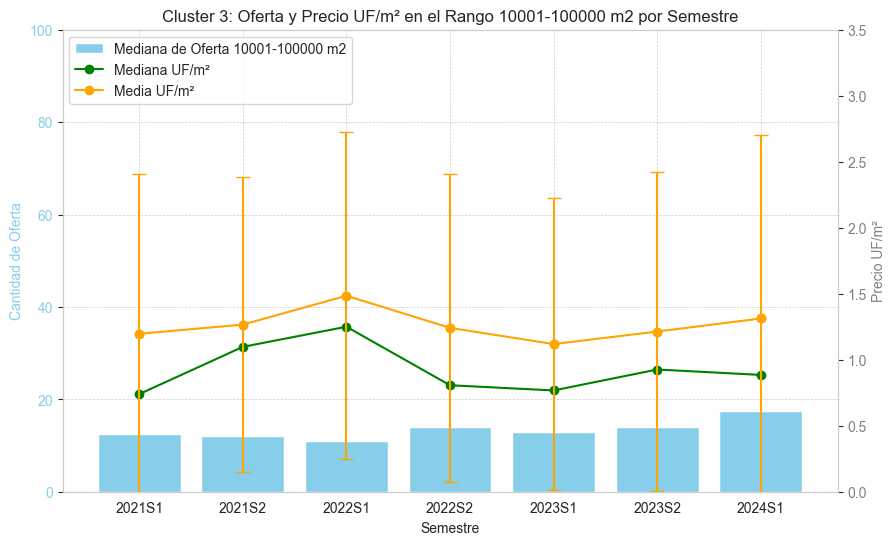

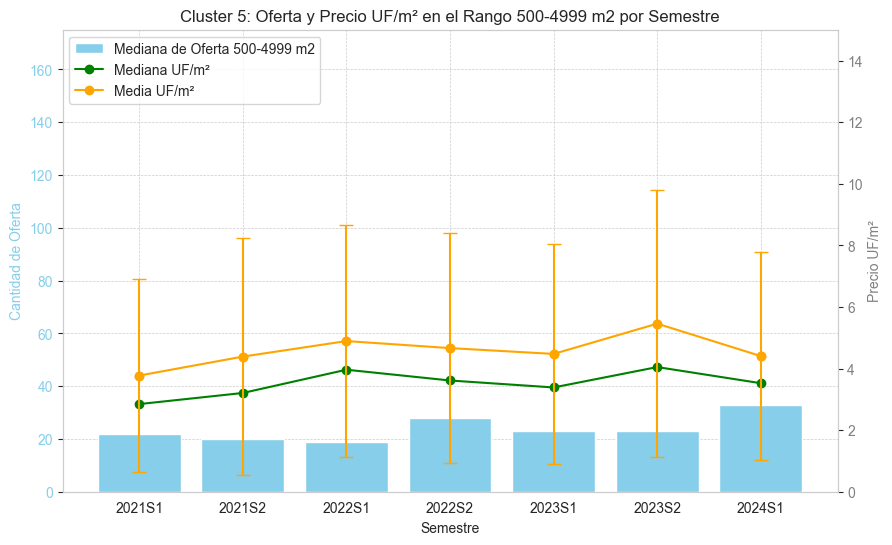

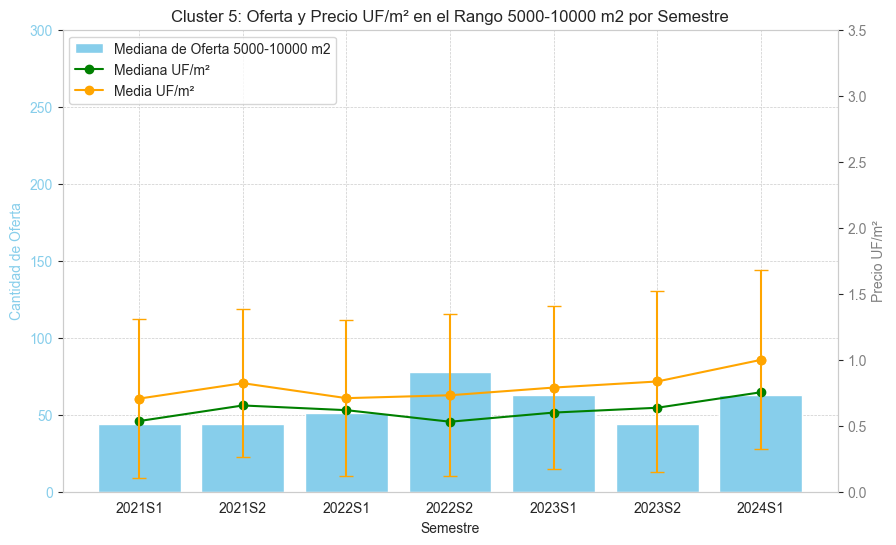

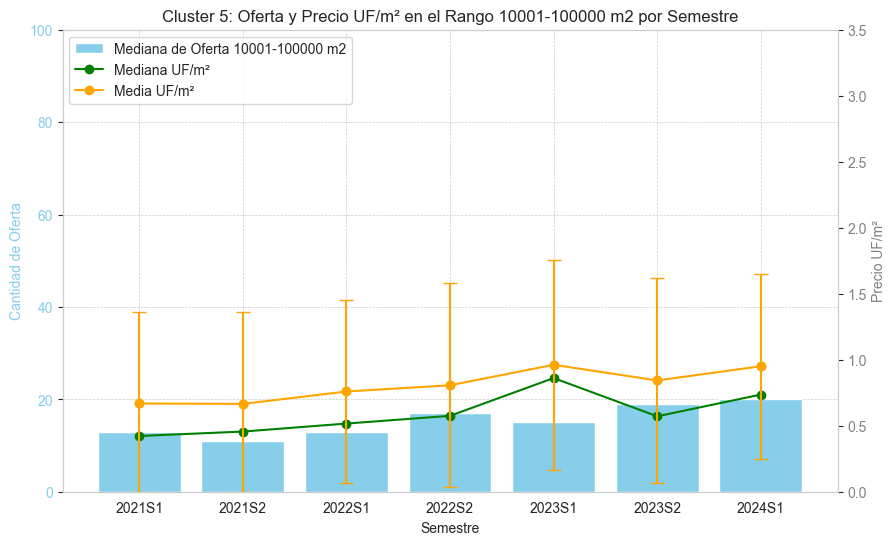

In [9]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [1, 3, 5]
rangos_superficie = ['500-4999 m2', '5000-10000 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta = {
    '500-4999 m2': 175,
    '5000-10000 m2': 300,
    '10001-100000 m2': 100
}
max_y_uf = {
    '500-4999 m2': 15,
    '5000-10000 m2': 3.5,
    '10001-100000 m2': 3.5
}

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    # Filtrar los datos del cluster actual
    data_cluster = merged_jerarq[merged_jerarq['cluster'] == cluster]
    
    for rango in rangos_superficie:
        # Calcular los valores necesarios para el gráfico
        total_oferta = [data_cluster[f'Total {rango}_{semestre}'].median() for semestre in semestres]
        mediana_uf_m2 = [data_cluster[f'Mediana costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        media_uf_m2 = [data_cluster[f'Media costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        desviacion_uf_m2 = [data_cluster[f'Desviación costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta[rango])  # Límite superior de oferta según el rango

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf[rango])  # Límite superior del precio UF/m² según el rango

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivar el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0, 1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()


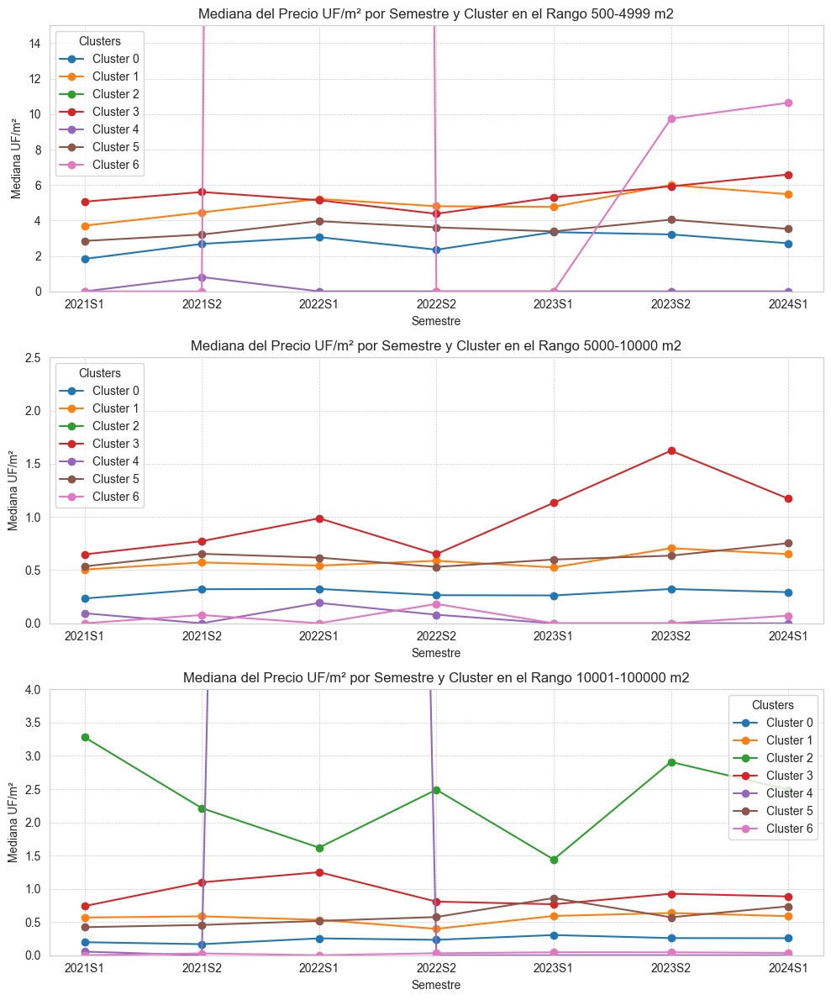

In [17]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2, 3, 4, 5, 6]
rangos_superficie = ['500-4999 m2', '5000-10000 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Configuración manual de los límites del eje Y para el precio UF/m²
max_y_uf = {
    '500-4999 m2': 15,
    '5000-10000 m2': 2.5,
    '10001-100000 m2': 4
}

# Crear una figura con subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = merged_jerarq[merged_jerarq['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Fijar el límite superior del eje Y basado en el rango
    ax.set_ylim(0, max_y_uf[rango_superficie])

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()


### Divisive

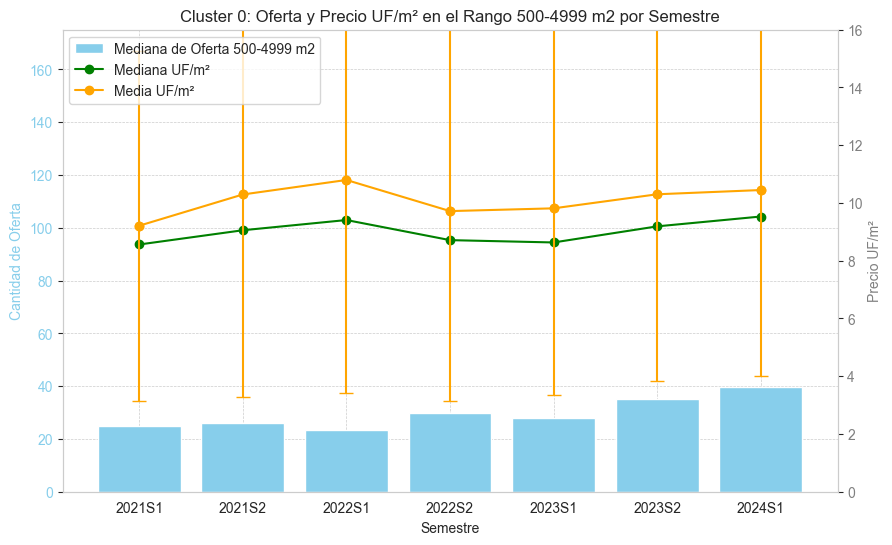

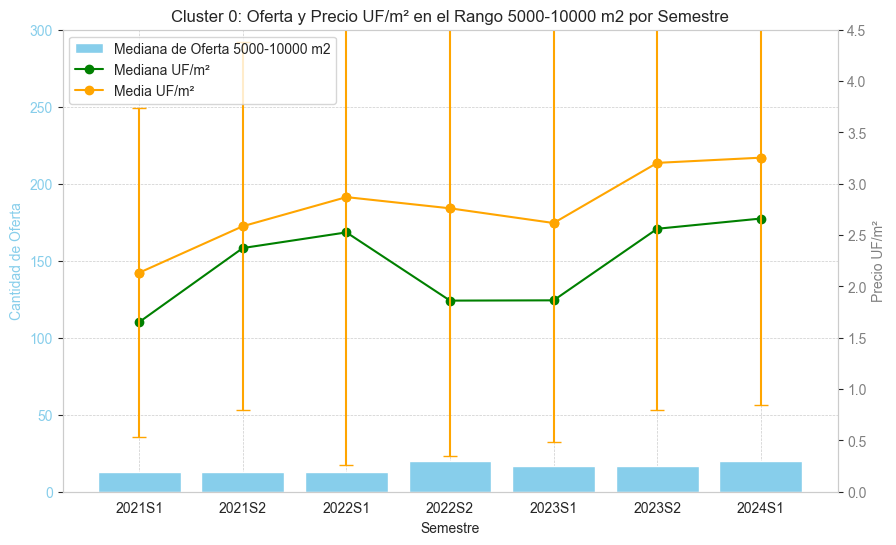

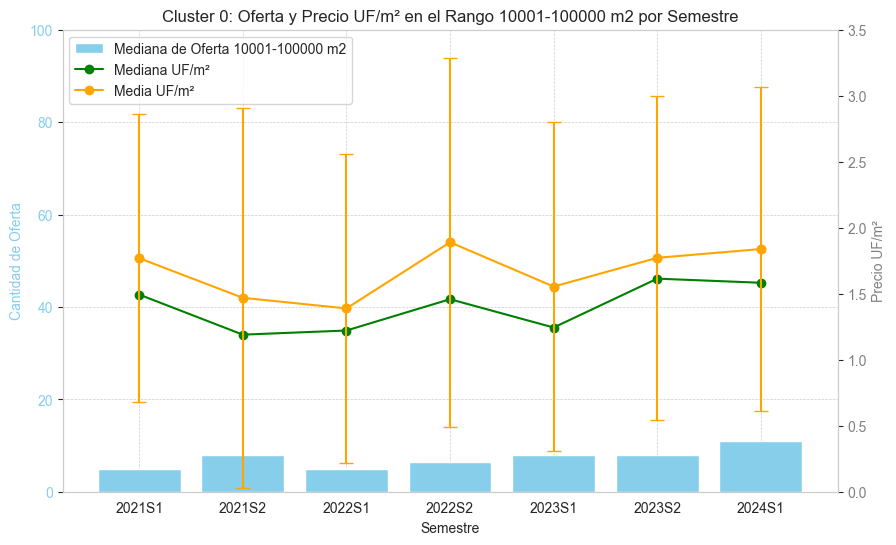

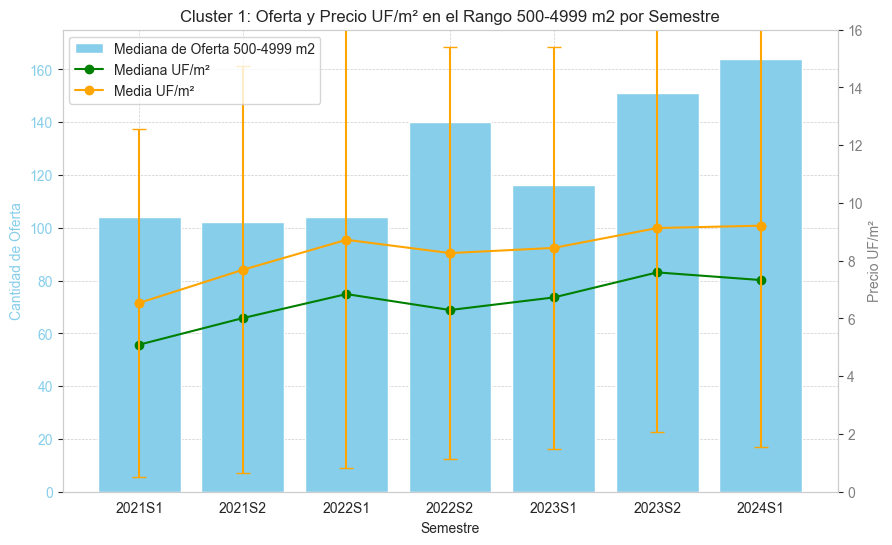

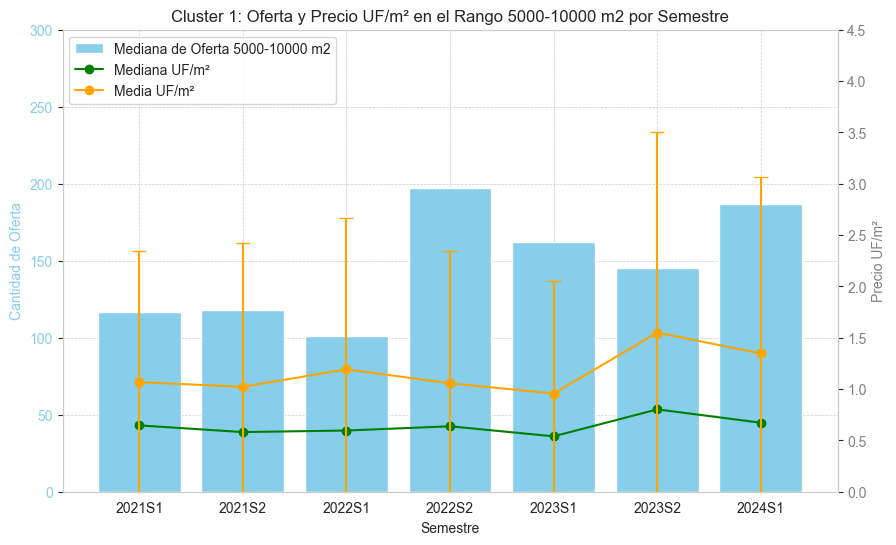

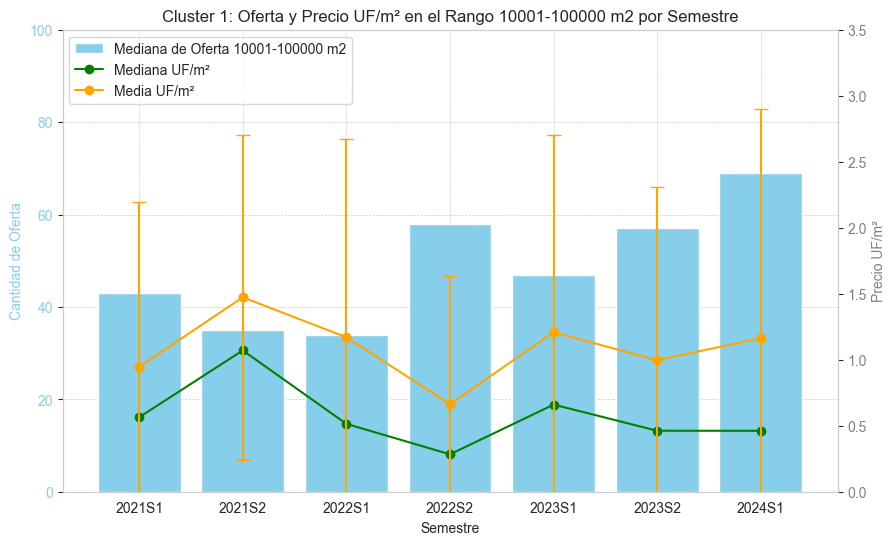

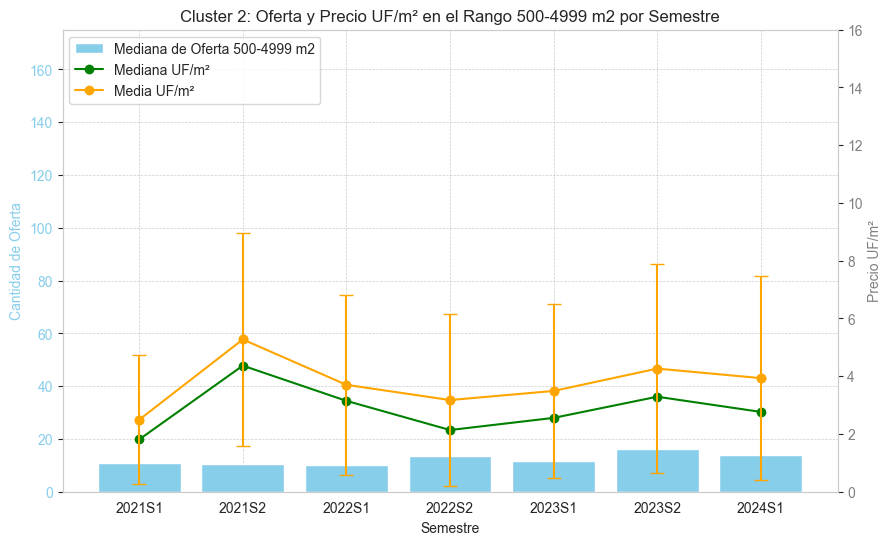

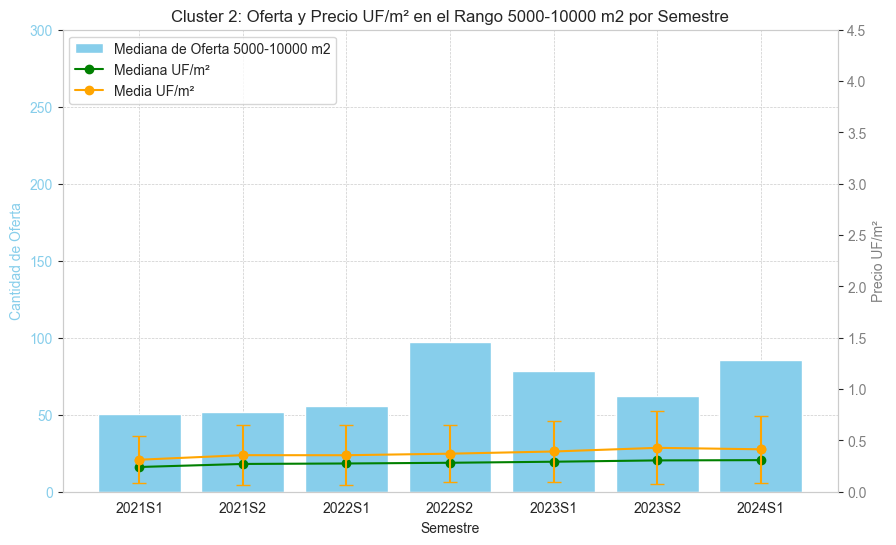

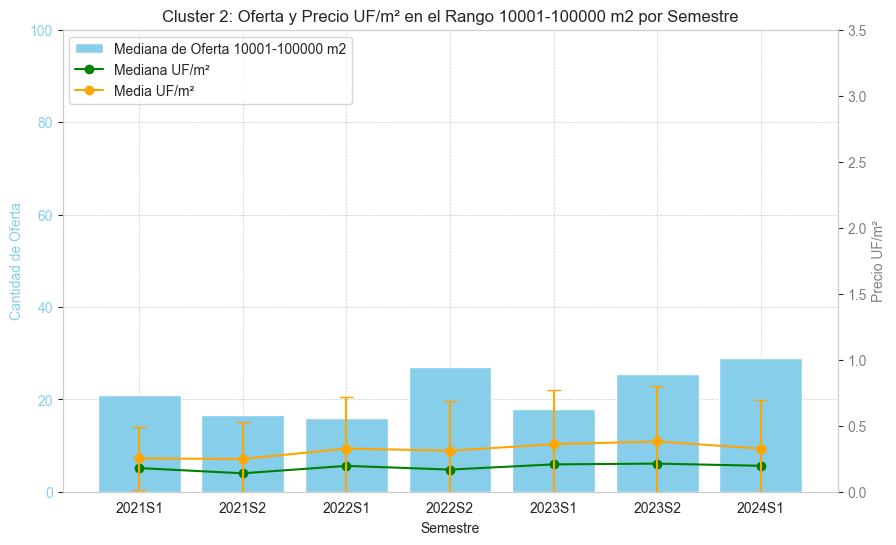

In [12]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2]
rangos_superficie = ['500-4999 m2', '5000-10000 m2', '10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Configuración manual de los límites del eje Y para la cantidad de oferta y el precio UF/m²
max_y_oferta = {
    '500-4999 m2': 175,
    '5000-10000 m2': 300,
    '10001-100000 m2': 100
}
max_y_uf = {
    '500-4999 m2': 16,
    '5000-10000 m2': 4.5,
    '10001-100000 m2': 3.5
}

# Iterar sobre los clusters y rangos de superficie para crear los gráficos
for cluster in clusters_a_graficar:
    # Filtrar los datos del cluster actual
    data_cluster = merged_divisive[merged_divisive['cluster'] == cluster]
    
    for rango in rangos_superficie:
        # Calcular los valores necesarios para el gráfico
        total_oferta = [data_cluster[f'Total {rango}_{semestre}'].median() for semestre in semestres]
        mediana_uf_m2 = [data_cluster[f'Mediana costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        media_uf_m2 = [data_cluster[f'Media costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]
        desviacion_uf_m2 = [data_cluster[f'Desviación costo_m2_uf {rango}_{semestre}'].mean() for semestre in semestres]

        # Crear el gráfico
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Gráfico de barras en el eje Y izquierdo (cantidad de oferta)
        ax1.bar(semestres, total_oferta, color='skyblue', label=f'Mediana de Oferta {rango}')
        ax1.set_xlabel('Semestre')
        ax1.set_ylabel('Cantidad de Oferta', color='skyblue')
        ax1.tick_params(axis='y', labelcolor='skyblue')
        ax1.set_ylim(0, max_y_oferta[rango])  # Límite superior de oferta según el rango

        # Crear el segundo eje Y para el precio UF/m²
        ax2 = ax1.twinx()
        ax2.plot(semestres, mediana_uf_m2, color='green', label='Mediana UF/m²', marker='o')
        ax2.plot(semestres, media_uf_m2, color='orange', label='Media UF/m²', marker='o')

        # Agregar los bigotes de desviación estándar solo para la media, limitando el límite inferior a cero
        for i, semestre in enumerate(semestres):
            lower_bound = max(0, media_uf_m2[i] - desviacion_uf_m2[i])
            upper_bound = media_uf_m2[i] + desviacion_uf_m2[i]
            ax2.errorbar(semestre, media_uf_m2[i], yerr=[[media_uf_m2[i] - lower_bound], [upper_bound - media_uf_m2[i]]], fmt='o', color='orange', capsize=5)

        ax2.set_ylabel('Precio UF/m²', color='gray')
        ax2.tick_params(axis='y', labelcolor='gray')
        ax2.set_ylim(0, max_y_uf[rango])  # Límite superior del precio UF/m² según el rango

        # Ajustar el estilo del grid para que no sea intrusivo
        ax1.grid(visible=True, linestyle='--', linewidth=0.5)
        ax2.grid(False)  # Desactivar el grid en el segundo eje Y

        # Agregar leyendas
        fig.legend(loc="upper left", bbox_to_anchor=(0, 1), bbox_transform=ax1.transAxes)

        # Título y mostrar el gráfico
        plt.title(f'Cluster {cluster}: Oferta y Precio UF/m² en el Rango {rango} por Semestre')
        plt.show()


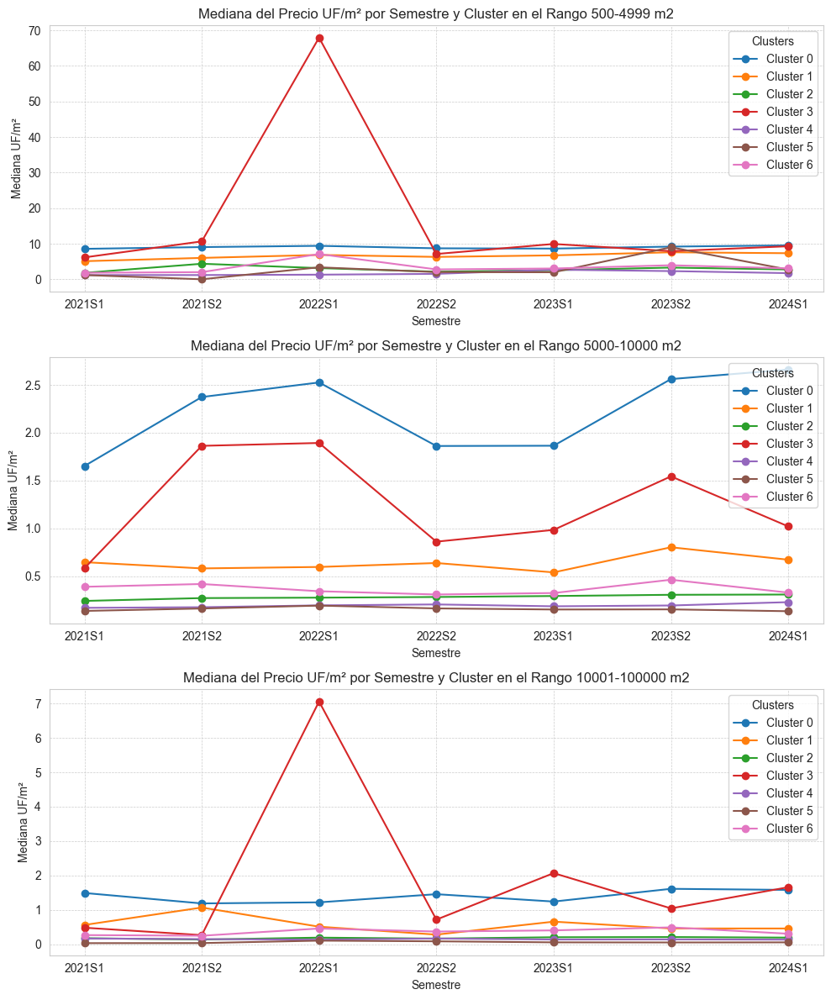

In [23]:
import matplotlib.pyplot as plt

# Definir los clusters a graficar y los rangos de superficie
clusters_a_graficar = [0, 1, 2,3, 4, 5, 6]
rangos_superficie = ['500-4999 m2','5000-10000 m2' ,'10001-100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear una figura con dos subgráficos apilados
fig, axs = plt.subplots(len(rangos_superficie), 1, figsize=(10, 12))

# Iterar sobre cada rango de superficie y crear un subgráfico para cada uno
for i, rango_superficie in enumerate(rangos_superficie):
    ax = axs[i]

    # Iterar sobre cada cluster y graficar la mediana del precio UF/m² para el rango especificado
    for cluster in clusters_a_graficar:
        # Filtrar los datos del cluster actual
        data_cluster_actual = merged_divisive[merged_divisive['cluster'] == cluster]

        # Obtener la mediana del precio UF/m² para cada semestre
        mediana_uf_m2 = [data_cluster_actual[f'Mediana costo_m2_uf {rango_superficie}_{semestre}'].mean() for semestre in semestres]

        # Graficar la línea de puntos para el cluster actual en el subgráfico correspondiente
        ax.plot(semestres, mediana_uf_m2, marker='o', label=f'Cluster {cluster}')

    # Personalizar cada subgráfico
    ax.set_xlabel('Semestre')
    ax.set_ylabel('Mediana UF/m²')
    ax.set_title(f'Mediana del Precio UF/m² por Semestre y Cluster en el Rango {rango_superficie}')
    ax.legend(title="Clusters")
    ax.grid(True, linestyle='--', linewidth=0.5)
    #ax.set_ylim(0,15)
    

# Ajustar el diseño para que los subgráficos no se solapen
plt.tight_layout()

# Mostrar el gráfico
plt.show()

## Clustering proporción de oferta

In [2]:
import pandas as pd
# Paso 1: Cargar los datos de estadísticas por comuna y rango de superficie
data_estadisticos = pd.read_csv('data recuperada/estadisticos_por_comuna_y_rango.csv')

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# Paso 1: Variables a normalizar
variables_clustering = [
    '% 100-499 m2', '% 500-4999 m2', '% 5000-10000 m2', '% 10001-100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]


# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

### Kmeans % Datos

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

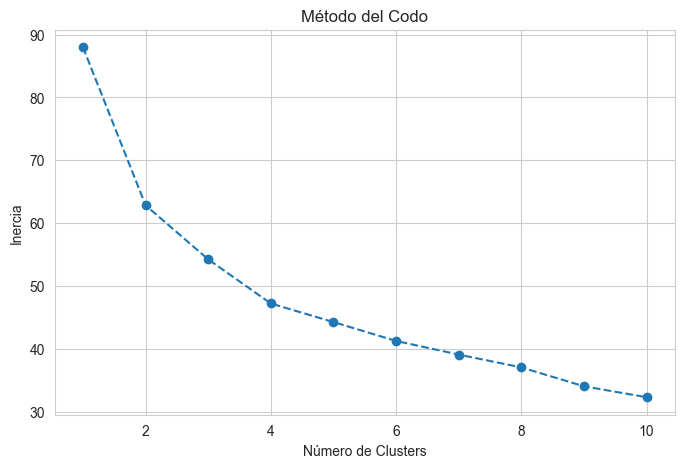

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


Silhouette Score para el modelo: 0.1933


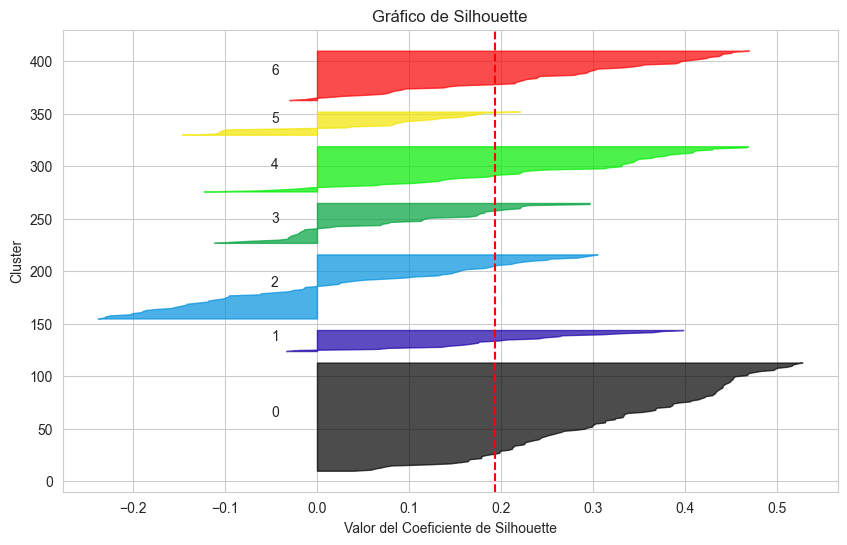

C:\Users\franc\AppData\Local\Temp\ipykernel_29824\1928401704.py:82: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc="upper left")


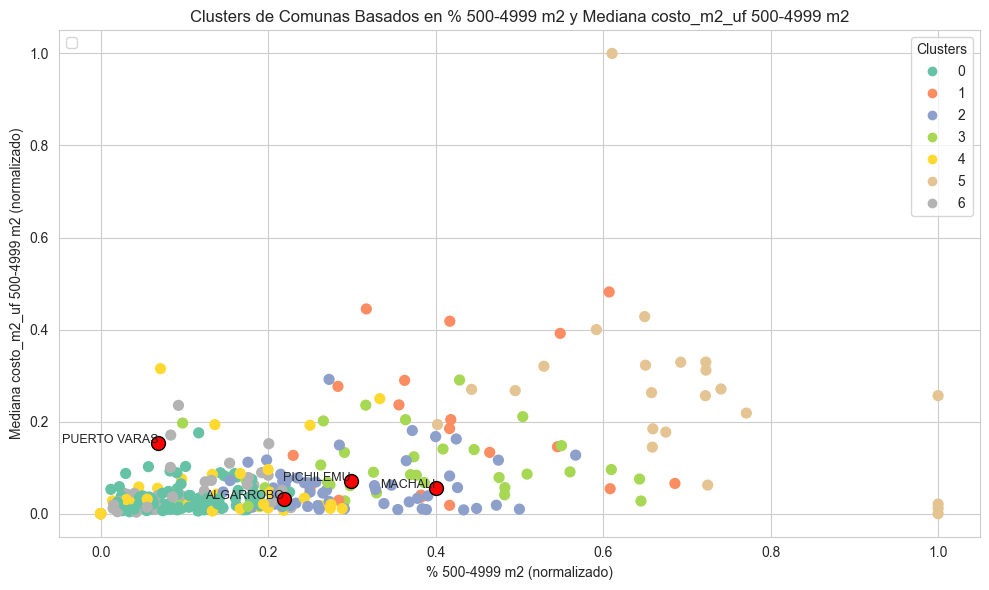


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 6
Comuna MACHALI pertenece al cluster 3
Comuna ALGARROBO pertenece al cluster 2
Comuna PICHILEMU pertenece al cluster 2

Media por cluster (solo variables seleccionadas):
         % 100-499 m2  % 500-4999 m2  % 5000-10000 m2  % 10001-100000 m2  \
cluster                                                                    
0            4.679336       9.537130        56.308839          21.453108   
1           36.610819      38.837616        12.198755          10.145420   
2            8.999870      28.818855        39.865903          16.965864   
3           11.784897      34.794143        34.261289          15.275193   
4            6.323307      13.056491        28.950944          40.289629   
5           15.324817      70.084482         9.702878           4.616182   
6            3.679396       9.186160        75.071178           8.074156   

         Mediana costo_m2_uf 100-499 m2  Media costo_m2_uf 100-

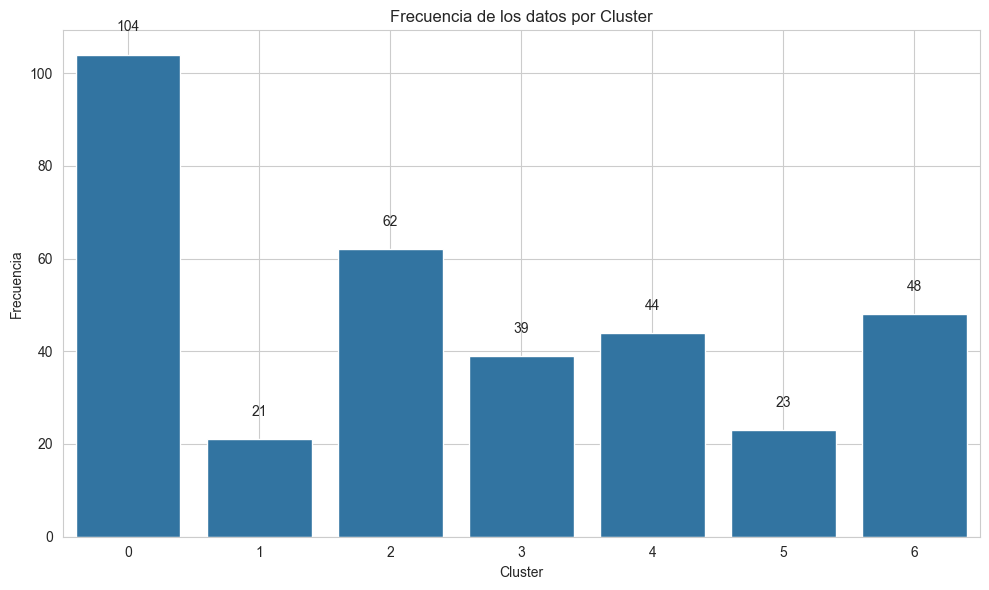

In [5]:
resultados_kmeans_datos = realizar_clustering_sin_pca(data_estadisticos, variables_clustering, 7, True, True, '% 500-4999 m2', 'Mediana costo_m2_uf 500-4999 m2')

In [7]:
resultados_kmeans_datos.to_csv("data recuperada/comunas cluster/kmeans%datos.csv",index=False)

### Divisive % Datos

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

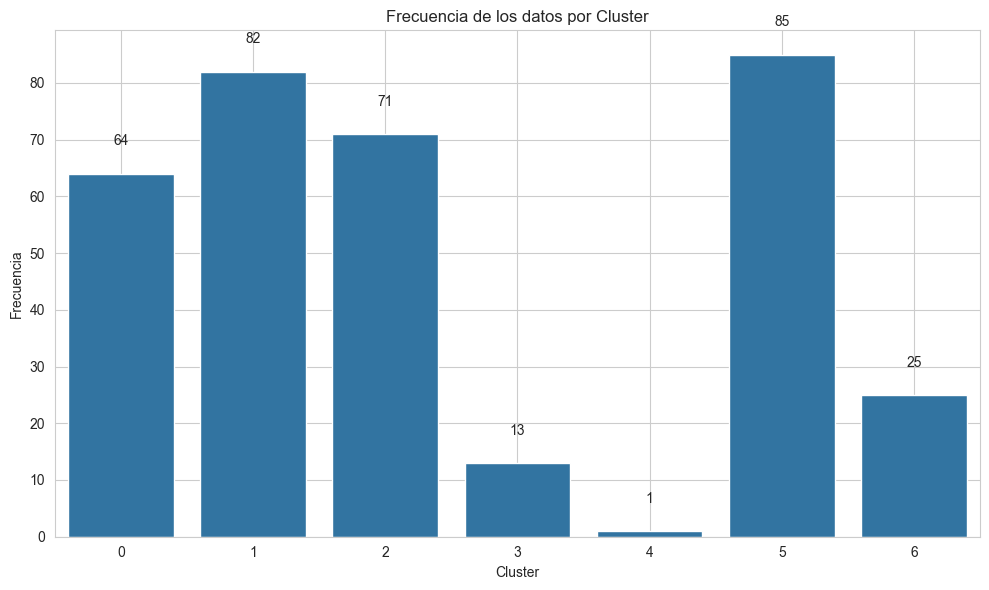

Dendrograma Simulado (Divisive Clustering):
Cluster 0 (Raíz)
├── Cluster 0 (259)
│   ├── Cluster 0 (163)
│   │   ├── Cluster 0 (150)
│   │   │   ├── Cluster 0 (149)
│   │   │   │   ├── Cluster 0 (64)
│   │   │   │   └── Cluster 5 (85)
│   │   │   └── Cluster 4 (1)
│   │   └── Cluster 3 (13)
│   └── Cluster 2 (96)
│       ├── Cluster 2 (71)
│       └── Cluster 6 (25)
└── Cluster 1 (82)
No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.


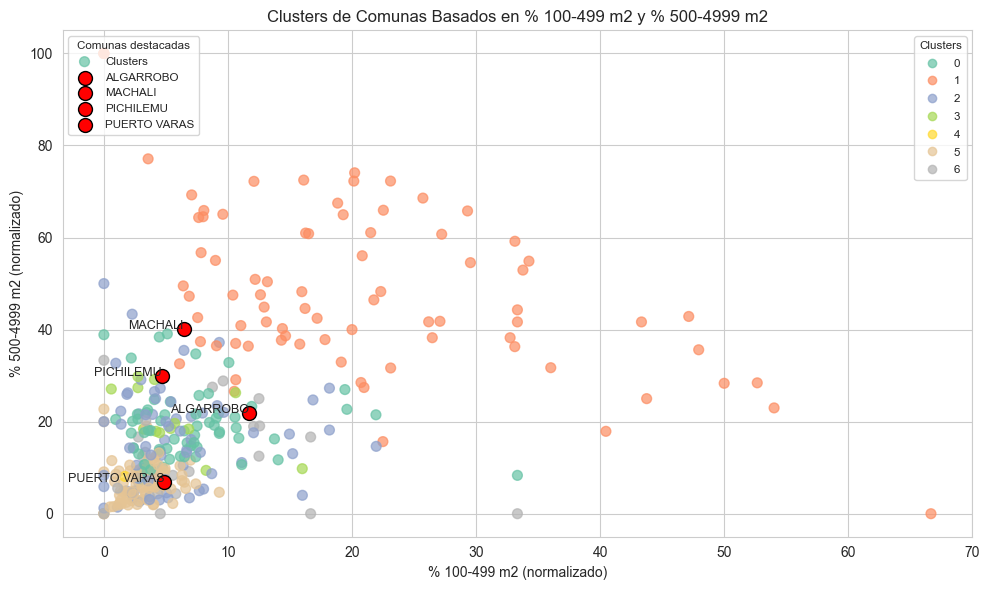


Media por cluster (solo variables seleccionadas):
         % 100-499 m2  % 500-4999 m2  % 5000-10000 m2  % 10001-100000 m2  \
cluster                                                                    
0            7.263455      19.358802        54.061546          13.608323   
1           20.382534      49.122346        17.165706          11.177561   
2            5.724858      15.856285        41.674961          27.690977   
3            5.756983      20.718354        55.762227          13.550952   
4            1.689189       8.108108        58.783784          20.270270   
5            3.193803       7.077595        68.375648          15.214302   
6            7.587656      12.268892        23.940867          44.602725   

         Mediana costo_m2_uf 100-499 m2  Media costo_m2_uf 100-499 m2  \
cluster                                                                 
0                             10.044498                     18.447233   
1                             13.699700      

In [8]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from anytree import Node, RenderTree
from anytree.exporter import DotExporter

def divisive_clustering(data, variables_clustering, n_clusters):
    # Normalizar las variables
    X = data[variables_clustering]
    scaler = MinMaxScaler()
    X_normalizado = scaler.fit_transform(X)

    # Inicializar con un solo cluster que contiene todos los puntos
    clusters = np.zeros(X_normalizado.shape[0], dtype=int)
    cluster_labels = [0]  # Empezar con un único cluster etiquetado como '0'
    next_cluster_label = 1

    # Crear un nodo raíz para el dendrograma simulado
    root = Node("Cluster 0 (Raíz)")
    node_dict = {0: root}  # Diccionario para almacenar referencias a los nodos

    # Dividir recursivamente hasta alcanzar el número deseado de clusters
    while len(cluster_labels) < n_clusters:
        # Encuentra el cluster más grande para dividirlo
        largest_cluster = max(cluster_labels, key=lambda cl: np.sum(clusters == cl))
        cluster_indices = np.where(clusters == largest_cluster)[0]

        if len(cluster_indices) <= 1:  # Si solo queda un punto en el cluster, no se puede dividir
            break

        # Aplicar K-means con k=2 para dividir el cluster más grande
        kmeans = KMeans(n_clusters=2, random_state=42)
        subcluster_labels = kmeans.fit_predict(X_normalizado[cluster_indices])

        # Asignar nuevas etiquetas de cluster a los subclusters
        clusters[cluster_indices[subcluster_labels == 0]] = largest_cluster
        clusters[cluster_indices[subcluster_labels == 1]] = next_cluster_label

        # Crear nodos para los subclusters en el árbol jerárquico
        parent_node = node_dict[largest_cluster]
        node_dict[largest_cluster] = Node(f"Cluster {largest_cluster} ({np.sum(clusters == largest_cluster)})", parent=parent_node)
        node_dict[next_cluster_label] = Node(f"Cluster {next_cluster_label} ({np.sum(clusters == next_cluster_label)})", parent=parent_node)

        # Actualizar los labels de clusters
        cluster_labels.append(next_cluster_label)
        next_cluster_label += 1

        # Eliminar el cluster original si se ha dividido
        cluster_labels = [cl for cl in cluster_labels if np.sum(clusters == cl) > 0]

    # Añadir los clusters al DataFrame original
    data_divisivo = data.copy()
    data_divisivo['cluster'] = clusters

    # Guardar el listado de comunas con su cluster en un archivo CSV
    data_divisivo[['comuna_match', 'cluster']].to_csv("data recuperada/comunas cluster/divisive_%datos_1.csv", index=False)

    # Paso 5: Visualizar frecuencia por cluster con el color deseado
    frecuencia_clusters = data_divisivo['cluster'].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values, color=sns.color_palette()[0])  # Color por defecto de Seaborn
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Simular un dendrograma
    print("Dendrograma Simulado (Divisive Clustering):")
    for pre, _, node in RenderTree(root):
        print(f"{pre}{node.name}")

    # Exportar dendrograma a archivo .png usando Graphviz si está instalado
    try:
        DotExporter(root).to_picture("dendrograma_divisivo.png")
        print("Dendrograma exportado a 'dendrograma_divisivo.png'")
    except Exception as e:
        print("No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.")

    return data_divisivo  # Retorna los datos con clusters asignados


# Llamar a la función con tus datos y variables
data_resultados = divisive_clustering(
    data_estadisticos, 
    variables_clustering, 
    n_clusters=7  # Número de clusters deseado
)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
scatter = plt.scatter(data_resultados[variables_clustering[0]], data_resultados[variables_clustering[1]], 
                      c=data_resultados['cluster'], cmap='Set2', s=50, alpha=0.7, label='Clusters')  # Usa Set2 para el gráfico de dispersión

# Comunas de interés y sus clusters
comunas_interes = ['PUERTO VARAS', 'PICHILEMU', 'ALGARROBO', 'MACHALI']
pos_comunas = data_resultados[data_resultados['comuna_match'].isin(comunas_interes)]

# Destacar las comunas de interés
for comuna, x, y in zip(pos_comunas['comuna_match'], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[0]], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[1]]):
    plt.scatter(x, y, color='red', s=100, label=comuna, edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="upper left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

# Personalización del gráfico de dispersión
plt.xlabel(f'{variables_clustering[0]} (normalizado)')
plt.ylabel(f'{variables_clustering[1]} (normalizado)')
plt.title('Clusters de Comunas Basados en ' + variables_clustering[0] + ' y ' + variables_clustering[1])
plt.grid(True)
plt.tight_layout()
plt.show()

# Calcular estadísticas por cluster
media_por_cluster = data_resultados.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_resultados.groupby('cluster')[variables_clustering].median()

# Imprimir las estadísticas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)

# Mostrar los clusters de las comunas de interés
print("\nClusters de las comunas de interés:")
print(pos_comunas[['comuna_match', 'cluster']])

In [9]:
data_resultados.to_csv("data recuperada/comunas cluster/divisive%datos.csv", index = False)

### Jerarquico % datos, min, max

In [12]:
variables_clustering = [
    '% 100-499 m2', '% 500-4999 m2', '% 5000-10000 m2', '% 10001-100000 m2', '% >100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]


# Paso 2:  Extraer las variables para el clustering
X = data_estadisticos[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

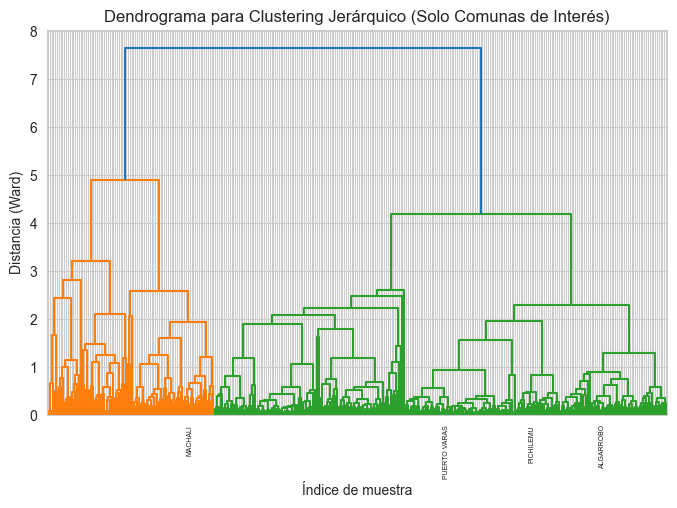

Silhouette Score para el modelo jerárquico: 0.2027


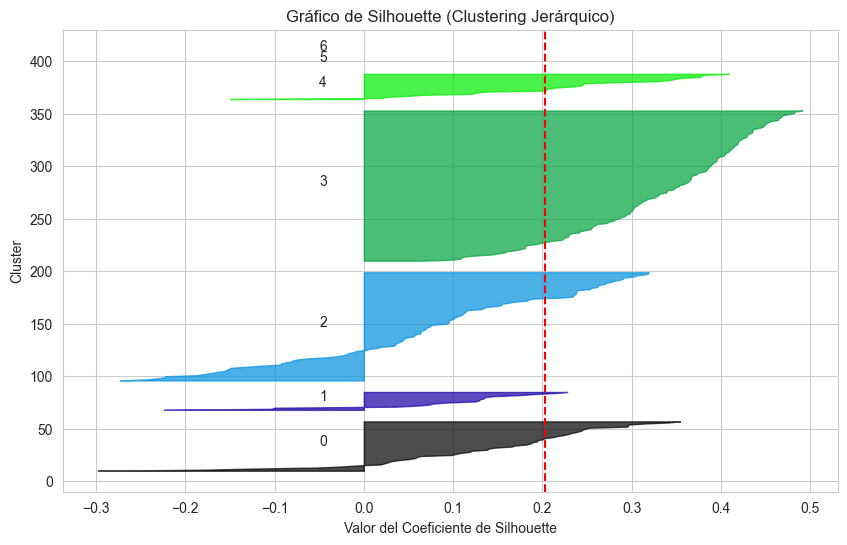

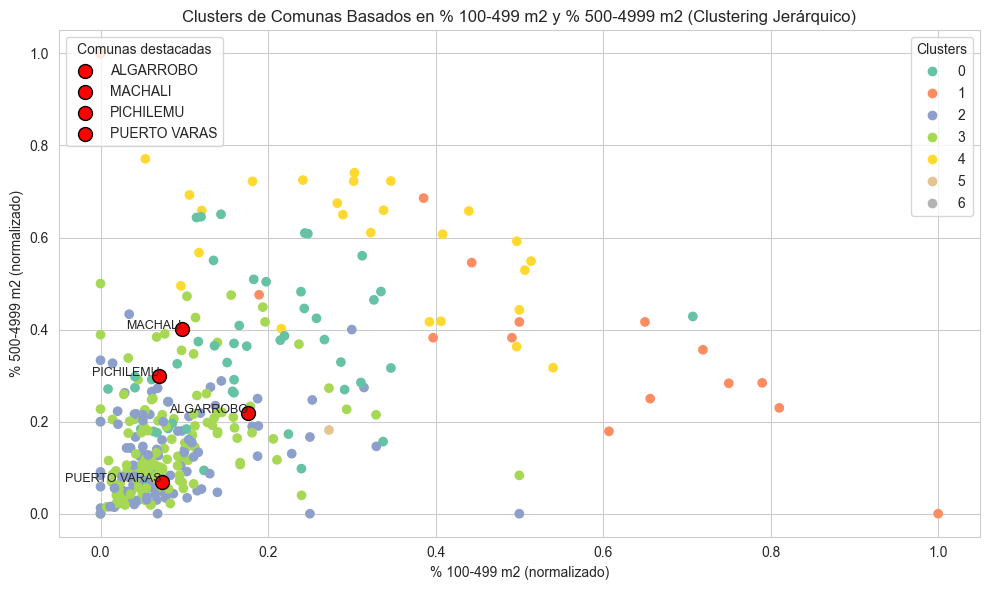


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 3
Comuna MACHALI pertenece al cluster 0
Comuna ALGARROBO pertenece al cluster 3
Comuna PICHILEMU pertenece al cluster 3

Media por cluster (solo variables seleccionadas):
         % 100-499 m2  % 500-4999 m2  % 5000-10000 m2  % 10001-100000 m2  \
cluster                                                                    
0           12.385643      35.649300        33.809071          14.649904   
1           31.071157      49.375760         7.746226           9.706853   
2            5.498397      12.560780        40.164955          29.942548   
3            5.537587      15.067890        60.263692          14.975166   
4           21.384941      58.828436        13.037059           6.214216   
5           18.181818      18.181818        45.454545          18.181818   
6            4.545455      13.636364        31.818182          36.363636   

         % >100000 m2  Mediana costo_m2_uf 100-499 m2  \
cluste

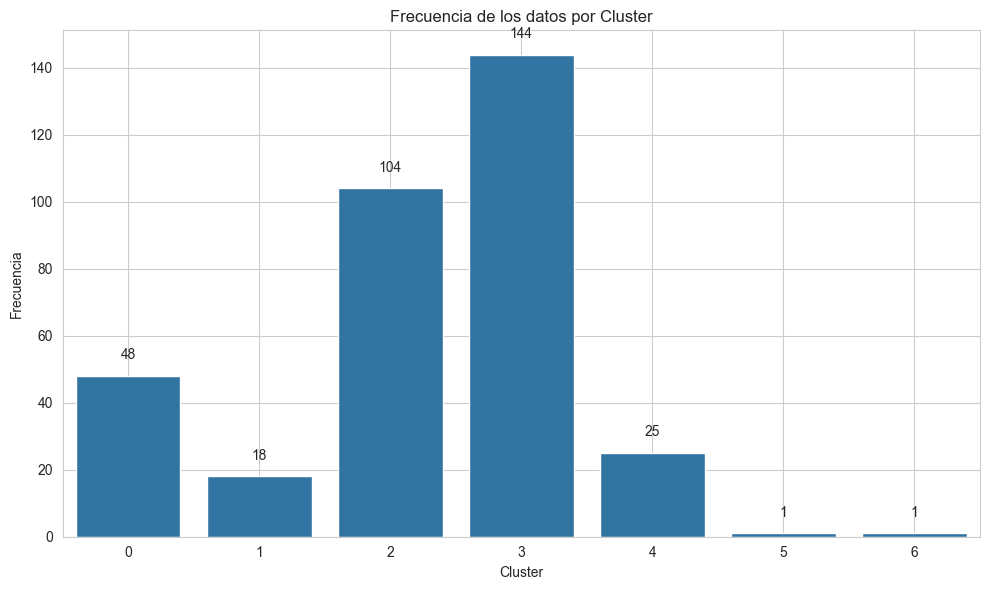

In [13]:
jerarquico_datos = realizar_clustering_jerarquico_sin_pca(
    data_estadisticos, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='% 100-499 m2',  # Variable en el eje X
    var_y='% 500-4999 m2'  # Variable en el eje Y
)


In [14]:
jerarquico_datos.to_csv("data recuperada/comunas cluster/jerarquico%datos.csv", index = False)

## Clustering proporción de oferta y semestres

In [45]:
import pandas as pd

# Definir los rangos de superficie de interés, incluyendo 100-499 m²
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']

# Paso 1: Calcular el total de datos por comuna y semestre
data_comuna_semestre = data_2021.groupby(['comuna_match', 'semestre']).size().reset_index(name='Total de Datos')

# Paso 2: Calcular tanto el total como el porcentaje de datos por rango de superficie en cada comuna y semestre
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular el total de datos en ese rango por comuna y semestre
    data_rango_total = data_rango.groupby(['comuna_match', 'semestre']).size().reset_index(name=f'Total {rango}')
    
    # Calcular el porcentaje de datos en ese rango sobre el total de la comuna y semestre
    data_comuna_semestre = data_comuna_semestre.merge(data_rango_total, on=['comuna_match', 'semestre'], how='left')
    data_comuna_semestre[f'% {rango}'] = (data_comuna_semestre[f'Total {rango}'] / data_comuna_semestre['Total de Datos']) * 100

# Paso 3: Calcular las estadísticas (mediana, media, desviación estándar, min, max) de costo_m2_uf por rango de superficie en cada comuna y semestre
for rango in rangos_superficie:
    # Filtrar los datos para el rango de superficie actual
    data_rango_estadisticas = data_2021[data_2021['rango_superficie'] == rango]

    # Calcular las estadísticas
    data_estadisticas = data_rango_estadisticas.groupby(['comuna_match', 'semestre']).agg(
        mediana=(f'costo_m2_uf', 'median'),
        media=(f'costo_m2_uf', 'mean'),
        desviacion_std=(f'costo_m2_uf', 'std'),
        min_costo=(f'costo_m2_uf', 'min'),
        max_costo=(f'costo_m2_uf', 'max')
    ).reset_index()

    # Renombrar las columnas para cada rango de superficie
    data_estadisticas.rename(columns={
        'mediana': f'Mediana costo_m2_uf {rango}',
        'media': f'Media costo_m2_uf {rango}',
        'desviacion_std': f'Desviación costo_m2_uf {rango}',
        'min_costo': f'Mínimo costo_m2_uf {rango}',
        'max_costo': f'Máximo costo_m2_uf {rango}'
    }, inplace=True)

    # Combinar con la tabla principal
    data_comuna_semestre = data_comuna_semestre.merge(data_estadisticas, on=['comuna_match', 'semestre'], how='left')

# Rellenar NaN con 0 para valores que no tienen datos
data_comuna_semestre.fillna(0, inplace=True)

# Pivotar la tabla para tener una fila por comuna y columnas separadas por semestre y métricas, incluyendo % y Totales
data_comuna_pivot = data_comuna_semestre.pivot(index='comuna_match', columns='semestre')

# Aplanar el MultiIndex en las columnas para un formato más limpio
data_comuna_pivot.columns = ['_'.join(map(str, col)).strip() for col in data_comuna_pivot.columns.values]
data_comuna_pivot.reset_index(inplace=True)

# Reemplazar NaN por 0 en el DataFrame pivotado
data_comuna_pivot.fillna(0, inplace=True)

# Mostrar la tabla transformada
print(data_comuna_pivot.head())

# Guardar en un archivo CSV
data_comuna_pivot.to_csv('data recuperada/estadisticos_por_comuna_y_rango_pivot.csv', index=False)


      comuna_match  Total de Datos_2021S1  Total de Datos_2021S2  \
0        ALGARROBO                  142.0                  149.0   
1            ALHUE                    3.0                    2.0   
2      ALTO BIOBIO                    3.0                    3.0   
3  ALTO DEL CARMEN                    1.0                    0.0   
4    ALTO HOSPICIO                   26.0                   41.0   

   Total de Datos_2022S1  Total de Datos_2022S2  Total de Datos_2023S1  \
0                  167.0                  233.0                  244.0   
1                    6.0                    9.0                    2.0   
2                    3.0                    2.0                    0.0   
3                    1.0                    6.0                    4.0   
4                   23.0                   49.0                   41.0   

   Total de Datos_2023S2  Total de Datos_2024S1  Total de Datos_2024S2  \
0                  248.0                  335.0                   84.0  

In [15]:
import pandas as pd 
data_semestre_pivot =pd.read_csv('data recuperada/estadisticos_por_comuna_y_rango_pivot.csv')

In [16]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
# Lista base de variables con "%" en lugar de "Total"
variables_clustering_base = [
    '% 100-499 m2', '% 500-4999 m2', '% 5000-10000 m2', '% 10001-100000 m2', '% >100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2'
]
# Semestres a considerar
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Generar la lista de variables diferenciadas por semestre
variables_clustering = [f"{var}_{semestre}" for semestre in semestres for var in variables_clustering_base]

# Paso 2: Extraer las variables para el clustering
X = data_semestre_pivot[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Imprimir la lista de variables resultante
print(variables_clustering)

['% 100-499 m2_2021S1', '% 500-4999 m2_2021S1', '% 5000-10000 m2_2021S1', '% 10001-100000 m2_2021S1', '% >100000 m2_2021S1', 'Mediana costo_m2_uf 100-499 m2_2021S1', 'Media costo_m2_uf 100-499 m2_2021S1', 'Desviación costo_m2_uf 100-499 m2_2021S1', 'Mediana costo_m2_uf 500-4999 m2_2021S1', 'Media costo_m2_uf 500-4999 m2_2021S1', 'Desviación costo_m2_uf 500-4999 m2_2021S1', 'Mediana costo_m2_uf 5000-10000 m2_2021S1', 'Media costo_m2_uf 5000-10000 m2_2021S1', 'Desviación costo_m2_uf 5000-10000 m2_2021S1', 'Mediana costo_m2_uf 10001-100000 m2_2021S1', 'Media costo_m2_uf 10001-100000 m2_2021S1', 'Desviación costo_m2_uf 10001-100000 m2_2021S1', 'Mediana costo_m2_uf >100000 m2_2021S1', 'Media costo_m2_uf >100000 m2_2021S1', 'Desviación costo_m2_uf >100000 m2_2021S1', '% 100-499 m2_2021S2', '% 500-4999 m2_2021S2', '% 5000-10000 m2_2021S2', '% 10001-100000 m2_2021S2', '% >100000 m2_2021S2', 'Mediana costo_m2_uf 100-499 m2_2021S2', 'Media costo_m2_uf 100-499 m2_2021S2', 'Desviación costo_m2_uf 

### Kmeans semestres %Datos

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

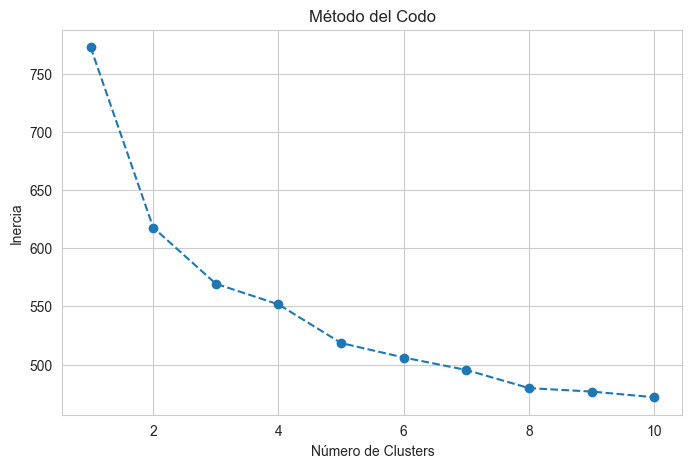

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


Silhouette Score para el modelo: 0.1455


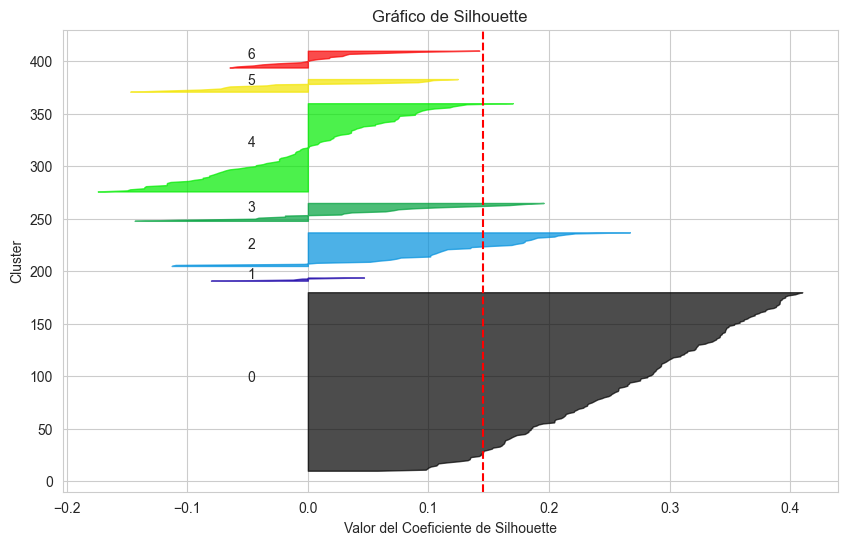

C:\Users\franc\AppData\Local\Temp\ipykernel_29824\1928401704.py:82: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc="upper left")


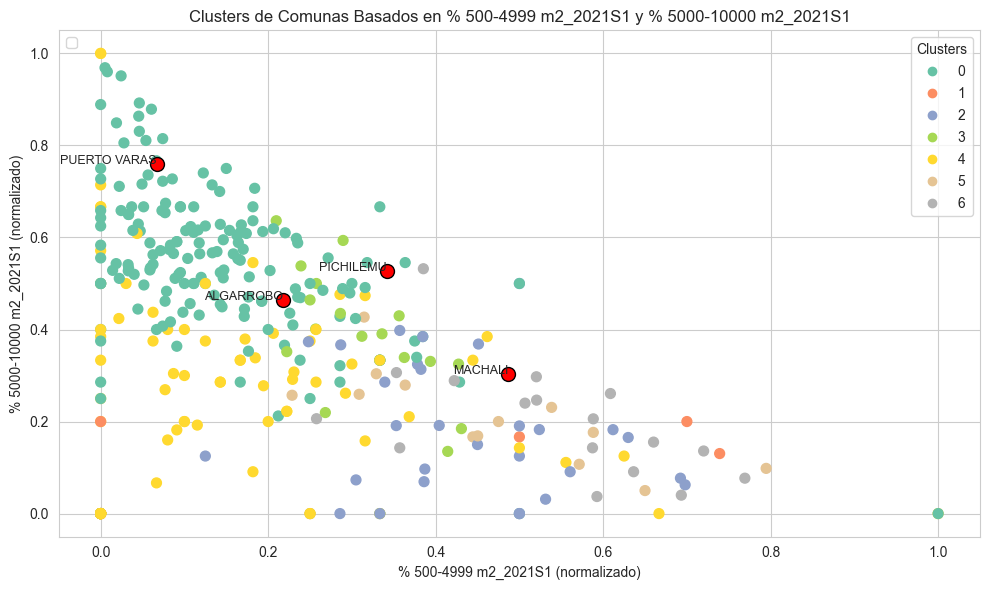


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 0
Comuna MACHALI pertenece al cluster 3
Comuna ALGARROBO pertenece al cluster 0
Comuna PICHILEMU pertenece al cluster 0

Media por cluster (solo variables seleccionadas):
         % 100-499 m2_2021S1  % 500-4999 m2_2021S1  % 5000-10000 m2_2021S1  \
cluster                                                                      
0                   5.889127             14.091001               54.543307   
1                  24.094203             48.478261               17.427536   
2                  25.384669             38.953567               16.117591   
3                   8.285117             32.218070               38.680968   
4                   8.076617             14.950114               25.666086   
5                  19.182672             46.592305               20.957550   
6                  20.973409             53.994362               20.035973   

         % 10001-100000 m2_2021S1  % >100000 

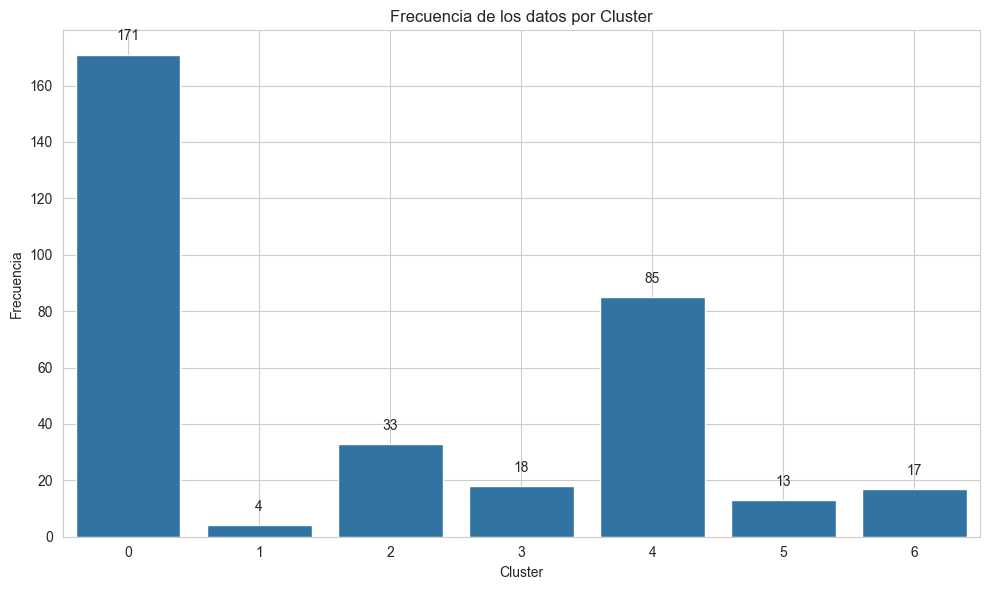

In [17]:
kmeans_semestres_datos = realizar_clustering_sin_pca(data_semestre_pivot, variables_clustering, 7, True, True, '% 500-4999 m2_2021S1', '% 5000-10000 m2_2021S1')

In [18]:
kmeans_semestres_datos.to_csv("data recuperada/comunas cluster/kmeans_semestres_%datos.csv", index = False)

### Divisive %datos por semestre

C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\franc\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Wi

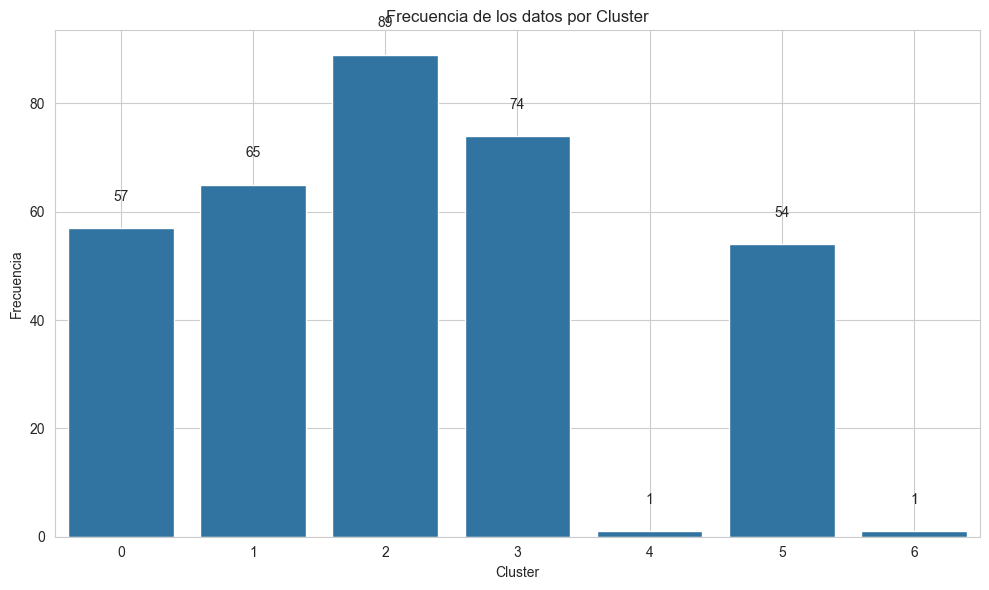

Dendrograma Simulado (Divisive Clustering):
Cluster 0 (Raíz)
├── Cluster 0 (276)
│   ├── Cluster 0 (186)
│   │   ├── Cluster 0 (112)
│   │   │   ├── Cluster 0 (111)
│   │   │   │   ├── Cluster 0 (57)
│   │   │   │   └── Cluster 5 (54)
│   │   │   └── Cluster 4 (1)
│   │   └── Cluster 3 (74)
│   └── Cluster 2 (90)
│       ├── Cluster 2 (89)
│       └── Cluster 6 (1)
└── Cluster 1 (65)
No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.


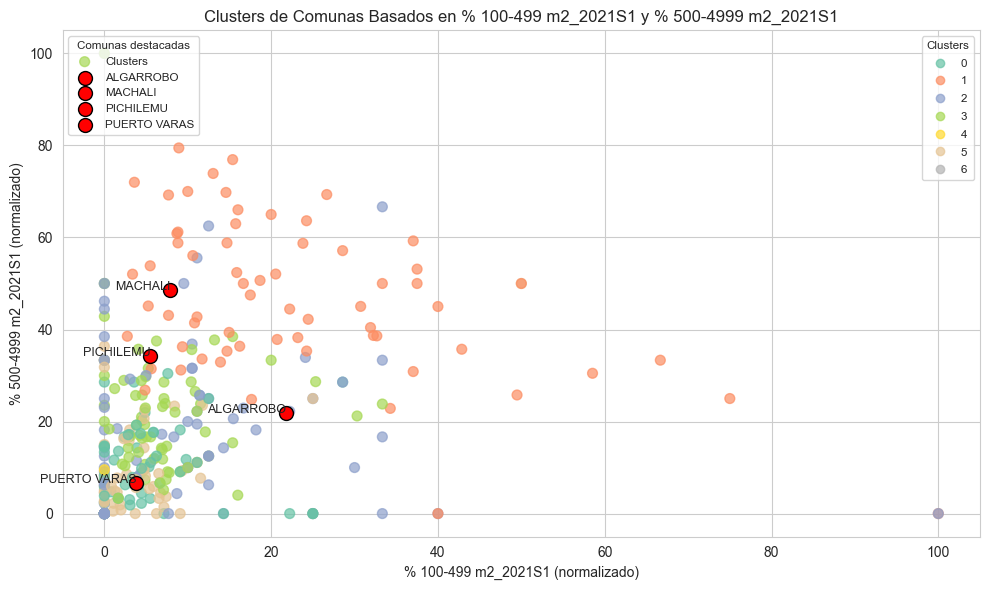


Media por cluster (solo variables seleccionadas):
         % 100-499 m2_2021S1  % 500-4999 m2_2021S1  % 5000-10000 m2_2021S1  \
cluster                                                                      
0                   5.114110             10.501415               47.404781   
1                  23.316599             46.455983               18.778395   
2                   8.518928             16.321567               24.443101   
3                   7.273110             21.335868               51.798340   
4                   0.000000              9.523810               66.666667   
5                   5.170390             11.185445               63.362640   
6                   0.000000              0.000000                0.000000   

         % 10001-100000 m2_2021S1  % >100000 m2_2021S1  \
cluster                                                  
0                       24.664698            10.560610   
1                        9.290011             2.159012   
2             

In [19]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from anytree import Node, RenderTree
from anytree.exporter import DotExporter

def divisive_clustering(data, variables_clustering, n_clusters):
    # Normalizar las variables
    X = data[variables_clustering]
    scaler = MinMaxScaler()
    X_normalizado = scaler.fit_transform(X)

    # Inicializar con un solo cluster que contiene todos los puntos
    clusters = np.zeros(X_normalizado.shape[0], dtype=int)
    cluster_labels = [0]  # Empezar con un único cluster etiquetado como '0'
    next_cluster_label = 1

    # Crear un nodo raíz para el dendrograma simulado
    root = Node("Cluster 0 (Raíz)")
    node_dict = {0: root}  # Diccionario para almacenar referencias a los nodos

    # Dividir recursivamente hasta alcanzar el número deseado de clusters
    while len(cluster_labels) < n_clusters:
        # Encuentra el cluster más grande para dividirlo
        largest_cluster = max(cluster_labels, key=lambda cl: np.sum(clusters == cl))
        cluster_indices = np.where(clusters == largest_cluster)[0]

        if len(cluster_indices) <= 1:  # Si solo queda un punto en el cluster, no se puede dividir
            break

        # Aplicar K-means con k=2 para dividir el cluster más grande
        kmeans = KMeans(n_clusters=2, random_state=42)
        subcluster_labels = kmeans.fit_predict(X_normalizado[cluster_indices])

        # Asignar nuevas etiquetas de cluster a los subclusters
        clusters[cluster_indices[subcluster_labels == 0]] = largest_cluster
        clusters[cluster_indices[subcluster_labels == 1]] = next_cluster_label

        # Crear nodos para los subclusters en el árbol jerárquico
        parent_node = node_dict[largest_cluster]
        node_dict[largest_cluster] = Node(f"Cluster {largest_cluster} ({np.sum(clusters == largest_cluster)})", parent=parent_node)
        node_dict[next_cluster_label] = Node(f"Cluster {next_cluster_label} ({np.sum(clusters == next_cluster_label)})", parent=parent_node)

        # Actualizar los labels de clusters
        cluster_labels.append(next_cluster_label)
        next_cluster_label += 1

        # Eliminar el cluster original si se ha dividido
        cluster_labels = [cl for cl in cluster_labels if np.sum(clusters == cl) > 0]

    # Añadir los clusters al DataFrame original
    data_divisivo = data.copy()
    data_divisivo['cluster'] = clusters

    # Guardar el listado de comunas con su cluster en un archivo CSV
    data_divisivo[['comuna_match', 'cluster']].to_csv("data recuperada/comunas cluster/divisive_%datos_1.csv", index=False)

    # Paso 5: Visualizar frecuencia por cluster con el color deseado
    frecuencia_clusters = data_divisivo['cluster'].value_counts().sort_index()
    plt.figure(figsize=(10, 6))
    ax = sns.barplot(x=frecuencia_clusters.index, y=frecuencia_clusters.values, color=sns.color_palette()[0])  # Color por defecto de Seaborn
    plt.title('Frecuencia de los datos por Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Frecuencia')

    # Añadir anotaciones encima de cada barra
    for i, v in enumerate(frecuencia_clusters.values):
        ax.text(i, v + 5, str(v), ha='center', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Simular un dendrograma
    print("Dendrograma Simulado (Divisive Clustering):")
    for pre, _, node in RenderTree(root):
        print(f"{pre}{node.name}")

    # Exportar dendrograma a archivo .png usando Graphviz si está instalado
    try:
        DotExporter(root).to_picture("dendrograma_divisivo.png")
        print("Dendrograma exportado a 'dendrograma_divisivo.png'")
    except Exception as e:
        print("No se pudo exportar el dendrograma a imagen. Asegúrate de tener Graphviz instalado.")

    return data_divisivo  # Retorna los datos con clusters asignados


# Llamar a la función con tus datos y variables
data_resultados = divisive_clustering(
    data_semestre_pivot, 
    variables_clustering, 
    n_clusters=7  # Número de clusters deseado
)

# Visualización de los clusters en un gráfico de dispersión
plt.figure(figsize=(10, 6))
scatter = plt.scatter(data_resultados[variables_clustering[0]], data_resultados[variables_clustering[1]], 
                      c=data_resultados['cluster'], cmap='Set2', s=50, alpha=0.7, label='Clusters')  # Usa Set2 para el gráfico de dispersión

# Comunas de interés y sus clusters
comunas_interes = ['PUERTO VARAS', 'PICHILEMU', 'ALGARROBO', 'MACHALI']
pos_comunas = data_resultados[data_resultados['comuna_match'].isin(comunas_interes)]

# Destacar las comunas de interés
for comuna, x, y in zip(pos_comunas['comuna_match'], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[0]], 
                        data_resultados.loc[pos_comunas.index, variables_clustering[1]]):
    plt.scatter(x, y, color='red', s=100, label=comuna, edgecolor='black')
    plt.text(x, y, comuna, fontsize=9, ha='right')

# Añadir leyenda de clusters
legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="upper right", fontsize='small', title_fontsize='small')
plt.gca().add_artist(legend1)

# Añadir leyenda personalizada para las comunas destacadas en otra ubicación
plt.legend(loc="upper left", fontsize='small', title="Comunas destacadas", title_fontsize='small')

# Personalización del gráfico de dispersión
plt.xlabel(f'{variables_clustering[0]} (normalizado)')
plt.ylabel(f'{variables_clustering[1]} (normalizado)')
plt.title('Clusters de Comunas Basados en ' + variables_clustering[0] + ' y ' + variables_clustering[1])
plt.grid(True)
plt.tight_layout()
plt.show()

# Calcular estadísticas por cluster
media_por_cluster = data_resultados.groupby('cluster')[variables_clustering].mean()
mediana_por_cluster = data_resultados.groupby('cluster')[variables_clustering].median()

# Imprimir las estadísticas
print("\nMedia por cluster (solo variables seleccionadas):")
print(media_por_cluster)
print("\nMediana por cluster (solo variables seleccionadas):")
print(mediana_por_cluster)

# Mostrar los clusters de las comunas de interés
print("\nClusters de las comunas de interés:")
print(pos_comunas[['comuna_match', 'cluster']])

In [20]:
data_resultados.to_csv("data recuperada/comunas cluster/divisive_semestres_%datos.csv", index = False)

### Jerarquico %datos por semestres

In [21]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
# Lista base de variables con "%" en lugar de "Total"
variables_clustering = [
    '% 100-499 m2', '% 500-4999 m2', '% 5000-10000 m2', '% 10001-100000 m2', '% >100000 m2',
    'Mediana costo_m2_uf 100-499 m2', 'Media costo_m2_uf 100-499 m2', 'Desviación costo_m2_uf 100-499 m2',
    'Mínimo costo_m2_uf 100-499 m2', 'Máximo costo_m2_uf 100-499 m2',
    'Mediana costo_m2_uf 500-4999 m2', 'Media costo_m2_uf 500-4999 m2', 'Desviación costo_m2_uf 500-4999 m2',
    'Mínimo costo_m2_uf 500-4999 m2', 'Máximo costo_m2_uf 500-4999 m2',
    'Mediana costo_m2_uf 5000-10000 m2', 'Media costo_m2_uf 5000-10000 m2', 'Desviación costo_m2_uf 5000-10000 m2',
    'Mínimo costo_m2_uf 5000-10000 m2', 'Máximo costo_m2_uf 5000-10000 m2',
    'Mediana costo_m2_uf 10001-100000 m2', 'Media costo_m2_uf 10001-100000 m2', 'Desviación costo_m2_uf 10001-100000 m2',
    'Mínimo costo_m2_uf 10001-100000 m2', 'Máximo costo_m2_uf 10001-100000 m2',
    'Mediana costo_m2_uf >100000 m2', 'Media costo_m2_uf >100000 m2', 'Desviación costo_m2_uf >100000 m2',
    'Mínimo costo_m2_uf >100000 m2', 'Máximo costo_m2_uf >100000 m2'
]
# Semestres a considerar
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Generar la lista de variables diferenciadas por semestre
variables_clustering = [f"{var}_{semestre}" for semestre in semestres for var in variables_clustering_base]

# Paso 2: Extraer las variables para el clustering
X = data_semestre_pivot[variables_clustering]

# Paso 3: Normalizar las características usando MinMaxScaler
scaler = MinMaxScaler()
X_normalizado = pd.DataFrame(scaler.fit_transform(X), columns=variables_clustering)

# Imprimir la lista de variables resultante
print(variables_clustering)

['% 100-499 m2_2021S1', '% 500-4999 m2_2021S1', '% 5000-10000 m2_2021S1', '% 10001-100000 m2_2021S1', '% >100000 m2_2021S1', 'Mediana costo_m2_uf 100-499 m2_2021S1', 'Media costo_m2_uf 100-499 m2_2021S1', 'Desviación costo_m2_uf 100-499 m2_2021S1', 'Mediana costo_m2_uf 500-4999 m2_2021S1', 'Media costo_m2_uf 500-4999 m2_2021S1', 'Desviación costo_m2_uf 500-4999 m2_2021S1', 'Mediana costo_m2_uf 5000-10000 m2_2021S1', 'Media costo_m2_uf 5000-10000 m2_2021S1', 'Desviación costo_m2_uf 5000-10000 m2_2021S1', 'Mediana costo_m2_uf 10001-100000 m2_2021S1', 'Media costo_m2_uf 10001-100000 m2_2021S1', 'Desviación costo_m2_uf 10001-100000 m2_2021S1', 'Mediana costo_m2_uf >100000 m2_2021S1', 'Media costo_m2_uf >100000 m2_2021S1', 'Desviación costo_m2_uf >100000 m2_2021S1', '% 100-499 m2_2021S2', '% 500-4999 m2_2021S2', '% 5000-10000 m2_2021S2', '% 10001-100000 m2_2021S2', '% >100000 m2_2021S2', 'Mediana costo_m2_uf 100-499 m2_2021S2', 'Media costo_m2_uf 100-499 m2_2021S2', 'Desviación costo_m2_uf 

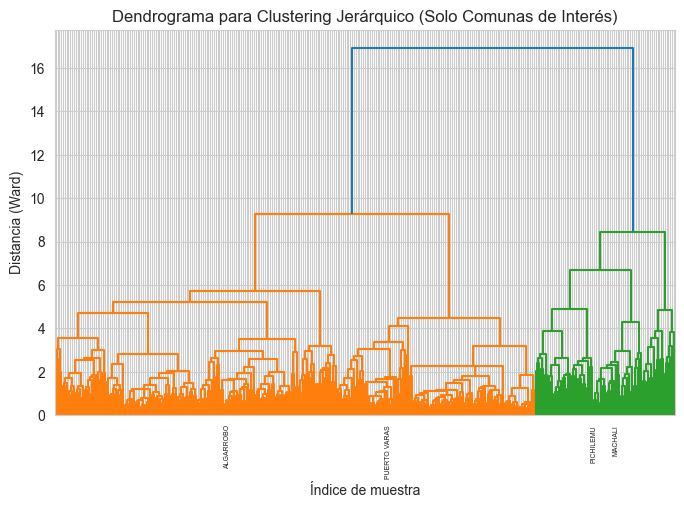

Silhouette Score para el modelo jerárquico: 0.0694


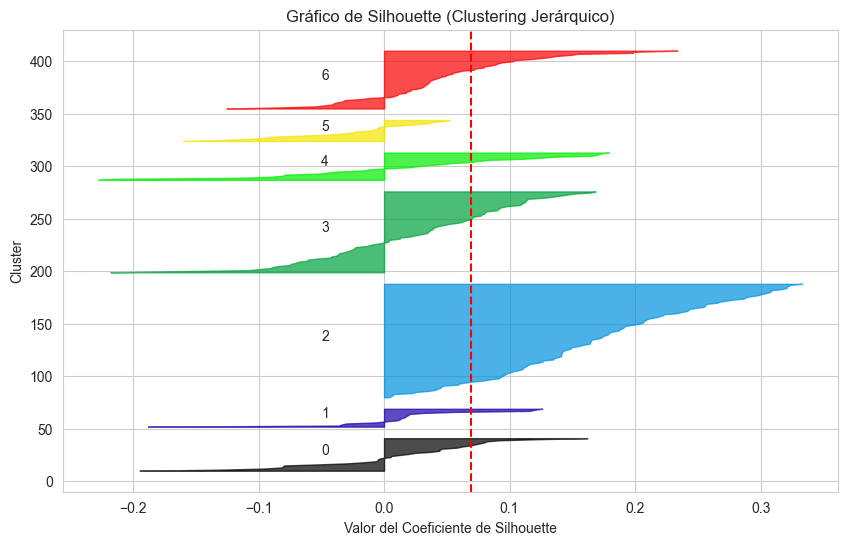

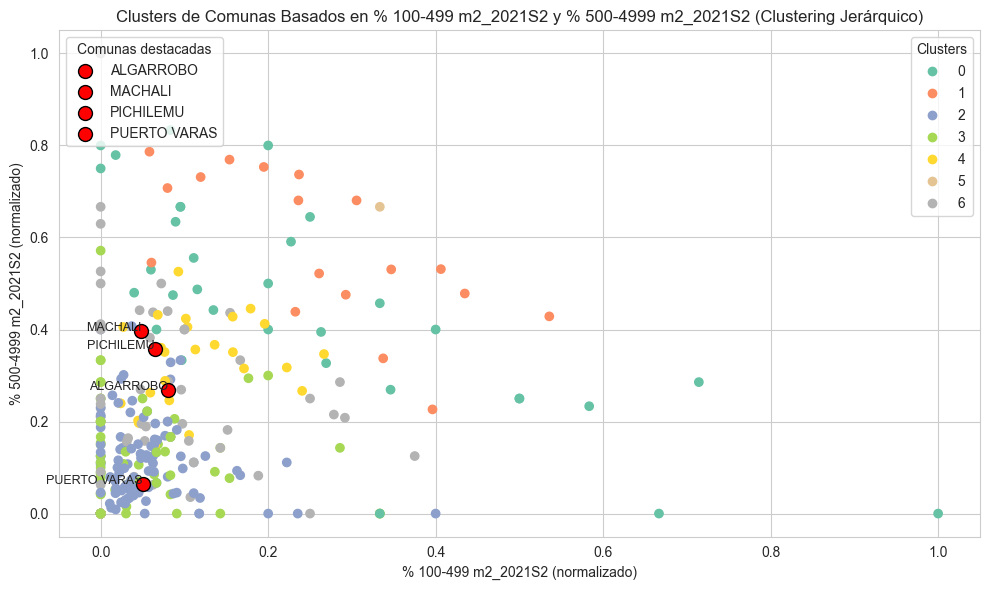


Clusters de las comunas seleccionadas:
Comuna PUERTO VARAS pertenece al cluster 2
Comuna MACHALI pertenece al cluster 4
Comuna ALGARROBO pertenece al cluster 6
Comuna PICHILEMU pertenece al cluster 4

Media por cluster (solo variables seleccionadas):
         % 100-499 m2_2021S1  % 500-4999 m2_2021S1  % 5000-10000 m2_2021S1  \
cluster                                                                      
0                  26.979706             47.361217               13.722351   
1                  23.900995             52.242393               19.537330   
2                   4.510262             12.261146               59.675477   
3                   6.553300             12.028843               35.139159   
4                  11.806656             32.127741               37.551041   
5                  12.222222              8.730159               11.666667   
6                   9.123001             26.460929               37.933641   

         % 10001-100000 m2_2021S1  % >100000 

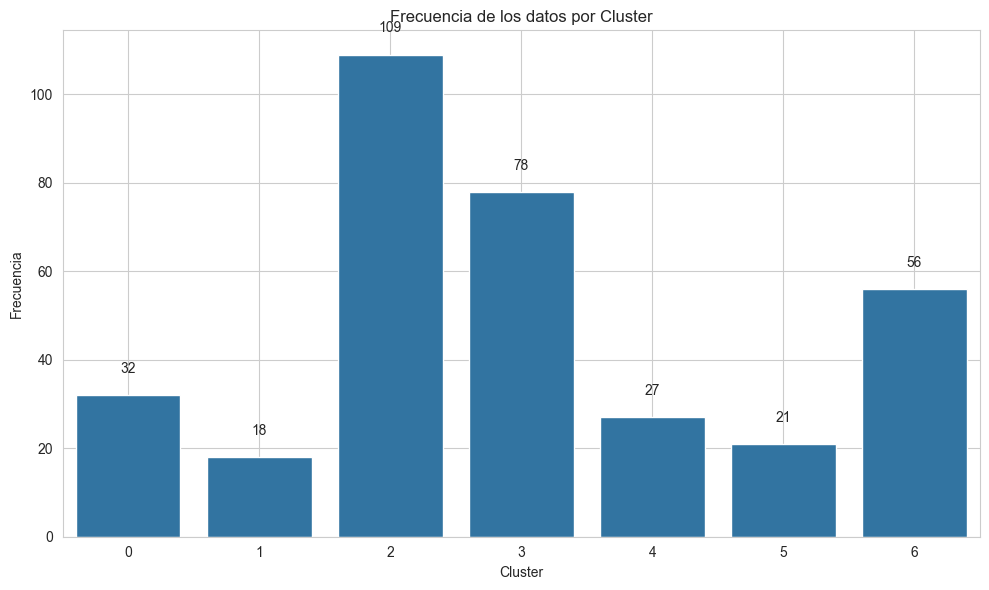

In [22]:
jerarquico_datos = realizar_clustering_jerarquico_sin_pca(
    data_semestre_pivot, 
    variables_clustering,  # Utilizas las variables que has definido para el clustering
    n_clusters=7,  # Número de clusters basado en el dendrograma
    mostrar_codo=True,  # Mostrar el dendrograma
    mostrar_silhouette=True,  # Mostrar el gráfico de silhouette
    var_x='% 100-499 m2_2021S2',  # Variable en el eje X
    var_y='% 500-4999 m2_2021S2'  # Variable en el eje Y
)

In [23]:
jerarquico_datos.to_csv("data recuperada/comunas cluster/jerarquico_semestres_%datos.csv", index = False)

## Variación porcentual de precios por semestre

### Kmeans

#### % de datos 

In [41]:
import pandas as pd
import numpy as np

# Cargar los datos originales sin modificarlos
kmeans_semestres_datos = pd.read_csv("data recuperada/comunas cluster/kmeans_semestres_%datos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = kmeans_semestres_datos[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = kmeans_semestres_datos[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_kmeans.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())


      comuna_match  cluster  \
0        ALGARROBO        0   
1            ALHUE        4   
2      ALTO BIOBIO        4   
3  ALTO DEL CARMEN        4   
4    ALTO HOSPICIO        0   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

C:\Users\franc\AppData\Local\Temp\ipykernel_29824\1669869055.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_29824\1669869055.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are

#### Num de datos

In [18]:
kmeans_num_datos = pd.read_csv("data recuperada/comunas cluster/kmeans_semestres_numdatos.csv")

In [19]:
import pandas as pd
import numpy as np

# Cargar los datos originales sin modificarlos
kmeans_num_datos = pd.read_csv("data recuperada/comunas cluster/kmeans_semestres_numdatos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = kmeans_num_datos[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = kmeans_num_datos[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_kmeans_numdatos.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())

C:\Users\franc\AppData\Local\Temp\ipykernel_26068\7538855.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_26068\7538855.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setti

      comuna_match  cluster  \
0        ALGARROBO        5   
1            ALHUE        1   
2      ALTO BIOBIO        1   
3  ALTO DEL CARMEN        1   
4    ALTO HOSPICIO        1   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

### Divisive

#### % de datos

In [42]:
import pandas as pd
import numpy as np

# Cargar la data con los datos de kmeans y semestres
divisive = pd.read_csv("data recuperada/comunas cluster/divisive_semestres_%datos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = divisive[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = divisive[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_divisive.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())

C:\Users\franc\AppData\Local\Temp\ipykernel_29824\3210082957.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_29824\3210082957.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are

      comuna_match  cluster  \
0        ALGARROBO        3   
1            ALHUE        2   
2      ALTO BIOBIO        2   
3  ALTO DEL CARMEN        2   
4    ALTO HOSPICIO        3   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

C:\Users\franc\AppData\Local\Temp\ipykernel_29824\3210082957.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_29824\3210082957.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are

#### Num de datos

In [20]:
import pandas as pd
import numpy as np

# Cargar la data con los datos de kmeans y semestres
divisive_num_datos = pd.read_csv("data recuperada/comunas cluster/divisive_semestres_numdatos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = divisive_num_datos[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = divisive_num_datos[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_divisive_numdatos.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())

C:\Users\franc\AppData\Local\Temp\ipykernel_26068\1024373289.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_26068\1024373289.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are

      comuna_match  cluster  \
0        ALGARROBO        0   
1            ALHUE        4   
2      ALTO BIOBIO        4   
3  ALTO DEL CARMEN        5   
4    ALTO HOSPICIO        3   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

### Jerarquico

#### % de datos

In [ ]:
jerarquico_datos.to_csv("data recuperada/comunas cluster/jerarquico_semestres_%datos.csv", index = False)

In [2]:
import pandas as pd
import numpy as np
# Cargar la data con los datos de kmeans y semestres
jerarquico_datos = pd.read_csv("data recuperada/comunas cluster/jerarquico_semestres_%datos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = jerarquico_datos[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = jerarquico_datos[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_jerarquico.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())

      comuna_match  cluster  \
0        ALGARROBO        3   
1            ALHUE        2   
2      ALTO BIOBIO        2   
3  ALTO DEL CARMEN        2   
4    ALTO HOSPICIO        3   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

C:\Users\franc\AppData\Local\Temp\ipykernel_26068\524612492.py:40: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_26068\524612492.py:40: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are s

#### Num de datos

In [21]:
import pandas as pd
import numpy as np
# Cargar la data con los datos de kmeans y semestres
jerarquico_num_datos = pd.read_csv("data recuperada/comunas cluster/jerarquico_semestres_numdatos.csv")

# Definir los rangos de superficie y semestres
rangos_superficie = ['100-499 m2', '500-4999 m2', '5000-10000 m2', '10001-100000 m2', '>100000 m2']
semestres = ['2021S1', '2021S2', '2022S1', '2022S2', '2023S1', '2023S2', '2024S1']

# Crear un DataFrame vacío para almacenar los resultados de variación porcentual
resultados_variacion = jerarquico_num_datos[['comuna_match', 'cluster']].copy()

# Calcular la variación porcentual en una copia de los datos
for rango in rangos_superficie:
    # Generar los nombres de columnas para la mediana del precio por semestre
    columnas_mediana = [f"Mediana costo_m2_uf {rango}_{semestre}" for semestre in semestres]

    # Crear una copia temporal para calcular la variación de la mediana por comuna
    data_temporal = jerarquico_num_datos[['comuna_match', 'cluster'] + columnas_mediana].copy()

    # Llenar los valores faltantes hacia adelante para cada comuna y reemplazar NaN iniciales con 0
    data_filled = data_temporal.groupby('comuna_match')[columnas_mediana].apply(lambda x: x.ffill().fillna(0))

    # Aseguramos que los índices sean compatibles
    data_filled.reset_index(drop=True, inplace=True)
    data_temporal[columnas_mediana] = data_filled

    # Calcular la variación porcentual de la mediana entre semestres
    for i in range(1, len(columnas_mediana)):
        col_anterior = columnas_mediana[i - 1]
        col_actual = columnas_mediana[i]
        nueva_columna = f'Variacion % {col_actual}'

        # Calcular la variación porcentual y manejar NaN e inf
        data_temporal[nueva_columna] = np.where(
            (data_temporal[col_anterior] == 0) & (data_temporal[col_actual] == 0), 
            0,  # Si ambos valores son 0, establecer la variación en 0
            ((data_temporal[col_actual] - data_temporal[col_anterior]) / data_temporal[col_anterior]) * 100
        )
        data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0

    # Añadir las columnas de variación al DataFrame de resultados
    columnas_variacion = [f'Variacion % {col}' for col in columnas_mediana[1:]]
    resultados_variacion = pd.concat([resultados_variacion, data_temporal[columnas_variacion]], axis=1)

# Guardar los resultados en un nuevo archivo CSV
resultados_variacion.to_csv('data recuperada/variacion_porcentual_jerarquico_numdatos.csv', index=False)

# Mostrar una muestra de los resultados
print(resultados_variacion.head())

C:\Users\franc\AppData\Local\Temp\ipykernel_26068\190857650.py:40: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_temporal[nueva_columna].replace([np.inf, -np.inf], 0, inplace=True)  # Reemplazar inf con 0
C:\Users\franc\AppData\Local\Temp\ipykernel_26068\190857650.py:40: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are s

      comuna_match  cluster  \
0        ALGARROBO        4   
1            ALHUE        3   
2      ALTO BIOBIO        3   
3  ALTO DEL CARMEN        3   
4    ALTO HOSPICIO        4   

   Variacion % Mediana costo_m2_uf 100-499 m2_2021S2  \
0                                           6.891910   
1                                           0.000000   
2                                           0.000000   
3                                           0.000000   
4                                          93.391365   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S1  \
0                                          -8.051725   
1                                           0.000000   
2                                         937.362364   
3                                           0.000000   
4                                         -82.062916   

   Variacion % Mediana costo_m2_uf 100-499 m2_2022S2  \
0                                          -2.771231   
1                          

## Estudio de variaciones

In [2]:
import pandas as pd
import numpy as np
import os

# Lista de archivos CSV de datos a analizar
archivos_variacion = [
    'data recuperada/variacion_porcentual_kmeans.csv',
    'data recuperada/variacion_porcentual_kmeans_numdatos.csv',
    'data recuperada/variacion_porcentual_divisive.csv',
    'data recuperada/variacion_porcentual_divisive_numdatos.csv',
    'data recuperada/variacion_porcentual_jerarquico.csv',
    'data recuperada/variacion_porcentual_jerarquico_numdatos.csv'
]

# Definir los rangos de superficie
rangos_superficie = ['100-499 m2','500-4999 m2', '5000-10000 m2', '10001-100000 m2']

# Crear una carpeta de salida para almacenar los archivos generados
carpeta_salida = "data recuperada/variacion estadisticos/"

# Iterar sobre cada archivo de datos de variación
for archivo in archivos_variacion:
    # Cargar la data de variaciones
    resultados_variacion = pd.read_csv(archivo)
    
    # Crear un DataFrame para almacenar las estadísticas por comuna y rango
    estadisticas_comuna = pd.DataFrame()
    
    # Calcular estadísticas de variación para cada rango y comuna, consolidando todas las variaciones de los semestres
    for rango in rangos_superficie:
        # Seleccionar columnas de variación que corresponden al rango actual, ignorando los semestres
        columnas_variacion = [col for col in resultados_variacion.columns if f'Variacion % Mediana costo_m2_uf {rango}' in col]
        
        # Filtrar las columnas de variación del rango actual para todas las variaciones de los semestres
        variaciones_rango = resultados_variacion[['comuna_match', 'cluster'] + columnas_variacion]
        
        # Unir las variaciones en una sola columna por comuna y cluster
        variaciones_rango_stack = variaciones_rango.set_index(['comuna_match', 'cluster']).stack().reset_index()
        variaciones_rango_stack.columns = ['comuna_match', 'cluster', 'Semestre', f'Variacion % Mediana costo_m2_uf {rango}']
        
        # Agrupar por comuna y cluster y calcular las estadísticas sin considerar los semestres individualmente
        estadisticas_rango = variaciones_rango_stack.groupby(['comuna_match', 'cluster'])[f'Variacion % Mediana costo_m2_uf {rango}'].agg(
            mean_variacion='mean',
            std_variacion='std',
            max_variacion='max',
            min_variacion='min'
        ).reset_index()

        # Añadir las estadísticas del rango al DataFrame general de estadísticas por comuna
        estadisticas_rango.columns = ['comuna_match', 'cluster', f'Mean Variacion {rango}', f'Std Variacion {rango}', f'Max Variacion {rango}', f'Min Variacion {rango}']
        estadisticas_comuna = pd.merge(estadisticas_comuna, estadisticas_rango, on=['comuna_match', 'cluster'], how='outer') if not estadisticas_comuna.empty else estadisticas_rango

    # Guardar el DataFrame de estadísticas por comuna en un archivo CSV
    nombre_archivo = os.path.basename(archivo).replace('.csv', '_estadisticas_comuna.csv')
    nombre_salida = os.path.join(carpeta_salida, nombre_archivo)
    estadisticas_comuna.to_csv(nombre_salida, index=False)

# Confirmación final
print("Estadísticas de variación por comuna calculadas y guardadas para todos los archivos.")




Estadísticas de variación por comuna calculadas y guardadas para todos los archivos.
